In [1]:
import adclasses
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import joblib
import math
from datetime import timedelta
import os
import warnings
warnings.filterwarnings('ignore')

Using TensorFlow backend.
/home/cfreeman/Documents/NextIT/adclasses2/adclasses2_venv/lib/python3.5/site-packages/tensorflow/python/framework/ops.py:939: DeprecationWarning: builtin type EagerTensor has no __module__ attribute
  EagerTensor = c_api.TFE_Py_InitEagerTensor(_EagerTensorBase)
/home/cfreeman/Documents/NextIT/adclasses2/adclasses2_venv/lib/python3.5/site-packages/tensorflow/python/util/tf_inspect.py:55: DeprecationWarning: inspect.getargspec() is deprecated, use inspect.signature() instead
  if d.decorator_argspec is not None), _inspect.getargspec(target))


In [2]:
dataset_name_list = ["nyc_taxi",
                     "exchange-2_cpm_results",
                     "exchange-3_cpm_results",
                     "all_data_gift_certificates",
                     "elb_request_count_8c0756",
                     "FARM_Bowling-Green-5-S_Warren",
                     "exchange-2_cpc_results",
                     "exchange-3_cpc_results",
                     "international-airline-passengers",
                     "ambient_temperature_system_failure"]
true_outlier_indices_dict = {}
ad_dict = {}

# nyc_taxi

In [3]:
dataset_name = "nyc_taxi"

path = "data/" + dataset_name + ".csv"

data = pd.read_csv(path, header=0)
start_date = data["timestamp"].values[0]
end_date = data["timestamp"].values[-1]
print("Start date: ", start_date)
print("End date: ", end_date)
data["timestamp"] = pd.to_datetime(data["timestamp"], format="%Y-%m-%d %H:%M:%S")

print("Missing time stamps: \n", adclasses.find_missing_time_steps(start_date, end_date, '30min', data))

data["timestamp"] = pd.to_datetime(data["timestamp"], format="%Y-%m-%d %H:%M:%S")
ad = adclasses.UnivariateAnomalyDetection(dataframe=data, timestep="30min", dateformat="%Y-%m-%d %H:%M:%S", name=dataset_name)
print("Length: ", ad.get_length())
print("Time step size: ", ad.get_timestep())
print("Date Format: ", ad.get_dateformat())
true_outlier_dates = ["2014-11-01 19:00:00",
                      "2014-11-27 15:30:00",
                      "2014-12-25 15:00:00",
                      "2015-01-01 01:00:00",
                      "2015-01-27 00:00:00"]
true_outlier_indices = ad.convert_true_outlier_date(true_outlier_dates)

true_outlier_indices_dict[dataset_name] = true_outlier_indices
ad_dict[dataset_name] = ad

Start date:  2014-07-01 00:00:00
End date:  2015-01-31 23:30:00
Missing time stamps: 
 DatetimeIndex([], dtype='datetime64[ns]', freq='30T')
Length:  10320
Time step size:  30min
Date Format:  %Y-%m-%d %H:%M:%S


# exchange-2_cpm_results

In [4]:
dataset_name = "exchange-2_cpm_results"
path = "data/" + dataset_name + ".csv"

data = pd.read_csv(path, header=0)
data = data.dropna()
start_date = data["timestamp"].values[0]
end_date = data["timestamp"].values[-1]
print("Start date: ", start_date)
print("End date: ", end_date)
data["timestamp"] = pd.to_datetime(data["timestamp"], format="%Y-%m-%d %H:%M:%S")

print("Missing time stamps: \n", adclasses.find_missing_time_steps(start_date, end_date, '1H', data))

# if you want to use a method that cannot take missing time steps
# into account, you need to fill in the missing time steps yourself
# this function also removes duplicates
print("Fill Missing Time Steps with Interpolation")
data = adclasses.fill_missing_time_steps(start_date, end_date, '1H', data, method="linear")

data["timestamp"] = pd.to_datetime(data["timestamp"], format="%Y-%m-%d %H:%M:%S")
ad = adclasses.UnivariateAnomalyDetection(dataframe=data, timestep="1H", dateformat="%Y-%m-%d %H:%M:%S", name=dataset_name)
print("Length: ", ad.get_length())
print("Time step size: ", ad.get_timestep())
print("Start Date: ", start_date)
print("End Date: ", end_date)
print("Date Format: ", ad.get_dateformat())
true_outlier_dates = ["2011-07-26 06:00:01",
                      "2011-08-10 17:00:01"]
true_outlier_indices = ad.convert_true_outlier_date(true_outlier_dates)

true_outlier_indices_dict[dataset_name] = true_outlier_indices
ad_dict[dataset_name] = ad

Start date:  2011-07-01 00:00:01
End date:  2011-09-07 15:00:01
Missing time stamps: 
 DatetimeIndex(['2011-07-21 05:00:01', '2011-08-08 18:00:01',
               '2011-08-10 16:00:01', '2011-08-15 22:00:01',
               '2011-08-15 23:00:01', '2011-09-01 19:00:01',
               '2011-09-01 20:00:01', '2011-09-01 21:00:01',
               '2011-09-01 22:00:01', '2011-09-01 23:00:01',
               '2011-09-02 00:00:01', '2011-09-02 01:00:01',
               '2011-09-02 02:00:01', '2011-09-02 03:00:01',
               '2011-09-02 04:00:01', '2011-09-02 05:00:01',
               '2011-09-02 06:00:01', '2011-09-02 07:00:01',
               '2011-09-02 08:00:01', '2011-09-02 09:00:01',
               '2011-09-02 10:00:01', '2011-09-02 11:00:01',
               '2011-09-02 12:00:01', '2011-09-02 13:00:01',
               '2011-09-02 14:00:01'],
              dtype='datetime64[ns]', freq=None)
Fill Missing Time Steps with Interpolation
Duplicate records found: 
                        

#  ambient_temperature_system_failure

In [5]:
dataset_name = "ambient_temperature_system_failure"
path = "data/" + dataset_name + ".csv"

data = pd.read_csv(path, header=0)
start_date = data["timestamp"].values[0]
end_date = data["timestamp"].values[-1]
print("Start date: ", start_date)
print("End date: ", end_date)
data["timestamp"] = pd.to_datetime(data["timestamp"], format="%Y-%m-%d %H:%M:%S")

print("Missing time stamps: \n", adclasses.find_missing_time_steps(start_date, end_date, '1H', data))

# if you want to use a method that cannot take missing time steps
# into account, you need to fill in the missing time steps yourself
# this function also removes duplicates
print("Fill Missing Time Steps with Interpolation")
data = adclasses.fill_missing_time_steps(start_date, end_date, '1H', data, method="linear")

data["timestamp"] = pd.to_datetime(data["timestamp"], format="%Y-%m-%d %H:%M:%S")
ad = adclasses.UnivariateAnomalyDetection(dataframe=data, timestep="1H", dateformat="%Y-%m-%d %H:%M:%S", name=dataset_name)
print("Length: ", ad.get_length())
print("Time step size: ", ad.get_timestep())
print("Date Format: ", ad.get_dateformat())
true_outlier_dates = ["2013-12-22 20:00:00",
                      "2014-04-13 09:00:00"]
true_outlier_indices = ad.convert_true_outlier_date(true_outlier_dates)

true_outlier_indices_dict[dataset_name] = true_outlier_indices
ad_dict[dataset_name] = ad

Start date:  2013-07-04 00:00:00
End date:  2014-05-28 15:00:00
Missing time stamps: 
 DatetimeIndex(['2013-07-28 02:00:00', '2013-07-28 05:00:00',
               '2013-07-28 06:00:00', '2013-07-28 07:00:00',
               '2013-07-28 08:00:00', '2013-07-28 09:00:00',
               '2013-07-28 10:00:00', '2013-07-28 11:00:00',
               '2013-07-28 12:00:00', '2013-07-28 13:00:00',
               ...
               '2014-04-10 05:00:00', '2014-04-10 06:00:00',
               '2014-04-10 07:00:00', '2014-04-10 08:00:00',
               '2014-04-10 09:00:00', '2014-04-10 10:00:00',
               '2014-04-10 11:00:00', '2014-04-10 12:00:00',
               '2014-04-10 13:00:00', '2014-04-10 14:00:00'],
              dtype='datetime64[ns]', length=621, freq=None)
Fill Missing Time Steps with Interpolation
Length:  7888
Time step size:  1H
Date Format:  %Y-%m-%d %H:%M:%S


# exchange-3_cpm_results

In [6]:
dataset_name = "exchange-3_cpm_results"
path = "data/" + dataset_name + ".csv"

data = pd.read_csv(path, header=0)
start_date = data["timestamp"].values[0]
end_date = data["timestamp"].values[-1]
print("Start date: ", start_date)
print("End date: ", end_date)

data["timestamp"] = pd.to_datetime(data["timestamp"], 
                                   format="%Y-%m-%d %H:%M:%S")

print("Missing time stamps: \n", adclasses.find_missing_time_steps(start_date, end_date, 
                                                                   '1H', data))
# if you want to use a method that cannot take missing time steps
# into account, you need to fill in the missing time steps yourself
# this function also removes duplicates
print("Fill Missing Time Steps with Interpolation")
data = adclasses.fill_missing_time_steps(start_date, end_date, '1H', data, method="linear")

ad = adclasses.UnivariateAnomalyDetection(dataframe=data, 
                                          timestep="1H", 
                                          dateformat="%Y-%m-%d %H:%M:%S", 
                                          name=dataset_name)
print("Length: ", ad.get_length())
print("Time step size: ", ad.get_timestep())
print("Start Date: ", start_date)
print("End Date: ", end_date)
print("Date Format: ", ad.get_dateformat())
true_outlier_dates = ["2011-08-19 18:15:01"]
true_outlier_indices = ad.convert_true_outlier_date(true_outlier_dates)

true_outlier_indices_dict[dataset_name] = true_outlier_indices
ad_dict[dataset_name] = ad

Start date:  2011-07-01 00:15:01
End date:  2011-09-07 14:15:01
Missing time stamps: 
 DatetimeIndex(['2011-07-07 03:15:01', '2011-07-07 04:15:01',
               '2011-07-08 03:15:01', '2011-07-08 04:15:01',
               '2011-07-08 05:15:01', '2011-07-08 07:15:01',
               '2011-07-08 08:15:01', '2011-07-08 11:15:01',
               '2011-07-08 12:15:01', '2011-07-08 13:15:01',
               ...
               '2011-09-01 14:15:01', '2011-09-01 15:15:01',
               '2011-09-01 16:15:01', '2011-09-01 17:15:01',
               '2011-09-04 18:15:01', '2011-09-04 20:15:01',
               '2011-09-05 14:15:01', '2011-09-05 16:15:01',
               '2011-09-06 00:15:01', '2011-09-06 13:15:01'],
              dtype='datetime64[ns]', length=109, freq=None)
Fill Missing Time Steps with Interpolation
Length:  1647
Time step size:  1H
Start Date:  2011-07-01 00:15:01
End Date:  2011-09-07 14:15:01
Date Format:  %Y-%m-%d %H:%M:%S


# elb_request_count_8c0756

In [7]:
dataset_name = "elb_request_count_8c0756"
path = "data/" + dataset_name + ".csv"

data = pd.read_csv(path, header=0)
start_date = data["timestamp"].values[0]
end_date = data["timestamp"].values[-1]
print("Start date: ", start_date)
print("End date: ", end_date)

data["timestamp"] = pd.to_datetime(data["timestamp"], 
                                   format="%Y-%m-%d %H:%M:%S")

print("Missing time stamps: \n", adclasses.find_missing_time_steps(start_date, end_date, 
                                                                   '5min', data))

# if you want to use a method that cannot take missing time steps
# into account, you need to fill in the missing time steps yourself
# this function also removes duplicates
print("Fill Missing Time Steps with Interpolation")
data = adclasses.fill_missing_time_steps(start_date, end_date, '5min', data, method="linear")

ad = adclasses.UnivariateAnomalyDetection(dataframe=data, 
                                          timestep="5min", 
                                          dateformat="%Y-%m-%d %H:%M:%S", 
                                          name=dataset_name)
print("Length: ", ad.get_length())
print("Time step size: ", ad.get_timestep())
print("Start Date: ", start_date)
print("End Date: ", end_date)
print("Date Format: ", ad.get_dateformat())
true_outlier_dates = ["2014-04-12 17:24:00",
                      "2014-04-22 19:34:00"]
true_outlier_indices = ad.convert_true_outlier_date(true_outlier_dates)

true_outlier_indices_dict[dataset_name] = true_outlier_indices
ad_dict[dataset_name] = ad

Start date:  2014-04-10 00:04:00
End date:  2014-04-24 00:39:00
Missing time stamps: 
 DatetimeIndex(['2014-04-10 11:34:00', '2014-04-13 03:44:00',
               '2014-04-14 00:04:00', '2014-04-16 05:04:00',
               '2014-04-16 11:04:00', '2014-04-17 15:14:00',
               '2014-04-18 07:54:00', '2014-04-20 04:14:00'],
              dtype='datetime64[ns]', freq=None)
Fill Missing Time Steps with Interpolation
Length:  4040
Time step size:  5min
Start Date:  2014-04-10 00:04:00
End Date:  2014-04-24 00:39:00
Date Format:  %Y-%m-%d %H:%M:%S


# all_data_gift_certificates

In [8]:
dataset_name = "all_data_gift_certificates"
path = "data/" + dataset_name + ".csv"

data = pd.read_csv(path, header=0)
data["timestamp"] = data["BeginTime"].values
del data["BeginTime"]
data["value"] = data["Count"].values
del data["Count"]
start_date = data["timestamp"].values[0]
end_date = data["timestamp"].values[-1]
print("Start date: ", start_date)
print("End date: ", end_date)

data["timestamp"] = pd.to_datetime(data["timestamp"], 
                                   format="%Y-%m-%d %H:%M:%S")

print("Missing time stamps: \n", adclasses.find_missing_time_steps(start_date, end_date, 
                                                                   '1H', data))

ad = adclasses.UnivariateAnomalyDetection(dataframe=data, 
                                          timestep="1H", 
                                          dateformat="%Y-%m-%d %H:%M:%S", 
                                          name=dataset_name)
print("Length: ", ad.get_length())
print("Time step size: ", ad.get_timestep())
print("Start Date: ", start_date)
print("End Date: ", end_date)
print("Date Format: ", ad.get_dateformat())
true_outlier_dates = ["2016-04-06 16:00:00",
                      "2016-07-25 19:00:00",
                      "2016-11-19 20:00:00"]
true_outlier_indices = ad.convert_true_outlier_date(true_outlier_dates)

true_outlier_indices_dict[dataset_name] = true_outlier_indices
ad_dict[dataset_name] = ad

Start date:  2016-01-01 00:00:00
End date:  2016-12-31 23:00:00
Missing time stamps: 
 DatetimeIndex([], dtype='datetime64[ns]', freq='H')
Length:  8784
Time step size:  1H
Start Date:  2016-01-01 00:00:00
End Date:  2016-12-31 23:00:00
Date Format:  %Y-%m-%d %H:%M:%S


# FARM_Bowling-Green-5-S_Warren

In [9]:
dataset_name = "FARM_Bowling-Green-5-S_Warren"
path = "data/" + dataset_name + ".csv"

data = pd.read_csv(path,header=0)
start_date = data["UTME"].values[0]
end_date = data["UTME"].values[-1]
print("Start date: ", start_date)
print("\nEnd date: ", end_date)
narrowed = []
for item in data["TAIR"].values:
    if not math.isnan(item):
        narrowed.append(item)
print("\nMedian:  ",np.median(narrowed), "\n")
print(data["TAIR"].describe())
display(data.head())

data["UTME"] = pd.to_datetime(data["UTME"],format="%Y-%m-%d %H:%M:%S UTC")
del data["NET"]
del data["STID"]
tair_data = pd.DataFrame({"UTME":data["UTME"],"TAIR":data["TAIR"]})
tair_data.set_index("UTME",inplace=True)
missing = tair_data[tair_data['TAIR'].isnull()].index
print("\n # of missing time steps using old granularity: ",len(missing))
tair_data = tair_data.interpolate()

resampled_tair_data = tair_data.resample('30Min', how={'TAIR': np.mean})

def round_2(num):
    return round(num,2)

resampled_tair_data["TAIR"]=resampled_tair_data["TAIR"].apply(round_2)

renamed_resampled_tair_data = pd.DataFrame({"timestamp": resampled_tair_data.index, "value":resampled_tair_data["TAIR"]})

data = renamed_resampled_tair_data

start_date = data["timestamp"].values[0]
end_date = data["timestamp"].values[-1]
print("Start date: ", start_date)
print("End date: ", end_date)


data["timestamp"] = pd.to_datetime(data["timestamp"], 
                                   format="%Y-%m-%d %H:%M:%S")

print("Missing time stamps: \n", adclasses.find_missing_time_steps(start_date, end_date, 
                                                                   '30min', data))

# if you want to use a method that cannot take missing time steps
# into account, you need to fill in the missing time steps yourself
# this function also removes duplicates
print("Fill Missing Time Steps with Interpolation")
data = adclasses.fill_missing_time_steps(start_date, end_date, '30min', data, method="linear")

ad = adclasses.UnivariateAnomalyDetection(dataframe=data, 
                                          timestep="30min", 
                                          dateformat="%Y-%m-%d %H:%M:%S", 
                                          name=dataset_name)
print("Length: ", ad.get_length())
print("Time step size: ", ad.get_timestep())
print("Start Date: ", start_date)
print("End Date: ", end_date)
print("Date Format: ", ad.get_dateformat())
true_outlier_dates = ["2016-03-15 21:00:00",
                      "2016-04-12 11:30:00",
                      "2016-05-01 21:30:00"]
true_outlier_indices = ad.convert_true_outlier_date(true_outlier_dates)

true_outlier_indices_dict[dataset_name] = true_outlier_indices
ad_dict[dataset_name] = ad

Start date:  2016-03-01 00:00:00 UTC

End date:  2016-05-31 23:55:00 UTC

Median:   15.455 

count    26465.000000
mean        14.830008
std          6.676933
min         -2.490000
25%         10.198000
50%         15.455000
75%         19.325000
max         30.304000
Name: TAIR, dtype: float64


,NET,STID,UTME,TAIR,RELH,TDPT,WSPD,WDIR,WSMX,WDMX,SRAD,PRCP
0,KYMN,FARM,2016-03-01 00:00:00 UTC,12.886,40.8,-0.14,1.15,183.9,1.31,180.0,0.33,0.0
1,KYMN,FARM,2016-03-01 00:05:00 UTC,13.217,40.8,0.18,1.02,196.8,1.11,192.3,0.17,0.0
2,KYMN,FARM,2016-03-01 00:10:00 UTC,12.901,41.5,0.10,0.82,211.2,0.92,202.8,0.17,0.0
3,KYMN,FARM,2016-03-01 00:15:00 UTC,11.200,48.2,0.63,0.73,220.5,0.92,220.4,0.00,0.0
4,KYMN,FARM,2016-03-01 00:20:00 UTC,10.414,49.8,0.37,0.44,220.5,0.69,220.5,0.00,0.0



 # of missing time steps using old granularity:  19
Start date:  2016-03-01T00:00:00.000000000
End date:  2016-05-31T23:30:00.000000000
Missing time stamps: 
 DatetimeIndex([], dtype='datetime64[ns]', freq='30T')
Fill Missing Time Steps with Interpolation
Length:  4416
Time step size:  30min
Start Date:  2016-03-01T00:00:00.000000000
End Date:  2016-05-31T23:30:00.000000000
Date Format:  %Y-%m-%d %H:%M:%S


# exchange-2_cpc_results

In [10]:
dataset_name = "exchange-2_cpc_results"
path = "data/" + dataset_name + ".csv"

data = pd.read_csv(path, header=0)
start_date = data["timestamp"].values[0]
end_date = data["timestamp"].values[-1]
print("Start date: ", start_date)
print("End date: ", end_date)

data["timestamp"] = pd.to_datetime(data["timestamp"], 
                                   format="%Y-%m-%d %H:%M:%S")

print("Missing time stamps: \n", adclasses.find_missing_time_steps(start_date, end_date, 
                                                                   '1H', data))

# if you want to use a method that cannot take missing time steps
# into account, you need to fill in the missing time steps yourself
# this function also removes duplicates
print("Fill Missing Time Steps with Interpolation")
data = adclasses.fill_missing_time_steps(start_date, end_date, '1H', data, method="linear")

ad = adclasses.UnivariateAnomalyDetection(dataframe=data, 
                                          timestep="1H", 
                                          dateformat="%Y-%m-%d %H:%M:%S", 
                                          name=dataset_name)
print("Length: ", ad.get_length())
print("Time step size: ", ad.get_timestep())
print("Start Date: ", start_date)
print("End Date: ", end_date)
print("Date Format: ", ad.get_dateformat())
true_outlier_dates = ["2011-07-14 13:00:01"]
true_outlier_indices = ad.convert_true_outlier_date(true_outlier_dates)

true_outlier_indices_dict[dataset_name] = true_outlier_indices
ad_dict[dataset_name] = ad

Start date:  2011-07-01 00:00:01
End date:  2011-09-07 15:00:01
Missing time stamps: 
 DatetimeIndex(['2011-07-21 05:00:01', '2011-08-08 18:00:01',
               '2011-08-10 16:00:01', '2011-08-15 22:00:01',
               '2011-08-15 23:00:01', '2011-09-01 19:00:01',
               '2011-09-01 20:00:01', '2011-09-01 21:00:01',
               '2011-09-01 22:00:01', '2011-09-01 23:00:01',
               '2011-09-02 00:00:01', '2011-09-02 01:00:01',
               '2011-09-02 02:00:01', '2011-09-02 03:00:01',
               '2011-09-02 04:00:01', '2011-09-02 05:00:01',
               '2011-09-02 06:00:01', '2011-09-02 07:00:01',
               '2011-09-02 08:00:01', '2011-09-02 09:00:01',
               '2011-09-02 10:00:01', '2011-09-02 11:00:01',
               '2011-09-02 12:00:01', '2011-09-02 13:00:01',
               '2011-09-02 14:00:01'],
              dtype='datetime64[ns]', freq=None)
Fill Missing Time Steps with Interpolation
Duplicate records found: 
                        

# exchange-3_cpc_results

In [11]:
dataset_name = "exchange-3_cpc_results"
path = "data/" + dataset_name + ".csv"

data = pd.read_csv(path, header=0)
start_date = data["timestamp"].values[0]
end_date = data["timestamp"].values[-1]
print("Start date: ", start_date)
print("End date: ", end_date)

data["timestamp"] = pd.to_datetime(data["timestamp"], 
                                   format="%Y-%m-%d %H:%M:%S")

print("Missing time stamps: \n", adclasses.find_missing_time_steps(start_date, end_date, 
                                                                   '1H', data))

# if you want to use a method that cannot take missing time steps
# into account, you need to fill in the missing time steps yourself
# this function also removes duplicates
print("Fill Missing Time Steps with Interpolation")
data = adclasses.fill_missing_time_steps(start_date, end_date, '1H', data, method="linear")

ad = adclasses.UnivariateAnomalyDetection(dataframe=data, 
                                          timestep="1H", 
                                          dateformat="%Y-%m-%d %H:%M:%S", 
                                          name=dataset_name)
print("Length: ", ad.get_length())
print("Time step size: ", ad.get_timestep())
print("Start Date: ", start_date)
print("End Date: ", end_date)
print("Date Format: ", ad.get_dateformat())
true_outlier_dates = ["2011-07-14 10:15:01",
                      "2011-07-20 10:15:01",
                      "2011-08-13 10:15:01"]
true_outlier_indices = ad.convert_true_outlier_date(true_outlier_dates)

true_outlier_indices_dict[dataset_name] = true_outlier_indices
ad_dict[dataset_name] = ad

Start date:  2011-07-01 00:15:01
End date:  2011-09-07 14:15:01
Missing time stamps: 
 DatetimeIndex(['2011-07-07 03:15:01', '2011-07-07 04:15:01',
               '2011-07-08 03:15:01', '2011-07-08 04:15:01',
               '2011-07-08 05:15:01', '2011-07-08 07:15:01',
               '2011-07-08 08:15:01', '2011-07-08 11:15:01',
               '2011-07-08 12:15:01', '2011-07-08 13:15:01',
               ...
               '2011-09-01 14:15:01', '2011-09-01 15:15:01',
               '2011-09-01 16:15:01', '2011-09-01 17:15:01',
               '2011-09-04 18:15:01', '2011-09-04 20:15:01',
               '2011-09-05 14:15:01', '2011-09-05 16:15:01',
               '2011-09-06 00:15:01', '2011-09-06 13:15:01'],
              dtype='datetime64[ns]', length=109, freq=None)
Fill Missing Time Steps with Interpolation
Length:  1647
Time step size:  1H
Start Date:  2011-07-01 00:15:01
End Date:  2011-09-07 14:15:01
Date Format:  %Y-%m-%d %H:%M:%S


# international-airline-passengers

In [12]:
dataset_name = "international-airline-passengers"
path = "data/" + dataset_name + ".csv"

data = pd.read_csv(path, header=0)
start_date = data["timestamp"].values[0]
end_date = data["timestamp"].values[-1]
print("Start date: ", start_date)
print("End date: ", end_date)

data["timestamp"] = pd.to_datetime(data["timestamp"], 
                                   format="%Y-%m")

print("Missing time stamps: \n", adclasses.find_missing_time_steps(start_date, end_date, 
                                                                   '1MS', data))

# if you want to use a method that cannot take missing time steps
# into account, you need to fill in the missing time steps yourself
# this function also removes duplicates
print("Fill Missing Time Steps with Interpolation")
data = adclasses.fill_missing_time_steps(start_date, end_date, '1MS', data, method="linear")

ad = adclasses.UnivariateAnomalyDetection(dataframe=data, 
                                          timestep="1MS", 
                                          dateformat="%Y-%m", 
                                          name=dataset_name)
print("Length: ", ad.get_length())
print("Time step size: ", ad.get_timestep())
print("Start Date: ", start_date)
print("End Date: ", end_date)
print("Date Format: ", ad.get_dateformat())
true_outlier_dates = ["1957-05"]
true_outlier_indices = ad.convert_true_outlier_date(true_outlier_dates)

true_outlier_indices_dict[dataset_name] = true_outlier_indices
ad_dict[dataset_name] = ad

Start date:  1949-01
End date:  1960-12
Missing time stamps: 
 DatetimeIndex([], dtype='datetime64[ns]', freq='MS')
Fill Missing Time Steps with Interpolation
Length:  144
Time step size:  1MS
Start Date:  1949-01
End Date:  1960-12
Date Format:  %Y-%m


In [13]:
weight_fp_list = []
for i in range(1,11):
    weight_fp_list.append(i/10)
print(weight_fp_list)

[0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1.0]


# SARIMA Results

everything except for elb_request_count_8c0756, FARM_Bowling-Green-5-S_Warren, nyc_taxi

In [14]:
sarima_dataset_name_list = ["exchange-2_cpm_results",
                            "exchange-3_cpm_results",
                            "all_data_gift_certificates",
                            "exchange-2_cpc_results",
                            "exchange-3_cpc_results",
                            "international-airline-passengers",
                            "ambient_temperature_system_failure"]

sarima_ad_dict = {}
for dataset_name in sarima_dataset_name_list:
    sarima_ad_dict[dataset_name] = ad_dict[dataset_name]
    
sarima_true_outlier_indices_dict = {}
for dataset_name in sarima_dataset_name_list:
    sarima_true_outlier_indices_dict[dataset_name] = true_outlier_indices_dict[dataset_name]

In [15]:
anomaly_scores_dict = {}

for dataset_name in sarima_dataset_name_list:
    output_dict_sarima = joblib.load("anomaly_scores/SARIMA_all/" + dataset_name)
    anomaly_scores_dict[dataset_name] = output_dict_sarima["Anomaly Scores"]

In [16]:
adclasses.precision_recall_curve_info(anomaly_scores_dict, sarima_true_outlier_indices_dict)

{0.1: {'precision': 0.1111111111111111, 'recall': 1.0},
 0.2: {'precision': 0.1111111111111111, 'recall': 1.0},
 0.3: {'precision': 0.1111111111111111, 'recall': 1.0},
 0.4: {'precision': 0.1111111111111111, 'recall': 1.0},
 0.5: {'precision': 0.1111111111111111, 'recall': 1.0},
 0.6: {'precision': 0.1111111111111111, 'recall': 1.0},
 0.7: {'precision': 0.1111111111111111, 'recall': 1.0},
 0.8: {'precision': 0.1111111111111111, 'recall': 1.0},
 0.9: {'precision': 0.1111111111111111, 'recall': 1.0},
 1.0: {'precision': 0.0, 'recall': 0.0}}

---------weight_fp=0.1, weight_fn=1----------


----Window-Based Results----
Minimum number of mistakes:  5.6000000000000005
Best window threshold:  0.9999
Corresponding window overall precision:  0.17647058823529413
Corresponding window overall recall:  0.9230769230769231
Corresponding window overall F score:  0.29629629629629634



--- all_data_gift_certificates ---
Corresponding window precision:  0.125
Corresponding window recall:  1.0
Corresponding window false positives:  21
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [1462, 1483, 1487, 1505, 1531, 1770, 1820, 1822, 1918, 2009, 2059, 2157, 2176, 2233, 2304, 2320, 2871, 2894, 3042, 3281, 3664, 3688, 3711, 3785, 3786, 3805, 3810, 3841, 3855, 4286, 4287, 4317, 4367, 4516, 4823, 4865, 4946, 4961, 4963, 4964, 4965, 4966, 4986, 4987, 4988, 4992, 4993, 5010, 5055, 5662, 5905, 6014, 6019, 6137, 6138, 6167, 6375, 6471, 6505, 6506, 6507, 6508, 6517, 6522, 6529, 6650, 6960, 6978, 7100,

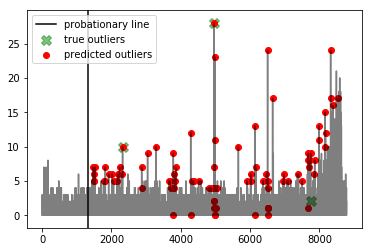




--- international-airline-passengers ---
Corresponding window precision:  0.5
Corresponding window recall:  1.0
Corresponding window false positives:  1
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [100, 101, 138]


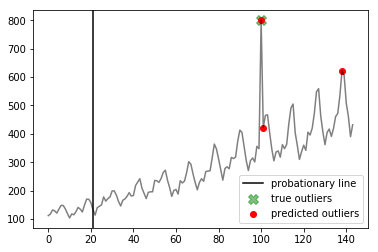




--- exchange-3_cpc_results ---
Corresponding window precision:  0.375
Corresponding window recall:  1.0
Corresponding window false positives:  5
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [322, 323, 466, 467, 901, 973, 1011, 1016, 1017, 1018, 1019, 1022, 1041, 1043, 1044, 1047, 1051, 1055, 1065, 1193, 1194, 1531, 1536]


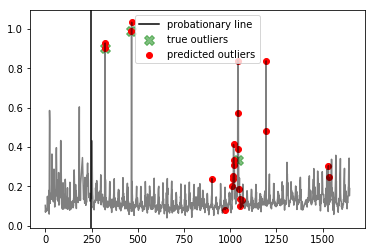




--- ambient_temperature_system_failure ---
Corresponding window precision:  0.16666666666666666
Corresponding window recall:  1.0
Corresponding window false positives:  10
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [1602, 1608, 1610, 1860, 1861, 1863, 1866, 2014, 2015, 2017, 2021, 2038, 2039, 2040, 2041, 2042, 2043, 2044, 2045, 2046, 2049, 2518, 2693, 3115, 3342, 3639, 3641, 3643, 3933, 3935, 3936, 3938, 3940, 3942, 3943, 3946, 4105, 4123, 4124, 4125, 4126, 4127, 4129, 4131, 4627, 4628, 4629, 4630, 4631, 4633, 4634, 4635, 4636, 4637, 4638, 4639, 4640, 5152, 5439, 5440, 5441, 5442, 5443, 5444, 5446, 5447, 5448, 5449, 5463, 5466, 5467, 5468, 5469, 5470, 5471, 5769, 5770, 5771, 5772, 5773, 5774, 5775, 5776, 5777, 5778, 5779, 5780, 5781, 5782, 5783, 5784, 5785, 5786, 5787, 5788, 5789, 5790, 5791, 5792, 5793, 5794, 5795, 5796, 5797, 5798, 5799, 5800, 5801, 5802, 5803, 5804, 5805, 5806, 5807, 5808, 5809, 5810, 5811, 5812, 5813, 6780

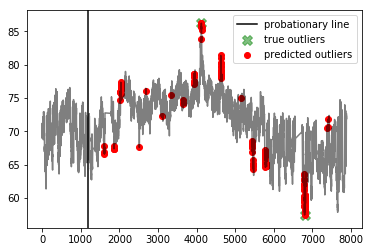




--- exchange-2_cpm_results ---
Corresponding window precision:  0.25
Corresponding window recall:  1.0
Corresponding window false positives:  6
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [360, 365, 420, 601, 664, 665, 689, 899, 923, 975, 976, 977, 978, 1001, 1002, 1016, 1045, 1520, 1521, 1522, 1545]


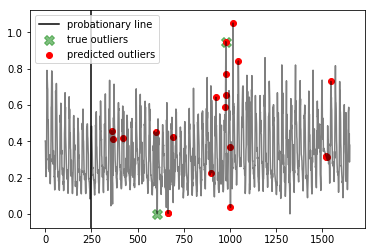




--- exchange-3_cpm_results ---
Corresponding window precision:  0.5
Corresponding window recall:  1.0
Corresponding window false positives:  1
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [685, 686, 687, 688, 689, 690, 691, 692, 693, 694, 695, 696, 697, 698, 699, 700, 701, 702, 703, 704, 705, 706, 707, 708, 709, 710, 711, 712, 713, 714, 715, 716, 717, 1193, 1194, 1195, 1196, 1197, 1198, 1199, 1200, 1201, 1202, 1203, 1204, 1205, 1206, 1207, 1208, 1209, 1210, 1211, 1212, 1213, 1214, 1215, 1216, 1218, 1219, 1220, 1221, 1222]


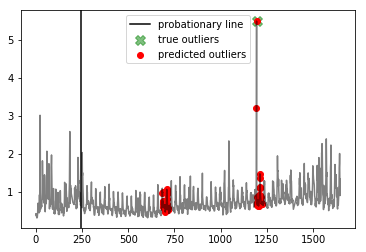




--- exchange-2_cpc_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  2
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [1046, 1142, 1484, 1485, 1486, 1487, 1493, 1494, 1520]


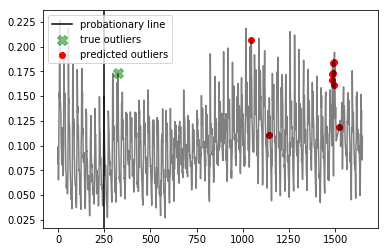

---------weight_fp=0.2, weight_fn=1----------


----Window-Based Results----
Minimum number of mistakes:  6.4
Best window threshold:  1.0
Corresponding window overall precision:  0.5714285714285714
Corresponding window overall recall:  0.6153846153846154
Corresponding window overall F score:  0.5925925925925927



--- all_data_gift_certificates ---
Corresponding window precision:  0.3333333333333333
Corresponding window recall:  1.0
Corresponding window false positives:  6
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [2320, 3785, 4286, 4963, 4964, 4986, 4987, 4992, 5662, 6137, 6505, 6506, 7746]


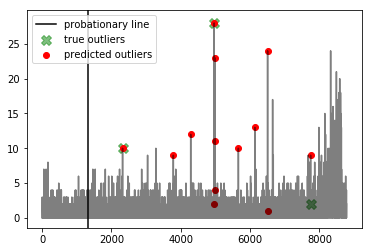




--- international-airline-passengers ---
Corresponding window precision:  1.0
Corresponding window recall:  1.0
Corresponding window false positives:  0
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [100, 101]


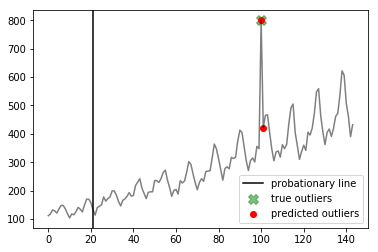




--- exchange-3_cpc_results ---
Corresponding window precision:  0.75
Corresponding window recall:  1.0
Corresponding window false positives:  1
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [322, 323, 466, 467, 1018, 1041, 1044, 1194]


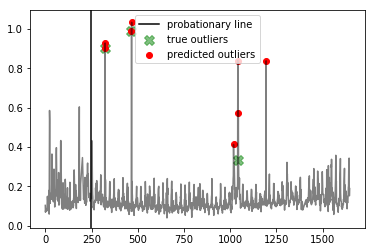




--- ambient_temperature_system_failure ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  []


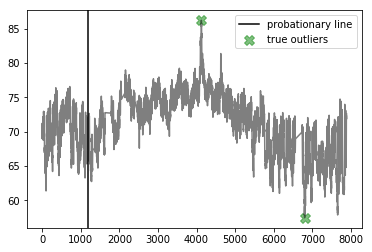




--- exchange-2_cpm_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  []


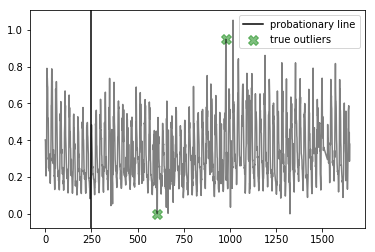




--- exchange-3_cpm_results ---
Corresponding window precision:  1.0
Corresponding window recall:  1.0
Corresponding window false positives:  0
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [1194, 1195, 1196, 1197]


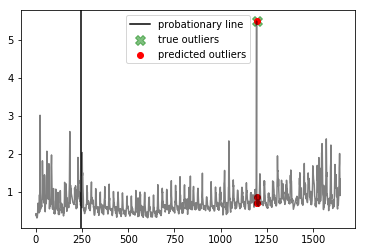




--- exchange-2_cpc_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  []


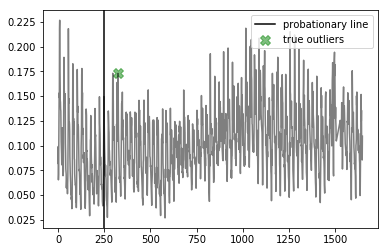

---------weight_fp=0.3, weight_fn=1----------


----Window-Based Results----
Minimum number of mistakes:  7.1
Best window threshold:  1.0
Corresponding window overall precision:  0.5714285714285714
Corresponding window overall recall:  0.6153846153846154
Corresponding window overall F score:  0.5925925925925927



--- all_data_gift_certificates ---
Corresponding window precision:  0.3333333333333333
Corresponding window recall:  1.0
Corresponding window false positives:  6
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [2320, 3785, 4286, 4963, 4964, 4986, 4987, 4992, 5662, 6137, 6505, 6506, 7746]


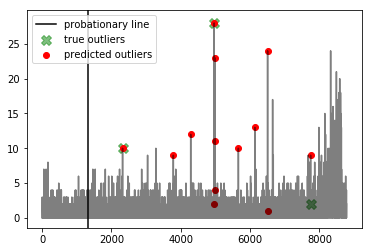




--- international-airline-passengers ---
Corresponding window precision:  1.0
Corresponding window recall:  1.0
Corresponding window false positives:  0
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [100, 101]


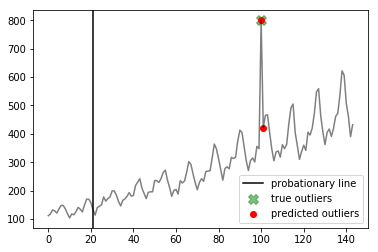




--- exchange-3_cpc_results ---
Corresponding window precision:  0.75
Corresponding window recall:  1.0
Corresponding window false positives:  1
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [322, 323, 466, 467, 1018, 1041, 1044, 1194]


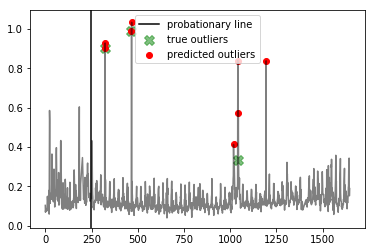




--- ambient_temperature_system_failure ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  []


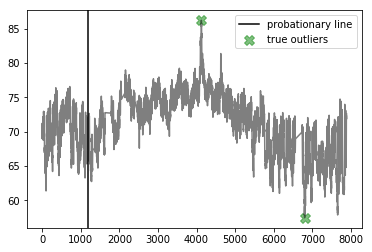




--- exchange-2_cpm_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  []


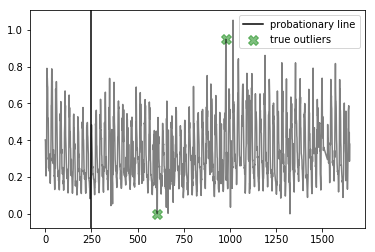




--- exchange-3_cpm_results ---
Corresponding window precision:  1.0
Corresponding window recall:  1.0
Corresponding window false positives:  0
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [1194, 1195, 1196, 1197]


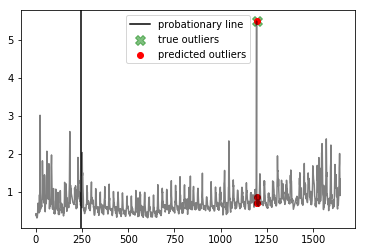




--- exchange-2_cpc_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  []


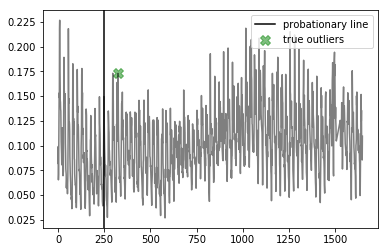

---------weight_fp=0.4, weight_fn=1----------


----Window-Based Results----
Minimum number of mistakes:  7.800000000000001
Best window threshold:  1.0
Corresponding window overall precision:  0.5714285714285714
Corresponding window overall recall:  0.6153846153846154
Corresponding window overall F score:  0.5925925925925927



--- all_data_gift_certificates ---
Corresponding window precision:  0.3333333333333333
Corresponding window recall:  1.0
Corresponding window false positives:  6
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [2320, 3785, 4286, 4963, 4964, 4986, 4987, 4992, 5662, 6137, 6505, 6506, 7746]


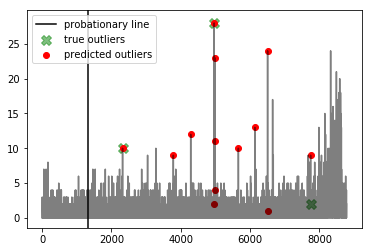




--- international-airline-passengers ---
Corresponding window precision:  1.0
Corresponding window recall:  1.0
Corresponding window false positives:  0
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [100, 101]


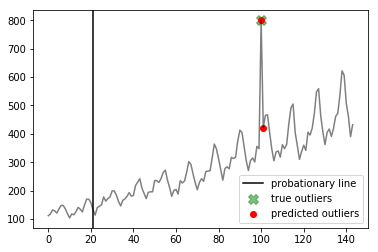




--- exchange-3_cpc_results ---
Corresponding window precision:  0.75
Corresponding window recall:  1.0
Corresponding window false positives:  1
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [322, 323, 466, 467, 1018, 1041, 1044, 1194]


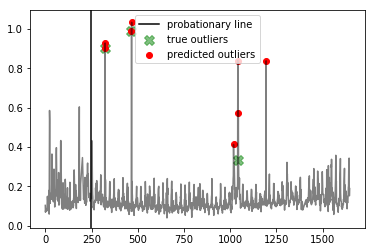




--- ambient_temperature_system_failure ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  []


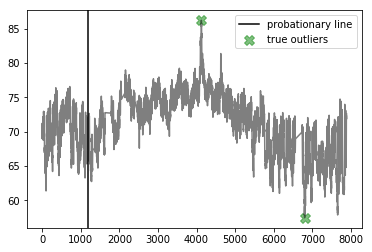




--- exchange-2_cpm_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  []


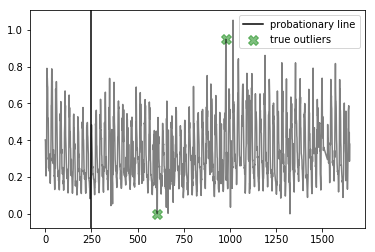




--- exchange-3_cpm_results ---
Corresponding window precision:  1.0
Corresponding window recall:  1.0
Corresponding window false positives:  0
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [1194, 1195, 1196, 1197]


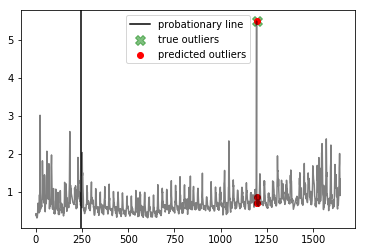




--- exchange-2_cpc_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  []


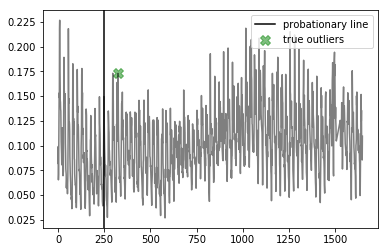

---------weight_fp=0.5, weight_fn=1----------


----Window-Based Results----
Minimum number of mistakes:  8.5
Best window threshold:  1.0
Corresponding window overall precision:  0.5714285714285714
Corresponding window overall recall:  0.6153846153846154
Corresponding window overall F score:  0.5925925925925927



--- all_data_gift_certificates ---
Corresponding window precision:  0.3333333333333333
Corresponding window recall:  1.0
Corresponding window false positives:  6
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [2320, 3785, 4286, 4963, 4964, 4986, 4987, 4992, 5662, 6137, 6505, 6506, 7746]


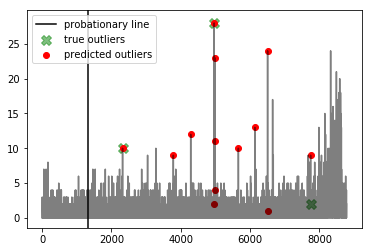




--- international-airline-passengers ---
Corresponding window precision:  1.0
Corresponding window recall:  1.0
Corresponding window false positives:  0
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [100, 101]


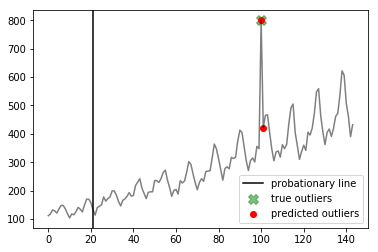




--- exchange-3_cpc_results ---
Corresponding window precision:  0.75
Corresponding window recall:  1.0
Corresponding window false positives:  1
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [322, 323, 466, 467, 1018, 1041, 1044, 1194]


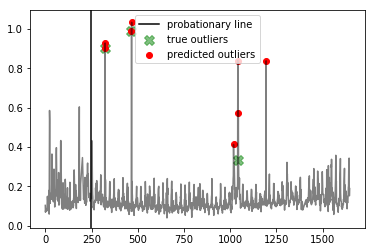




--- ambient_temperature_system_failure ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  []


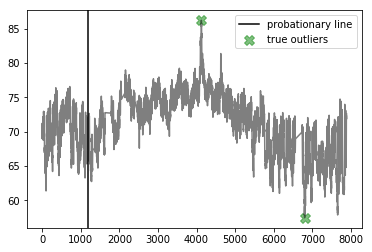




--- exchange-2_cpm_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  []


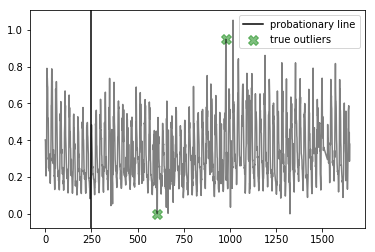




--- exchange-3_cpm_results ---
Corresponding window precision:  1.0
Corresponding window recall:  1.0
Corresponding window false positives:  0
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [1194, 1195, 1196, 1197]


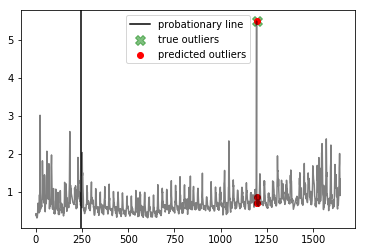




--- exchange-2_cpc_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  []


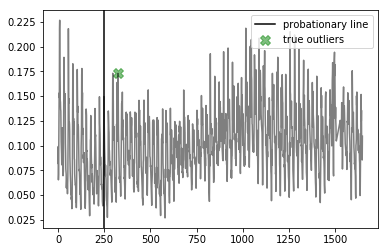

---------weight_fp=0.6, weight_fn=1----------


----Window-Based Results----
Minimum number of mistakes:  9.2
Best window threshold:  1.0
Corresponding window overall precision:  0.5714285714285714
Corresponding window overall recall:  0.6153846153846154
Corresponding window overall F score:  0.5925925925925927



--- all_data_gift_certificates ---
Corresponding window precision:  0.3333333333333333
Corresponding window recall:  1.0
Corresponding window false positives:  6
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [2320, 3785, 4286, 4963, 4964, 4986, 4987, 4992, 5662, 6137, 6505, 6506, 7746]


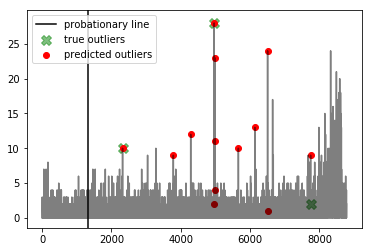




--- international-airline-passengers ---
Corresponding window precision:  1.0
Corresponding window recall:  1.0
Corresponding window false positives:  0
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [100, 101]


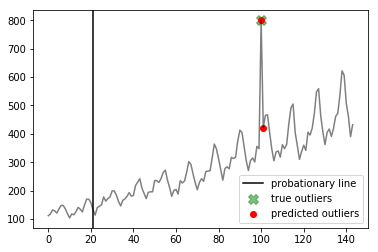




--- exchange-3_cpc_results ---
Corresponding window precision:  0.75
Corresponding window recall:  1.0
Corresponding window false positives:  1
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [322, 323, 466, 467, 1018, 1041, 1044, 1194]


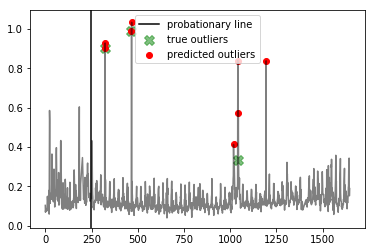




--- ambient_temperature_system_failure ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  []


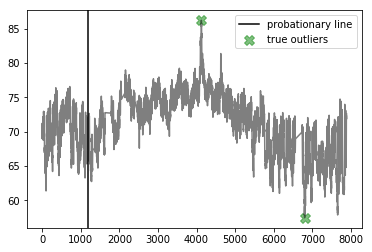




--- exchange-2_cpm_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  []


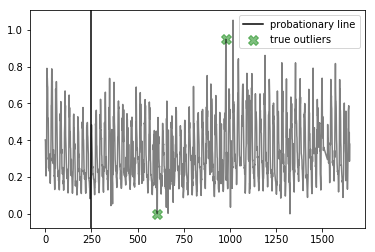




--- exchange-3_cpm_results ---
Corresponding window precision:  1.0
Corresponding window recall:  1.0
Corresponding window false positives:  0
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [1194, 1195, 1196, 1197]


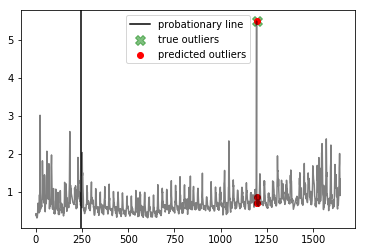




--- exchange-2_cpc_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  []


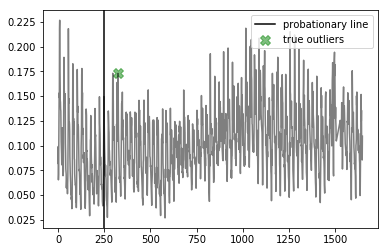

---------weight_fp=0.7, weight_fn=1----------


----Window-Based Results----
Minimum number of mistakes:  9.899999999999999
Best window threshold:  1.0
Corresponding window overall precision:  0.5714285714285714
Corresponding window overall recall:  0.6153846153846154
Corresponding window overall F score:  0.5925925925925927



--- all_data_gift_certificates ---
Corresponding window precision:  0.3333333333333333
Corresponding window recall:  1.0
Corresponding window false positives:  6
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [2320, 3785, 4286, 4963, 4964, 4986, 4987, 4992, 5662, 6137, 6505, 6506, 7746]


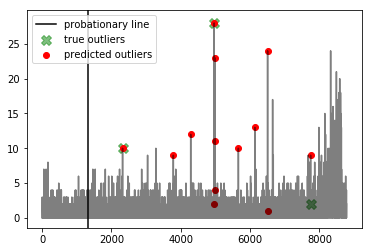




--- international-airline-passengers ---
Corresponding window precision:  1.0
Corresponding window recall:  1.0
Corresponding window false positives:  0
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [100, 101]


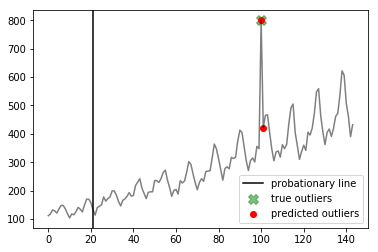




--- exchange-3_cpc_results ---
Corresponding window precision:  0.75
Corresponding window recall:  1.0
Corresponding window false positives:  1
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [322, 323, 466, 467, 1018, 1041, 1044, 1194]


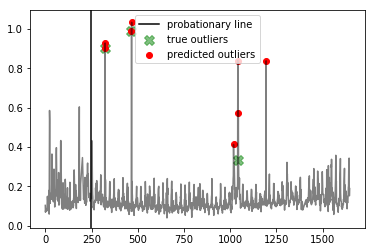




--- ambient_temperature_system_failure ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  []


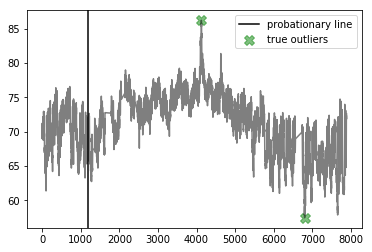




--- exchange-2_cpm_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  []


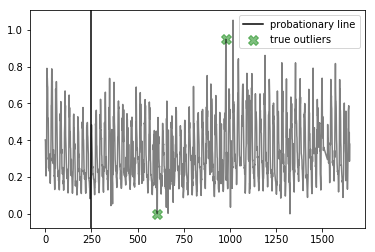




--- exchange-3_cpm_results ---
Corresponding window precision:  1.0
Corresponding window recall:  1.0
Corresponding window false positives:  0
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [1194, 1195, 1196, 1197]


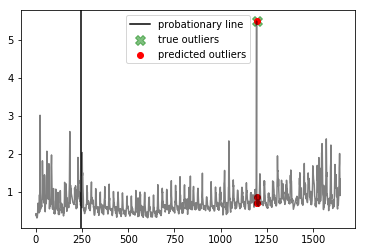




--- exchange-2_cpc_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  []


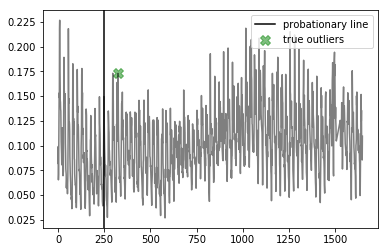

---------weight_fp=0.8, weight_fn=1----------


----Window-Based Results----
Minimum number of mistakes:  10.600000000000001
Best window threshold:  1.0
Corresponding window overall precision:  0.5714285714285714
Corresponding window overall recall:  0.6153846153846154
Corresponding window overall F score:  0.5925925925925927



--- all_data_gift_certificates ---
Corresponding window precision:  0.3333333333333333
Corresponding window recall:  1.0
Corresponding window false positives:  6
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [2320, 3785, 4286, 4963, 4964, 4986, 4987, 4992, 5662, 6137, 6505, 6506, 7746]


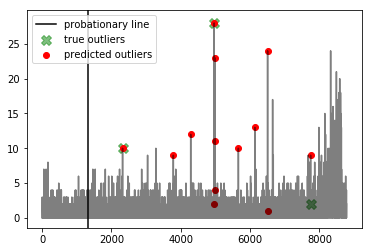




--- international-airline-passengers ---
Corresponding window precision:  1.0
Corresponding window recall:  1.0
Corresponding window false positives:  0
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [100, 101]


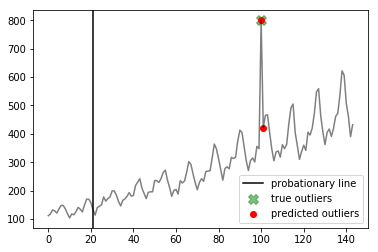




--- exchange-3_cpc_results ---
Corresponding window precision:  0.75
Corresponding window recall:  1.0
Corresponding window false positives:  1
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [322, 323, 466, 467, 1018, 1041, 1044, 1194]


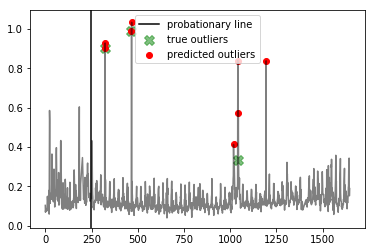




--- ambient_temperature_system_failure ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  []


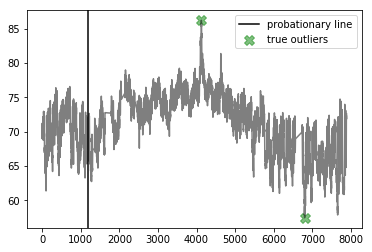




--- exchange-2_cpm_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  []


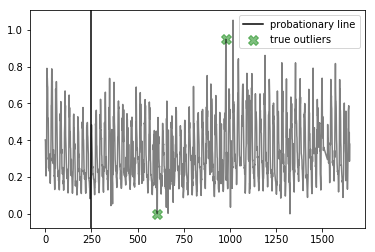




--- exchange-3_cpm_results ---
Corresponding window precision:  1.0
Corresponding window recall:  1.0
Corresponding window false positives:  0
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [1194, 1195, 1196, 1197]


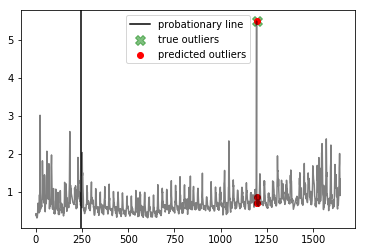




--- exchange-2_cpc_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  []


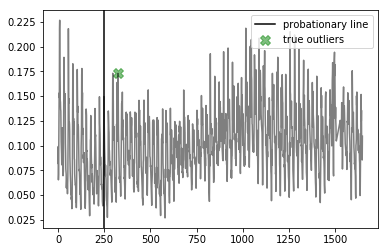

---------weight_fp=0.9, weight_fn=1----------


----Window-Based Results----
Minimum number of mistakes:  11.3
Best window threshold:  1.0
Corresponding window overall precision:  0.5714285714285714
Corresponding window overall recall:  0.6153846153846154
Corresponding window overall F score:  0.5925925925925927



--- all_data_gift_certificates ---
Corresponding window precision:  0.3333333333333333
Corresponding window recall:  1.0
Corresponding window false positives:  6
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [2320, 3785, 4286, 4963, 4964, 4986, 4987, 4992, 5662, 6137, 6505, 6506, 7746]


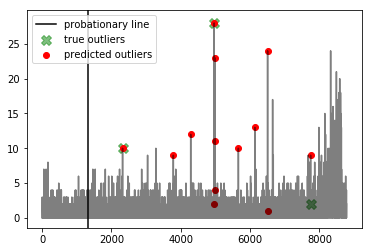




--- international-airline-passengers ---
Corresponding window precision:  1.0
Corresponding window recall:  1.0
Corresponding window false positives:  0
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [100, 101]


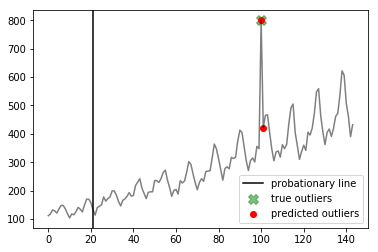




--- exchange-3_cpc_results ---
Corresponding window precision:  0.75
Corresponding window recall:  1.0
Corresponding window false positives:  1
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [322, 323, 466, 467, 1018, 1041, 1044, 1194]


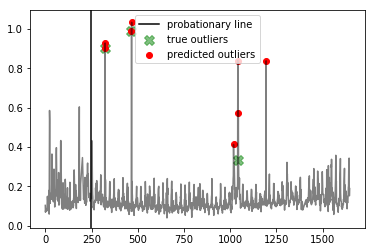




--- ambient_temperature_system_failure ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  []


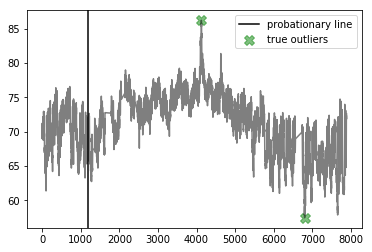




--- exchange-2_cpm_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  []


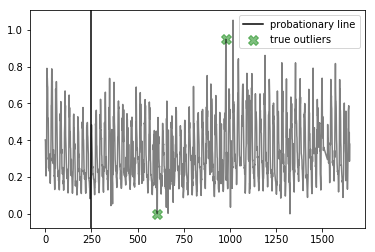




--- exchange-3_cpm_results ---
Corresponding window precision:  1.0
Corresponding window recall:  1.0
Corresponding window false positives:  0
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [1194, 1195, 1196, 1197]


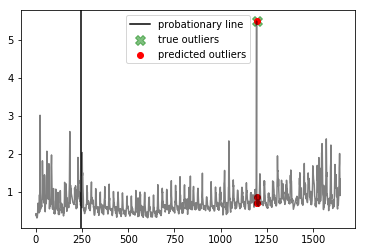




--- exchange-2_cpc_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  []


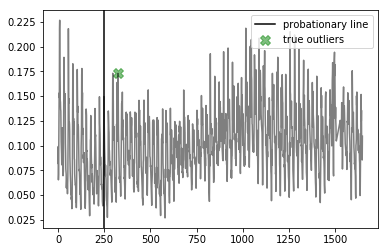

---------weight_fp=1.0, weight_fn=1----------


----Window-Based Results----
Minimum number of mistakes:  12.0
Best window threshold:  1.0
Corresponding window overall precision:  0.5714285714285714
Corresponding window overall recall:  0.6153846153846154
Corresponding window overall F score:  0.5925925925925927



--- all_data_gift_certificates ---
Corresponding window precision:  0.3333333333333333
Corresponding window recall:  1.0
Corresponding window false positives:  6
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [2320, 3785, 4286, 4963, 4964, 4986, 4987, 4992, 5662, 6137, 6505, 6506, 7746]


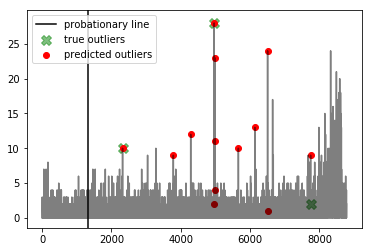




--- international-airline-passengers ---
Corresponding window precision:  1.0
Corresponding window recall:  1.0
Corresponding window false positives:  0
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [100, 101]


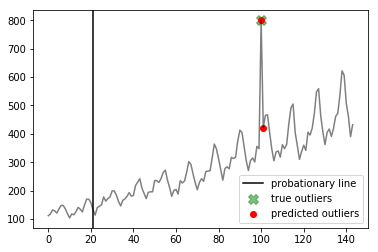




--- exchange-3_cpc_results ---
Corresponding window precision:  0.75
Corresponding window recall:  1.0
Corresponding window false positives:  1
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [322, 323, 466, 467, 1018, 1041, 1044, 1194]


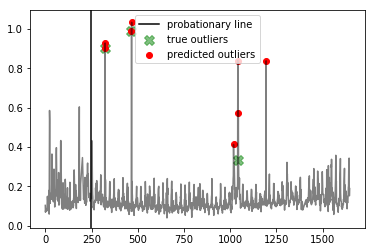




--- ambient_temperature_system_failure ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  []


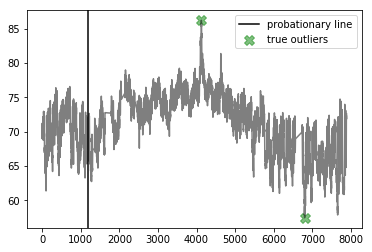




--- exchange-2_cpm_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  []


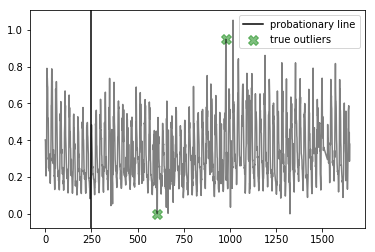




--- exchange-3_cpm_results ---
Corresponding window precision:  1.0
Corresponding window recall:  1.0
Corresponding window false positives:  0
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [1194, 1195, 1196, 1197]


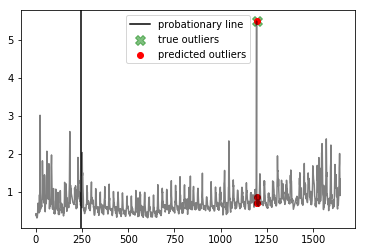




--- exchange-2_cpc_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  []


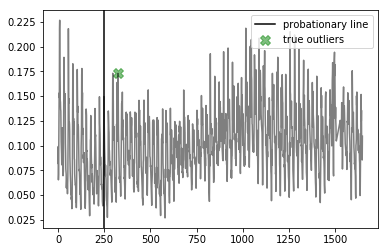

------------
False Positive Weight:  0.1
	 Minimum number of mistakes : 5.6000000000000005
	 Best window threshold : 0.9999
	 Corresponding window overall precision : 0.17647058823529413
	 Corresponding window overall recall : 0.9230769230769231
	 Corresponding window overall F score : 0.29629629629629634
False Positive Weight:  0.2
	 Minimum number of mistakes : 6.4
	 Best window threshold : 1.0
	 Corresponding window overall precision : 0.5714285714285714
	 Corresponding window overall recall : 0.6153846153846154
	 Corresponding window overall F score : 0.5925925925925927
False Positive Weight:  0.3
	 Minimum number of mistakes : 7.1
	 Best window threshold : 1.0
	 Corresponding window overall precision : 0.5714285714285714
	 Corresponding window overall recall : 0.6153846153846154
	 Corresponding window overall F score : 0.5925925925925927
False Positive Weight:  0.6
	 Minimum number of mistakes : 9.2
	 Best window threshold : 1.0
	 Corresponding window overall precision : 0.5714285

In [17]:
end_results = {}
for weight_fp in weight_fp_list:  
    print("---------weight_fp=" + str(weight_fp) + ", weight_fn=1----------")
    weight_result = adclasses.pretty_print_results(sarima_ad_dict, anomaly_scores_dict, sarima_true_outlier_indices_dict, weight_fp=weight_fp, weight_fn=1)
    end_results[weight_fp] = weight_result

print("------------")
adclasses.pretty_print_end_results(end_results)

# Facebook Prophet Results

In [18]:
anomaly_scores_dict = {}

for dataset_name in dataset_name_list:
    output_dict_prophet = joblib.load("anomaly_scores/Prophet/" + dataset_name)
    anomaly_scores_dict[dataset_name] = output_dict_prophet["Anomaly Scores"]

In [19]:
adclasses.precision_recall_curve_info(anomaly_scores_dict, true_outlier_indices_dict)

{0.1: {'precision': 0.11538461538461539, 'recall': 1.0},
 0.2: {'precision': 0.11538461538461539, 'recall': 1.0},
 0.3: {'precision': 0.11538461538461539, 'recall': 1.0},
 0.4: {'precision': 0.11538461538461539, 'recall': 1.0},
 0.5: {'precision': 0.11538461538461539, 'recall': 1.0},
 0.6: {'precision': 0.11538461538461539, 'recall': 1.0},
 0.7: {'precision': 0.11538461538461539, 'recall': 1.0},
 0.8: {'precision': 0.11538461538461539, 'recall': 1.0},
 0.9: {'precision': 0.12, 'recall': 1.0},
 1.0: {'precision': 0.0, 'recall': 0.0}}

---------weight_fp=0.1, weight_fn=1----------


----Window-Based Results----
Minimum number of mistakes:  8.3
Best window threshold:  0.9997
Corresponding window overall precision:  0.21
Corresponding window overall recall:  0.9130434782608695
Corresponding window overall F score:  0.34146341463414626



--- all_data_gift_certificates ---
Corresponding window precision:  0.125
Corresponding window recall:  1.0
Corresponding window false positives:  21
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [1438, 1462, 1483, 1487, 1505, 1531, 1822, 1918, 2009, 2059, 2157, 2176, 2233, 2304, 2320, 2471, 2667, 2871, 2894, 2899, 2905, 2974, 3014, 3016, 3042, 3053, 3281, 3389, 3664, 3676, 3688, 3711, 3729, 3734, 3785, 3790, 3805, 3810, 3841, 3842, 3855, 4286, 4317, 4341, 4516, 4578, 4946, 4961, 4963, 4986, 4992, 5055, 5662, 5905, 6014, 6019, 6137, 6167, 6375, 6471, 6505, 6517, 6522, 6650, 6669, 6960, 6978, 7073, 7100, 7366, 7396, 7655, 7656, 7677,

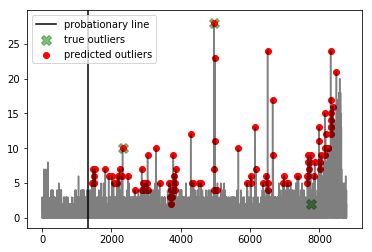




--- international-airline-passengers ---
Corresponding window precision:  0.5
Corresponding window recall:  1.0
Corresponding window false positives:  1
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [100, 138]


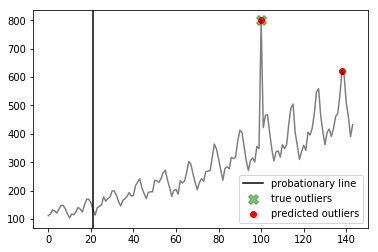




--- exchange-3_cpc_results ---
Corresponding window precision:  0.3
Corresponding window recall:  1.0
Corresponding window false positives:  7
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [322, 323, 466, 467, 757, 836, 973, 1011, 1014, 1016, 1017, 1018, 1019, 1022, 1023, 1041, 1042, 1043, 1044, 1045, 1050, 1193, 1194, 1531, 1571]


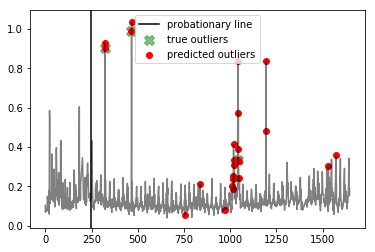




--- nyc_taxi ---
Corresponding window precision:  0.3333333333333333
Corresponding window recall:  0.8
Corresponding window false positives:  8
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [1887, 1888, 1889, 1936, 2558, 2559, 2560, 2561, 2562, 2608, 2895, 2896, 2897, 2898, 2944, 2945, 4272, 4273, 4274, 4275, 4276, 4277, 4575, 4576, 5954, 5955, 6628, 8270, 8271, 8272, 8535, 8536, 8537, 8538, 8833, 8834, 8835, 8836, 8837, 8838, 8839, 8840, 10069, 10070, 10071, 10072, 10073, 10074, 10075, 10076, 10077, 10078, 10079, 10080, 10097, 10098]


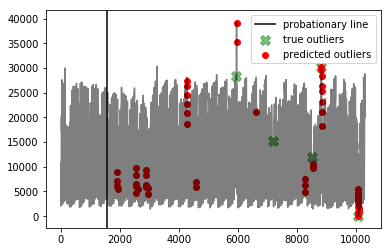




--- elb_request_count_8c0756 ---
Corresponding window precision:  0.16666666666666666
Corresponding window recall:  1.0
Corresponding window false positives:  10
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [741, 783, 786, 790, 791, 926, 1140, 1359, 1403, 1418, 1586, 1978, 1979, 2497, 2517, 2551, 2556, 2595, 3052, 3069, 3087, 3116, 3327, 3378, 3427, 3455, 3658, 3690, 3693, 3767, 3957, 4026]


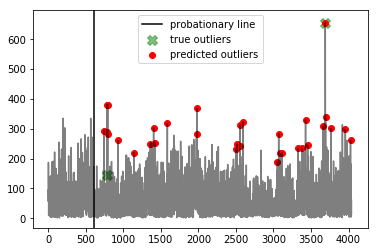




--- ambient_temperature_system_failure ---
Corresponding window precision:  0.2
Corresponding window recall:  1.0
Corresponding window false positives:  8
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [1858, 1859, 1860, 1861, 1862, 1863, 1864, 1865, 1866, 1867, 1868, 1869, 1870, 1871, 1872, 1873, 1874, 1875, 1876, 1878, 1883, 1884, 1885, 1886, 1887, 1888, 1889, 1890, 1891, 1894, 1906, 1909, 1911, 1912, 1913, 2518, 2887, 2925, 2928, 2930, 2932, 2933, 2937, 2949, 2950, 2951, 2953, 2954, 3603, 3604, 3605, 3606, 4101, 4102, 4103, 4104, 4105, 4106, 4107, 4108, 4109, 4110, 4111, 4112, 4113, 4114, 4115, 4118, 4119, 4120, 4121, 4122, 4123, 4124, 4125, 4126, 4127, 4128, 4129, 4130, 4131, 4132, 4133, 4134, 4135, 4136, 4137, 4607, 4610, 4611, 4612, 4613, 4614, 4615, 4617, 4618, 4619, 4624, 4625, 4626, 4627, 4628, 4629, 4630, 4631, 4632, 4633, 4634, 4635, 4636, 4637, 4638, 4639, 4640, 4641, 4642, 4643, 4644, 4646, 5439, 5440, 5441, 5442, 544

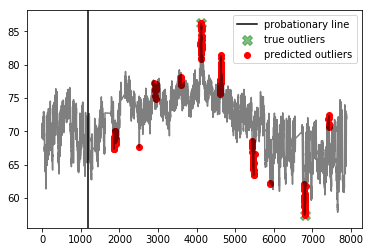




--- exchange-2_cpm_results ---
Corresponding window precision:  0.18181818181818182
Corresponding window recall:  1.0
Corresponding window false positives:  9
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [348, 360, 365, 372, 424, 601, 606, 655, 664, 665, 753, 801, 896, 899, 951, 976, 977, 978, 1002, 1016, 1045, 1104, 1280, 1469]


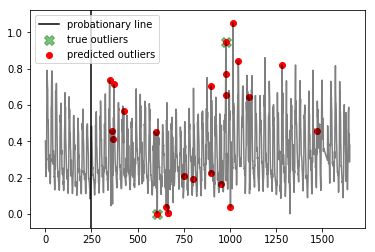




--- exchange-3_cpm_results ---
Corresponding window precision:  0.2
Corresponding window recall:  1.0
Corresponding window false positives:  4
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [780, 819, 836, 901, 1044, 1045, 1193, 1194, 1498, 1531, 1536, 1545, 1546, 1548, 1549, 1571, 1596]


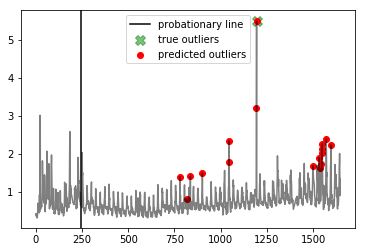




--- exchange-2_cpc_results ---
Corresponding window precision:  0.25
Corresponding window recall:  1.0
Corresponding window false positives:  3
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [325, 655, 1016, 1046, 1484, 1485, 1486, 1487, 1492, 1493, 1494, 1495, 1535]


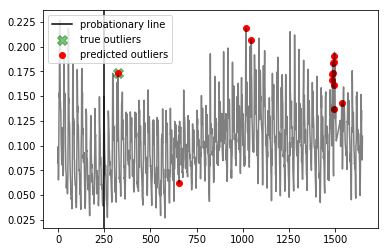




--- FARM_Bowling-Green-5-S_Warren ---
Corresponding window precision:  0.6
Corresponding window recall:  1.0
Corresponding window false positives:  2
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [733, 949, 950, 951, 952, 954, 955, 1977, 1978, 1979, 1980, 1981, 1982, 1983, 1984, 1985, 1986, 1987, 1988, 1989, 1990, 1991, 1992, 1993, 3009, 3010, 3011, 3012, 3013, 3014, 3015, 3016, 3017, 3018, 3019, 3020, 3021, 3579, 3580, 3581, 3582, 3583, 3584, 3585, 3586, 3587, 3588, 3589, 3590, 3591, 3592, 3593, 3594, 3595, 3596, 3597, 3598, 3599, 3600, 3601, 3602, 3603, 3604, 3605, 3606, 3607, 3608, 3609, 3610, 3611, 3612, 3613, 3614, 3615, 3616, 3617, 3618, 3619, 3620, 3621, 3622, 3623, 3624, 3625, 3626, 3629, 3630, 3631, 3632, 3633, 3634, 3635, 3636, 3637, 3638, 3639, 3640, 3641, 3642, 3643, 3644, 3645, 3648, 3649, 3650, 3651, 3652, 3653, 3654, 3655]


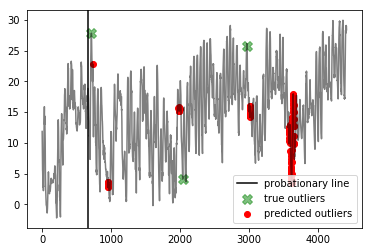

---------weight_fp=0.2, weight_fn=1----------


----Window-Based Results----
Minimum number of mistakes:  15.4
Best window threshold:  0.9999
Corresponding window overall precision:  0.2235294117647059
Corresponding window overall recall:  0.8260869565217391
Corresponding window overall F score:  0.35185185185185186



--- all_data_gift_certificates ---
Corresponding window precision:  0.13043478260869565
Corresponding window recall:  1.0
Corresponding window false positives:  20
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [1462, 1487, 1505, 1531, 1822, 1918, 2009, 2059, 2157, 2176, 2233, 2304, 2320, 2471, 2871, 2894, 2899, 2905, 3042, 3281, 3389, 3664, 3688, 3711, 3734, 3785, 3790, 3805, 3810, 3841, 3842, 3855, 4286, 4341, 4946, 4961, 4963, 4986, 4992, 5662, 5905, 6014, 6019, 6137, 6167, 6471, 6505, 6517, 6522, 6650, 6960, 6978, 7100, 7366, 7396, 7656, 7677, 7679, 7680, 7696, 7720, 7746, 7864, 7985, 7987, 7989, 8009, 8015, 8017, 

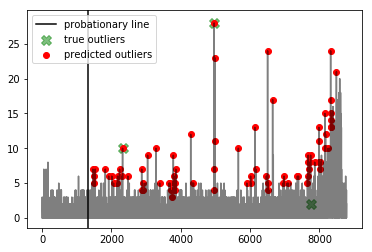




--- international-airline-passengers ---
Corresponding window precision:  0.5
Corresponding window recall:  1.0
Corresponding window false positives:  1
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [100, 138]


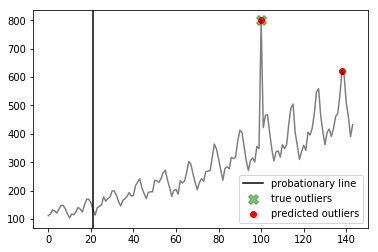




--- exchange-3_cpc_results ---
Corresponding window precision:  0.42857142857142855
Corresponding window recall:  1.0
Corresponding window false positives:  4
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [322, 323, 466, 467, 836, 1011, 1016, 1018, 1019, 1022, 1023, 1041, 1042, 1043, 1044, 1045, 1050, 1193, 1194, 1531]


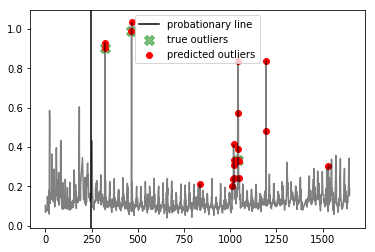




--- nyc_taxi ---
Corresponding window precision:  0.4444444444444444
Corresponding window recall:  0.8
Corresponding window false positives:  5
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [1888, 2560, 2561, 2896, 2897, 2944, 2945, 4576, 5954, 5955, 8536, 8833, 8834, 8835, 8836, 8837, 8838, 8839, 8840, 10070, 10071, 10072, 10073, 10074, 10075, 10076, 10077, 10078, 10079]


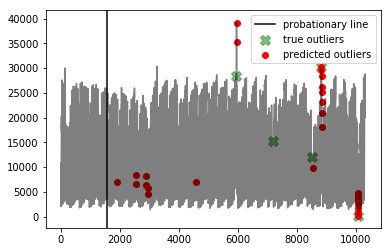




--- elb_request_count_8c0756 ---
Corresponding window precision:  0.18181818181818182
Corresponding window recall:  1.0
Corresponding window false positives:  9
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [741, 783, 786, 790, 791, 926, 1403, 1418, 1586, 1978, 2517, 2556, 2595, 3052, 3069, 3087, 3116, 3327, 3427, 3455, 3658, 3690, 3693, 3957]


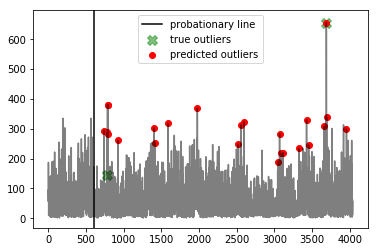




--- ambient_temperature_system_failure ---
Corresponding window precision:  0.2222222222222222
Corresponding window recall:  1.0
Corresponding window false positives:  7
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [1858, 1859, 1860, 1861, 1862, 1863, 1864, 1865, 1866, 1867, 1868, 1869, 1870, 1871, 1872, 1873, 1874, 1876, 1883, 1884, 1885, 1886, 1887, 1888, 1889, 1890, 1891, 2518, 2930, 2932, 2933, 2937, 2949, 2950, 2953, 2954, 3604, 4102, 4104, 4105, 4106, 4107, 4108, 4109, 4110, 4111, 4112, 4113, 4114, 4115, 4119, 4120, 4121, 4122, 4123, 4124, 4125, 4126, 4127, 4128, 4129, 4130, 4131, 4132, 4133, 4134, 4135, 4136, 4137, 4610, 4611, 4612, 4613, 4614, 4615, 4617, 4624, 4625, 4626, 4627, 4628, 4629, 4630, 4631, 4632, 4633, 4634, 4635, 4636, 4637, 4638, 4639, 4640, 4641, 4642, 4643, 4644, 4646, 5440, 5441, 5442, 5443, 5444, 5446, 5449, 5463, 5466, 5467, 5468, 5469, 5470, 5471, 5473, 5474, 5475, 5476, 5477, 5478, 5479, 5480, 5482, 

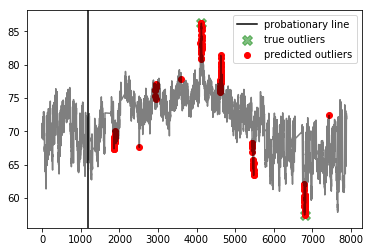




--- exchange-2_cpm_results ---
Corresponding window precision:  0.2
Corresponding window recall:  1.0
Corresponding window false positives:  8
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [348, 360, 365, 424, 601, 606, 655, 664, 665, 753, 801, 899, 976, 977, 978, 1002, 1016, 1045, 1104, 1280]


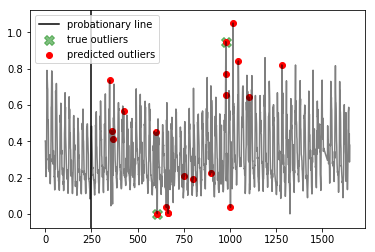




--- exchange-3_cpm_results ---
Corresponding window precision:  0.2
Corresponding window recall:  1.0
Corresponding window false positives:  4
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [780, 819, 836, 1044, 1045, 1193, 1194, 1531, 1536, 1545, 1546, 1548, 1549, 1571]


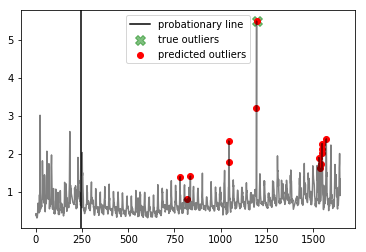




--- exchange-2_cpc_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  3
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [655, 1046, 1484, 1485, 1486, 1487, 1492, 1493, 1494, 1535]


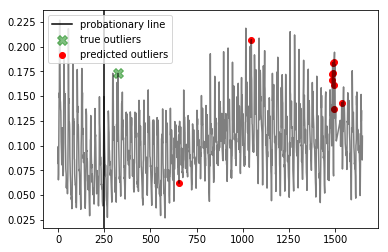




--- FARM_Bowling-Green-5-S_Warren ---
Corresponding window precision:  0.6666666666666666
Corresponding window recall:  0.6666666666666666
Corresponding window false positives:  1
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [1982, 1983, 1984, 1985, 1986, 1987, 1988, 1989, 1990, 1991, 1992, 3009, 3010, 3011, 3012, 3013, 3014, 3015, 3016, 3017, 3018, 3019, 3581, 3582, 3583, 3584, 3585, 3586, 3587, 3588, 3589, 3590, 3591, 3592, 3593, 3594, 3595, 3596, 3597, 3598, 3599, 3600, 3601, 3602, 3603, 3604, 3605, 3606, 3607, 3608, 3609, 3610, 3611, 3612, 3613, 3614, 3615, 3616, 3617, 3618, 3619, 3620, 3621, 3622, 3623, 3624, 3625, 3631, 3632, 3633, 3634, 3635, 3636, 3638, 3639, 3640, 3643, 3650, 3651, 3652, 3653, 3654, 3655]


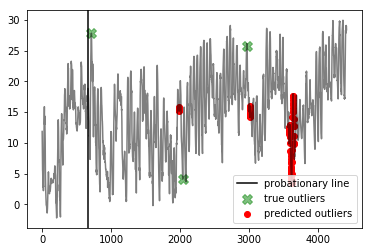

---------weight_fp=0.3, weight_fn=1----------


----Window-Based Results----
Minimum number of mistakes:  17.3
Best window threshold:  1.0
Corresponding window overall precision:  0.45
Corresponding window overall recall:  0.391304347826087
Corresponding window overall F score:  0.4186046511627907



--- all_data_gift_certificates ---
Corresponding window precision:  0.2222222222222222
Corresponding window recall:  0.6666666666666666
Corresponding window false positives:  7
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [2320, 3785, 4286, 4963, 4986, 4992, 5662, 6137, 6505, 6650, 8324]


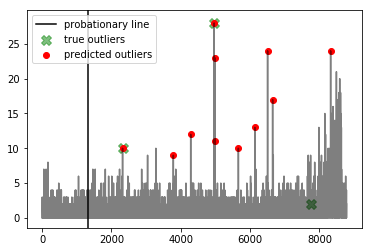




--- international-airline-passengers ---
Corresponding window precision:  1.0
Corresponding window recall:  1.0
Corresponding window false positives:  0
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [100]


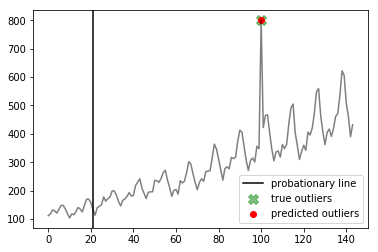




--- exchange-3_cpc_results ---
Corresponding window precision:  0.75
Corresponding window recall:  1.0
Corresponding window false positives:  1
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [322, 323, 466, 467, 1041, 1044, 1194]


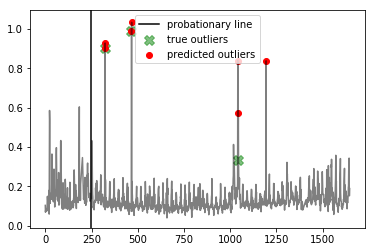




--- nyc_taxi ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  5


Outlier indices as determined by best window threshold:  []


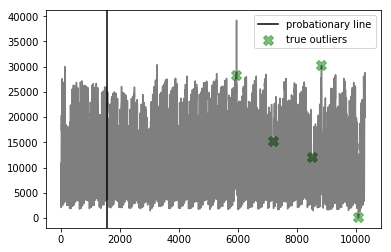




--- elb_request_count_8c0756 ---
Corresponding window precision:  1.0
Corresponding window recall:  0.5
Corresponding window false positives:  0
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [3690]


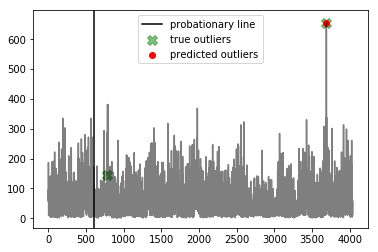




--- ambient_temperature_system_failure ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  []


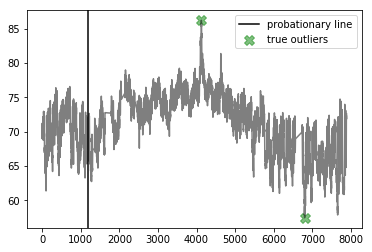




--- exchange-2_cpm_results ---
Corresponding window precision:  0.5
Corresponding window recall:  0.5
Corresponding window false positives:  1
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [977, 1016]


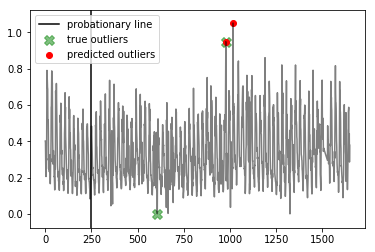




--- exchange-3_cpm_results ---
Corresponding window precision:  0.3333333333333333
Corresponding window recall:  1.0
Corresponding window false positives:  2
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [836, 1044, 1193, 1194]


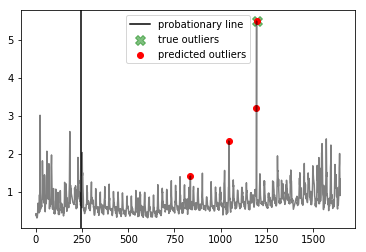




--- exchange-2_cpc_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  []


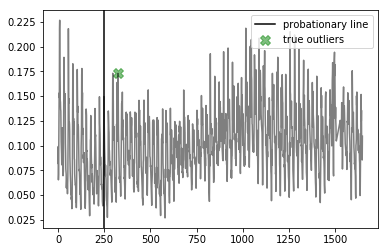




--- FARM_Bowling-Green-5-S_Warren ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  3


Outlier indices as determined by best window threshold:  []


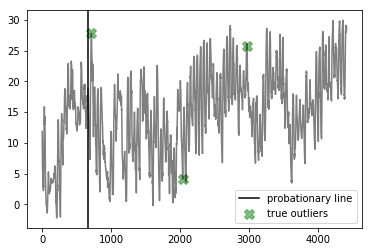

---------weight_fp=0.4, weight_fn=1----------


----Window-Based Results----
Minimum number of mistakes:  18.4
Best window threshold:  1.0
Corresponding window overall precision:  0.45
Corresponding window overall recall:  0.391304347826087
Corresponding window overall F score:  0.4186046511627907



--- all_data_gift_certificates ---
Corresponding window precision:  0.2222222222222222
Corresponding window recall:  0.6666666666666666
Corresponding window false positives:  7
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [2320, 3785, 4286, 4963, 4986, 4992, 5662, 6137, 6505, 6650, 8324]


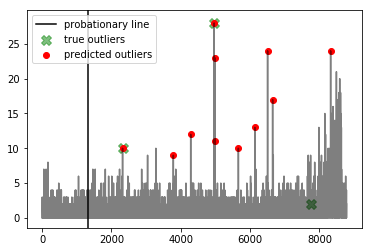




--- international-airline-passengers ---
Corresponding window precision:  1.0
Corresponding window recall:  1.0
Corresponding window false positives:  0
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [100]


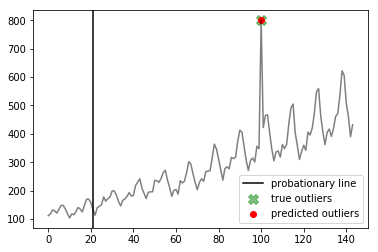




--- exchange-3_cpc_results ---
Corresponding window precision:  0.75
Corresponding window recall:  1.0
Corresponding window false positives:  1
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [322, 323, 466, 467, 1041, 1044, 1194]


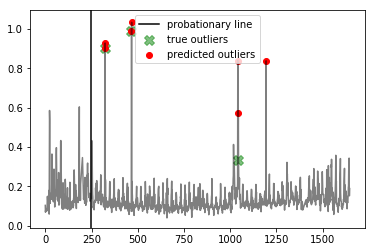




--- nyc_taxi ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  5


Outlier indices as determined by best window threshold:  []


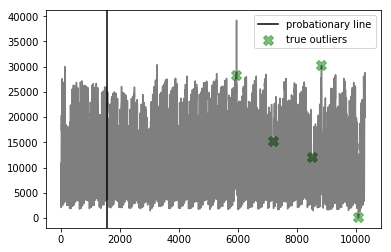




--- elb_request_count_8c0756 ---
Corresponding window precision:  1.0
Corresponding window recall:  0.5
Corresponding window false positives:  0
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [3690]


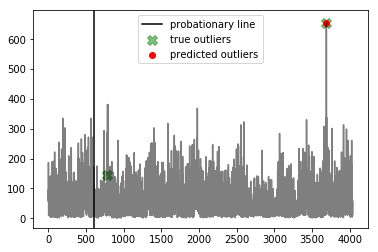




--- ambient_temperature_system_failure ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  []


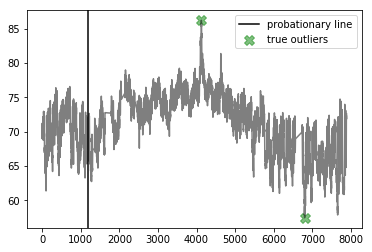




--- exchange-2_cpm_results ---
Corresponding window precision:  0.5
Corresponding window recall:  0.5
Corresponding window false positives:  1
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [977, 1016]


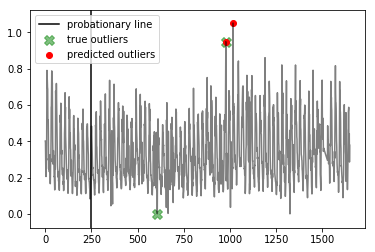




--- exchange-3_cpm_results ---
Corresponding window precision:  0.3333333333333333
Corresponding window recall:  1.0
Corresponding window false positives:  2
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [836, 1044, 1193, 1194]


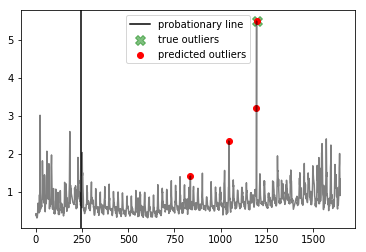




--- exchange-2_cpc_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  []


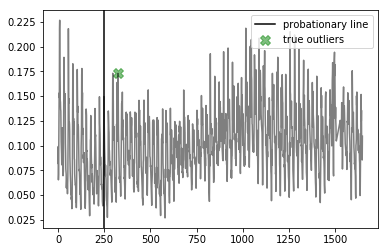




--- FARM_Bowling-Green-5-S_Warren ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  3


Outlier indices as determined by best window threshold:  []


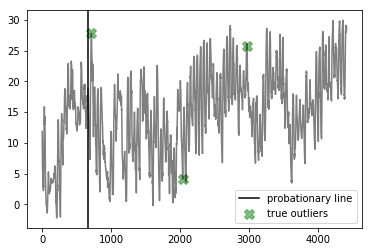

---------weight_fp=0.5, weight_fn=1----------


----Window-Based Results----
Minimum number of mistakes:  19.5
Best window threshold:  1.0
Corresponding window overall precision:  0.45
Corresponding window overall recall:  0.391304347826087
Corresponding window overall F score:  0.4186046511627907



--- all_data_gift_certificates ---
Corresponding window precision:  0.2222222222222222
Corresponding window recall:  0.6666666666666666
Corresponding window false positives:  7
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [2320, 3785, 4286, 4963, 4986, 4992, 5662, 6137, 6505, 6650, 8324]


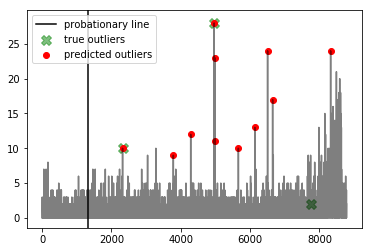




--- international-airline-passengers ---
Corresponding window precision:  1.0
Corresponding window recall:  1.0
Corresponding window false positives:  0
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [100]


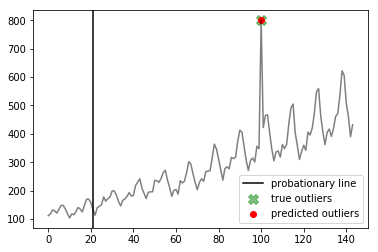




--- exchange-3_cpc_results ---
Corresponding window precision:  0.75
Corresponding window recall:  1.0
Corresponding window false positives:  1
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [322, 323, 466, 467, 1041, 1044, 1194]


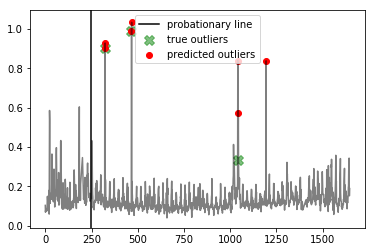




--- nyc_taxi ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  5


Outlier indices as determined by best window threshold:  []


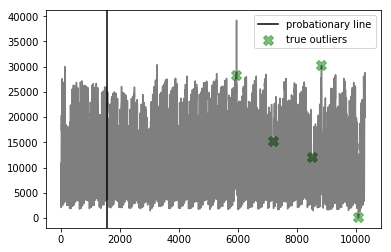




--- elb_request_count_8c0756 ---
Corresponding window precision:  1.0
Corresponding window recall:  0.5
Corresponding window false positives:  0
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [3690]


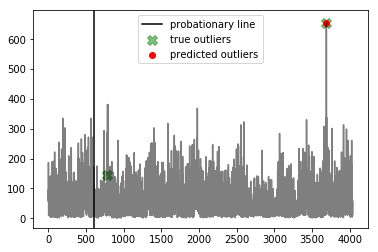




--- ambient_temperature_system_failure ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  []


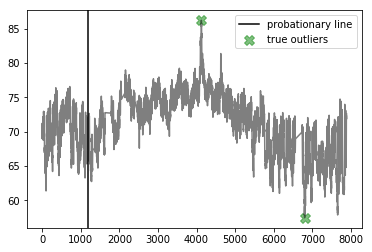




--- exchange-2_cpm_results ---
Corresponding window precision:  0.5
Corresponding window recall:  0.5
Corresponding window false positives:  1
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [977, 1016]


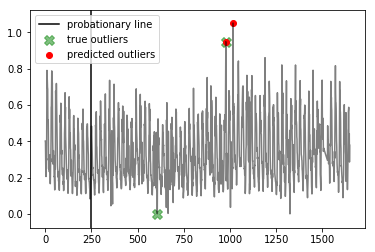




--- exchange-3_cpm_results ---
Corresponding window precision:  0.3333333333333333
Corresponding window recall:  1.0
Corresponding window false positives:  2
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [836, 1044, 1193, 1194]


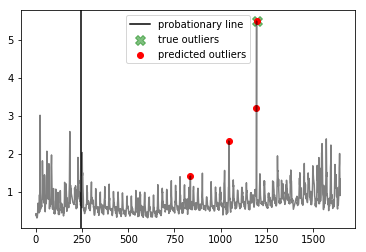




--- exchange-2_cpc_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  []


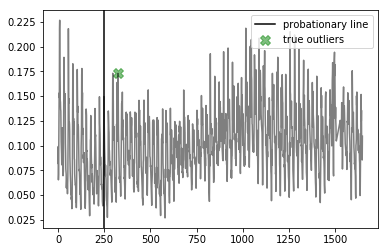




--- FARM_Bowling-Green-5-S_Warren ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  3


Outlier indices as determined by best window threshold:  []


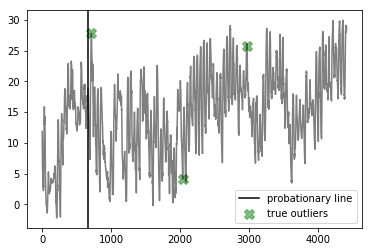

---------weight_fp=0.6, weight_fn=1----------


----Window-Based Results----
Minimum number of mistakes:  20.6
Best window threshold:  1.0
Corresponding window overall precision:  0.45
Corresponding window overall recall:  0.391304347826087
Corresponding window overall F score:  0.4186046511627907



--- all_data_gift_certificates ---
Corresponding window precision:  0.2222222222222222
Corresponding window recall:  0.6666666666666666
Corresponding window false positives:  7
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [2320, 3785, 4286, 4963, 4986, 4992, 5662, 6137, 6505, 6650, 8324]


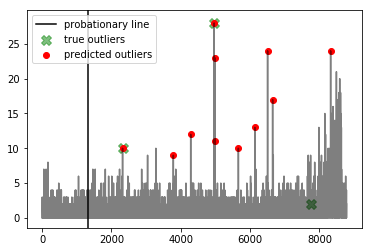




--- international-airline-passengers ---
Corresponding window precision:  1.0
Corresponding window recall:  1.0
Corresponding window false positives:  0
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [100]


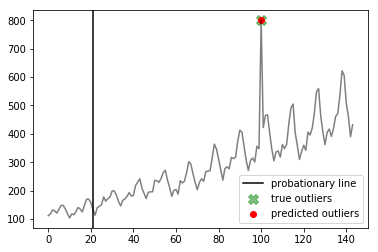




--- exchange-3_cpc_results ---
Corresponding window precision:  0.75
Corresponding window recall:  1.0
Corresponding window false positives:  1
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [322, 323, 466, 467, 1041, 1044, 1194]


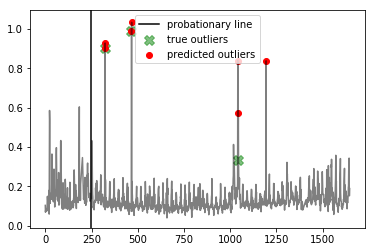




--- nyc_taxi ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  5


Outlier indices as determined by best window threshold:  []


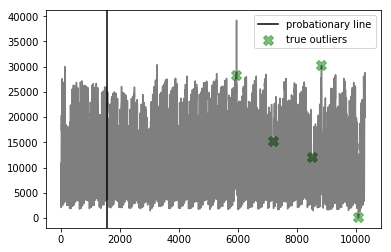




--- elb_request_count_8c0756 ---
Corresponding window precision:  1.0
Corresponding window recall:  0.5
Corresponding window false positives:  0
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [3690]


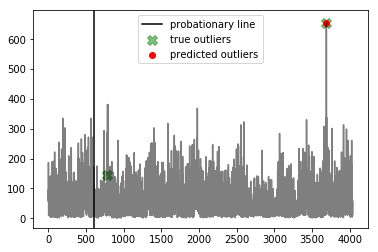




--- ambient_temperature_system_failure ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  []


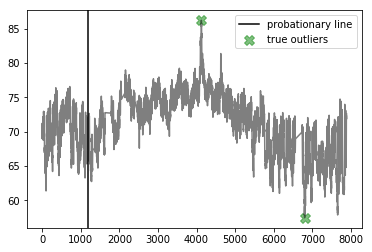




--- exchange-2_cpm_results ---
Corresponding window precision:  0.5
Corresponding window recall:  0.5
Corresponding window false positives:  1
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [977, 1016]


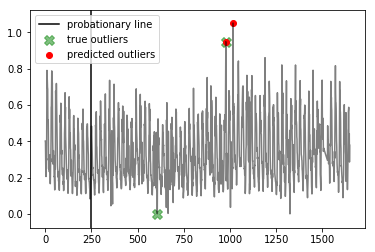




--- exchange-3_cpm_results ---
Corresponding window precision:  0.3333333333333333
Corresponding window recall:  1.0
Corresponding window false positives:  2
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [836, 1044, 1193, 1194]


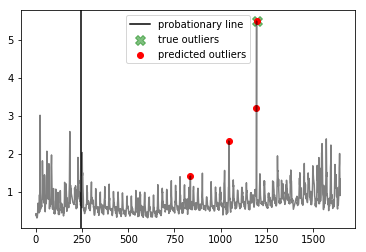




--- exchange-2_cpc_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  []


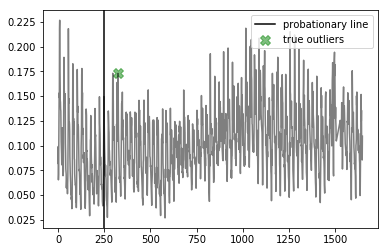




--- FARM_Bowling-Green-5-S_Warren ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  3


Outlier indices as determined by best window threshold:  []


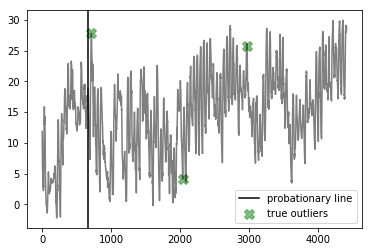

---------weight_fp=0.7, weight_fn=1----------


----Window-Based Results----
Minimum number of mistakes:  21.7
Best window threshold:  1.0
Corresponding window overall precision:  0.45
Corresponding window overall recall:  0.391304347826087
Corresponding window overall F score:  0.4186046511627907



--- all_data_gift_certificates ---
Corresponding window precision:  0.2222222222222222
Corresponding window recall:  0.6666666666666666
Corresponding window false positives:  7
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [2320, 3785, 4286, 4963, 4986, 4992, 5662, 6137, 6505, 6650, 8324]


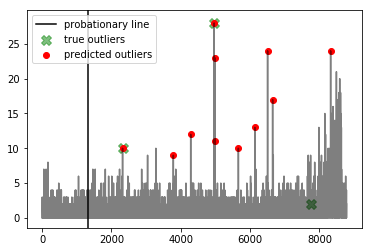




--- international-airline-passengers ---
Corresponding window precision:  1.0
Corresponding window recall:  1.0
Corresponding window false positives:  0
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [100]


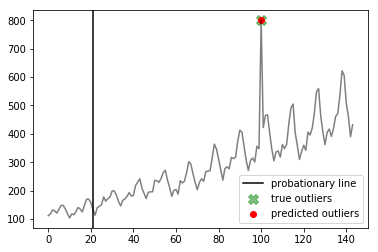




--- exchange-3_cpc_results ---
Corresponding window precision:  0.75
Corresponding window recall:  1.0
Corresponding window false positives:  1
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [322, 323, 466, 467, 1041, 1044, 1194]


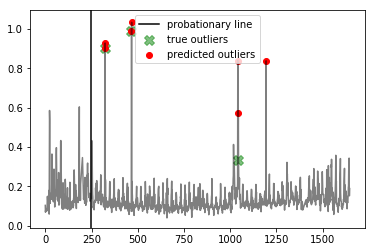




--- nyc_taxi ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  5


Outlier indices as determined by best window threshold:  []


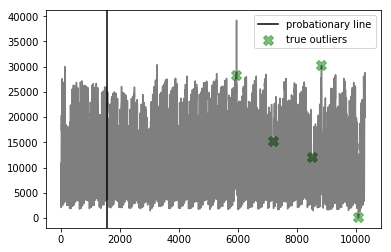




--- elb_request_count_8c0756 ---
Corresponding window precision:  1.0
Corresponding window recall:  0.5
Corresponding window false positives:  0
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [3690]


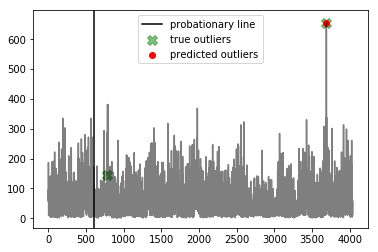




--- ambient_temperature_system_failure ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  []


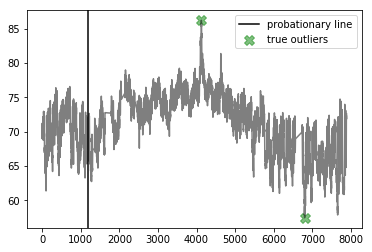




--- exchange-2_cpm_results ---
Corresponding window precision:  0.5
Corresponding window recall:  0.5
Corresponding window false positives:  1
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [977, 1016]


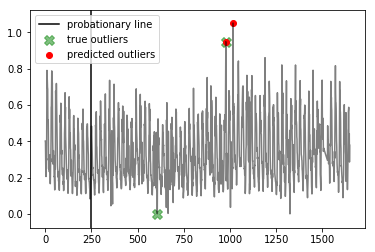




--- exchange-3_cpm_results ---
Corresponding window precision:  0.3333333333333333
Corresponding window recall:  1.0
Corresponding window false positives:  2
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [836, 1044, 1193, 1194]


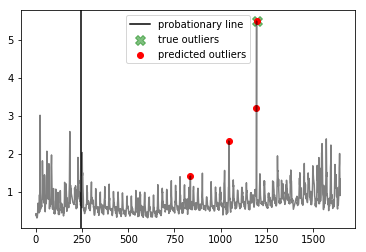




--- exchange-2_cpc_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  []


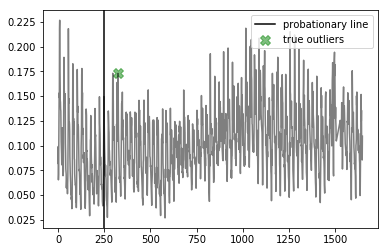




--- FARM_Bowling-Green-5-S_Warren ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  3


Outlier indices as determined by best window threshold:  []


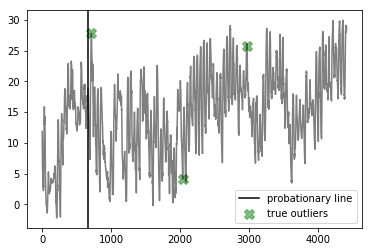

---------weight_fp=0.8, weight_fn=1----------


----Window-Based Results----
Minimum number of mistakes:  22.8
Best window threshold:  1.0
Corresponding window overall precision:  0.45
Corresponding window overall recall:  0.391304347826087
Corresponding window overall F score:  0.4186046511627907



--- all_data_gift_certificates ---
Corresponding window precision:  0.2222222222222222
Corresponding window recall:  0.6666666666666666
Corresponding window false positives:  7
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [2320, 3785, 4286, 4963, 4986, 4992, 5662, 6137, 6505, 6650, 8324]


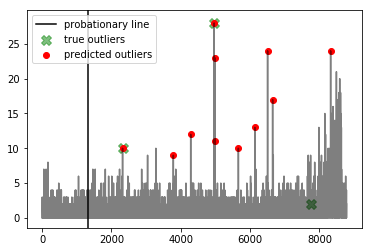




--- international-airline-passengers ---
Corresponding window precision:  1.0
Corresponding window recall:  1.0
Corresponding window false positives:  0
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [100]


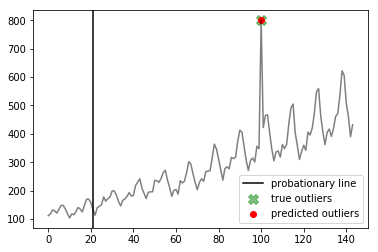




--- exchange-3_cpc_results ---
Corresponding window precision:  0.75
Corresponding window recall:  1.0
Corresponding window false positives:  1
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [322, 323, 466, 467, 1041, 1044, 1194]


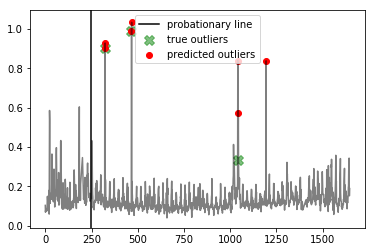




--- nyc_taxi ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  5


Outlier indices as determined by best window threshold:  []


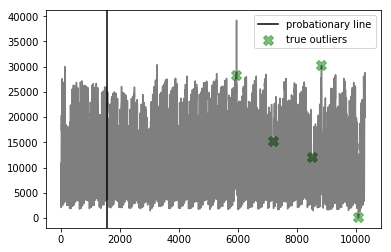




--- elb_request_count_8c0756 ---
Corresponding window precision:  1.0
Corresponding window recall:  0.5
Corresponding window false positives:  0
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [3690]


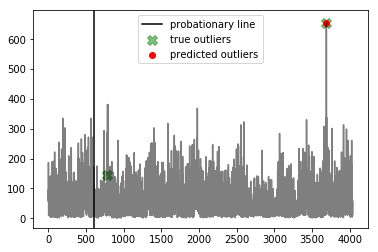




--- ambient_temperature_system_failure ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  []


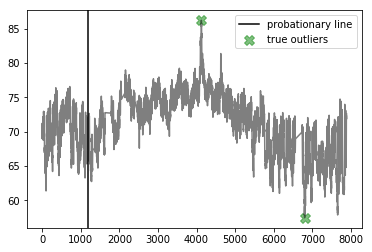




--- exchange-2_cpm_results ---
Corresponding window precision:  0.5
Corresponding window recall:  0.5
Corresponding window false positives:  1
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [977, 1016]


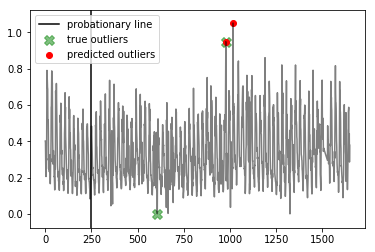




--- exchange-3_cpm_results ---
Corresponding window precision:  0.3333333333333333
Corresponding window recall:  1.0
Corresponding window false positives:  2
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [836, 1044, 1193, 1194]


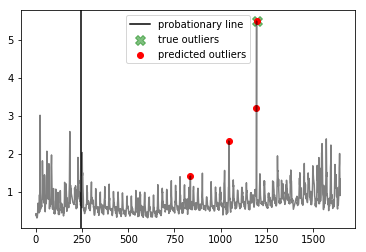




--- exchange-2_cpc_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  []


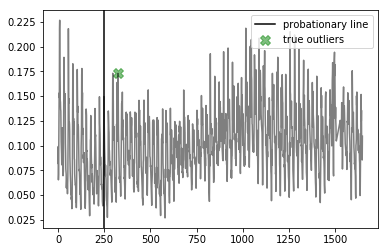




--- FARM_Bowling-Green-5-S_Warren ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  3


Outlier indices as determined by best window threshold:  []


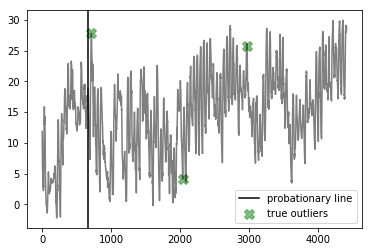

---------weight_fp=0.9, weight_fn=1----------


----Window-Based Results----
Minimum number of mistakes:  23.9
Best window threshold:  1.0
Corresponding window overall precision:  0.45
Corresponding window overall recall:  0.391304347826087
Corresponding window overall F score:  0.4186046511627907



--- all_data_gift_certificates ---
Corresponding window precision:  0.2222222222222222
Corresponding window recall:  0.6666666666666666
Corresponding window false positives:  7
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [2320, 3785, 4286, 4963, 4986, 4992, 5662, 6137, 6505, 6650, 8324]


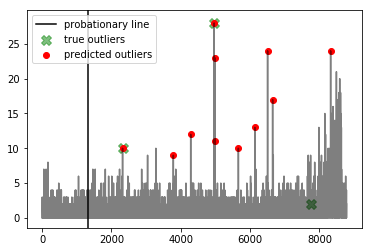




--- international-airline-passengers ---
Corresponding window precision:  1.0
Corresponding window recall:  1.0
Corresponding window false positives:  0
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [100]


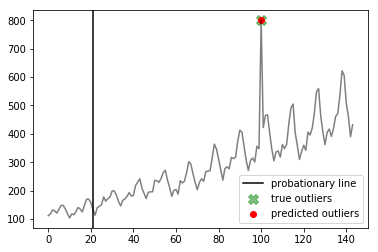




--- exchange-3_cpc_results ---
Corresponding window precision:  0.75
Corresponding window recall:  1.0
Corresponding window false positives:  1
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [322, 323, 466, 467, 1041, 1044, 1194]


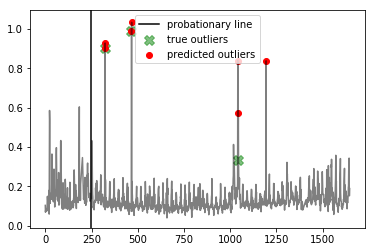




--- nyc_taxi ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  5


Outlier indices as determined by best window threshold:  []


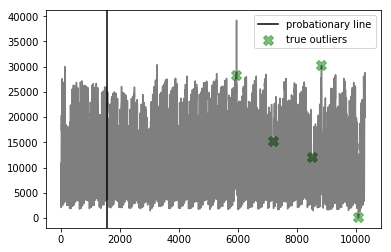




--- elb_request_count_8c0756 ---
Corresponding window precision:  1.0
Corresponding window recall:  0.5
Corresponding window false positives:  0
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [3690]


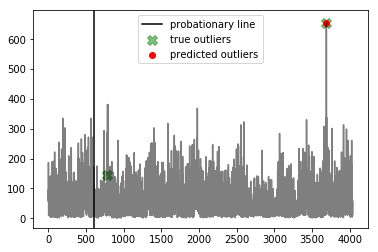




--- ambient_temperature_system_failure ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  []


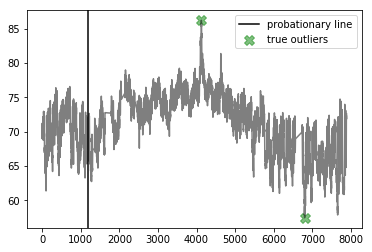




--- exchange-2_cpm_results ---
Corresponding window precision:  0.5
Corresponding window recall:  0.5
Corresponding window false positives:  1
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [977, 1016]


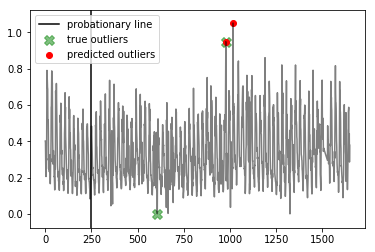




--- exchange-3_cpm_results ---
Corresponding window precision:  0.3333333333333333
Corresponding window recall:  1.0
Corresponding window false positives:  2
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [836, 1044, 1193, 1194]


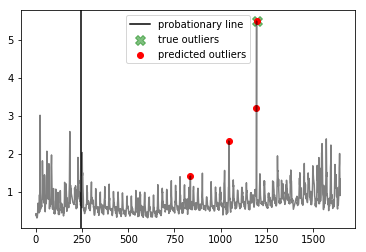




--- exchange-2_cpc_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  []


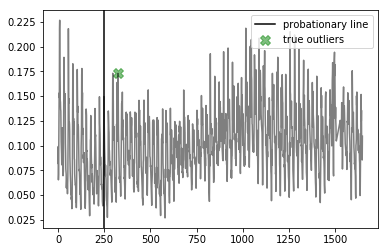




--- FARM_Bowling-Green-5-S_Warren ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  3


Outlier indices as determined by best window threshold:  []


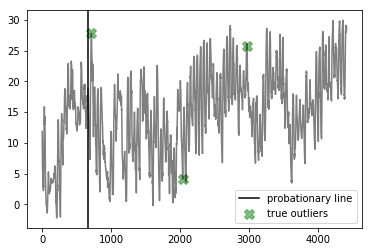

---------weight_fp=1.0, weight_fn=1----------


----Window-Based Results----
Minimum number of mistakes:  25.0
Best window threshold:  1.0
Corresponding window overall precision:  0.45
Corresponding window overall recall:  0.391304347826087
Corresponding window overall F score:  0.4186046511627907



--- all_data_gift_certificates ---
Corresponding window precision:  0.2222222222222222
Corresponding window recall:  0.6666666666666666
Corresponding window false positives:  7
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [2320, 3785, 4286, 4963, 4986, 4992, 5662, 6137, 6505, 6650, 8324]


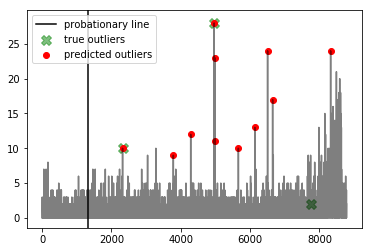




--- international-airline-passengers ---
Corresponding window precision:  1.0
Corresponding window recall:  1.0
Corresponding window false positives:  0
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [100]


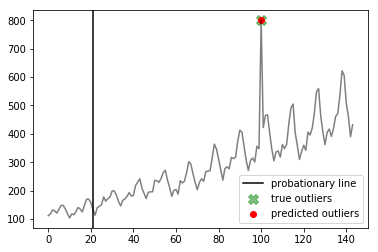




--- exchange-3_cpc_results ---
Corresponding window precision:  0.75
Corresponding window recall:  1.0
Corresponding window false positives:  1
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [322, 323, 466, 467, 1041, 1044, 1194]


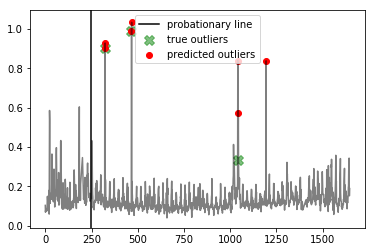




--- nyc_taxi ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  5


Outlier indices as determined by best window threshold:  []


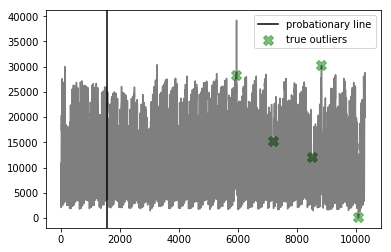




--- elb_request_count_8c0756 ---
Corresponding window precision:  1.0
Corresponding window recall:  0.5
Corresponding window false positives:  0
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [3690]


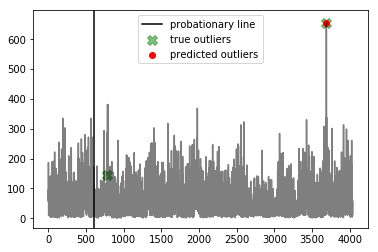




--- ambient_temperature_system_failure ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  []


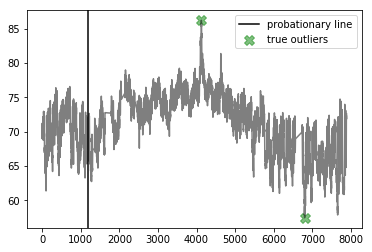




--- exchange-2_cpm_results ---
Corresponding window precision:  0.5
Corresponding window recall:  0.5
Corresponding window false positives:  1
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [977, 1016]


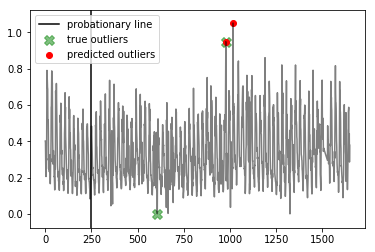




--- exchange-3_cpm_results ---
Corresponding window precision:  0.3333333333333333
Corresponding window recall:  1.0
Corresponding window false positives:  2
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [836, 1044, 1193, 1194]


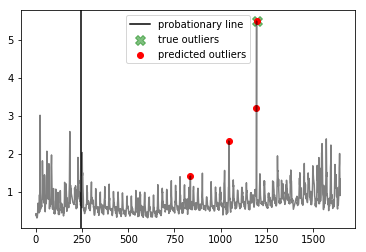




--- exchange-2_cpc_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  []


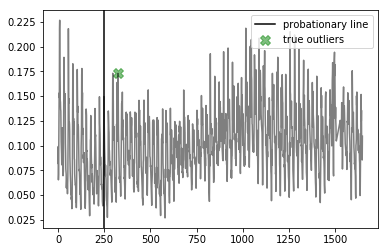




--- FARM_Bowling-Green-5-S_Warren ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  3


Outlier indices as determined by best window threshold:  []


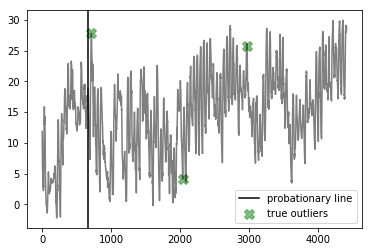

------------
False Positive Weight:  0.1
	 Minimum number of mistakes : 8.3
	 Best window threshold : 0.9997
	 Corresponding window overall precision : 0.21
	 Corresponding window overall recall : 0.9130434782608695
	 Corresponding window overall F score : 0.34146341463414626
False Positive Weight:  0.2
	 Minimum number of mistakes : 15.4
	 Best window threshold : 0.9999
	 Corresponding window overall precision : 0.2235294117647059
	 Corresponding window overall recall : 0.8260869565217391
	 Corresponding window overall F score : 0.35185185185185186
False Positive Weight:  0.3
	 Minimum number of mistakes : 17.3
	 Best window threshold : 1.0
	 Corresponding window overall precision : 0.45
	 Corresponding window overall recall : 0.391304347826087
	 Corresponding window overall F score : 0.4186046511627907
False Positive Weight:  0.6
	 Minimum number of mistakes : 20.6
	 Best window threshold : 1.0
	 Corresponding window overall precision : 0.45
	 Corresponding window overall recall : 0.

In [20]:
end_results = {}
for weight_fp in weight_fp_list:  
    print("---------weight_fp=" + str(weight_fp) + ", weight_fn=1----------")
    weight_result = adclasses.pretty_print_results(ad_dict, anomaly_scores_dict, true_outlier_indices_dict, weight_fp=weight_fp, weight_fn=1)
    end_results[weight_fp] = weight_result

print("------------")
adclasses.pretty_print_end_results(end_results)

# RNN Results

In [14]:
anomaly_scores_dict = {}

for dataset_name in dataset_name_list:
    output_dict_rnn = joblib.load("anomaly_scores/RNN/" + dataset_name)
    anomaly_scores_dict[dataset_name] = output_dict_rnn["Anomaly Scores"]

In [15]:
adclasses.precision_recall_curve_info(anomaly_scores_dict, true_outlier_indices_dict)

{0.1: {'precision': 0.11538461538461539, 'recall': 1.0},
 0.2: {'precision': 0.11538461538461539, 'recall': 1.0},
 0.3: {'precision': 0.11538461538461539, 'recall': 1.0},
 0.4: {'precision': 0.11538461538461539, 'recall': 1.0},
 0.5: {'precision': 0.11538461538461539, 'recall': 1.0},
 0.6: {'precision': 0.11538461538461539, 'recall': 1.0},
 0.7: {'precision': 0.11538461538461539, 'recall': 1.0},
 0.8: {'precision': 0.125, 'recall': 1.0},
 0.9: {'precision': 0.13636363636363635, 'recall': 1.0},
 1.0: {'precision': 0.6666666666666666, 'recall': 0.6666666666666666}}

---------weight_fp=0.1, weight_fn=1----------


----Window-Based Results----
Minimum number of mistakes:  12.399999999999999
Best window threshold:  1.0
Corresponding window overall precision:  0.44
Corresponding window overall recall:  0.4782608695652174
Corresponding window overall F score:  0.4583333333333333



--- exchange-2_cpm_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  []


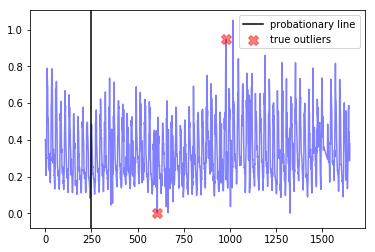




--- exchange-2_cpc_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  1
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [1487, 1488, 1489]


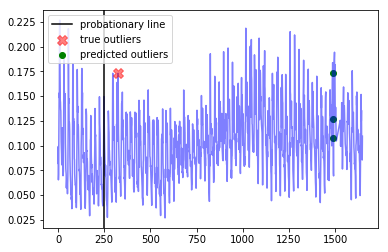




--- nyc_taxi ---
Corresponding window precision:  0.75
Corresponding window recall:  0.6
Corresponding window false positives:  1
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  [5956, 5957, 5958, 5959, 5960, 5961, 5962, 5972, 8836, 8837, 8838, 8839, 9271, 10068, 10069, 10070, 10071, 10072, 10073, 10074, 10097, 10098, 10099]


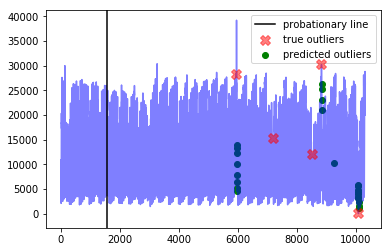




--- exchange-3_cpm_results ---
Corresponding window precision:  1.0
Corresponding window recall:  1.0
Corresponding window false positives:  0
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [1195, 1196, 1197, 1198, 1199]


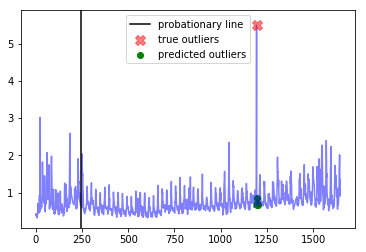




--- international-airline-passengers ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  []


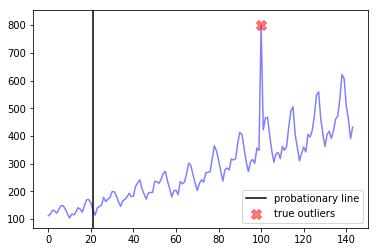




--- elb_request_count_8c0756 ---
Corresponding window precision:  0.6666666666666666
Corresponding window recall:  1.0
Corresponding window false positives:  1
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [787, 788, 790, 791, 793, 1980, 1981, 1982, 3691, 3692, 3693, 3694, 3695, 3696]


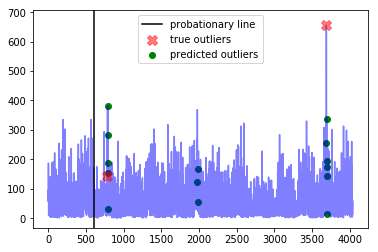




--- all_data_gift_certificates ---
Corresponding window precision:  0.3333333333333333
Corresponding window recall:  0.6666666666666666
Corresponding window false positives:  4
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [4964, 4965, 4966, 4967, 4968, 4987, 4988, 4989, 4990, 4991, 6506, 6507, 6508, 6509, 6510, 7682, 7990, 8326, 8327, 8328]


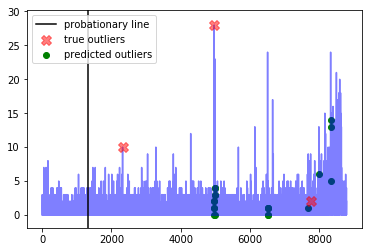




--- FARM_Bowling-Green-5-S_Warren ---
Corresponding window precision:  0.2
Corresponding window recall:  0.3333333333333333
Corresponding window false positives:  4
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  [721, 722, 798, 799, 1638, 1639, 3147, 3448, 3449, 3450, 3451]


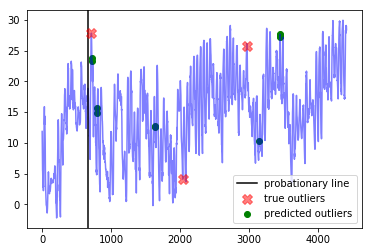




--- ambient_temperature_system_failure ---
Corresponding window precision:  0.3333333333333333
Corresponding window recall:  0.5
Corresponding window false positives:  2
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [4125, 4126, 4127, 4128, 4143, 4144, 5040, 5041, 5443]


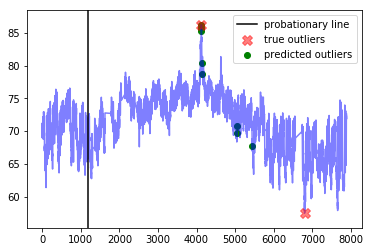




--- exchange-3_cpc_results ---
Corresponding window precision:  0.6666666666666666
Corresponding window recall:  0.6666666666666666
Corresponding window false positives:  1
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [325, 326, 327, 1019, 1020, 1021, 1022, 1023, 1024, 1025, 1042, 1043, 1044, 1045, 1046, 1047, 1048, 1049, 1056, 1057, 1058, 1059, 1060]


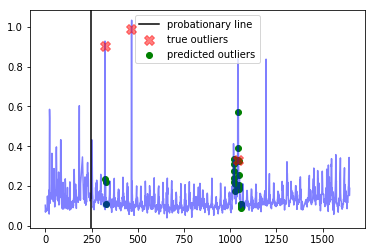

---------weight_fp=0.2, weight_fn=1----------


----Window-Based Results----
Minimum number of mistakes:  13.799999999999999
Best window threshold:  1.0
Corresponding window overall precision:  0.44
Corresponding window overall recall:  0.4782608695652174
Corresponding window overall F score:  0.4583333333333333



--- exchange-2_cpm_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  []


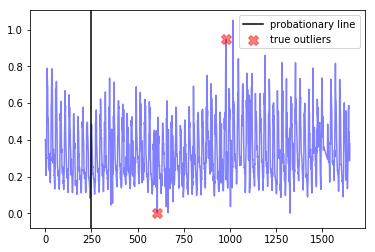




--- exchange-2_cpc_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  1
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [1487, 1488, 1489]


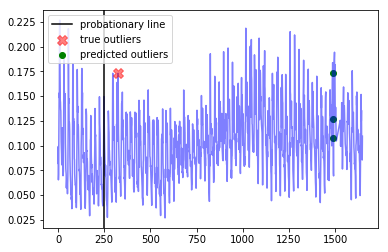




--- nyc_taxi ---
Corresponding window precision:  0.75
Corresponding window recall:  0.6
Corresponding window false positives:  1
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  [5956, 5957, 5958, 5959, 5960, 5961, 5962, 5972, 8836, 8837, 8838, 8839, 9271, 10068, 10069, 10070, 10071, 10072, 10073, 10074, 10097, 10098, 10099]


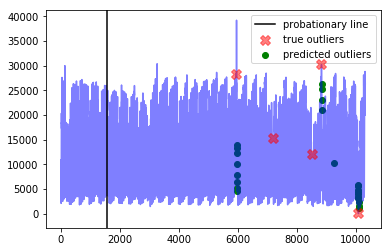




--- exchange-3_cpm_results ---
Corresponding window precision:  1.0
Corresponding window recall:  1.0
Corresponding window false positives:  0
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [1195, 1196, 1197, 1198, 1199]


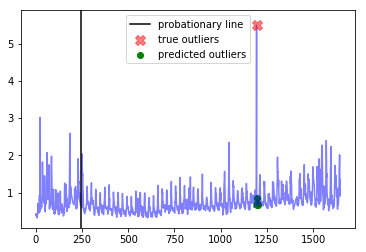




--- international-airline-passengers ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  []


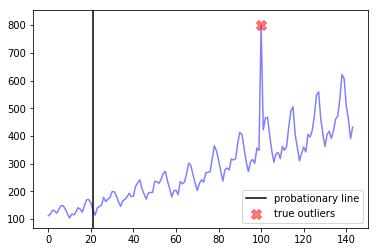




--- elb_request_count_8c0756 ---
Corresponding window precision:  0.6666666666666666
Corresponding window recall:  1.0
Corresponding window false positives:  1
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [787, 788, 790, 791, 793, 1980, 1981, 1982, 3691, 3692, 3693, 3694, 3695, 3696]


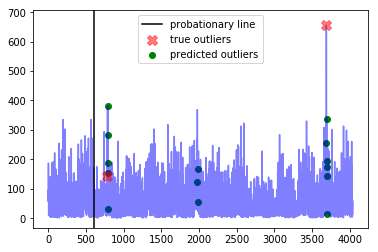




--- all_data_gift_certificates ---
Corresponding window precision:  0.3333333333333333
Corresponding window recall:  0.6666666666666666
Corresponding window false positives:  4
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [4964, 4965, 4966, 4967, 4968, 4987, 4988, 4989, 4990, 4991, 6506, 6507, 6508, 6509, 6510, 7682, 7990, 8326, 8327, 8328]


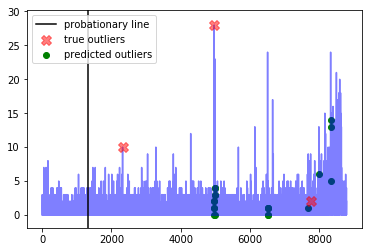




--- FARM_Bowling-Green-5-S_Warren ---
Corresponding window precision:  0.2
Corresponding window recall:  0.3333333333333333
Corresponding window false positives:  4
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  [721, 722, 798, 799, 1638, 1639, 3147, 3448, 3449, 3450, 3451]


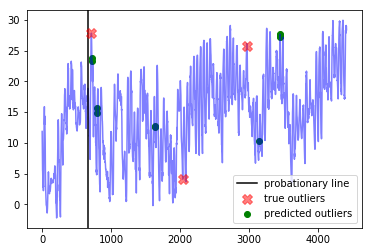




--- ambient_temperature_system_failure ---
Corresponding window precision:  0.3333333333333333
Corresponding window recall:  0.5
Corresponding window false positives:  2
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [4125, 4126, 4127, 4128, 4143, 4144, 5040, 5041, 5443]


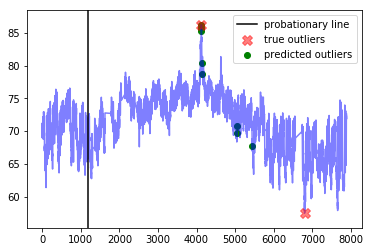




--- exchange-3_cpc_results ---
Corresponding window precision:  0.6666666666666666
Corresponding window recall:  0.6666666666666666
Corresponding window false positives:  1
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [325, 326, 327, 1019, 1020, 1021, 1022, 1023, 1024, 1025, 1042, 1043, 1044, 1045, 1046, 1047, 1048, 1049, 1056, 1057, 1058, 1059, 1060]


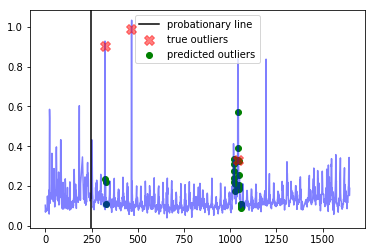

---------weight_fp=0.3, weight_fn=1----------


----Window-Based Results----
Minimum number of mistakes:  15.200000000000001
Best window threshold:  1.0
Corresponding window overall precision:  0.44
Corresponding window overall recall:  0.4782608695652174
Corresponding window overall F score:  0.4583333333333333



--- exchange-2_cpm_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  []


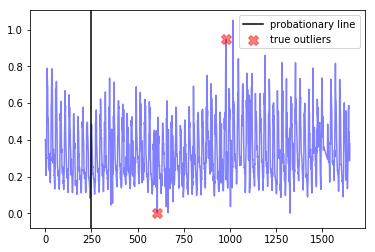




--- exchange-2_cpc_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  1
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [1487, 1488, 1489]


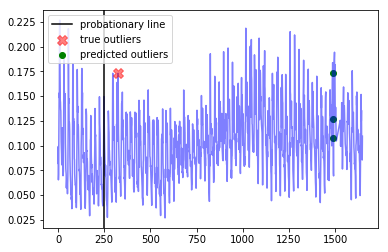




--- nyc_taxi ---
Corresponding window precision:  0.75
Corresponding window recall:  0.6
Corresponding window false positives:  1
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  [5956, 5957, 5958, 5959, 5960, 5961, 5962, 5972, 8836, 8837, 8838, 8839, 9271, 10068, 10069, 10070, 10071, 10072, 10073, 10074, 10097, 10098, 10099]


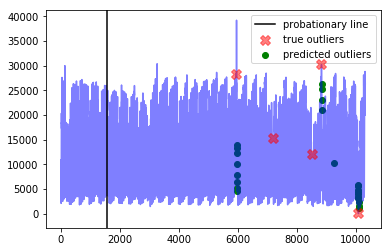




--- exchange-3_cpm_results ---
Corresponding window precision:  1.0
Corresponding window recall:  1.0
Corresponding window false positives:  0
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [1195, 1196, 1197, 1198, 1199]


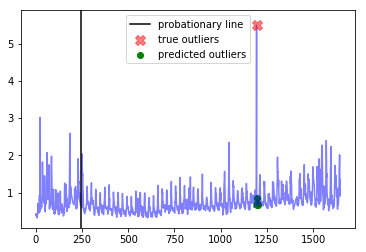




--- international-airline-passengers ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  []


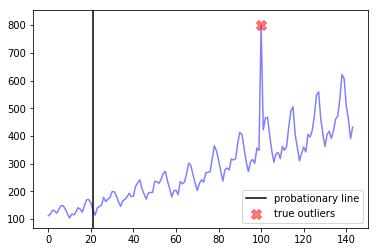




--- elb_request_count_8c0756 ---
Corresponding window precision:  0.6666666666666666
Corresponding window recall:  1.0
Corresponding window false positives:  1
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [787, 788, 790, 791, 793, 1980, 1981, 1982, 3691, 3692, 3693, 3694, 3695, 3696]


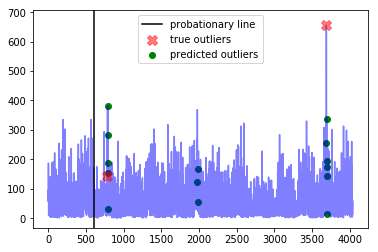




--- all_data_gift_certificates ---
Corresponding window precision:  0.3333333333333333
Corresponding window recall:  0.6666666666666666
Corresponding window false positives:  4
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [4964, 4965, 4966, 4967, 4968, 4987, 4988, 4989, 4990, 4991, 6506, 6507, 6508, 6509, 6510, 7682, 7990, 8326, 8327, 8328]


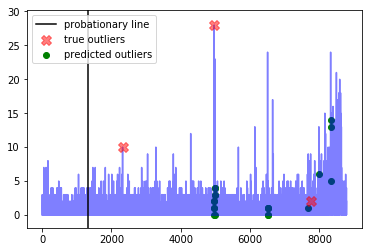




--- FARM_Bowling-Green-5-S_Warren ---
Corresponding window precision:  0.2
Corresponding window recall:  0.3333333333333333
Corresponding window false positives:  4
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  [721, 722, 798, 799, 1638, 1639, 3147, 3448, 3449, 3450, 3451]


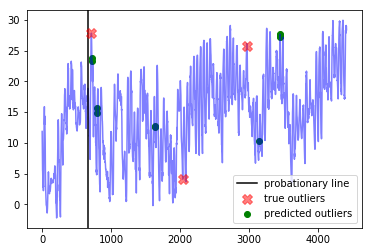




--- ambient_temperature_system_failure ---
Corresponding window precision:  0.3333333333333333
Corresponding window recall:  0.5
Corresponding window false positives:  2
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [4125, 4126, 4127, 4128, 4143, 4144, 5040, 5041, 5443]


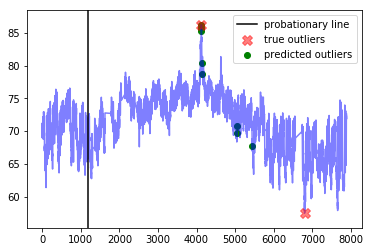




--- exchange-3_cpc_results ---
Corresponding window precision:  0.6666666666666666
Corresponding window recall:  0.6666666666666666
Corresponding window false positives:  1
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [325, 326, 327, 1019, 1020, 1021, 1022, 1023, 1024, 1025, 1042, 1043, 1044, 1045, 1046, 1047, 1048, 1049, 1056, 1057, 1058, 1059, 1060]


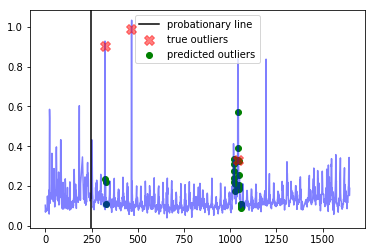

---------weight_fp=0.4, weight_fn=1----------


----Window-Based Results----
Minimum number of mistakes:  16.6
Best window threshold:  1.0
Corresponding window overall precision:  0.44
Corresponding window overall recall:  0.4782608695652174
Corresponding window overall F score:  0.4583333333333333



--- exchange-2_cpm_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  []


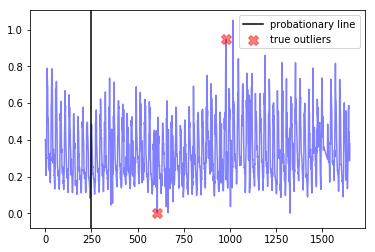




--- exchange-2_cpc_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  1
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [1487, 1488, 1489]


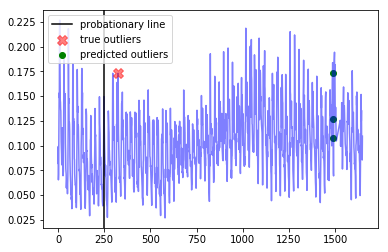




--- nyc_taxi ---
Corresponding window precision:  0.75
Corresponding window recall:  0.6
Corresponding window false positives:  1
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  [5956, 5957, 5958, 5959, 5960, 5961, 5962, 5972, 8836, 8837, 8838, 8839, 9271, 10068, 10069, 10070, 10071, 10072, 10073, 10074, 10097, 10098, 10099]


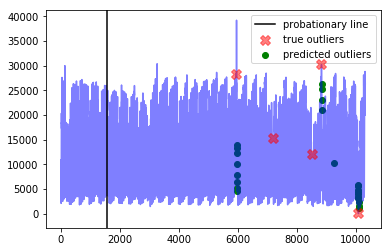




--- exchange-3_cpm_results ---
Corresponding window precision:  1.0
Corresponding window recall:  1.0
Corresponding window false positives:  0
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [1195, 1196, 1197, 1198, 1199]


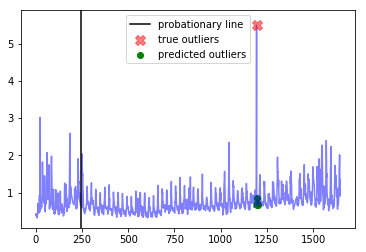




--- international-airline-passengers ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  []


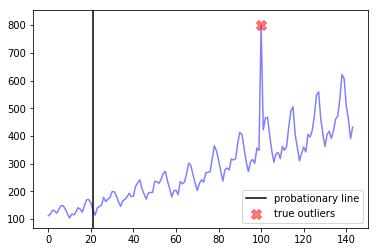




--- elb_request_count_8c0756 ---
Corresponding window precision:  0.6666666666666666
Corresponding window recall:  1.0
Corresponding window false positives:  1
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [787, 788, 790, 791, 793, 1980, 1981, 1982, 3691, 3692, 3693, 3694, 3695, 3696]


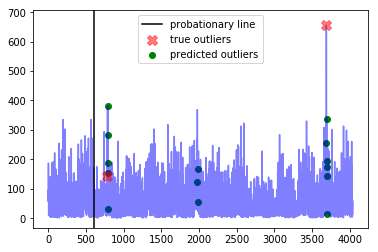




--- all_data_gift_certificates ---
Corresponding window precision:  0.3333333333333333
Corresponding window recall:  0.6666666666666666
Corresponding window false positives:  4
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [4964, 4965, 4966, 4967, 4968, 4987, 4988, 4989, 4990, 4991, 6506, 6507, 6508, 6509, 6510, 7682, 7990, 8326, 8327, 8328]


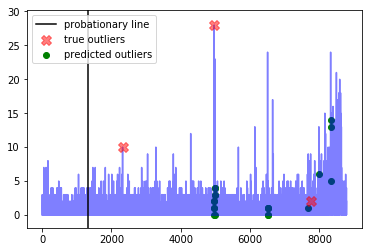




--- FARM_Bowling-Green-5-S_Warren ---
Corresponding window precision:  0.2
Corresponding window recall:  0.3333333333333333
Corresponding window false positives:  4
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  [721, 722, 798, 799, 1638, 1639, 3147, 3448, 3449, 3450, 3451]


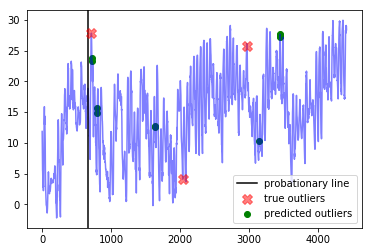




--- ambient_temperature_system_failure ---
Corresponding window precision:  0.3333333333333333
Corresponding window recall:  0.5
Corresponding window false positives:  2
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [4125, 4126, 4127, 4128, 4143, 4144, 5040, 5041, 5443]


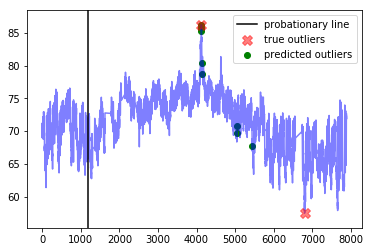




--- exchange-3_cpc_results ---
Corresponding window precision:  0.6666666666666666
Corresponding window recall:  0.6666666666666666
Corresponding window false positives:  1
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [325, 326, 327, 1019, 1020, 1021, 1022, 1023, 1024, 1025, 1042, 1043, 1044, 1045, 1046, 1047, 1048, 1049, 1056, 1057, 1058, 1059, 1060]


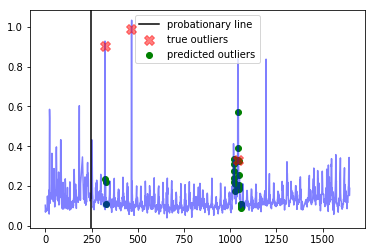

---------weight_fp=0.5, weight_fn=1----------


----Window-Based Results----
Minimum number of mistakes:  18.0
Best window threshold:  1.0
Corresponding window overall precision:  0.44
Corresponding window overall recall:  0.4782608695652174
Corresponding window overall F score:  0.4583333333333333



--- exchange-2_cpm_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  []


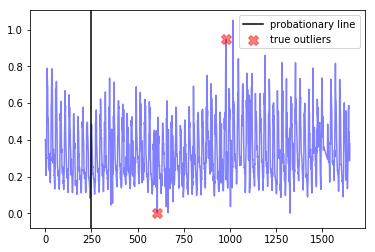




--- exchange-2_cpc_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  1
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [1487, 1488, 1489]


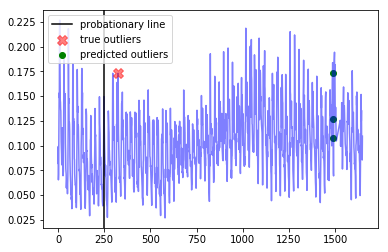




--- nyc_taxi ---
Corresponding window precision:  0.75
Corresponding window recall:  0.6
Corresponding window false positives:  1
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  [5956, 5957, 5958, 5959, 5960, 5961, 5962, 5972, 8836, 8837, 8838, 8839, 9271, 10068, 10069, 10070, 10071, 10072, 10073, 10074, 10097, 10098, 10099]


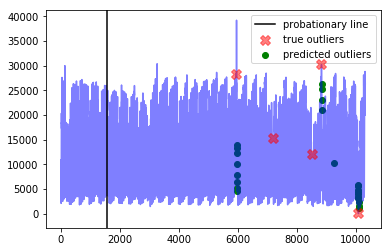




--- exchange-3_cpm_results ---
Corresponding window precision:  1.0
Corresponding window recall:  1.0
Corresponding window false positives:  0
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [1195, 1196, 1197, 1198, 1199]


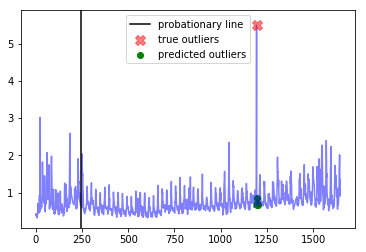




--- international-airline-passengers ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  []


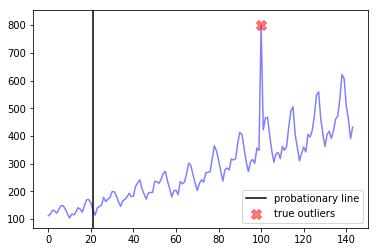




--- elb_request_count_8c0756 ---
Corresponding window precision:  0.6666666666666666
Corresponding window recall:  1.0
Corresponding window false positives:  1
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [787, 788, 790, 791, 793, 1980, 1981, 1982, 3691, 3692, 3693, 3694, 3695, 3696]


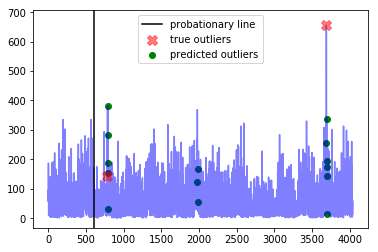




--- all_data_gift_certificates ---
Corresponding window precision:  0.3333333333333333
Corresponding window recall:  0.6666666666666666
Corresponding window false positives:  4
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [4964, 4965, 4966, 4967, 4968, 4987, 4988, 4989, 4990, 4991, 6506, 6507, 6508, 6509, 6510, 7682, 7990, 8326, 8327, 8328]


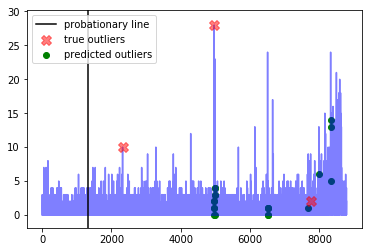




--- FARM_Bowling-Green-5-S_Warren ---
Corresponding window precision:  0.2
Corresponding window recall:  0.3333333333333333
Corresponding window false positives:  4
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  [721, 722, 798, 799, 1638, 1639, 3147, 3448, 3449, 3450, 3451]


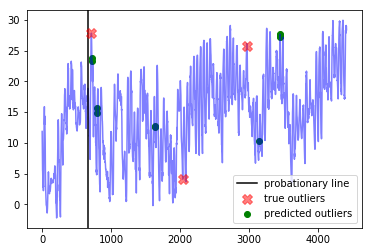




--- ambient_temperature_system_failure ---
Corresponding window precision:  0.3333333333333333
Corresponding window recall:  0.5
Corresponding window false positives:  2
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [4125, 4126, 4127, 4128, 4143, 4144, 5040, 5041, 5443]


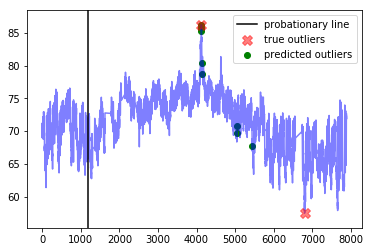




--- exchange-3_cpc_results ---
Corresponding window precision:  0.6666666666666666
Corresponding window recall:  0.6666666666666666
Corresponding window false positives:  1
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [325, 326, 327, 1019, 1020, 1021, 1022, 1023, 1024, 1025, 1042, 1043, 1044, 1045, 1046, 1047, 1048, 1049, 1056, 1057, 1058, 1059, 1060]


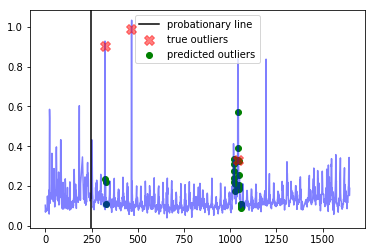

---------weight_fp=0.6, weight_fn=1----------


----Window-Based Results----
Minimum number of mistakes:  19.400000000000002
Best window threshold:  1.0
Corresponding window overall precision:  0.44
Corresponding window overall recall:  0.4782608695652174
Corresponding window overall F score:  0.4583333333333333



--- exchange-2_cpm_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  []


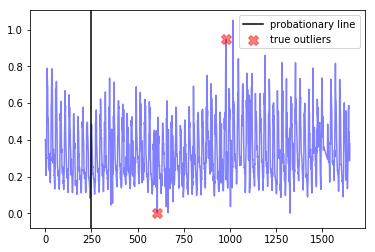




--- exchange-2_cpc_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  1
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [1487, 1488, 1489]


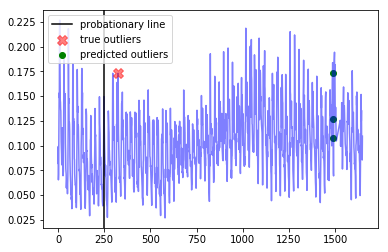




--- nyc_taxi ---
Corresponding window precision:  0.75
Corresponding window recall:  0.6
Corresponding window false positives:  1
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  [5956, 5957, 5958, 5959, 5960, 5961, 5962, 5972, 8836, 8837, 8838, 8839, 9271, 10068, 10069, 10070, 10071, 10072, 10073, 10074, 10097, 10098, 10099]


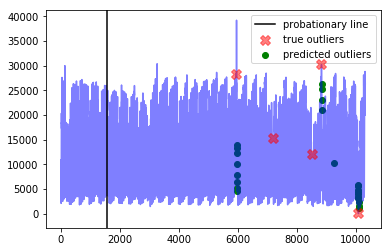




--- exchange-3_cpm_results ---
Corresponding window precision:  1.0
Corresponding window recall:  1.0
Corresponding window false positives:  0
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [1195, 1196, 1197, 1198, 1199]


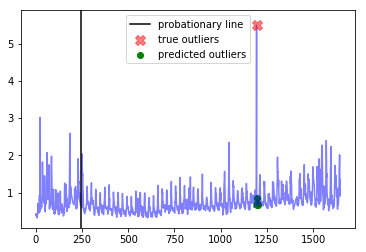




--- international-airline-passengers ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  []


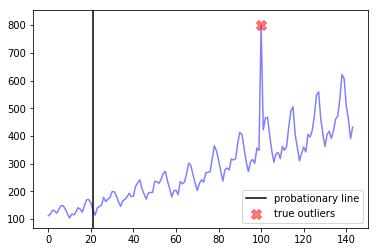




--- elb_request_count_8c0756 ---
Corresponding window precision:  0.6666666666666666
Corresponding window recall:  1.0
Corresponding window false positives:  1
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [787, 788, 790, 791, 793, 1980, 1981, 1982, 3691, 3692, 3693, 3694, 3695, 3696]


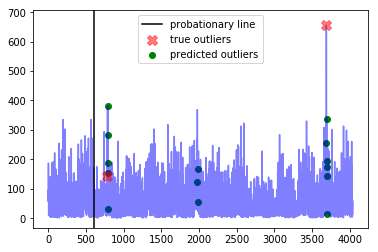




--- all_data_gift_certificates ---
Corresponding window precision:  0.3333333333333333
Corresponding window recall:  0.6666666666666666
Corresponding window false positives:  4
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [4964, 4965, 4966, 4967, 4968, 4987, 4988, 4989, 4990, 4991, 6506, 6507, 6508, 6509, 6510, 7682, 7990, 8326, 8327, 8328]


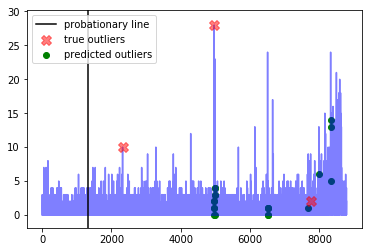




--- FARM_Bowling-Green-5-S_Warren ---
Corresponding window precision:  0.2
Corresponding window recall:  0.3333333333333333
Corresponding window false positives:  4
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  [721, 722, 798, 799, 1638, 1639, 3147, 3448, 3449, 3450, 3451]


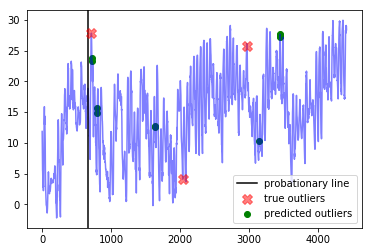




--- ambient_temperature_system_failure ---
Corresponding window precision:  0.3333333333333333
Corresponding window recall:  0.5
Corresponding window false positives:  2
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [4125, 4126, 4127, 4128, 4143, 4144, 5040, 5041, 5443]


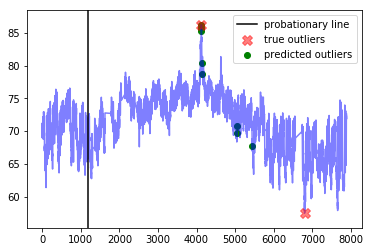




--- exchange-3_cpc_results ---
Corresponding window precision:  0.6666666666666666
Corresponding window recall:  0.6666666666666666
Corresponding window false positives:  1
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [325, 326, 327, 1019, 1020, 1021, 1022, 1023, 1024, 1025, 1042, 1043, 1044, 1045, 1046, 1047, 1048, 1049, 1056, 1057, 1058, 1059, 1060]


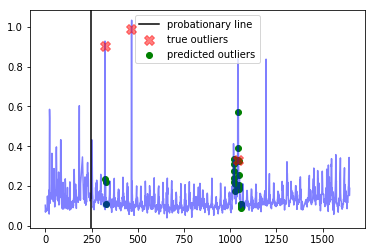

---------weight_fp=0.7, weight_fn=1----------


----Window-Based Results----
Minimum number of mistakes:  20.799999999999997
Best window threshold:  1.0
Corresponding window overall precision:  0.44
Corresponding window overall recall:  0.4782608695652174
Corresponding window overall F score:  0.4583333333333333



--- exchange-2_cpm_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  []


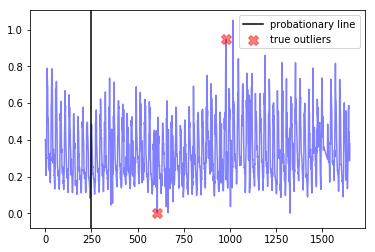




--- exchange-2_cpc_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  1
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [1487, 1488, 1489]


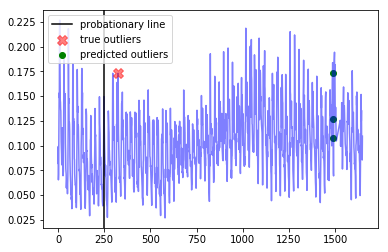




--- nyc_taxi ---
Corresponding window precision:  0.75
Corresponding window recall:  0.6
Corresponding window false positives:  1
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  [5956, 5957, 5958, 5959, 5960, 5961, 5962, 5972, 8836, 8837, 8838, 8839, 9271, 10068, 10069, 10070, 10071, 10072, 10073, 10074, 10097, 10098, 10099]


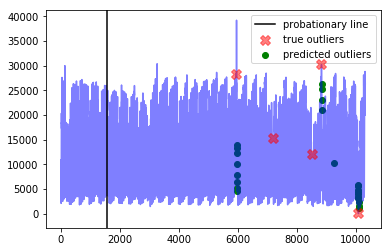




--- exchange-3_cpm_results ---
Corresponding window precision:  1.0
Corresponding window recall:  1.0
Corresponding window false positives:  0
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [1195, 1196, 1197, 1198, 1199]


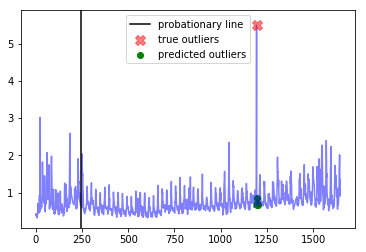




--- international-airline-passengers ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  []


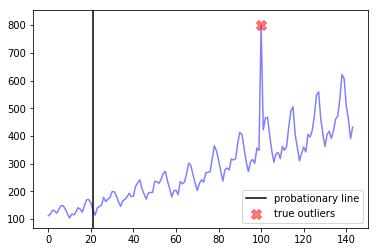




--- elb_request_count_8c0756 ---
Corresponding window precision:  0.6666666666666666
Corresponding window recall:  1.0
Corresponding window false positives:  1
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [787, 788, 790, 791, 793, 1980, 1981, 1982, 3691, 3692, 3693, 3694, 3695, 3696]


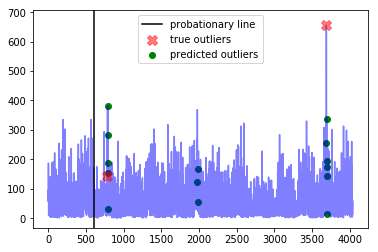




--- all_data_gift_certificates ---
Corresponding window precision:  0.3333333333333333
Corresponding window recall:  0.6666666666666666
Corresponding window false positives:  4
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [4964, 4965, 4966, 4967, 4968, 4987, 4988, 4989, 4990, 4991, 6506, 6507, 6508, 6509, 6510, 7682, 7990, 8326, 8327, 8328]


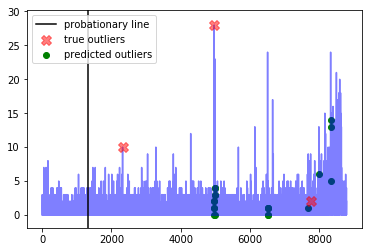




--- FARM_Bowling-Green-5-S_Warren ---
Corresponding window precision:  0.2
Corresponding window recall:  0.3333333333333333
Corresponding window false positives:  4
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  [721, 722, 798, 799, 1638, 1639, 3147, 3448, 3449, 3450, 3451]


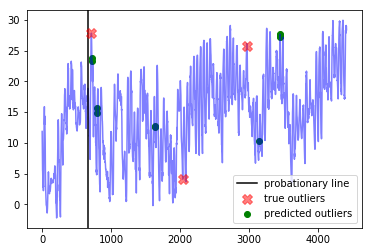




--- ambient_temperature_system_failure ---
Corresponding window precision:  0.3333333333333333
Corresponding window recall:  0.5
Corresponding window false positives:  2
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [4125, 4126, 4127, 4128, 4143, 4144, 5040, 5041, 5443]


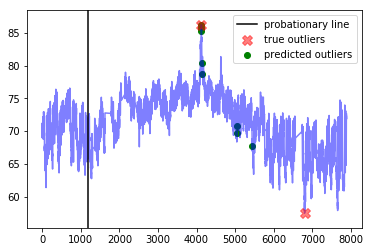




--- exchange-3_cpc_results ---
Corresponding window precision:  0.6666666666666666
Corresponding window recall:  0.6666666666666666
Corresponding window false positives:  1
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [325, 326, 327, 1019, 1020, 1021, 1022, 1023, 1024, 1025, 1042, 1043, 1044, 1045, 1046, 1047, 1048, 1049, 1056, 1057, 1058, 1059, 1060]


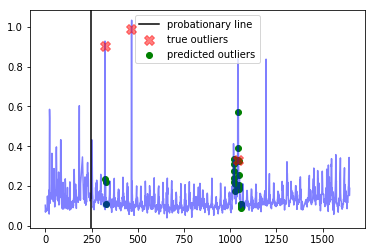

---------weight_fp=0.8, weight_fn=1----------


----Window-Based Results----
Minimum number of mistakes:  22.200000000000003
Best window threshold:  1.0
Corresponding window overall precision:  0.44
Corresponding window overall recall:  0.4782608695652174
Corresponding window overall F score:  0.4583333333333333



--- exchange-2_cpm_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  []


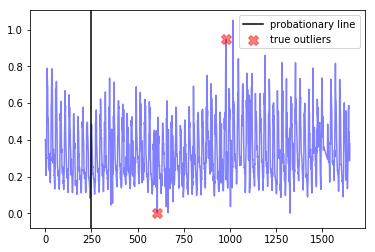




--- exchange-2_cpc_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  1
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [1487, 1488, 1489]


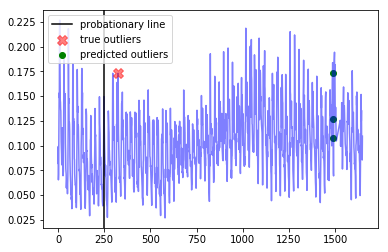




--- nyc_taxi ---
Corresponding window precision:  0.75
Corresponding window recall:  0.6
Corresponding window false positives:  1
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  [5956, 5957, 5958, 5959, 5960, 5961, 5962, 5972, 8836, 8837, 8838, 8839, 9271, 10068, 10069, 10070, 10071, 10072, 10073, 10074, 10097, 10098, 10099]


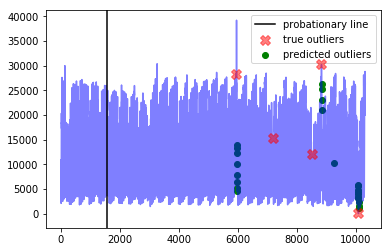




--- exchange-3_cpm_results ---
Corresponding window precision:  1.0
Corresponding window recall:  1.0
Corresponding window false positives:  0
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [1195, 1196, 1197, 1198, 1199]


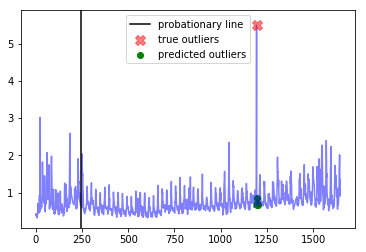




--- international-airline-passengers ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  []


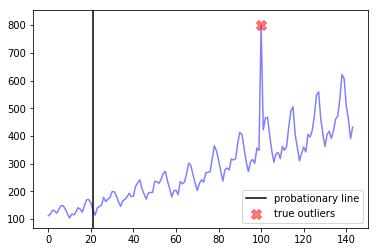




--- elb_request_count_8c0756 ---
Corresponding window precision:  0.6666666666666666
Corresponding window recall:  1.0
Corresponding window false positives:  1
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [787, 788, 790, 791, 793, 1980, 1981, 1982, 3691, 3692, 3693, 3694, 3695, 3696]


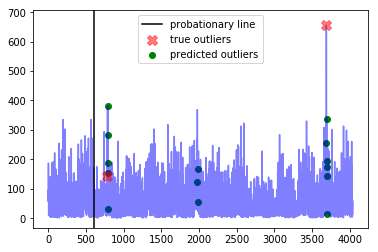




--- all_data_gift_certificates ---
Corresponding window precision:  0.3333333333333333
Corresponding window recall:  0.6666666666666666
Corresponding window false positives:  4
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [4964, 4965, 4966, 4967, 4968, 4987, 4988, 4989, 4990, 4991, 6506, 6507, 6508, 6509, 6510, 7682, 7990, 8326, 8327, 8328]


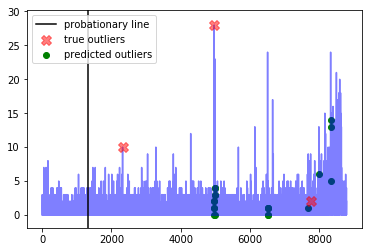




--- FARM_Bowling-Green-5-S_Warren ---
Corresponding window precision:  0.2
Corresponding window recall:  0.3333333333333333
Corresponding window false positives:  4
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  [721, 722, 798, 799, 1638, 1639, 3147, 3448, 3449, 3450, 3451]


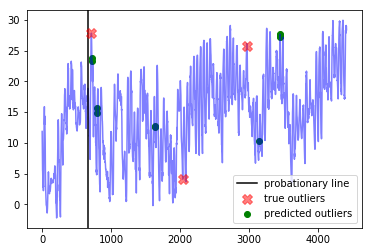




--- ambient_temperature_system_failure ---
Corresponding window precision:  0.3333333333333333
Corresponding window recall:  0.5
Corresponding window false positives:  2
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [4125, 4126, 4127, 4128, 4143, 4144, 5040, 5041, 5443]


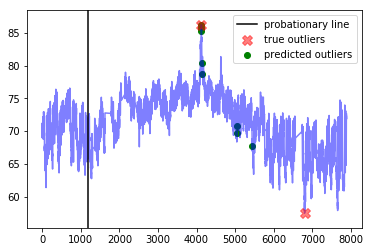




--- exchange-3_cpc_results ---
Corresponding window precision:  0.6666666666666666
Corresponding window recall:  0.6666666666666666
Corresponding window false positives:  1
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [325, 326, 327, 1019, 1020, 1021, 1022, 1023, 1024, 1025, 1042, 1043, 1044, 1045, 1046, 1047, 1048, 1049, 1056, 1057, 1058, 1059, 1060]


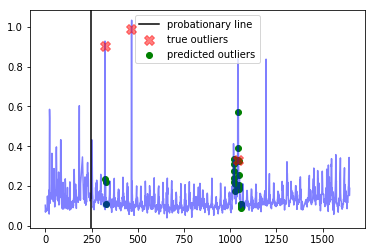

---------weight_fp=0.9, weight_fn=1----------


----Window-Based Results----
Minimum number of mistakes:  23.599999999999998
Best window threshold:  1.0
Corresponding window overall precision:  0.44
Corresponding window overall recall:  0.4782608695652174
Corresponding window overall F score:  0.4583333333333333



--- exchange-2_cpm_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  []


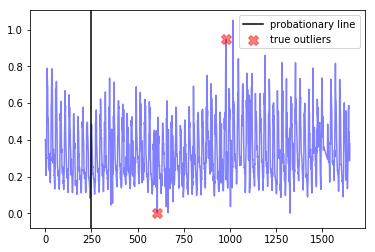




--- exchange-2_cpc_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  1
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [1487, 1488, 1489]


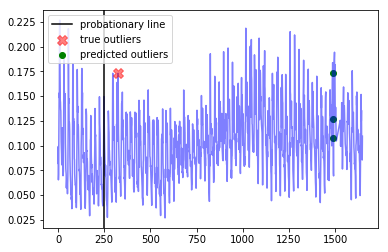




--- nyc_taxi ---
Corresponding window precision:  0.75
Corresponding window recall:  0.6
Corresponding window false positives:  1
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  [5956, 5957, 5958, 5959, 5960, 5961, 5962, 5972, 8836, 8837, 8838, 8839, 9271, 10068, 10069, 10070, 10071, 10072, 10073, 10074, 10097, 10098, 10099]


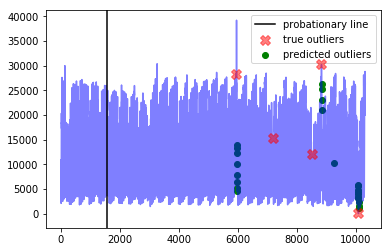




--- exchange-3_cpm_results ---
Corresponding window precision:  1.0
Corresponding window recall:  1.0
Corresponding window false positives:  0
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [1195, 1196, 1197, 1198, 1199]


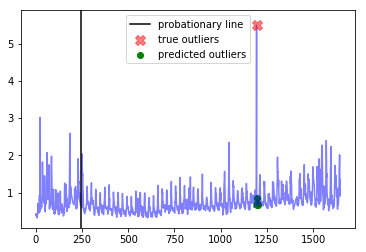




--- international-airline-passengers ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  []


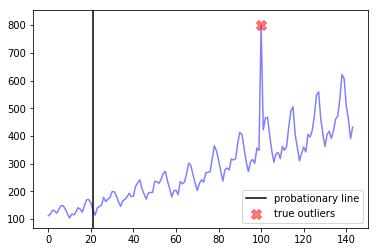




--- elb_request_count_8c0756 ---
Corresponding window precision:  0.6666666666666666
Corresponding window recall:  1.0
Corresponding window false positives:  1
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [787, 788, 790, 791, 793, 1980, 1981, 1982, 3691, 3692, 3693, 3694, 3695, 3696]


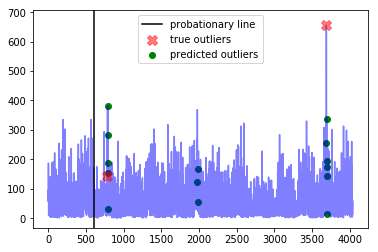




--- all_data_gift_certificates ---
Corresponding window precision:  0.3333333333333333
Corresponding window recall:  0.6666666666666666
Corresponding window false positives:  4
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [4964, 4965, 4966, 4967, 4968, 4987, 4988, 4989, 4990, 4991, 6506, 6507, 6508, 6509, 6510, 7682, 7990, 8326, 8327, 8328]


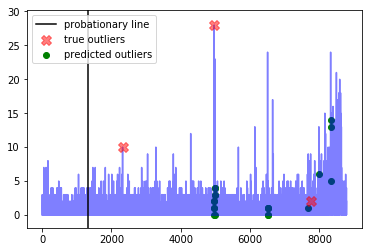




--- FARM_Bowling-Green-5-S_Warren ---
Corresponding window precision:  0.2
Corresponding window recall:  0.3333333333333333
Corresponding window false positives:  4
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  [721, 722, 798, 799, 1638, 1639, 3147, 3448, 3449, 3450, 3451]


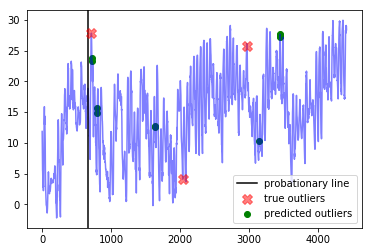




--- ambient_temperature_system_failure ---
Corresponding window precision:  0.3333333333333333
Corresponding window recall:  0.5
Corresponding window false positives:  2
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [4125, 4126, 4127, 4128, 4143, 4144, 5040, 5041, 5443]


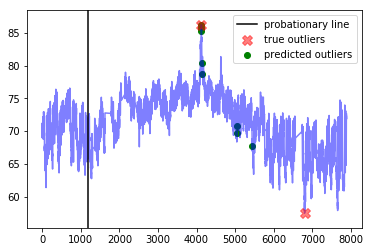




--- exchange-3_cpc_results ---
Corresponding window precision:  0.6666666666666666
Corresponding window recall:  0.6666666666666666
Corresponding window false positives:  1
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [325, 326, 327, 1019, 1020, 1021, 1022, 1023, 1024, 1025, 1042, 1043, 1044, 1045, 1046, 1047, 1048, 1049, 1056, 1057, 1058, 1059, 1060]


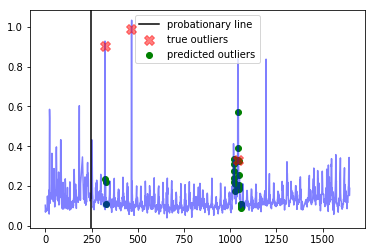

---------weight_fp=1.0, weight_fn=1----------


----Window-Based Results----
Minimum number of mistakes:  25.0
Best window threshold:  1.0
Corresponding window overall precision:  0.44
Corresponding window overall recall:  0.4782608695652174
Corresponding window overall F score:  0.4583333333333333



--- exchange-2_cpm_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  []


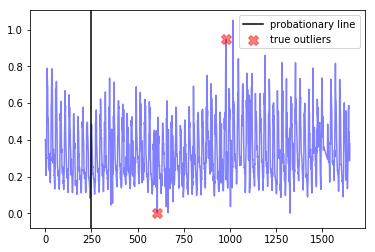




--- exchange-2_cpc_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  1
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [1487, 1488, 1489]


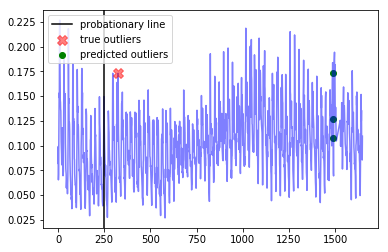




--- nyc_taxi ---
Corresponding window precision:  0.75
Corresponding window recall:  0.6
Corresponding window false positives:  1
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  [5956, 5957, 5958, 5959, 5960, 5961, 5962, 5972, 8836, 8837, 8838, 8839, 9271, 10068, 10069, 10070, 10071, 10072, 10073, 10074, 10097, 10098, 10099]


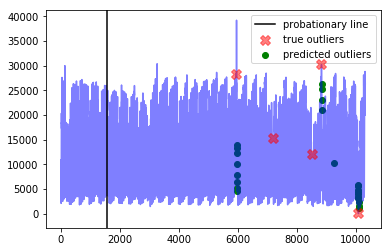




--- exchange-3_cpm_results ---
Corresponding window precision:  1.0
Corresponding window recall:  1.0
Corresponding window false positives:  0
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [1195, 1196, 1197, 1198, 1199]


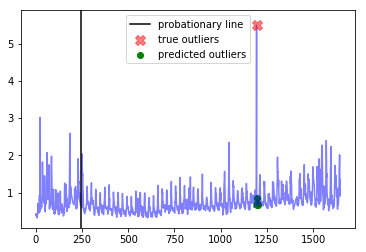




--- international-airline-passengers ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  []


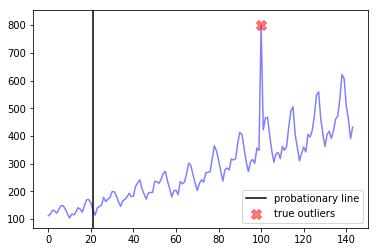




--- elb_request_count_8c0756 ---
Corresponding window precision:  0.6666666666666666
Corresponding window recall:  1.0
Corresponding window false positives:  1
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [787, 788, 790, 791, 793, 1980, 1981, 1982, 3691, 3692, 3693, 3694, 3695, 3696]


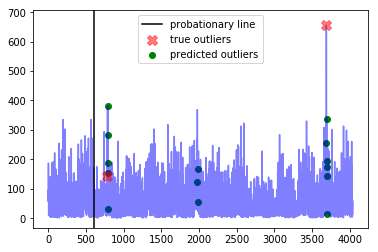




--- all_data_gift_certificates ---
Corresponding window precision:  0.3333333333333333
Corresponding window recall:  0.6666666666666666
Corresponding window false positives:  4
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [4964, 4965, 4966, 4967, 4968, 4987, 4988, 4989, 4990, 4991, 6506, 6507, 6508, 6509, 6510, 7682, 7990, 8326, 8327, 8328]


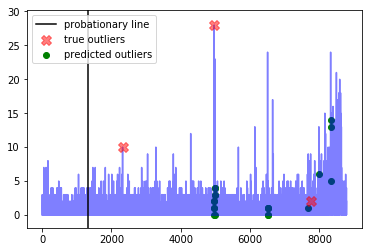




--- FARM_Bowling-Green-5-S_Warren ---
Corresponding window precision:  0.2
Corresponding window recall:  0.3333333333333333
Corresponding window false positives:  4
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  [721, 722, 798, 799, 1638, 1639, 3147, 3448, 3449, 3450, 3451]


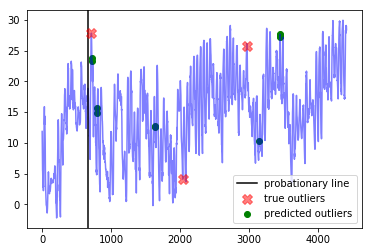




--- ambient_temperature_system_failure ---
Corresponding window precision:  0.3333333333333333
Corresponding window recall:  0.5
Corresponding window false positives:  2
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [4125, 4126, 4127, 4128, 4143, 4144, 5040, 5041, 5443]


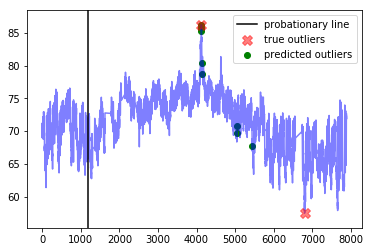




--- exchange-3_cpc_results ---
Corresponding window precision:  0.6666666666666666
Corresponding window recall:  0.6666666666666666
Corresponding window false positives:  1
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [325, 326, 327, 1019, 1020, 1021, 1022, 1023, 1024, 1025, 1042, 1043, 1044, 1045, 1046, 1047, 1048, 1049, 1056, 1057, 1058, 1059, 1060]


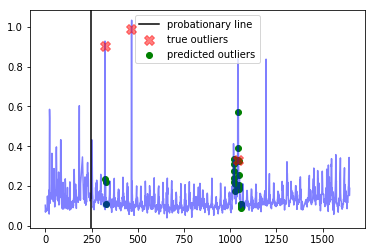

------------
False Positive Weight:  0.1
	 Corresponding window overall recall : 0.4782608695652174
	 Corresponding window overall F score : 0.4583333333333333
	 Corresponding window overall precision : 0.44
	 Minimum number of mistakes : 12.399999999999999
	 Best window threshold : 1.0
False Positive Weight:  0.2
	 Corresponding window overall recall : 0.4782608695652174
	 Corresponding window overall F score : 0.4583333333333333
	 Corresponding window overall precision : 0.44
	 Minimum number of mistakes : 13.799999999999999
	 Best window threshold : 1.0
False Positive Weight:  0.3
	 Corresponding window overall recall : 0.4782608695652174
	 Corresponding window overall F score : 0.4583333333333333
	 Corresponding window overall precision : 0.44
	 Minimum number of mistakes : 15.200000000000001
	 Best window threshold : 1.0
False Positive Weight:  0.6
	 Corresponding window overall recall : 0.4782608695652174
	 Corresponding window overall F score : 0.4583333333333333
	 Corresponding

In [16]:
end_results = {}
for weight_fp in weight_fp_list:  
    print("---------weight_fp=" + str(weight_fp) + ", weight_fn=1----------")
    weight_result = adclasses.pretty_print_results(ad_dict, anomaly_scores_dict, true_outlier_indices_dict, weight_fp=weight_fp, weight_fn=1)
    end_results[weight_fp] = weight_result

print("------------")
adclasses.pretty_print_end_results(end_results)

# Twitter AD Results

In [24]:
anomaly_scores_dict = {}

for dataset_name in dataset_name_list:
    output_dict_twitter = joblib.load("anomaly_scores/Twitter/" + dataset_name)
    anomaly_scores_dict[dataset_name] = output_dict_twitter["Anomaly Scores"]

---------weight_fp=0.1, weight_fn=1----------


----Window-Based Results----
Minimum number of mistakes:  16.1
Best window threshold:  0.0001
Corresponding window overall precision:  0.75
Corresponding window overall recall:  0.2608695652173913
Corresponding window overall F score:  0.3870967741935483



--- all_data_gift_certificates ---
Corresponding window precision:  0.5
Corresponding window recall:  0.3333333333333333
Corresponding window false positives:  1
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  [4964, 6506]


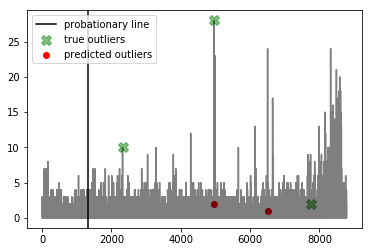




--- international-airline-passengers ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  []


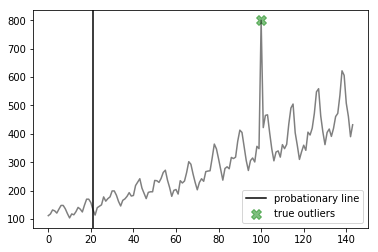




--- exchange-3_cpc_results ---
Corresponding window precision:  1.0
Corresponding window recall:  0.3333333333333333
Corresponding window false positives:  0
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  [467, 468]


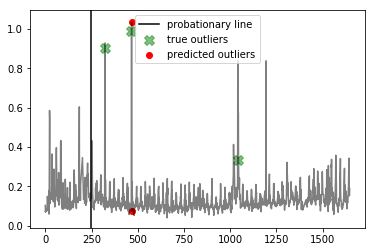




--- nyc_taxi ---
Corresponding window precision:  1.0
Corresponding window recall:  0.2
Corresponding window false positives:  0
Corresponding window false negatives:  4


Outlier indices as determined by best window threshold:  [5955, 5956]


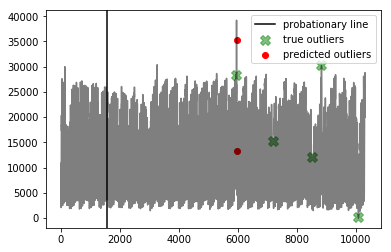




--- elb_request_count_8c0756 ---
Corresponding window precision:  1.0
Corresponding window recall:  1.0
Corresponding window false positives:  0
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [792, 3691]


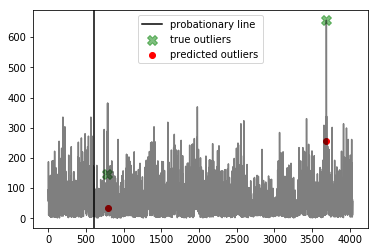




--- ambient_temperature_system_failure ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  []


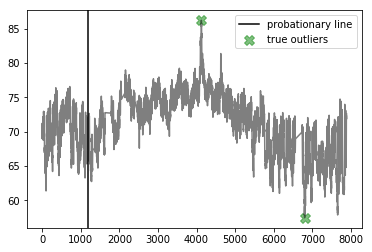




--- exchange-2_cpm_results ---
Corresponding window precision:  1.0
Corresponding window recall:  0.5
Corresponding window false positives:  0
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [978]


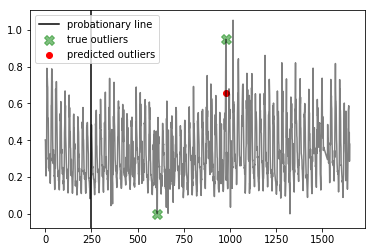




--- exchange-3_cpm_results ---
Corresponding window precision:  1.0
Corresponding window recall:  1.0
Corresponding window false positives:  0
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [1194, 1195]


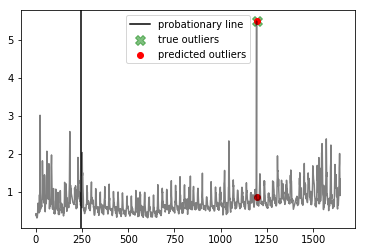




--- exchange-2_cpc_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  []


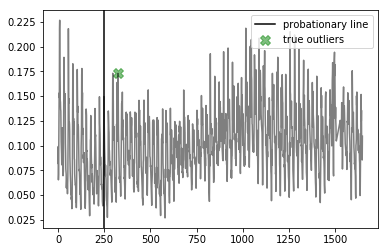




--- FARM_Bowling-Green-5-S_Warren ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  3


Outlier indices as determined by best window threshold:  []


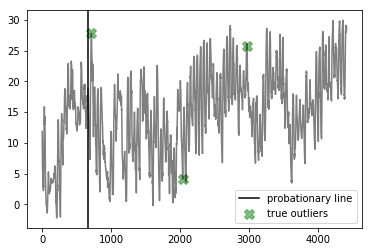

---------weight_fp=0.2, weight_fn=1----------


----Window-Based Results----
Minimum number of mistakes:  16.2
Best window threshold:  0.0001
Corresponding window overall precision:  0.75
Corresponding window overall recall:  0.2608695652173913
Corresponding window overall F score:  0.3870967741935483



--- all_data_gift_certificates ---
Corresponding window precision:  0.5
Corresponding window recall:  0.3333333333333333
Corresponding window false positives:  1
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  [4964, 6506]


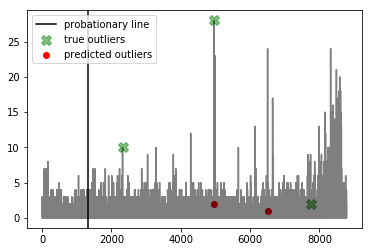




--- international-airline-passengers ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  []


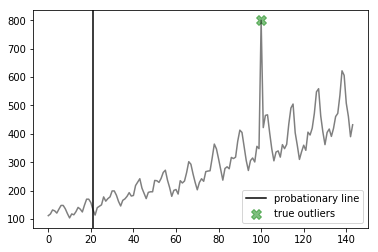




--- exchange-3_cpc_results ---
Corresponding window precision:  1.0
Corresponding window recall:  0.3333333333333333
Corresponding window false positives:  0
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  [467, 468]


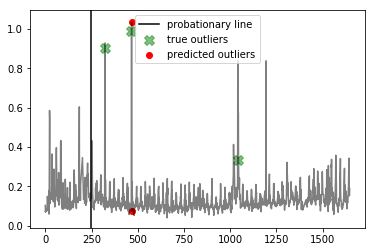




--- nyc_taxi ---
Corresponding window precision:  1.0
Corresponding window recall:  0.2
Corresponding window false positives:  0
Corresponding window false negatives:  4


Outlier indices as determined by best window threshold:  [5955, 5956]


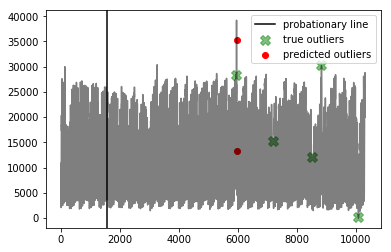




--- elb_request_count_8c0756 ---
Corresponding window precision:  1.0
Corresponding window recall:  1.0
Corresponding window false positives:  0
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [792, 3691]


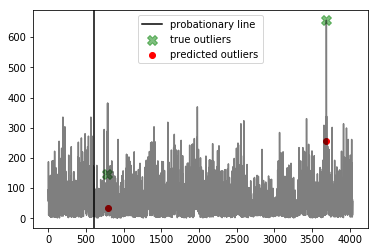




--- ambient_temperature_system_failure ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  []


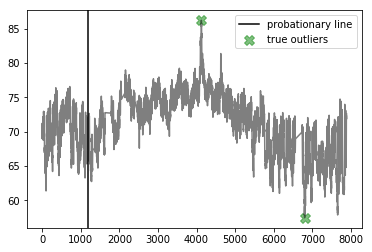




--- exchange-2_cpm_results ---
Corresponding window precision:  1.0
Corresponding window recall:  0.5
Corresponding window false positives:  0
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [978]


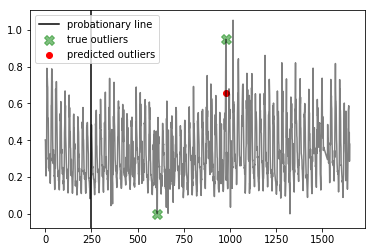




--- exchange-3_cpm_results ---
Corresponding window precision:  1.0
Corresponding window recall:  1.0
Corresponding window false positives:  0
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [1194, 1195]


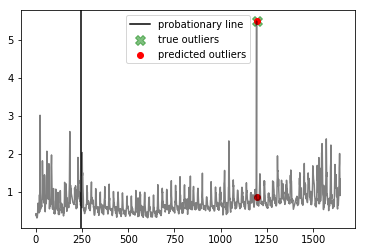




--- exchange-2_cpc_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  []


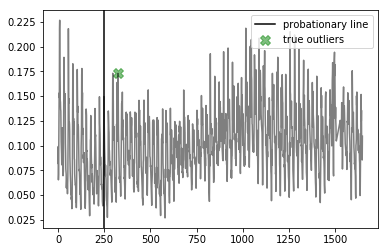




--- FARM_Bowling-Green-5-S_Warren ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  3


Outlier indices as determined by best window threshold:  []


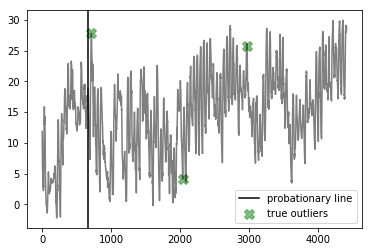

---------weight_fp=0.3, weight_fn=1----------


----Window-Based Results----
Minimum number of mistakes:  16.3
Best window threshold:  0.0001
Corresponding window overall precision:  0.75
Corresponding window overall recall:  0.2608695652173913
Corresponding window overall F score:  0.3870967741935483



--- all_data_gift_certificates ---
Corresponding window precision:  0.5
Corresponding window recall:  0.3333333333333333
Corresponding window false positives:  1
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  [4964, 6506]


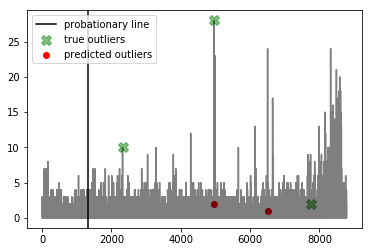




--- international-airline-passengers ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  []


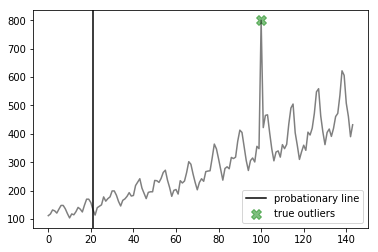




--- exchange-3_cpc_results ---
Corresponding window precision:  1.0
Corresponding window recall:  0.3333333333333333
Corresponding window false positives:  0
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  [467, 468]


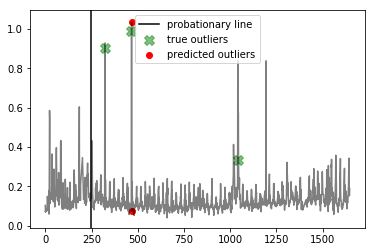




--- nyc_taxi ---
Corresponding window precision:  1.0
Corresponding window recall:  0.2
Corresponding window false positives:  0
Corresponding window false negatives:  4


Outlier indices as determined by best window threshold:  [5955, 5956]


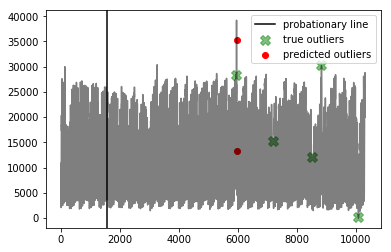




--- elb_request_count_8c0756 ---
Corresponding window precision:  1.0
Corresponding window recall:  1.0
Corresponding window false positives:  0
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [792, 3691]


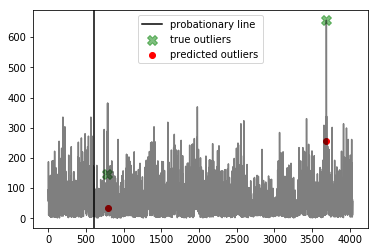




--- ambient_temperature_system_failure ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  []


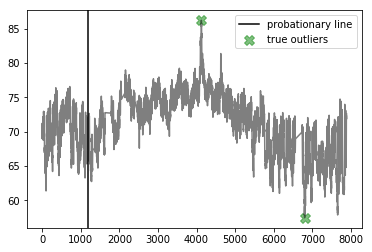




--- exchange-2_cpm_results ---
Corresponding window precision:  1.0
Corresponding window recall:  0.5
Corresponding window false positives:  0
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [978]


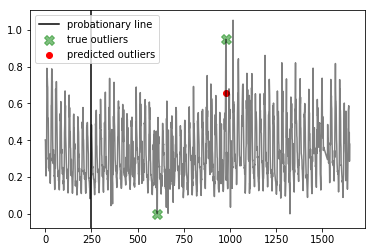




--- exchange-3_cpm_results ---
Corresponding window precision:  1.0
Corresponding window recall:  1.0
Corresponding window false positives:  0
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [1194, 1195]


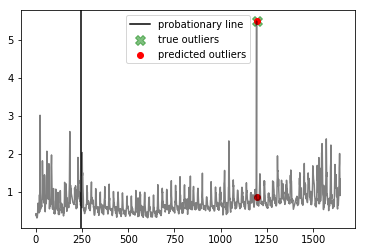




--- exchange-2_cpc_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  []


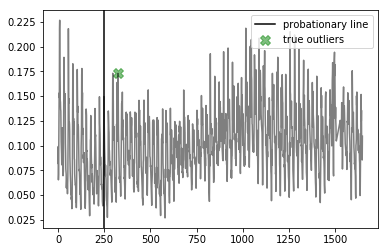




--- FARM_Bowling-Green-5-S_Warren ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  3


Outlier indices as determined by best window threshold:  []


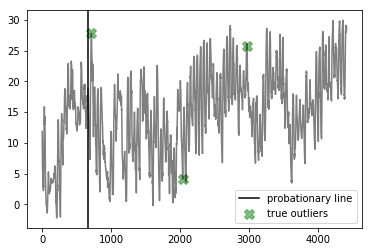

---------weight_fp=0.4, weight_fn=1----------


----Window-Based Results----
Minimum number of mistakes:  16.4
Best window threshold:  0.0001
Corresponding window overall precision:  0.75
Corresponding window overall recall:  0.2608695652173913
Corresponding window overall F score:  0.3870967741935483



--- all_data_gift_certificates ---
Corresponding window precision:  0.5
Corresponding window recall:  0.3333333333333333
Corresponding window false positives:  1
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  [4964, 6506]


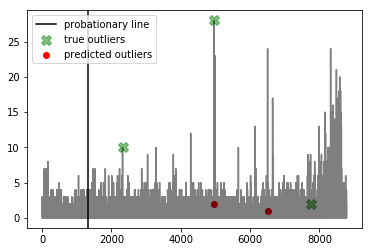




--- international-airline-passengers ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  []


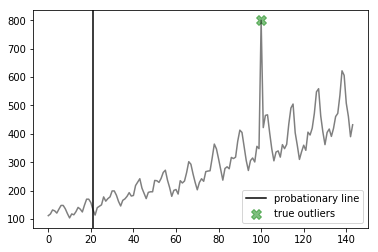




--- exchange-3_cpc_results ---
Corresponding window precision:  1.0
Corresponding window recall:  0.3333333333333333
Corresponding window false positives:  0
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  [467, 468]


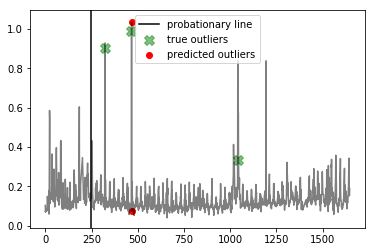




--- nyc_taxi ---
Corresponding window precision:  1.0
Corresponding window recall:  0.2
Corresponding window false positives:  0
Corresponding window false negatives:  4


Outlier indices as determined by best window threshold:  [5955, 5956]


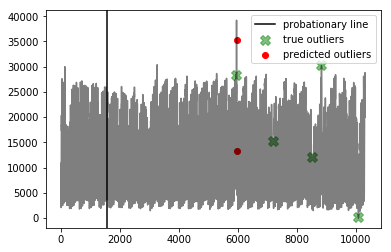




--- elb_request_count_8c0756 ---
Corresponding window precision:  1.0
Corresponding window recall:  1.0
Corresponding window false positives:  0
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [792, 3691]


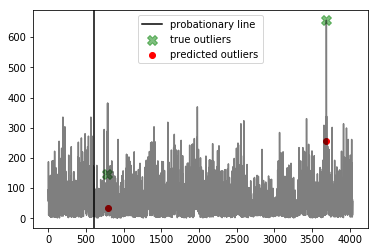




--- ambient_temperature_system_failure ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  []


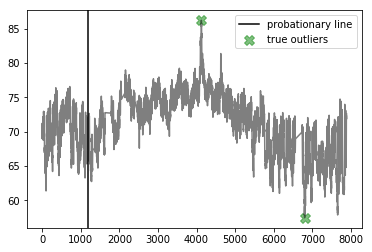




--- exchange-2_cpm_results ---
Corresponding window precision:  1.0
Corresponding window recall:  0.5
Corresponding window false positives:  0
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [978]


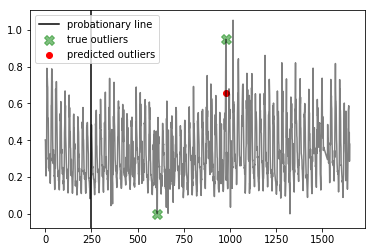




--- exchange-3_cpm_results ---
Corresponding window precision:  1.0
Corresponding window recall:  1.0
Corresponding window false positives:  0
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [1194, 1195]


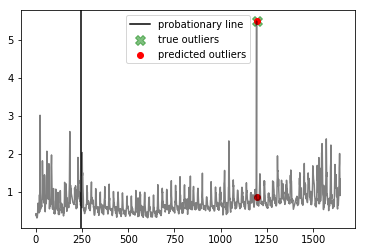




--- exchange-2_cpc_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  []


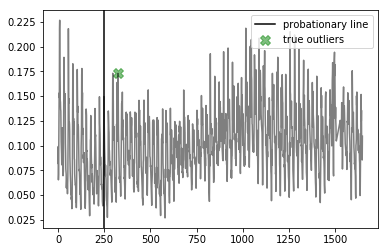




--- FARM_Bowling-Green-5-S_Warren ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  3


Outlier indices as determined by best window threshold:  []


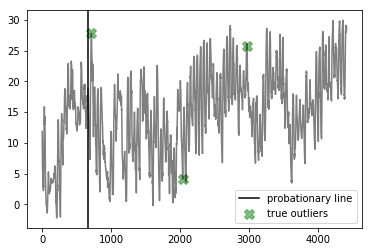

---------weight_fp=0.5, weight_fn=1----------


----Window-Based Results----
Minimum number of mistakes:  16.5
Best window threshold:  0.0001
Corresponding window overall precision:  0.75
Corresponding window overall recall:  0.2608695652173913
Corresponding window overall F score:  0.3870967741935483



--- all_data_gift_certificates ---
Corresponding window precision:  0.5
Corresponding window recall:  0.3333333333333333
Corresponding window false positives:  1
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  [4964, 6506]


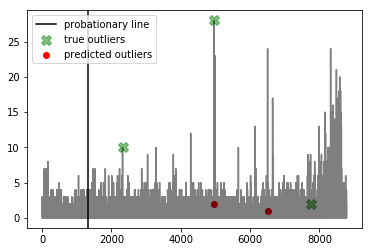




--- international-airline-passengers ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  []


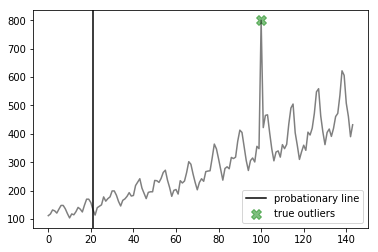




--- exchange-3_cpc_results ---
Corresponding window precision:  1.0
Corresponding window recall:  0.3333333333333333
Corresponding window false positives:  0
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  [467, 468]


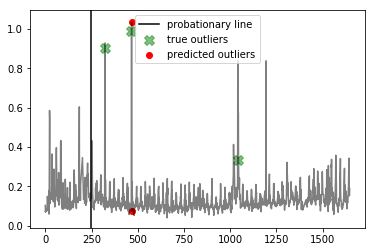




--- nyc_taxi ---
Corresponding window precision:  1.0
Corresponding window recall:  0.2
Corresponding window false positives:  0
Corresponding window false negatives:  4


Outlier indices as determined by best window threshold:  [5955, 5956]


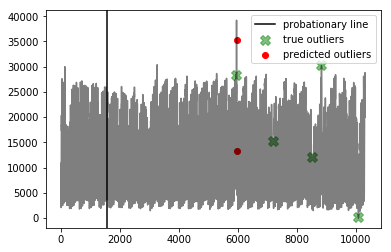




--- elb_request_count_8c0756 ---
Corresponding window precision:  1.0
Corresponding window recall:  1.0
Corresponding window false positives:  0
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [792, 3691]


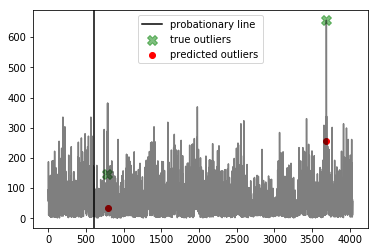




--- ambient_temperature_system_failure ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  []


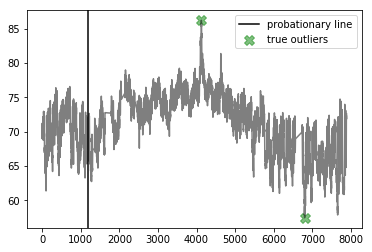




--- exchange-2_cpm_results ---
Corresponding window precision:  1.0
Corresponding window recall:  0.5
Corresponding window false positives:  0
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [978]


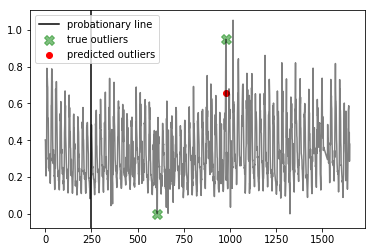




--- exchange-3_cpm_results ---
Corresponding window precision:  1.0
Corresponding window recall:  1.0
Corresponding window false positives:  0
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [1194, 1195]


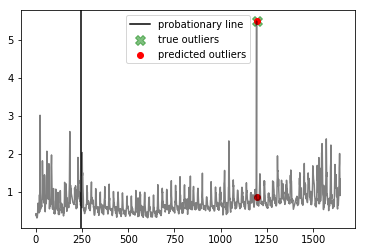




--- exchange-2_cpc_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  []


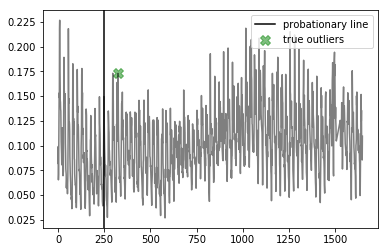




--- FARM_Bowling-Green-5-S_Warren ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  3


Outlier indices as determined by best window threshold:  []


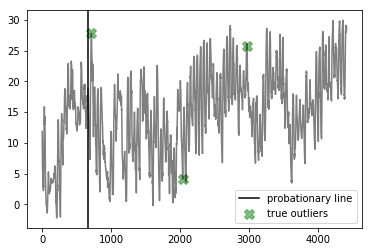

---------weight_fp=0.6, weight_fn=1----------


----Window-Based Results----
Minimum number of mistakes:  16.6
Best window threshold:  0.0001
Corresponding window overall precision:  0.75
Corresponding window overall recall:  0.2608695652173913
Corresponding window overall F score:  0.3870967741935483



--- all_data_gift_certificates ---
Corresponding window precision:  0.5
Corresponding window recall:  0.3333333333333333
Corresponding window false positives:  1
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  [4964, 6506]


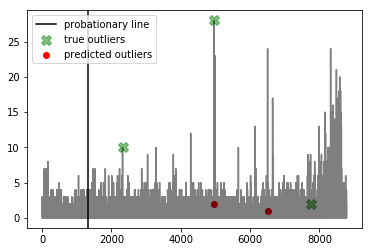




--- international-airline-passengers ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  []


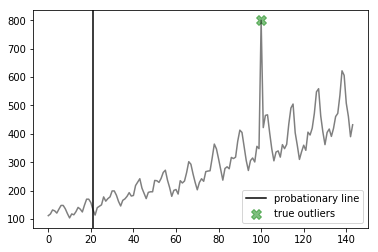




--- exchange-3_cpc_results ---
Corresponding window precision:  1.0
Corresponding window recall:  0.3333333333333333
Corresponding window false positives:  0
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  [467, 468]


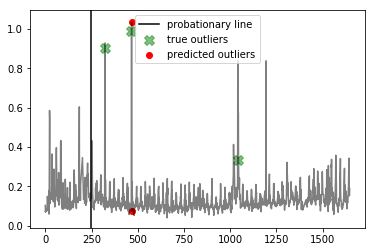




--- nyc_taxi ---
Corresponding window precision:  1.0
Corresponding window recall:  0.2
Corresponding window false positives:  0
Corresponding window false negatives:  4


Outlier indices as determined by best window threshold:  [5955, 5956]


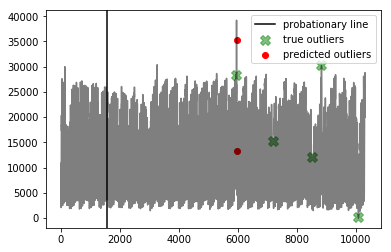




--- elb_request_count_8c0756 ---
Corresponding window precision:  1.0
Corresponding window recall:  1.0
Corresponding window false positives:  0
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [792, 3691]


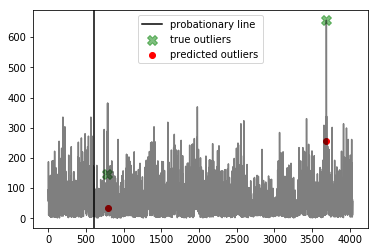




--- ambient_temperature_system_failure ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  []


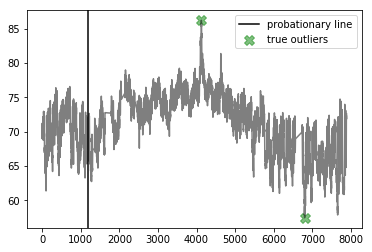




--- exchange-2_cpm_results ---
Corresponding window precision:  1.0
Corresponding window recall:  0.5
Corresponding window false positives:  0
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [978]


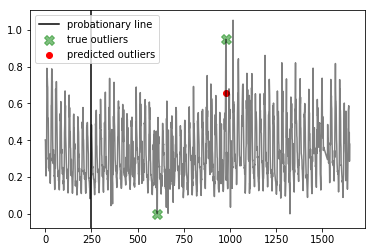




--- exchange-3_cpm_results ---
Corresponding window precision:  1.0
Corresponding window recall:  1.0
Corresponding window false positives:  0
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [1194, 1195]


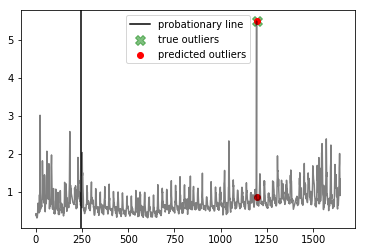




--- exchange-2_cpc_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  []


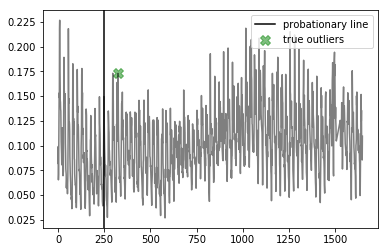




--- FARM_Bowling-Green-5-S_Warren ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  3


Outlier indices as determined by best window threshold:  []


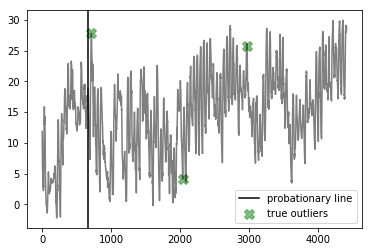

---------weight_fp=0.7, weight_fn=1----------


----Window-Based Results----
Minimum number of mistakes:  16.7
Best window threshold:  0.0001
Corresponding window overall precision:  0.75
Corresponding window overall recall:  0.2608695652173913
Corresponding window overall F score:  0.3870967741935483



--- all_data_gift_certificates ---
Corresponding window precision:  0.5
Corresponding window recall:  0.3333333333333333
Corresponding window false positives:  1
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  [4964, 6506]


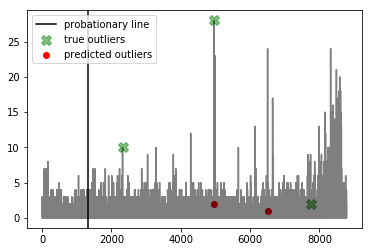




--- international-airline-passengers ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  []


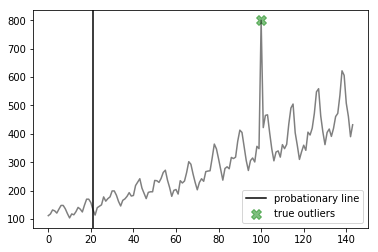




--- exchange-3_cpc_results ---
Corresponding window precision:  1.0
Corresponding window recall:  0.3333333333333333
Corresponding window false positives:  0
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  [467, 468]


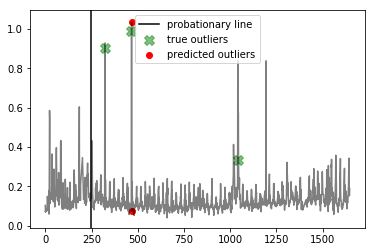




--- nyc_taxi ---
Corresponding window precision:  1.0
Corresponding window recall:  0.2
Corresponding window false positives:  0
Corresponding window false negatives:  4


Outlier indices as determined by best window threshold:  [5955, 5956]


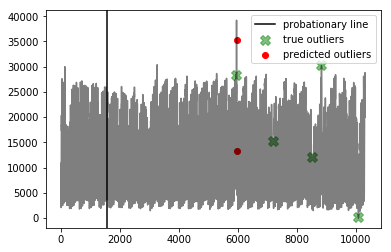




--- elb_request_count_8c0756 ---
Corresponding window precision:  1.0
Corresponding window recall:  1.0
Corresponding window false positives:  0
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [792, 3691]


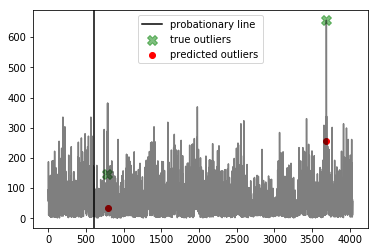




--- ambient_temperature_system_failure ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  []


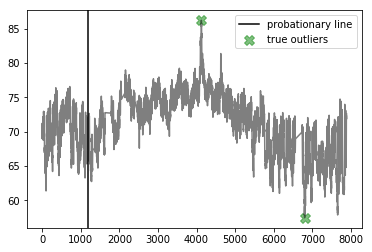




--- exchange-2_cpm_results ---
Corresponding window precision:  1.0
Corresponding window recall:  0.5
Corresponding window false positives:  0
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [978]


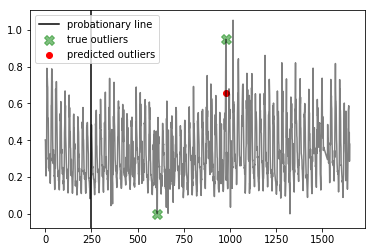




--- exchange-3_cpm_results ---
Corresponding window precision:  1.0
Corresponding window recall:  1.0
Corresponding window false positives:  0
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [1194, 1195]


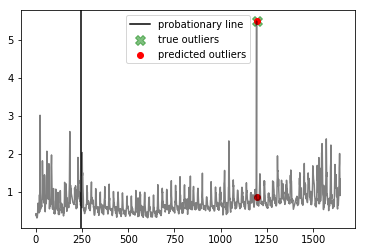




--- exchange-2_cpc_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  []


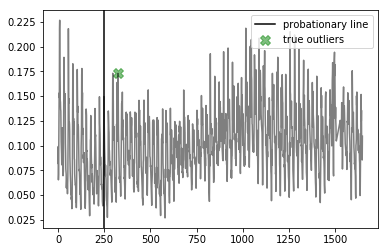




--- FARM_Bowling-Green-5-S_Warren ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  3


Outlier indices as determined by best window threshold:  []


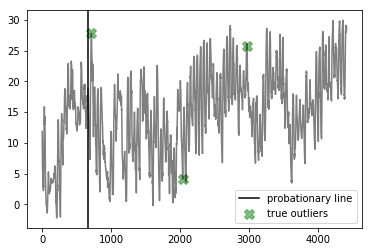

---------weight_fp=0.8, weight_fn=1----------


----Window-Based Results----
Minimum number of mistakes:  16.8
Best window threshold:  0.0001
Corresponding window overall precision:  0.75
Corresponding window overall recall:  0.2608695652173913
Corresponding window overall F score:  0.3870967741935483



--- all_data_gift_certificates ---
Corresponding window precision:  0.5
Corresponding window recall:  0.3333333333333333
Corresponding window false positives:  1
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  [4964, 6506]


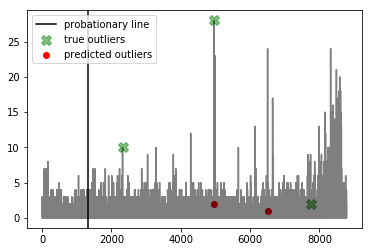




--- international-airline-passengers ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  []


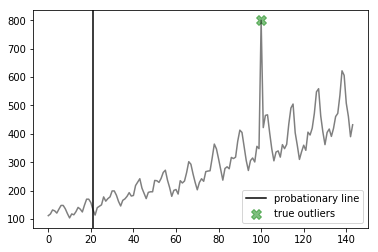




--- exchange-3_cpc_results ---
Corresponding window precision:  1.0
Corresponding window recall:  0.3333333333333333
Corresponding window false positives:  0
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  [467, 468]


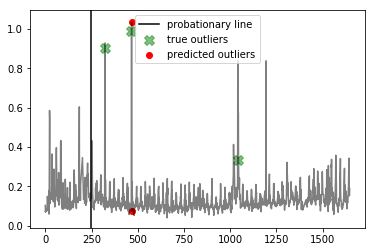




--- nyc_taxi ---
Corresponding window precision:  1.0
Corresponding window recall:  0.2
Corresponding window false positives:  0
Corresponding window false negatives:  4


Outlier indices as determined by best window threshold:  [5955, 5956]


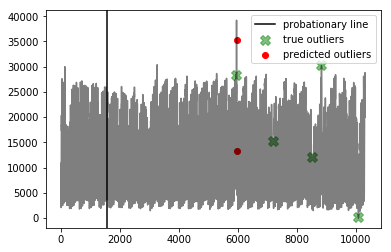




--- elb_request_count_8c0756 ---
Corresponding window precision:  1.0
Corresponding window recall:  1.0
Corresponding window false positives:  0
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [792, 3691]


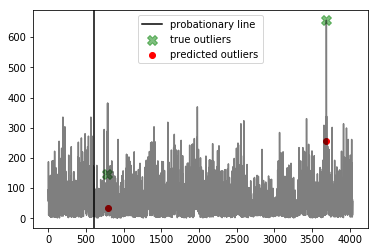




--- ambient_temperature_system_failure ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  []


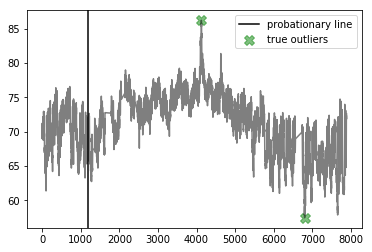




--- exchange-2_cpm_results ---
Corresponding window precision:  1.0
Corresponding window recall:  0.5
Corresponding window false positives:  0
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [978]


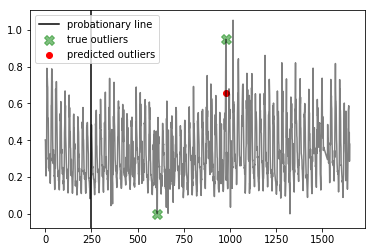




--- exchange-3_cpm_results ---
Corresponding window precision:  1.0
Corresponding window recall:  1.0
Corresponding window false positives:  0
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [1194, 1195]


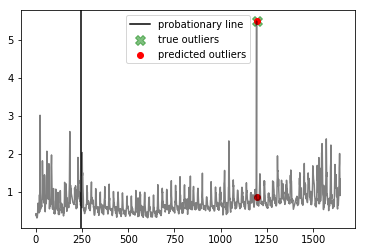




--- exchange-2_cpc_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  []


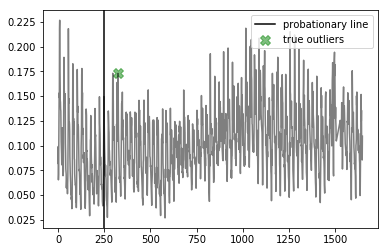




--- FARM_Bowling-Green-5-S_Warren ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  3


Outlier indices as determined by best window threshold:  []


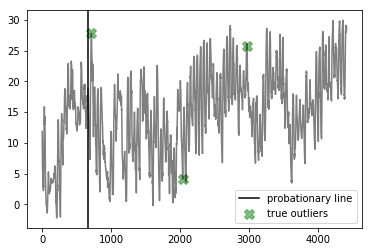

---------weight_fp=0.9, weight_fn=1----------


----Window-Based Results----
Minimum number of mistakes:  16.9
Best window threshold:  0.0001
Corresponding window overall precision:  0.75
Corresponding window overall recall:  0.2608695652173913
Corresponding window overall F score:  0.3870967741935483



--- all_data_gift_certificates ---
Corresponding window precision:  0.5
Corresponding window recall:  0.3333333333333333
Corresponding window false positives:  1
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  [4964, 6506]


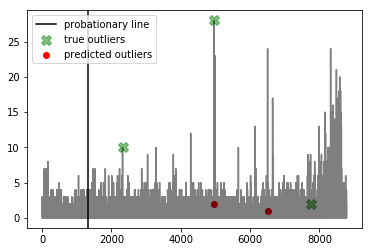




--- international-airline-passengers ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  []


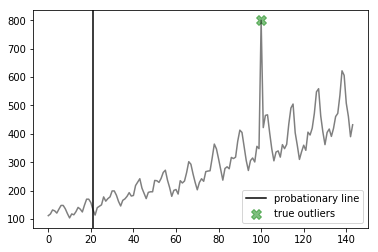




--- exchange-3_cpc_results ---
Corresponding window precision:  1.0
Corresponding window recall:  0.3333333333333333
Corresponding window false positives:  0
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  [467, 468]


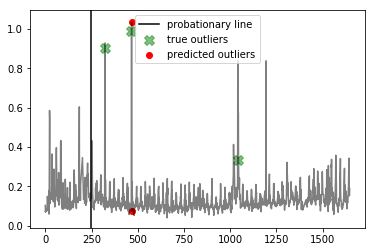




--- nyc_taxi ---
Corresponding window precision:  1.0
Corresponding window recall:  0.2
Corresponding window false positives:  0
Corresponding window false negatives:  4


Outlier indices as determined by best window threshold:  [5955, 5956]


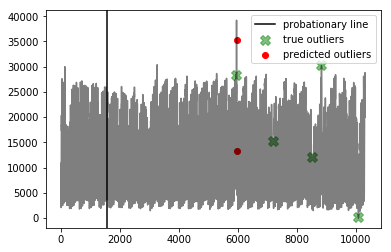




--- elb_request_count_8c0756 ---
Corresponding window precision:  1.0
Corresponding window recall:  1.0
Corresponding window false positives:  0
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [792, 3691]


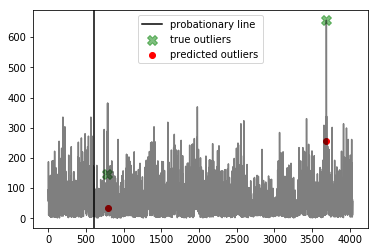




--- ambient_temperature_system_failure ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  []


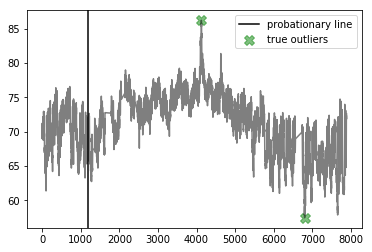




--- exchange-2_cpm_results ---
Corresponding window precision:  1.0
Corresponding window recall:  0.5
Corresponding window false positives:  0
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [978]


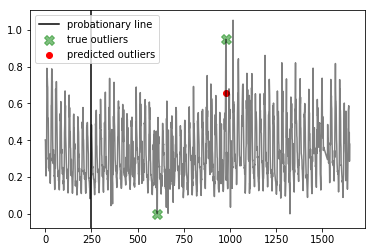




--- exchange-3_cpm_results ---
Corresponding window precision:  1.0
Corresponding window recall:  1.0
Corresponding window false positives:  0
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [1194, 1195]


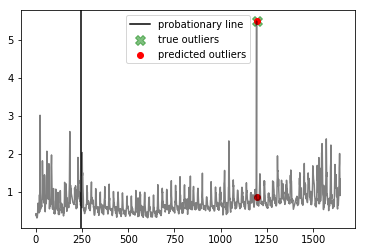




--- exchange-2_cpc_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  []


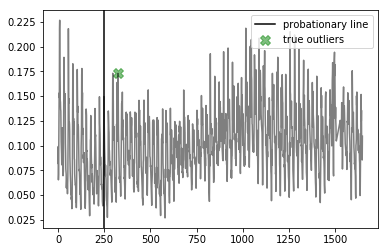




--- FARM_Bowling-Green-5-S_Warren ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  3


Outlier indices as determined by best window threshold:  []


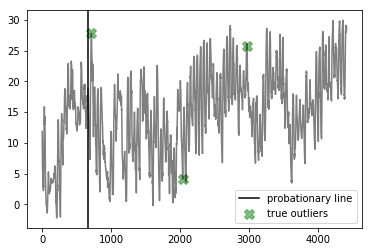

---------weight_fp=1.0, weight_fn=1----------


----Window-Based Results----
Minimum number of mistakes:  17.0
Best window threshold:  0.0001
Corresponding window overall precision:  0.75
Corresponding window overall recall:  0.2608695652173913
Corresponding window overall F score:  0.3870967741935483



--- all_data_gift_certificates ---
Corresponding window precision:  0.5
Corresponding window recall:  0.3333333333333333
Corresponding window false positives:  1
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  [4964, 6506]


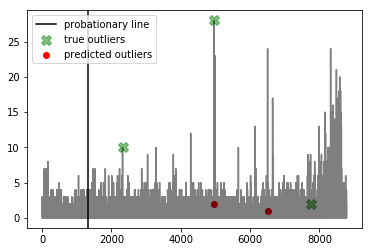




--- international-airline-passengers ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  []


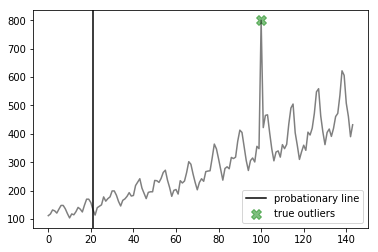




--- exchange-3_cpc_results ---
Corresponding window precision:  1.0
Corresponding window recall:  0.3333333333333333
Corresponding window false positives:  0
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  [467, 468]


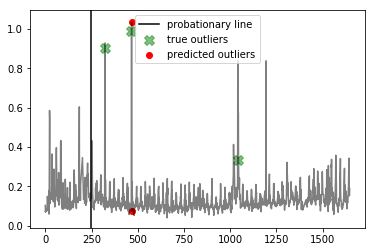




--- nyc_taxi ---
Corresponding window precision:  1.0
Corresponding window recall:  0.2
Corresponding window false positives:  0
Corresponding window false negatives:  4


Outlier indices as determined by best window threshold:  [5955, 5956]


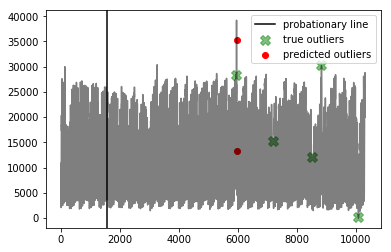




--- elb_request_count_8c0756 ---
Corresponding window precision:  1.0
Corresponding window recall:  1.0
Corresponding window false positives:  0
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [792, 3691]


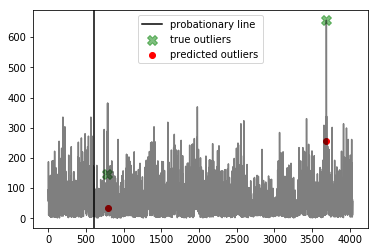




--- ambient_temperature_system_failure ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  []


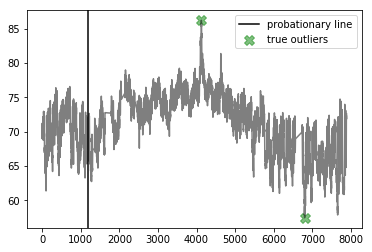




--- exchange-2_cpm_results ---
Corresponding window precision:  1.0
Corresponding window recall:  0.5
Corresponding window false positives:  0
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [978]


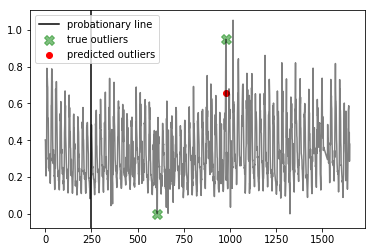




--- exchange-3_cpm_results ---
Corresponding window precision:  1.0
Corresponding window recall:  1.0
Corresponding window false positives:  0
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [1194, 1195]


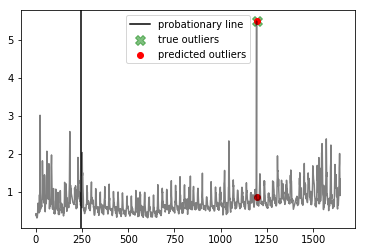




--- exchange-2_cpc_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  []


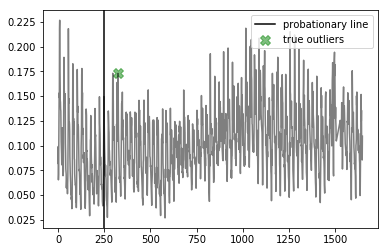




--- FARM_Bowling-Green-5-S_Warren ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  3


Outlier indices as determined by best window threshold:  []


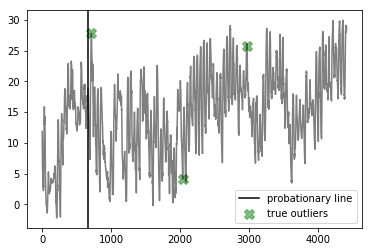

------------
False Positive Weight:  0.1
	 Minimum number of mistakes : 16.1
	 Best window threshold : 0.0001
	 Corresponding window overall precision : 0.75
	 Corresponding window overall recall : 0.2608695652173913
	 Corresponding window overall F score : 0.3870967741935483
False Positive Weight:  0.2
	 Minimum number of mistakes : 16.2
	 Best window threshold : 0.0001
	 Corresponding window overall precision : 0.75
	 Corresponding window overall recall : 0.2608695652173913
	 Corresponding window overall F score : 0.3870967741935483
False Positive Weight:  0.3
	 Minimum number of mistakes : 16.3
	 Best window threshold : 0.0001
	 Corresponding window overall precision : 0.75
	 Corresponding window overall recall : 0.2608695652173913
	 Corresponding window overall F score : 0.3870967741935483
False Positive Weight:  0.6
	 Minimum number of mistakes : 16.6
	 Best window threshold : 0.0001
	 Corresponding window overall precision : 0.75
	 Corresponding window overall recall : 0.26086956

In [25]:
end_results = {}
for weight_fp in weight_fp_list:  
    print("---------weight_fp=" + str(weight_fp) + ", weight_fn=1----------")
    weight_result = adclasses.pretty_print_results(ad_dict, anomaly_scores_dict, true_outlier_indices_dict, weight_fp=weight_fp, weight_fn=1)
    end_results[weight_fp] = weight_result

print("------------")
adclasses.pretty_print_end_results(end_results)

# HTM Results 

everything except for international-airline-passengers

In [26]:
htm_dataset_name_list = ["nyc_taxi",
                         "exchange-2_cpm_results",
                         "exchange-3_cpm_results",
                         "all_data_gift_certificates",
                         "elb_request_count_8c0756",
                         "FARM_Bowling-Green-5-S_Warren",
                         "exchange-2_cpc_results",
                         "exchange-3_cpc_results",
                         "ambient_temperature_system_failure"]

htm_ad_dict = {}
for dataset_name in htm_dataset_name_list:
    htm_ad_dict[dataset_name] = ad_dict[dataset_name]
    
htm_true_outlier_indices_dict = {}
for dataset_name in htm_dataset_name_list:
    htm_true_outlier_indices_dict[dataset_name] = true_outlier_indices_dict[dataset_name]

In [27]:
anomaly_scores_dict = {}

for dataset_name in htm_dataset_name_list:
    output_dict_htm = joblib.load("anomaly_scores/HTM/" + dataset_name)
    anomaly_scores_dict[dataset_name] = output_dict_htm["Anomaly Scores"]

In [28]:
adclasses.precision_recall_curve_info(anomaly_scores_dict, htm_true_outlier_indices_dict)

{0.1: {'precision': 0.25, 'recall': 0.3333333333333333},
 0.2: {'precision': 0.3333333333333333, 'recall': 0.3333333333333333},
 0.3: {'precision': 0.5, 'recall': 0.3333333333333333},
 0.4: {'precision': 0.5, 'recall': 0.3333333333333333},
 0.5: {'precision': 0.5, 'recall': 0.3333333333333333},
 0.6: {'precision': 0.0, 'recall': 0.0},
 0.7: {'precision': 0.0, 'recall': 0.0},
 0.8: {'precision': 0.0, 'recall': 0.0},
 0.9: {'precision': 0.0, 'recall': 0.0},
 1.0: {'precision': 0.0, 'recall': 0.0}}

---------weight_fp=0.1, weight_fn=1----------


----Window-Based Results----
Minimum number of mistakes:  8.4
Best window threshold:  0.4663
Corresponding window overall precision:  0.3902439024390244
Corresponding window overall recall:  0.7272727272727273
Corresponding window overall F score:  0.5079365079365079



--- all_data_gift_certificates ---
Corresponding window precision:  0.23076923076923078
Corresponding window recall:  1.0
Corresponding window false positives:  10
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [2321, 2872, 3043, 4287, 4962, 4987, 5663, 6138, 6506, 6651, 6670, 7680, 7687, 7872, 7986, 8016, 8065, 8157, 8180, 8324, 8346, 8347, 8376, 8378, 8598]


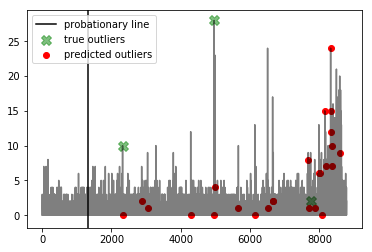




--- exchange-3_cpc_results ---
Corresponding window precision:  1.0
Corresponding window recall:  0.3333333333333333
Corresponding window false positives:  0
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  [1022, 1023, 1043]


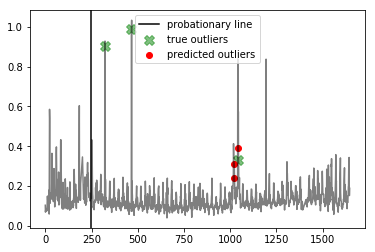




--- nyc_taxi ---
Corresponding window precision:  0.7142857142857143
Corresponding window recall:  1.0
Corresponding window false positives:  2
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [3250, 3251, 3263, 5929, 5955, 7193, 7608, 8523, 8835, 10062, 10105]


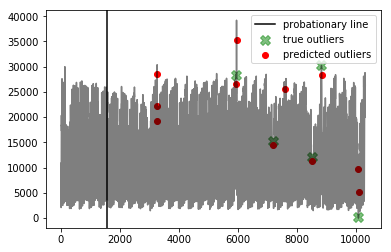




--- elb_request_count_8c0756 ---
Corresponding window precision:  0.5
Corresponding window recall:  1.0
Corresponding window false positives:  2
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [787, 1407, 1979, 1983, 3668, 3692, 3768]


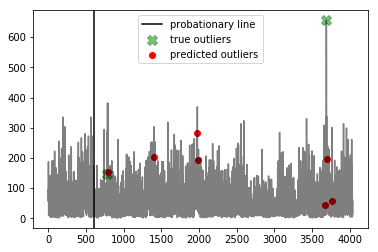




--- ambient_temperature_system_failure ---
Corresponding window precision:  0.4
Corresponding window recall:  1.0
Corresponding window false positives:  3
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [2039, 2156, 3556, 4101, 4123, 6792, 6793, 6794, 7657]


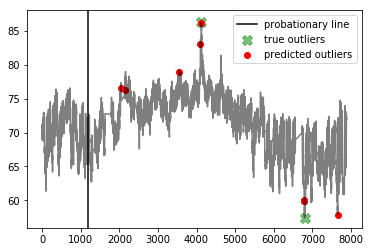




--- exchange-2_cpm_results ---
Corresponding window precision:  0.5
Corresponding window recall:  0.5
Corresponding window false positives:  1
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [979, 986, 1105]


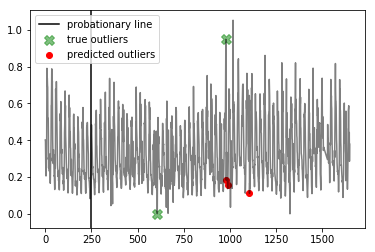




--- exchange-3_cpm_results ---
Corresponding window precision:  0.3333333333333333
Corresponding window recall:  1.0
Corresponding window false positives:  2
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [1046, 1049, 1050, 1193, 1532, 1554, 1574, 1575, 1576, 1577, 1578]


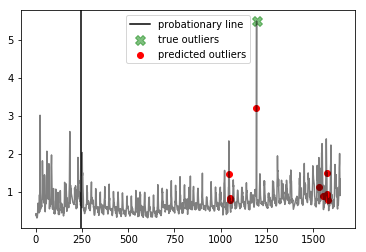




--- exchange-2_cpc_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  3
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [654, 655, 656, 1046, 1486]


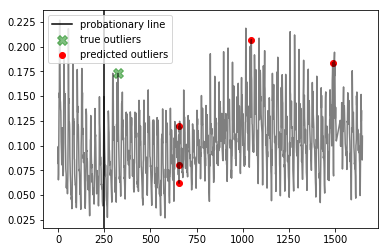




--- FARM_Bowling-Green-5-S_Warren ---
Corresponding window precision:  0.5
Corresponding window recall:  0.3333333333333333
Corresponding window false positives:  1
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  [713, 2303]


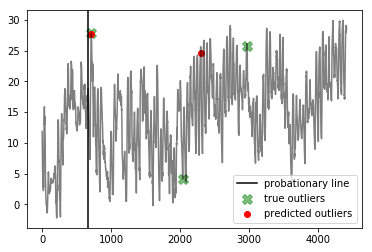

---------weight_fp=0.2, weight_fn=1----------


----Window-Based Results----
Minimum number of mistakes:  10.8
Best window threshold:  0.4663
Corresponding window overall precision:  0.3902439024390244
Corresponding window overall recall:  0.7272727272727273
Corresponding window overall F score:  0.5079365079365079



--- all_data_gift_certificates ---
Corresponding window precision:  0.23076923076923078
Corresponding window recall:  1.0
Corresponding window false positives:  10
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [2321, 2872, 3043, 4287, 4962, 4987, 5663, 6138, 6506, 6651, 6670, 7680, 7687, 7872, 7986, 8016, 8065, 8157, 8180, 8324, 8346, 8347, 8376, 8378, 8598]


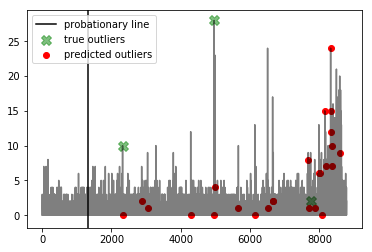




--- exchange-3_cpc_results ---
Corresponding window precision:  1.0
Corresponding window recall:  0.3333333333333333
Corresponding window false positives:  0
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  [1022, 1023, 1043]


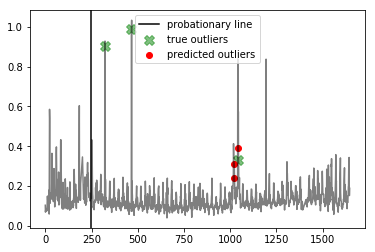




--- nyc_taxi ---
Corresponding window precision:  0.7142857142857143
Corresponding window recall:  1.0
Corresponding window false positives:  2
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [3250, 3251, 3263, 5929, 5955, 7193, 7608, 8523, 8835, 10062, 10105]


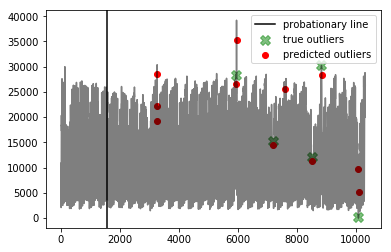




--- elb_request_count_8c0756 ---
Corresponding window precision:  0.5
Corresponding window recall:  1.0
Corresponding window false positives:  2
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [787, 1407, 1979, 1983, 3668, 3692, 3768]


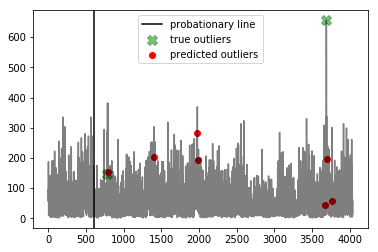




--- ambient_temperature_system_failure ---
Corresponding window precision:  0.4
Corresponding window recall:  1.0
Corresponding window false positives:  3
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [2039, 2156, 3556, 4101, 4123, 6792, 6793, 6794, 7657]


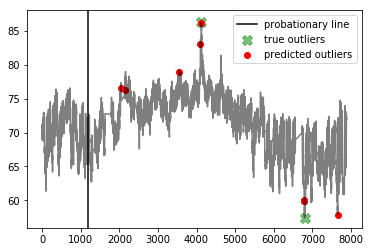




--- exchange-2_cpm_results ---
Corresponding window precision:  0.5
Corresponding window recall:  0.5
Corresponding window false positives:  1
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [979, 986, 1105]


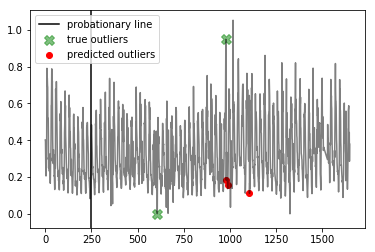




--- exchange-3_cpm_results ---
Corresponding window precision:  0.3333333333333333
Corresponding window recall:  1.0
Corresponding window false positives:  2
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [1046, 1049, 1050, 1193, 1532, 1554, 1574, 1575, 1576, 1577, 1578]


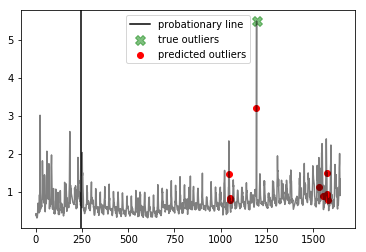




--- exchange-2_cpc_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  3
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [654, 655, 656, 1046, 1486]


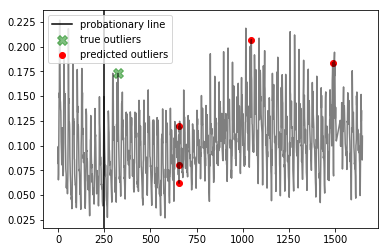




--- FARM_Bowling-Green-5-S_Warren ---
Corresponding window precision:  0.5
Corresponding window recall:  0.3333333333333333
Corresponding window false positives:  1
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  [713, 2303]


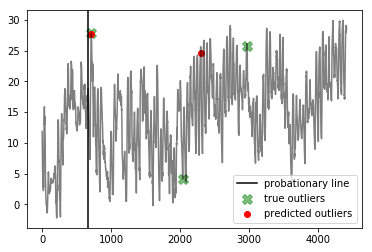

---------weight_fp=0.3, weight_fn=1----------


----Window-Based Results----
Minimum number of mistakes:  13.2
Best window threshold:  0.4663
Corresponding window overall precision:  0.3902439024390244
Corresponding window overall recall:  0.7272727272727273
Corresponding window overall F score:  0.5079365079365079



--- all_data_gift_certificates ---
Corresponding window precision:  0.23076923076923078
Corresponding window recall:  1.0
Corresponding window false positives:  10
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [2321, 2872, 3043, 4287, 4962, 4987, 5663, 6138, 6506, 6651, 6670, 7680, 7687, 7872, 7986, 8016, 8065, 8157, 8180, 8324, 8346, 8347, 8376, 8378, 8598]


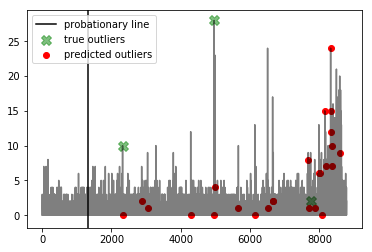




--- exchange-3_cpc_results ---
Corresponding window precision:  1.0
Corresponding window recall:  0.3333333333333333
Corresponding window false positives:  0
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  [1022, 1023, 1043]


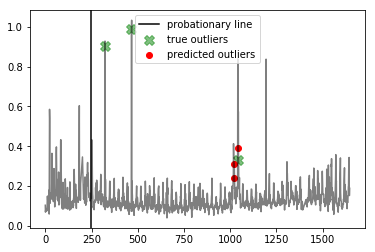




--- nyc_taxi ---
Corresponding window precision:  0.7142857142857143
Corresponding window recall:  1.0
Corresponding window false positives:  2
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [3250, 3251, 3263, 5929, 5955, 7193, 7608, 8523, 8835, 10062, 10105]


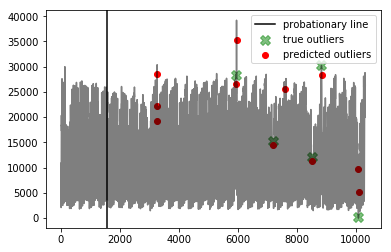




--- elb_request_count_8c0756 ---
Corresponding window precision:  0.5
Corresponding window recall:  1.0
Corresponding window false positives:  2
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [787, 1407, 1979, 1983, 3668, 3692, 3768]


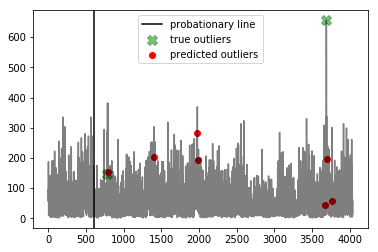




--- ambient_temperature_system_failure ---
Corresponding window precision:  0.4
Corresponding window recall:  1.0
Corresponding window false positives:  3
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [2039, 2156, 3556, 4101, 4123, 6792, 6793, 6794, 7657]


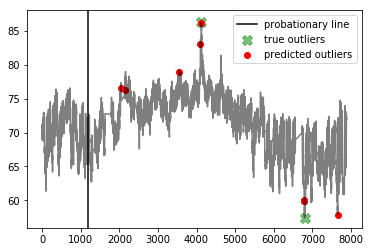




--- exchange-2_cpm_results ---
Corresponding window precision:  0.5
Corresponding window recall:  0.5
Corresponding window false positives:  1
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [979, 986, 1105]


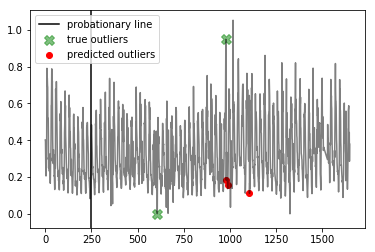




--- exchange-3_cpm_results ---
Corresponding window precision:  0.3333333333333333
Corresponding window recall:  1.0
Corresponding window false positives:  2
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [1046, 1049, 1050, 1193, 1532, 1554, 1574, 1575, 1576, 1577, 1578]


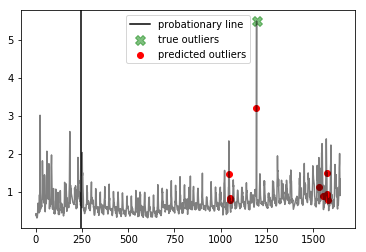




--- exchange-2_cpc_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  3
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [654, 655, 656, 1046, 1486]


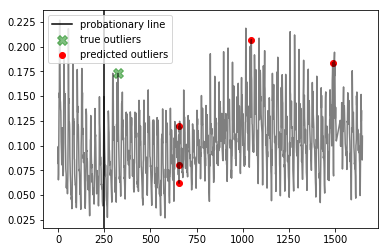




--- FARM_Bowling-Green-5-S_Warren ---
Corresponding window precision:  0.5
Corresponding window recall:  0.3333333333333333
Corresponding window false positives:  1
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  [713, 2303]


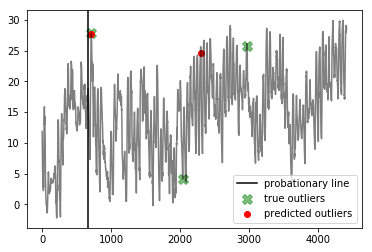

---------weight_fp=0.4, weight_fn=1----------


----Window-Based Results----
Minimum number of mistakes:  15.600000000000003
Best window threshold:  0.4663
Corresponding window overall precision:  0.3902439024390244
Corresponding window overall recall:  0.7272727272727273
Corresponding window overall F score:  0.5079365079365079



--- all_data_gift_certificates ---
Corresponding window precision:  0.23076923076923078
Corresponding window recall:  1.0
Corresponding window false positives:  10
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [2321, 2872, 3043, 4287, 4962, 4987, 5663, 6138, 6506, 6651, 6670, 7680, 7687, 7872, 7986, 8016, 8065, 8157, 8180, 8324, 8346, 8347, 8376, 8378, 8598]


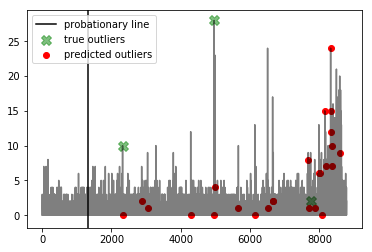




--- exchange-3_cpc_results ---
Corresponding window precision:  1.0
Corresponding window recall:  0.3333333333333333
Corresponding window false positives:  0
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  [1022, 1023, 1043]


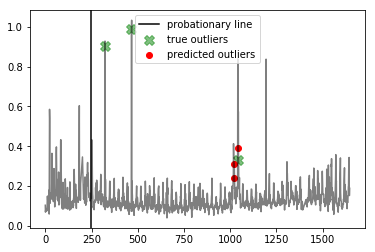




--- nyc_taxi ---
Corresponding window precision:  0.7142857142857143
Corresponding window recall:  1.0
Corresponding window false positives:  2
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [3250, 3251, 3263, 5929, 5955, 7193, 7608, 8523, 8835, 10062, 10105]


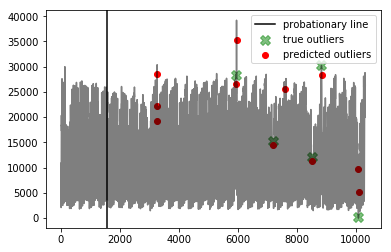




--- elb_request_count_8c0756 ---
Corresponding window precision:  0.5
Corresponding window recall:  1.0
Corresponding window false positives:  2
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [787, 1407, 1979, 1983, 3668, 3692, 3768]


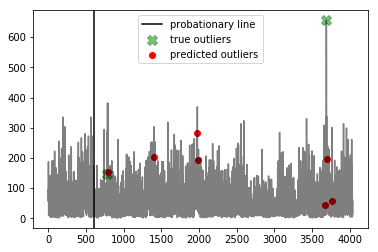




--- ambient_temperature_system_failure ---
Corresponding window precision:  0.4
Corresponding window recall:  1.0
Corresponding window false positives:  3
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [2039, 2156, 3556, 4101, 4123, 6792, 6793, 6794, 7657]


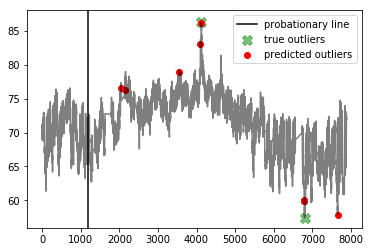




--- exchange-2_cpm_results ---
Corresponding window precision:  0.5
Corresponding window recall:  0.5
Corresponding window false positives:  1
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [979, 986, 1105]


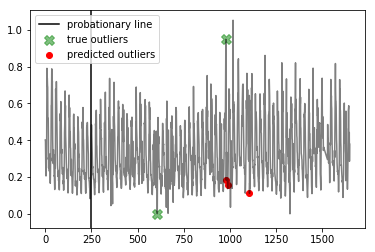




--- exchange-3_cpm_results ---
Corresponding window precision:  0.3333333333333333
Corresponding window recall:  1.0
Corresponding window false positives:  2
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [1046, 1049, 1050, 1193, 1532, 1554, 1574, 1575, 1576, 1577, 1578]


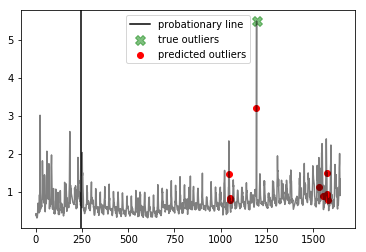




--- exchange-2_cpc_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  3
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [654, 655, 656, 1046, 1486]


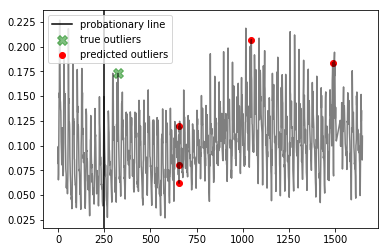




--- FARM_Bowling-Green-5-S_Warren ---
Corresponding window precision:  0.5
Corresponding window recall:  0.3333333333333333
Corresponding window false positives:  1
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  [713, 2303]


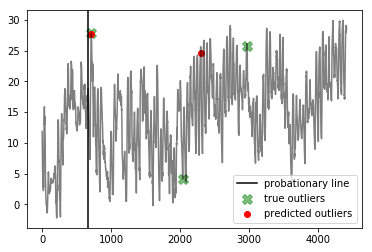

---------weight_fp=0.5, weight_fn=1----------


----Window-Based Results----
Minimum number of mistakes:  18.0
Best window threshold:  0.4663
Corresponding window overall precision:  0.3902439024390244
Corresponding window overall recall:  0.7272727272727273
Corresponding window overall F score:  0.5079365079365079



--- all_data_gift_certificates ---
Corresponding window precision:  0.23076923076923078
Corresponding window recall:  1.0
Corresponding window false positives:  10
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [2321, 2872, 3043, 4287, 4962, 4987, 5663, 6138, 6506, 6651, 6670, 7680, 7687, 7872, 7986, 8016, 8065, 8157, 8180, 8324, 8346, 8347, 8376, 8378, 8598]


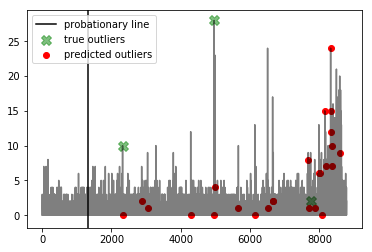




--- exchange-3_cpc_results ---
Corresponding window precision:  1.0
Corresponding window recall:  0.3333333333333333
Corresponding window false positives:  0
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  [1022, 1023, 1043]


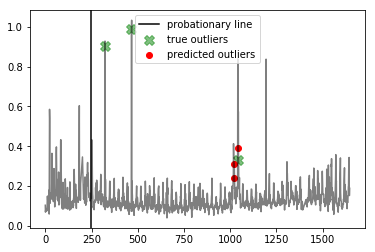




--- nyc_taxi ---
Corresponding window precision:  0.7142857142857143
Corresponding window recall:  1.0
Corresponding window false positives:  2
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [3250, 3251, 3263, 5929, 5955, 7193, 7608, 8523, 8835, 10062, 10105]


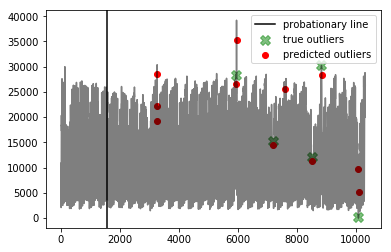




--- elb_request_count_8c0756 ---
Corresponding window precision:  0.5
Corresponding window recall:  1.0
Corresponding window false positives:  2
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [787, 1407, 1979, 1983, 3668, 3692, 3768]


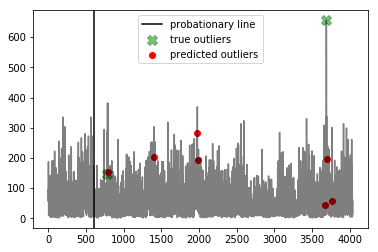




--- ambient_temperature_system_failure ---
Corresponding window precision:  0.4
Corresponding window recall:  1.0
Corresponding window false positives:  3
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [2039, 2156, 3556, 4101, 4123, 6792, 6793, 6794, 7657]


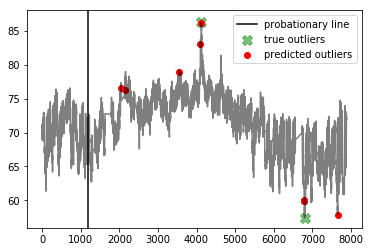




--- exchange-2_cpm_results ---
Corresponding window precision:  0.5
Corresponding window recall:  0.5
Corresponding window false positives:  1
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [979, 986, 1105]


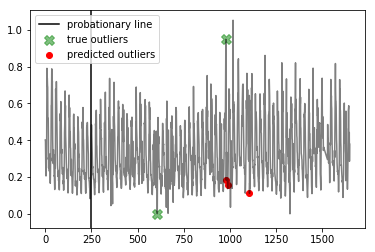




--- exchange-3_cpm_results ---
Corresponding window precision:  0.3333333333333333
Corresponding window recall:  1.0
Corresponding window false positives:  2
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [1046, 1049, 1050, 1193, 1532, 1554, 1574, 1575, 1576, 1577, 1578]


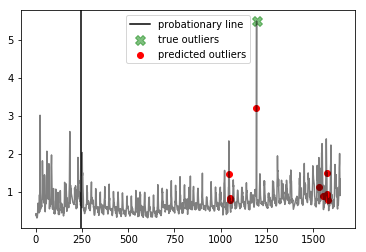




--- exchange-2_cpc_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  3
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [654, 655, 656, 1046, 1486]


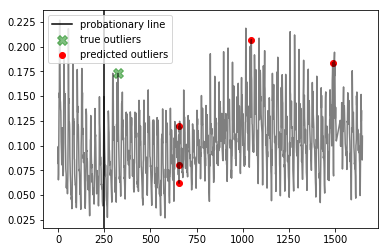




--- FARM_Bowling-Green-5-S_Warren ---
Corresponding window precision:  0.5
Corresponding window recall:  0.3333333333333333
Corresponding window false positives:  1
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  [713, 2303]


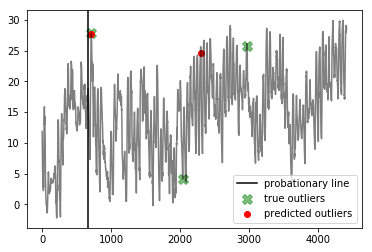

---------weight_fp=0.6, weight_fn=1----------


----Window-Based Results----
Minimum number of mistakes:  19.6
Best window threshold:  0.8455
Corresponding window overall precision:  0.75
Corresponding window overall recall:  0.13636363636363635
Corresponding window overall F score:  0.23076923076923075



--- all_data_gift_certificates ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  3


Outlier indices as determined by best window threshold:  []


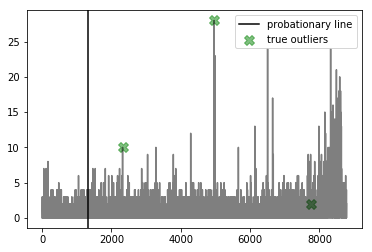




--- exchange-3_cpc_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  3


Outlier indices as determined by best window threshold:  []


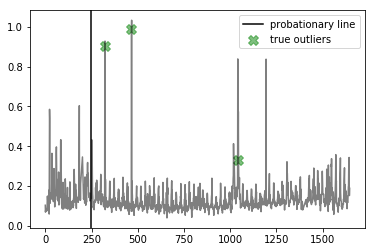




--- nyc_taxi ---
Corresponding window precision:  0.75
Corresponding window recall:  0.6
Corresponding window false positives:  1
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  [5955, 7608, 8523, 8835]


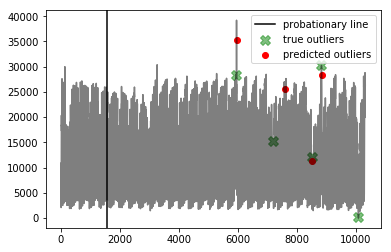




--- elb_request_count_8c0756 ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  []


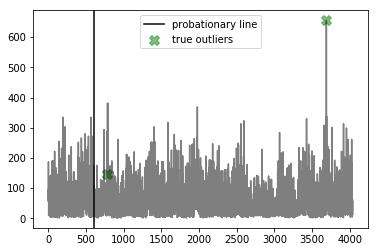




--- ambient_temperature_system_failure ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  []


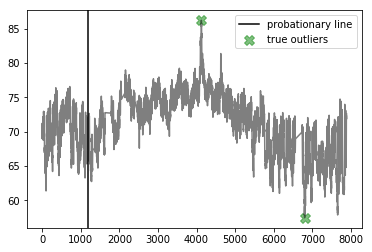




--- exchange-2_cpm_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  []


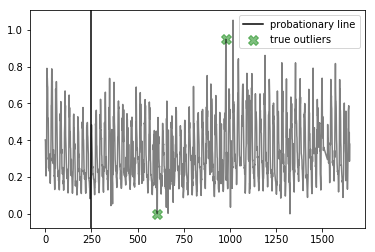




--- exchange-3_cpm_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  []


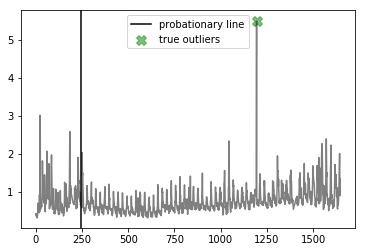




--- exchange-2_cpc_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  []


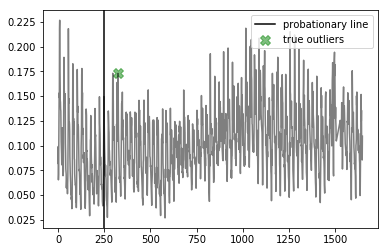




--- FARM_Bowling-Green-5-S_Warren ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  3


Outlier indices as determined by best window threshold:  []


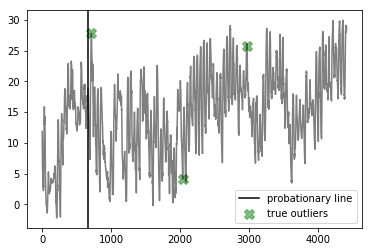

---------weight_fp=0.7, weight_fn=1----------


----Window-Based Results----
Minimum number of mistakes:  19.7
Best window threshold:  0.8455
Corresponding window overall precision:  0.75
Corresponding window overall recall:  0.13636363636363635
Corresponding window overall F score:  0.23076923076923075



--- all_data_gift_certificates ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  3


Outlier indices as determined by best window threshold:  []


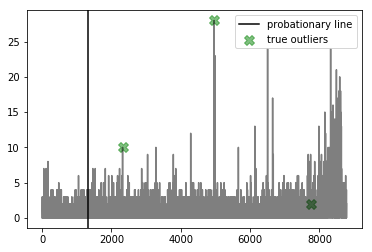




--- exchange-3_cpc_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  3


Outlier indices as determined by best window threshold:  []


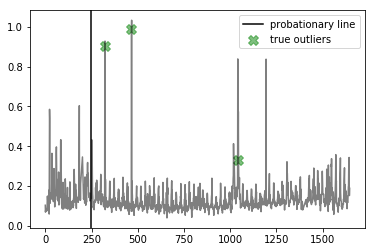




--- nyc_taxi ---
Corresponding window precision:  0.75
Corresponding window recall:  0.6
Corresponding window false positives:  1
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  [5955, 7608, 8523, 8835]


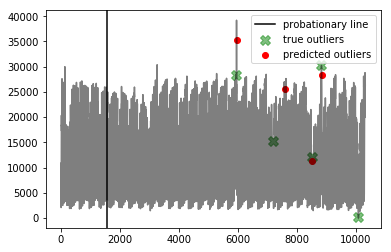




--- elb_request_count_8c0756 ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  []


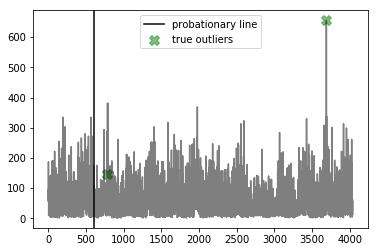




--- ambient_temperature_system_failure ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  []


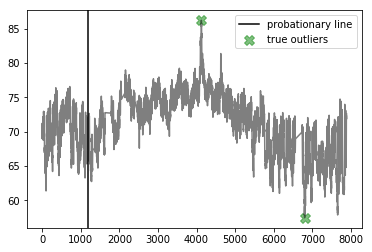




--- exchange-2_cpm_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  []


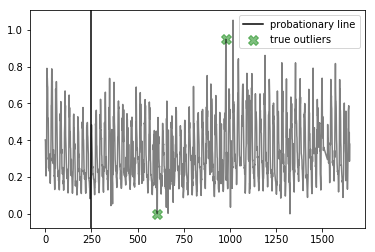




--- exchange-3_cpm_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  []


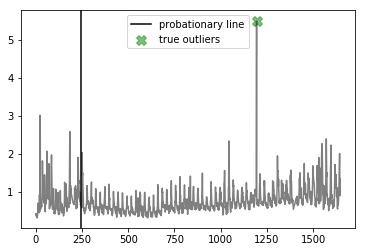




--- exchange-2_cpc_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  []


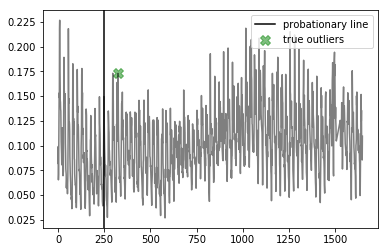




--- FARM_Bowling-Green-5-S_Warren ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  3


Outlier indices as determined by best window threshold:  []


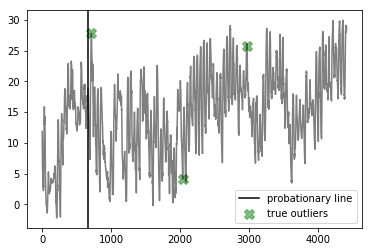

---------weight_fp=0.8, weight_fn=1----------


----Window-Based Results----
Minimum number of mistakes:  19.8
Best window threshold:  0.8455
Corresponding window overall precision:  0.75
Corresponding window overall recall:  0.13636363636363635
Corresponding window overall F score:  0.23076923076923075



--- all_data_gift_certificates ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  3


Outlier indices as determined by best window threshold:  []


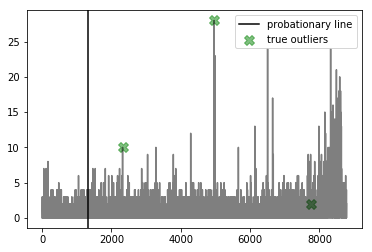




--- exchange-3_cpc_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  3


Outlier indices as determined by best window threshold:  []


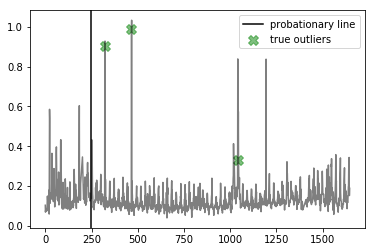




--- nyc_taxi ---
Corresponding window precision:  0.75
Corresponding window recall:  0.6
Corresponding window false positives:  1
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  [5955, 7608, 8523, 8835]


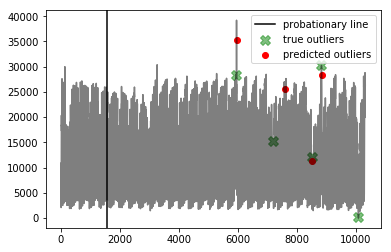




--- elb_request_count_8c0756 ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  []


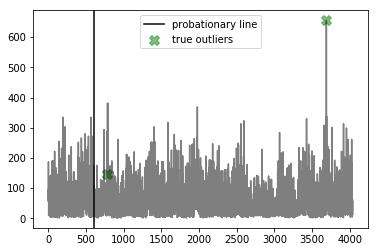




--- ambient_temperature_system_failure ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  []


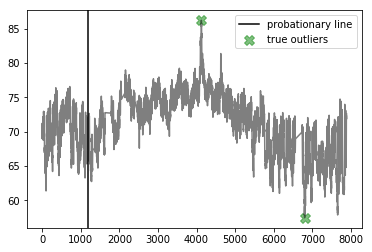




--- exchange-2_cpm_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  []


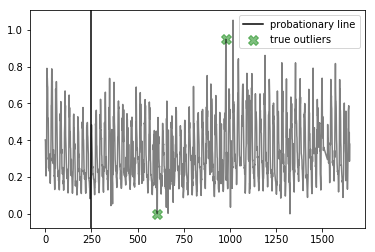




--- exchange-3_cpm_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  []


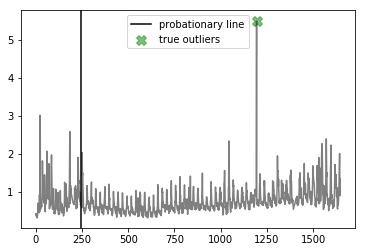




--- exchange-2_cpc_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  []


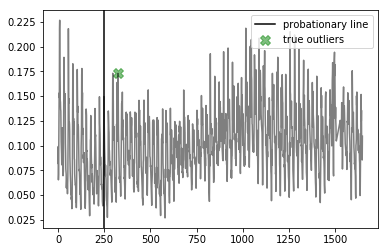




--- FARM_Bowling-Green-5-S_Warren ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  3


Outlier indices as determined by best window threshold:  []


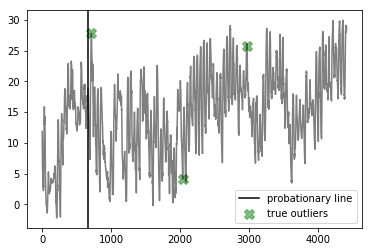

---------weight_fp=0.9, weight_fn=1----------


----Window-Based Results----
Minimum number of mistakes:  19.9
Best window threshold:  0.8455
Corresponding window overall precision:  0.75
Corresponding window overall recall:  0.13636363636363635
Corresponding window overall F score:  0.23076923076923075



--- all_data_gift_certificates ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  3


Outlier indices as determined by best window threshold:  []


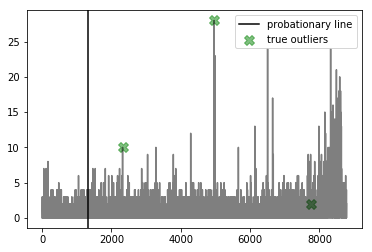




--- exchange-3_cpc_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  3


Outlier indices as determined by best window threshold:  []


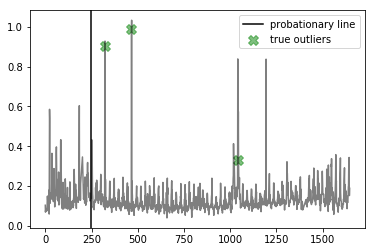




--- nyc_taxi ---
Corresponding window precision:  0.75
Corresponding window recall:  0.6
Corresponding window false positives:  1
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  [5955, 7608, 8523, 8835]


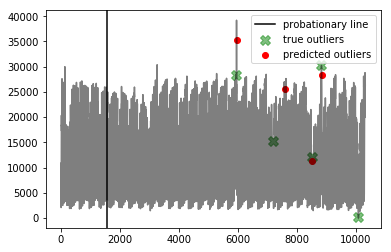




--- elb_request_count_8c0756 ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  []


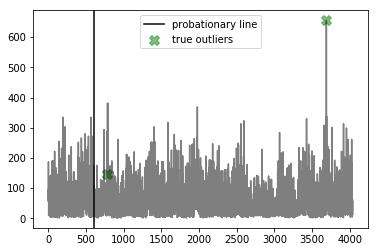




--- ambient_temperature_system_failure ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  []


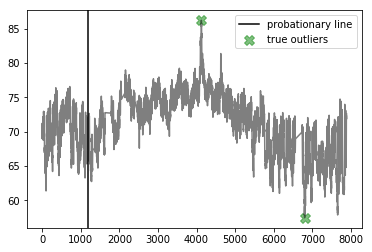




--- exchange-2_cpm_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  []


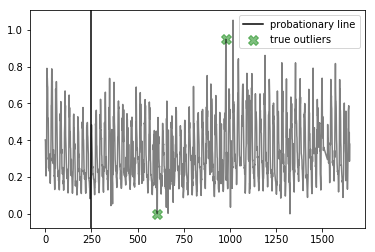




--- exchange-3_cpm_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  []


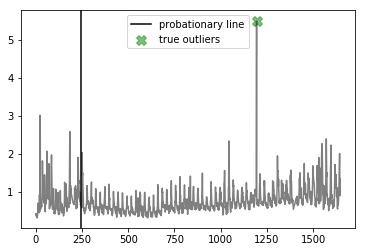




--- exchange-2_cpc_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  []


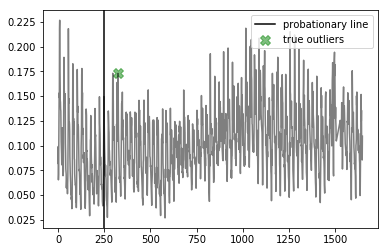




--- FARM_Bowling-Green-5-S_Warren ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  3


Outlier indices as determined by best window threshold:  []


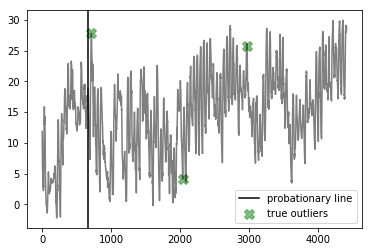

---------weight_fp=1.0, weight_fn=1----------


----Window-Based Results----
Minimum number of mistakes:  20.0
Best window threshold:  0.8455
Corresponding window overall precision:  0.75
Corresponding window overall recall:  0.13636363636363635
Corresponding window overall F score:  0.23076923076923075



--- all_data_gift_certificates ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  3


Outlier indices as determined by best window threshold:  []


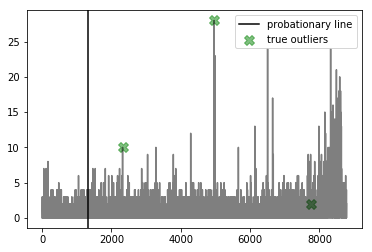




--- exchange-3_cpc_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  3


Outlier indices as determined by best window threshold:  []


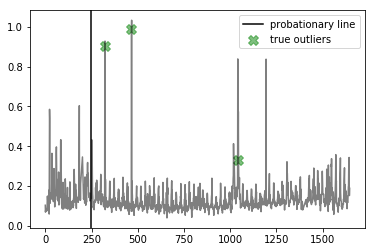




--- nyc_taxi ---
Corresponding window precision:  0.75
Corresponding window recall:  0.6
Corresponding window false positives:  1
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  [5955, 7608, 8523, 8835]


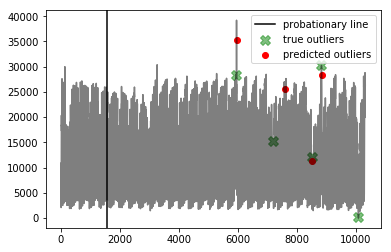




--- elb_request_count_8c0756 ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  []


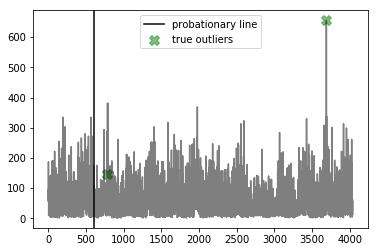




--- ambient_temperature_system_failure ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  []


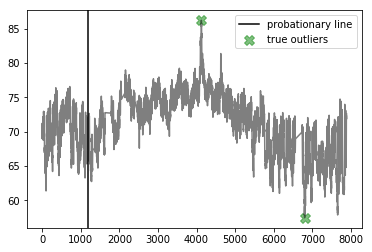




--- exchange-2_cpm_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  []


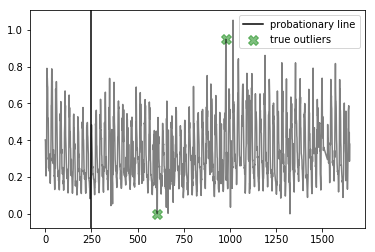




--- exchange-3_cpm_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  []


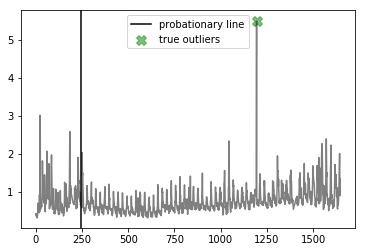




--- exchange-2_cpc_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  []


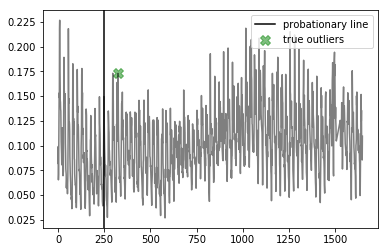




--- FARM_Bowling-Green-5-S_Warren ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  3


Outlier indices as determined by best window threshold:  []


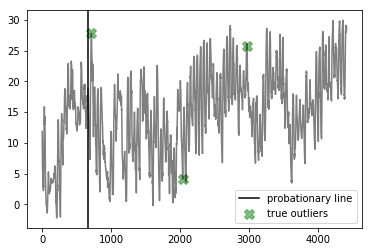

------------
False Positive Weight:  0.1
	 Minimum number of mistakes : 8.4
	 Best window threshold : 0.4663
	 Corresponding window overall precision : 0.3902439024390244
	 Corresponding window overall recall : 0.7272727272727273
	 Corresponding window overall F score : 0.5079365079365079
False Positive Weight:  0.2
	 Minimum number of mistakes : 10.8
	 Best window threshold : 0.4663
	 Corresponding window overall precision : 0.3902439024390244
	 Corresponding window overall recall : 0.7272727272727273
	 Corresponding window overall F score : 0.5079365079365079
False Positive Weight:  0.3
	 Minimum number of mistakes : 13.2
	 Best window threshold : 0.4663
	 Corresponding window overall precision : 0.3902439024390244
	 Corresponding window overall recall : 0.7272727272727273
	 Corresponding window overall F score : 0.5079365079365079
False Positive Weight:  0.6
	 Minimum number of mistakes : 19.6
	 Best window threshold : 0.8455
	 Corresponding window overall precision : 0.75
	 Corresp

In [29]:
end_results = {}
for weight_fp in weight_fp_list:  
    print("---------weight_fp=" + str(weight_fp) + ", weight_fn=1----------")
    weight_result = adclasses.pretty_print_results(htm_ad_dict, anomaly_scores_dict, htm_true_outlier_indices_dict, weight_fp=weight_fp, weight_fn=1)
    end_results[weight_fp] = weight_result

print("------------")
adclasses.pretty_print_end_results(end_results)

# Donut Results

everything except for international-airline-passengers

In [30]:
donut_dataset_name_list = ["nyc_taxi",
                           "exchange-2_cpm_results",
                           "exchange-3_cpm_results",
                           "all_data_gift_certificates",
                           "elb_request_count_8c0756",
                           "FARM_Bowling-Green-5-S_Warren",
                           "exchange-2_cpc_results",
                           "exchange-3_cpc_results",
                           "ambient_temperature_system_failure"]

donut_ad_dict = {}
for dataset_name in donut_dataset_name_list:
    donut_ad_dict[dataset_name] = ad_dict[dataset_name]
    
donut_true_outlier_indices_dict = {}
for dataset_name in donut_dataset_name_list:
    donut_true_outlier_indices_dict[dataset_name] = true_outlier_indices_dict[dataset_name]

In [31]:
anomaly_scores_dict = {}

for dataset_name in donut_dataset_name_list:
    output_dict_htm = joblib.load("anomaly_scores/Donut/" + dataset_name)
    anomaly_scores_dict[dataset_name] = output_dict_htm["Anomaly Scores"]

In [32]:
adclasses.precision_recall_curve_info(anomaly_scores_dict, donut_true_outlier_indices_dict)

{0.1: {'precision': 0.11538461538461539, 'recall': 1.0},
 0.2: {'precision': 0.11538461538461539, 'recall': 1.0},
 0.3: {'precision': 0.11538461538461539, 'recall': 1.0},
 0.4: {'precision': 0.11538461538461539, 'recall': 1.0},
 0.5: {'precision': 0.11538461538461539, 'recall': 1.0},
 0.6: {'precision': 0.11538461538461539, 'recall': 1.0},
 0.7: {'precision': 0.11538461538461539, 'recall': 1.0},
 0.8: {'precision': 0.11538461538461539, 'recall': 1.0},
 0.9: {'precision': 0.125, 'recall': 1.0},
 1.0: {'precision': 0.5, 'recall': 0.3333333333333333}}

---------weight_fp=0.1, weight_fn=1----------


----Window-Based Results----
Minimum number of mistakes:  10.0
Best window threshold:  1.0
Corresponding window overall precision:  0.2711864406779661
Corresponding window overall recall:  0.7272727272727273
Corresponding window overall F score:  0.39506172839506176



--- all_data_gift_certificates ---
Corresponding window precision:  0.16666666666666666
Corresponding window recall:  1.0
Corresponding window false positives:  15
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [1615, 2233, 2320, 2791, 2871, 2886, 3014, 3053, 3389, 3664, 3676, 3680, 3729, 4206, 4286, 4902, 4961, 4963, 4978, 4986, 4992, 4998, 5000, 5001, 5024, 5046, 5047, 5072, 5095, 5382, 5623, 5662, 6014, 6137, 6505, 6650, 7254, 7720, 7760, 7783, 7786, 7809, 8022, 8029, 8072, 8073, 8094, 8096, 8097, 8098, 8242, 8265, 8288, 8289, 8336, 8337, 8338, 8360, 8407, 8408, 8409, 8410, 8430, 8431, 8432, 8433, 8434, 8435, 8455, 850

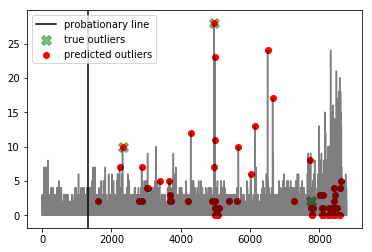




--- exchange-3_cpc_results ---
Corresponding window precision:  0.6
Corresponding window recall:  1.0
Corresponding window false positives:  2
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [322, 323, 466, 467, 1018, 1041, 1043, 1044, 1194, 1548, 1571]


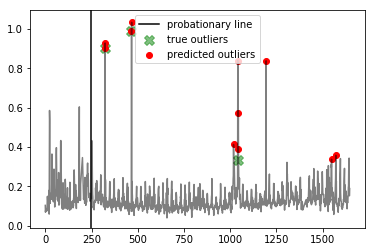




--- nyc_taxi ---
Corresponding window precision:  0.42857142857142855
Corresponding window recall:  0.6
Corresponding window false positives:  4
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  [3582, 5929, 7607, 7608, 7609, 7610, 7612, 7613, 7614, 8520, 8522, 9289, 9290, 10063, 10064, 10065, 10066, 10067, 10068, 10069, 10070, 10100, 10101, 10102, 10103, 10104, 10105, 10106, 10107, 10108, 10109, 10110, 10111, 10112]


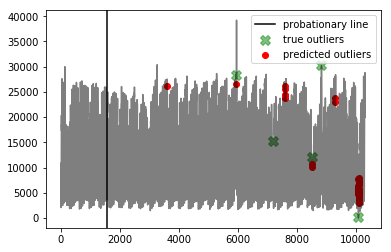




--- elb_request_count_8c0756 ---
Corresponding window precision:  0.2
Corresponding window recall:  1.0
Corresponding window false positives:  8
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [786, 791, 1359, 1374, 1403, 1586, 1978, 2497, 2517, 2551, 2556, 2595, 3069, 3427, 3455, 3658, 3690, 3693, 3957]


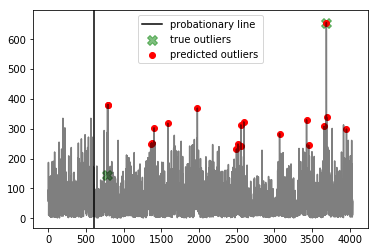




--- ambient_temperature_system_failure ---
Corresponding window precision:  0.3333333333333333
Corresponding window recall:  1.0
Corresponding window false positives:  4
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [2010, 2038, 4101, 4102, 4103, 4105, 4122, 4123, 4124, 4125, 4127, 4628, 4629, 5477, 5480, 5908, 5909, 5910, 5911, 5912, 5913, 6791, 6792, 6795, 6796, 6797, 6798, 6799, 6800, 6801, 6802, 6803, 6804]


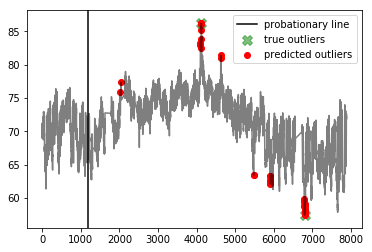




--- exchange-2_cpm_results ---
Corresponding window precision:  0.5
Corresponding window recall:  0.5
Corresponding window false positives:  1
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [977, 1016, 1044, 1045]


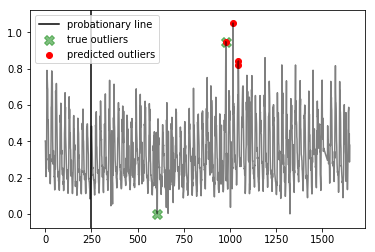




--- exchange-3_cpm_results ---
Corresponding window precision:  0.3333333333333333
Corresponding window recall:  1.0
Corresponding window false positives:  2
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [1021, 1044, 1045, 1193, 1194, 1531, 1546, 1547, 1548, 1549, 1571]


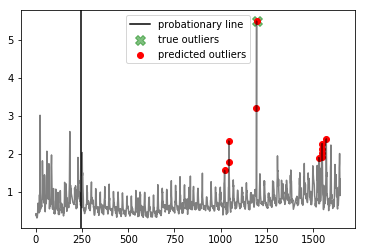




--- exchange-2_cpc_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  3
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [824, 896, 920, 1016]


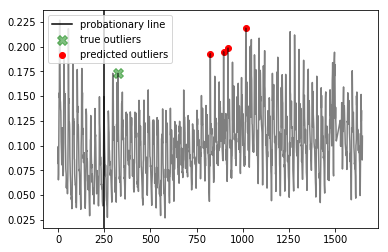




--- FARM_Bowling-Green-5-S_Warren ---
Corresponding window precision:  0.5
Corresponding window recall:  0.3333333333333333
Corresponding window false positives:  1
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  [711, 712, 713, 714, 3251, 3252, 3253, 3254, 3255]


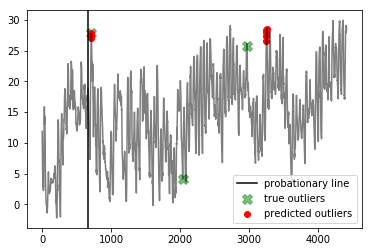

---------weight_fp=0.2, weight_fn=1----------


----Window-Based Results----
Minimum number of mistakes:  14.0
Best window threshold:  1.0
Corresponding window overall precision:  0.2711864406779661
Corresponding window overall recall:  0.7272727272727273
Corresponding window overall F score:  0.39506172839506176



--- all_data_gift_certificates ---
Corresponding window precision:  0.16666666666666666
Corresponding window recall:  1.0
Corresponding window false positives:  15
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [1615, 2233, 2320, 2791, 2871, 2886, 3014, 3053, 3389, 3664, 3676, 3680, 3729, 4206, 4286, 4902, 4961, 4963, 4978, 4986, 4992, 4998, 5000, 5001, 5024, 5046, 5047, 5072, 5095, 5382, 5623, 5662, 6014, 6137, 6505, 6650, 7254, 7720, 7760, 7783, 7786, 7809, 8022, 8029, 8072, 8073, 8094, 8096, 8097, 8098, 8242, 8265, 8288, 8289, 8336, 8337, 8338, 8360, 8407, 8408, 8409, 8410, 8430, 8431, 8432, 8433, 8434, 8435, 8455, 850

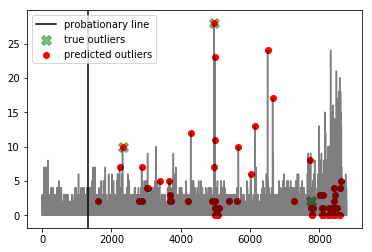




--- exchange-3_cpc_results ---
Corresponding window precision:  0.6
Corresponding window recall:  1.0
Corresponding window false positives:  2
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [322, 323, 466, 467, 1018, 1041, 1043, 1044, 1194, 1548, 1571]


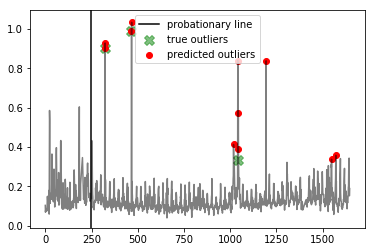




--- nyc_taxi ---
Corresponding window precision:  0.42857142857142855
Corresponding window recall:  0.6
Corresponding window false positives:  4
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  [3582, 5929, 7607, 7608, 7609, 7610, 7612, 7613, 7614, 8520, 8522, 9289, 9290, 10063, 10064, 10065, 10066, 10067, 10068, 10069, 10070, 10100, 10101, 10102, 10103, 10104, 10105, 10106, 10107, 10108, 10109, 10110, 10111, 10112]


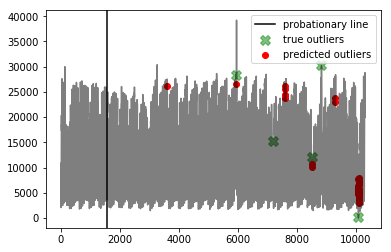




--- elb_request_count_8c0756 ---
Corresponding window precision:  0.2
Corresponding window recall:  1.0
Corresponding window false positives:  8
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [786, 791, 1359, 1374, 1403, 1586, 1978, 2497, 2517, 2551, 2556, 2595, 3069, 3427, 3455, 3658, 3690, 3693, 3957]


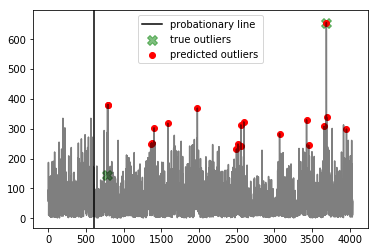




--- ambient_temperature_system_failure ---
Corresponding window precision:  0.3333333333333333
Corresponding window recall:  1.0
Corresponding window false positives:  4
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [2010, 2038, 4101, 4102, 4103, 4105, 4122, 4123, 4124, 4125, 4127, 4628, 4629, 5477, 5480, 5908, 5909, 5910, 5911, 5912, 5913, 6791, 6792, 6795, 6796, 6797, 6798, 6799, 6800, 6801, 6802, 6803, 6804]


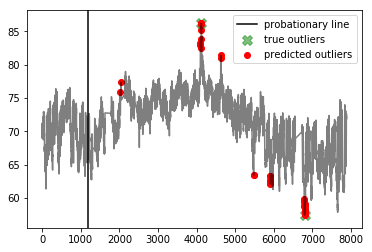




--- exchange-2_cpm_results ---
Corresponding window precision:  0.5
Corresponding window recall:  0.5
Corresponding window false positives:  1
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [977, 1016, 1044, 1045]


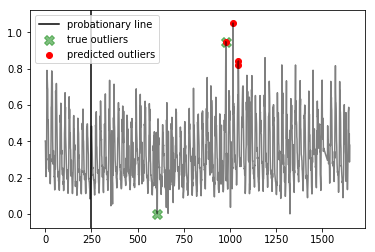




--- exchange-3_cpm_results ---
Corresponding window precision:  0.3333333333333333
Corresponding window recall:  1.0
Corresponding window false positives:  2
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [1021, 1044, 1045, 1193, 1194, 1531, 1546, 1547, 1548, 1549, 1571]


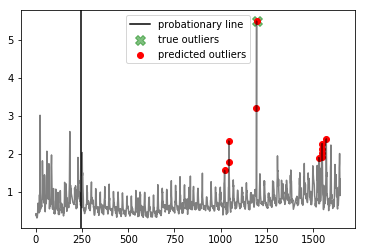




--- exchange-2_cpc_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  3
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [824, 896, 920, 1016]


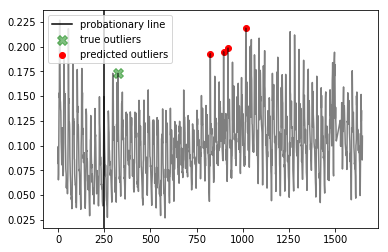




--- FARM_Bowling-Green-5-S_Warren ---
Corresponding window precision:  0.5
Corresponding window recall:  0.3333333333333333
Corresponding window false positives:  1
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  [711, 712, 713, 714, 3251, 3252, 3253, 3254, 3255]


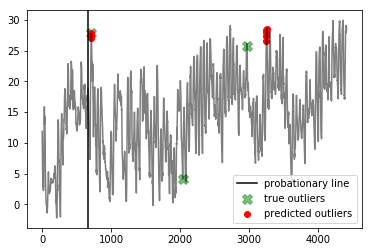

---------weight_fp=0.3, weight_fn=1----------


----Window-Based Results----
Minimum number of mistakes:  18.0
Best window threshold:  1.0
Corresponding window overall precision:  0.2711864406779661
Corresponding window overall recall:  0.7272727272727273
Corresponding window overall F score:  0.39506172839506176



--- all_data_gift_certificates ---
Corresponding window precision:  0.16666666666666666
Corresponding window recall:  1.0
Corresponding window false positives:  15
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [1615, 2233, 2320, 2791, 2871, 2886, 3014, 3053, 3389, 3664, 3676, 3680, 3729, 4206, 4286, 4902, 4961, 4963, 4978, 4986, 4992, 4998, 5000, 5001, 5024, 5046, 5047, 5072, 5095, 5382, 5623, 5662, 6014, 6137, 6505, 6650, 7254, 7720, 7760, 7783, 7786, 7809, 8022, 8029, 8072, 8073, 8094, 8096, 8097, 8098, 8242, 8265, 8288, 8289, 8336, 8337, 8338, 8360, 8407, 8408, 8409, 8410, 8430, 8431, 8432, 8433, 8434, 8435, 8455, 850

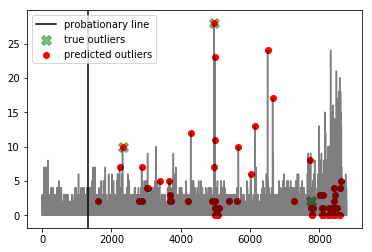




--- exchange-3_cpc_results ---
Corresponding window precision:  0.6
Corresponding window recall:  1.0
Corresponding window false positives:  2
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [322, 323, 466, 467, 1018, 1041, 1043, 1044, 1194, 1548, 1571]


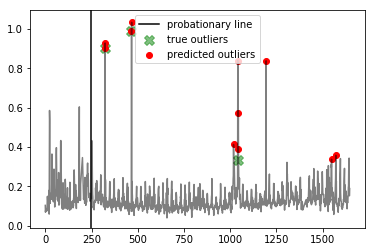




--- nyc_taxi ---
Corresponding window precision:  0.42857142857142855
Corresponding window recall:  0.6
Corresponding window false positives:  4
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  [3582, 5929, 7607, 7608, 7609, 7610, 7612, 7613, 7614, 8520, 8522, 9289, 9290, 10063, 10064, 10065, 10066, 10067, 10068, 10069, 10070, 10100, 10101, 10102, 10103, 10104, 10105, 10106, 10107, 10108, 10109, 10110, 10111, 10112]


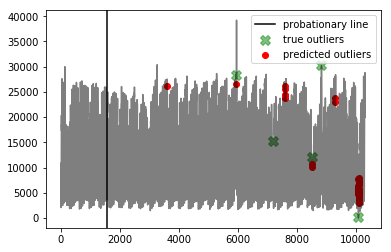




--- elb_request_count_8c0756 ---
Corresponding window precision:  0.2
Corresponding window recall:  1.0
Corresponding window false positives:  8
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [786, 791, 1359, 1374, 1403, 1586, 1978, 2497, 2517, 2551, 2556, 2595, 3069, 3427, 3455, 3658, 3690, 3693, 3957]


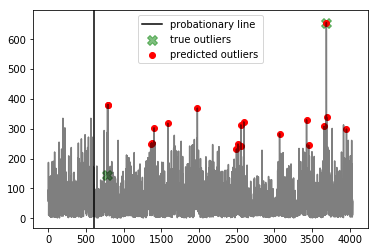




--- ambient_temperature_system_failure ---
Corresponding window precision:  0.3333333333333333
Corresponding window recall:  1.0
Corresponding window false positives:  4
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [2010, 2038, 4101, 4102, 4103, 4105, 4122, 4123, 4124, 4125, 4127, 4628, 4629, 5477, 5480, 5908, 5909, 5910, 5911, 5912, 5913, 6791, 6792, 6795, 6796, 6797, 6798, 6799, 6800, 6801, 6802, 6803, 6804]


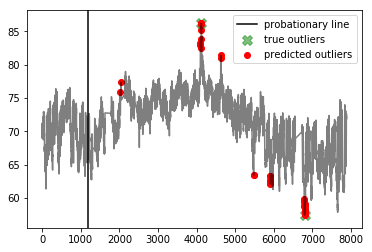




--- exchange-2_cpm_results ---
Corresponding window precision:  0.5
Corresponding window recall:  0.5
Corresponding window false positives:  1
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [977, 1016, 1044, 1045]


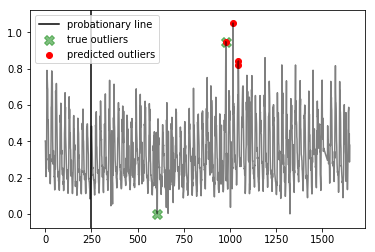




--- exchange-3_cpm_results ---
Corresponding window precision:  0.3333333333333333
Corresponding window recall:  1.0
Corresponding window false positives:  2
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [1021, 1044, 1045, 1193, 1194, 1531, 1546, 1547, 1548, 1549, 1571]


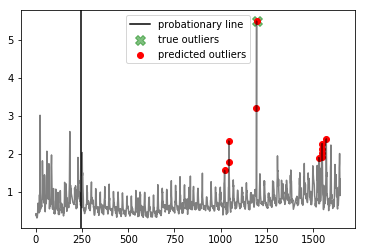




--- exchange-2_cpc_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  3
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [824, 896, 920, 1016]


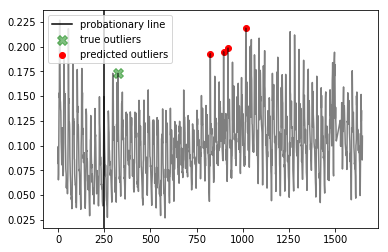




--- FARM_Bowling-Green-5-S_Warren ---
Corresponding window precision:  0.5
Corresponding window recall:  0.3333333333333333
Corresponding window false positives:  1
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  [711, 712, 713, 714, 3251, 3252, 3253, 3254, 3255]


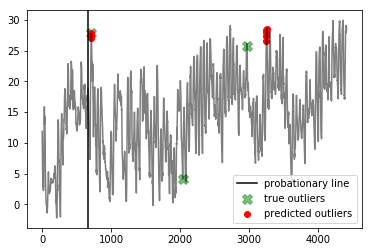

---------weight_fp=0.4, weight_fn=1----------


----Window-Based Results----
Minimum number of mistakes:  22.0
Best window threshold:  1.0
Corresponding window overall precision:  0.2711864406779661
Corresponding window overall recall:  0.7272727272727273
Corresponding window overall F score:  0.39506172839506176



--- all_data_gift_certificates ---
Corresponding window precision:  0.16666666666666666
Corresponding window recall:  1.0
Corresponding window false positives:  15
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [1615, 2233, 2320, 2791, 2871, 2886, 3014, 3053, 3389, 3664, 3676, 3680, 3729, 4206, 4286, 4902, 4961, 4963, 4978, 4986, 4992, 4998, 5000, 5001, 5024, 5046, 5047, 5072, 5095, 5382, 5623, 5662, 6014, 6137, 6505, 6650, 7254, 7720, 7760, 7783, 7786, 7809, 8022, 8029, 8072, 8073, 8094, 8096, 8097, 8098, 8242, 8265, 8288, 8289, 8336, 8337, 8338, 8360, 8407, 8408, 8409, 8410, 8430, 8431, 8432, 8433, 8434, 8435, 8455, 850

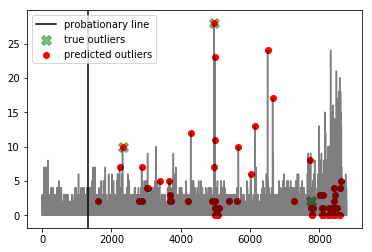




--- exchange-3_cpc_results ---
Corresponding window precision:  0.6
Corresponding window recall:  1.0
Corresponding window false positives:  2
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [322, 323, 466, 467, 1018, 1041, 1043, 1044, 1194, 1548, 1571]


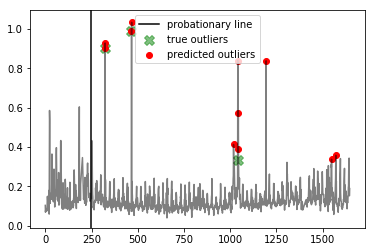




--- nyc_taxi ---
Corresponding window precision:  0.42857142857142855
Corresponding window recall:  0.6
Corresponding window false positives:  4
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  [3582, 5929, 7607, 7608, 7609, 7610, 7612, 7613, 7614, 8520, 8522, 9289, 9290, 10063, 10064, 10065, 10066, 10067, 10068, 10069, 10070, 10100, 10101, 10102, 10103, 10104, 10105, 10106, 10107, 10108, 10109, 10110, 10111, 10112]


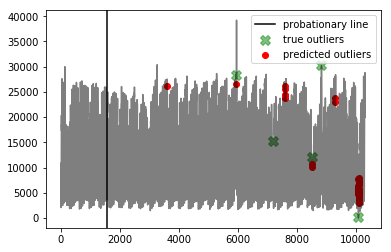




--- elb_request_count_8c0756 ---
Corresponding window precision:  0.2
Corresponding window recall:  1.0
Corresponding window false positives:  8
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [786, 791, 1359, 1374, 1403, 1586, 1978, 2497, 2517, 2551, 2556, 2595, 3069, 3427, 3455, 3658, 3690, 3693, 3957]


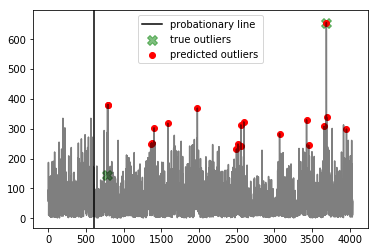




--- ambient_temperature_system_failure ---
Corresponding window precision:  0.3333333333333333
Corresponding window recall:  1.0
Corresponding window false positives:  4
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [2010, 2038, 4101, 4102, 4103, 4105, 4122, 4123, 4124, 4125, 4127, 4628, 4629, 5477, 5480, 5908, 5909, 5910, 5911, 5912, 5913, 6791, 6792, 6795, 6796, 6797, 6798, 6799, 6800, 6801, 6802, 6803, 6804]


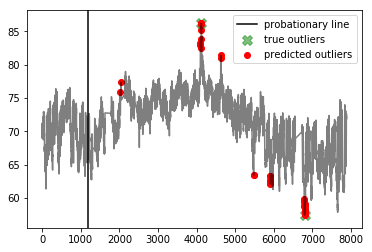




--- exchange-2_cpm_results ---
Corresponding window precision:  0.5
Corresponding window recall:  0.5
Corresponding window false positives:  1
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [977, 1016, 1044, 1045]


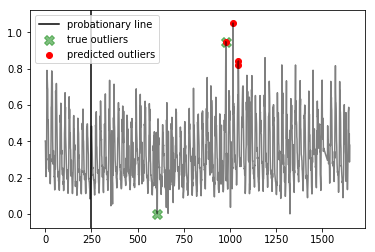




--- exchange-3_cpm_results ---
Corresponding window precision:  0.3333333333333333
Corresponding window recall:  1.0
Corresponding window false positives:  2
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [1021, 1044, 1045, 1193, 1194, 1531, 1546, 1547, 1548, 1549, 1571]


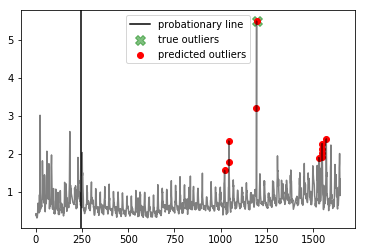




--- exchange-2_cpc_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  3
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [824, 896, 920, 1016]


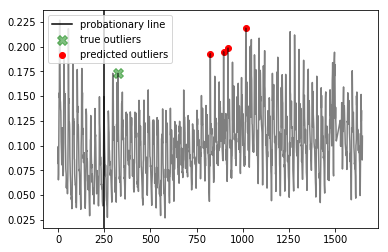




--- FARM_Bowling-Green-5-S_Warren ---
Corresponding window precision:  0.5
Corresponding window recall:  0.3333333333333333
Corresponding window false positives:  1
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  [711, 712, 713, 714, 3251, 3252, 3253, 3254, 3255]


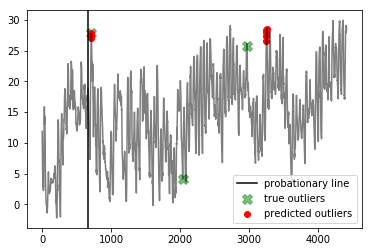

---------weight_fp=0.5, weight_fn=1----------


----Window-Based Results----
Minimum number of mistakes:  26.0
Best window threshold:  1.0
Corresponding window overall precision:  0.2711864406779661
Corresponding window overall recall:  0.7272727272727273
Corresponding window overall F score:  0.39506172839506176



--- all_data_gift_certificates ---
Corresponding window precision:  0.16666666666666666
Corresponding window recall:  1.0
Corresponding window false positives:  15
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [1615, 2233, 2320, 2791, 2871, 2886, 3014, 3053, 3389, 3664, 3676, 3680, 3729, 4206, 4286, 4902, 4961, 4963, 4978, 4986, 4992, 4998, 5000, 5001, 5024, 5046, 5047, 5072, 5095, 5382, 5623, 5662, 6014, 6137, 6505, 6650, 7254, 7720, 7760, 7783, 7786, 7809, 8022, 8029, 8072, 8073, 8094, 8096, 8097, 8098, 8242, 8265, 8288, 8289, 8336, 8337, 8338, 8360, 8407, 8408, 8409, 8410, 8430, 8431, 8432, 8433, 8434, 8435, 8455, 850

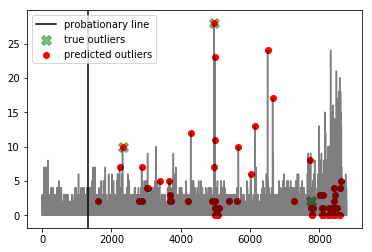




--- exchange-3_cpc_results ---
Corresponding window precision:  0.6
Corresponding window recall:  1.0
Corresponding window false positives:  2
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [322, 323, 466, 467, 1018, 1041, 1043, 1044, 1194, 1548, 1571]


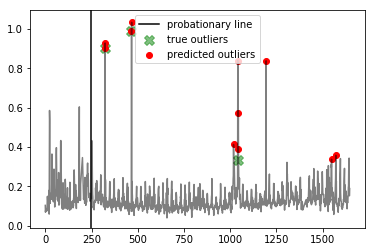




--- nyc_taxi ---
Corresponding window precision:  0.42857142857142855
Corresponding window recall:  0.6
Corresponding window false positives:  4
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  [3582, 5929, 7607, 7608, 7609, 7610, 7612, 7613, 7614, 8520, 8522, 9289, 9290, 10063, 10064, 10065, 10066, 10067, 10068, 10069, 10070, 10100, 10101, 10102, 10103, 10104, 10105, 10106, 10107, 10108, 10109, 10110, 10111, 10112]


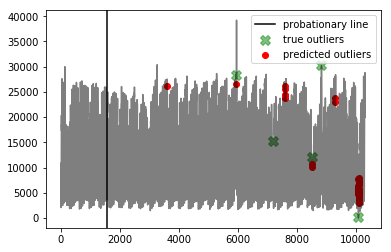




--- elb_request_count_8c0756 ---
Corresponding window precision:  0.2
Corresponding window recall:  1.0
Corresponding window false positives:  8
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [786, 791, 1359, 1374, 1403, 1586, 1978, 2497, 2517, 2551, 2556, 2595, 3069, 3427, 3455, 3658, 3690, 3693, 3957]


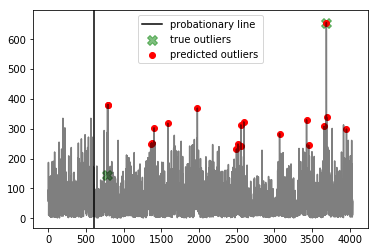




--- ambient_temperature_system_failure ---
Corresponding window precision:  0.3333333333333333
Corresponding window recall:  1.0
Corresponding window false positives:  4
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [2010, 2038, 4101, 4102, 4103, 4105, 4122, 4123, 4124, 4125, 4127, 4628, 4629, 5477, 5480, 5908, 5909, 5910, 5911, 5912, 5913, 6791, 6792, 6795, 6796, 6797, 6798, 6799, 6800, 6801, 6802, 6803, 6804]


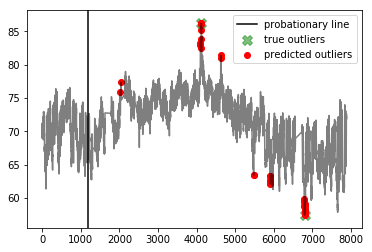




--- exchange-2_cpm_results ---
Corresponding window precision:  0.5
Corresponding window recall:  0.5
Corresponding window false positives:  1
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [977, 1016, 1044, 1045]


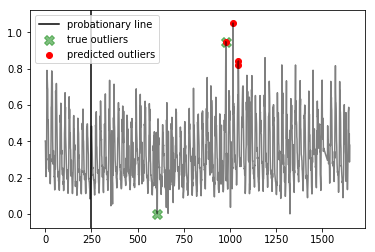




--- exchange-3_cpm_results ---
Corresponding window precision:  0.3333333333333333
Corresponding window recall:  1.0
Corresponding window false positives:  2
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [1021, 1044, 1045, 1193, 1194, 1531, 1546, 1547, 1548, 1549, 1571]


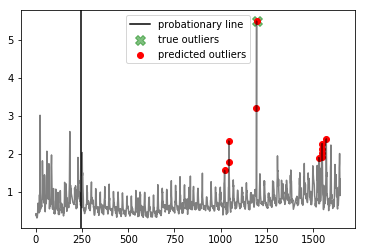




--- exchange-2_cpc_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  3
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [824, 896, 920, 1016]


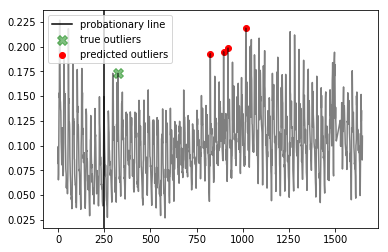




--- FARM_Bowling-Green-5-S_Warren ---
Corresponding window precision:  0.5
Corresponding window recall:  0.3333333333333333
Corresponding window false positives:  1
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  [711, 712, 713, 714, 3251, 3252, 3253, 3254, 3255]


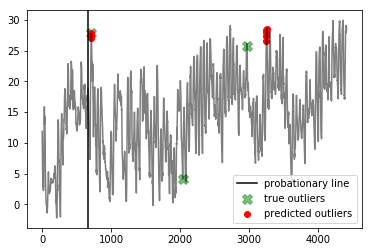

---------weight_fp=0.6, weight_fn=1----------


----Window-Based Results----
Minimum number of mistakes:  30.0
Best window threshold:  1.0
Corresponding window overall precision:  0.2711864406779661
Corresponding window overall recall:  0.7272727272727273
Corresponding window overall F score:  0.39506172839506176



--- all_data_gift_certificates ---
Corresponding window precision:  0.16666666666666666
Corresponding window recall:  1.0
Corresponding window false positives:  15
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [1615, 2233, 2320, 2791, 2871, 2886, 3014, 3053, 3389, 3664, 3676, 3680, 3729, 4206, 4286, 4902, 4961, 4963, 4978, 4986, 4992, 4998, 5000, 5001, 5024, 5046, 5047, 5072, 5095, 5382, 5623, 5662, 6014, 6137, 6505, 6650, 7254, 7720, 7760, 7783, 7786, 7809, 8022, 8029, 8072, 8073, 8094, 8096, 8097, 8098, 8242, 8265, 8288, 8289, 8336, 8337, 8338, 8360, 8407, 8408, 8409, 8410, 8430, 8431, 8432, 8433, 8434, 8435, 8455, 850

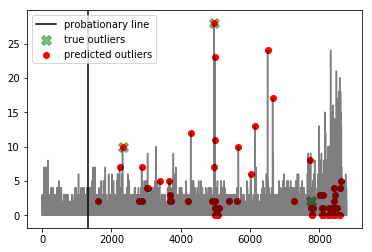




--- exchange-3_cpc_results ---
Corresponding window precision:  0.6
Corresponding window recall:  1.0
Corresponding window false positives:  2
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [322, 323, 466, 467, 1018, 1041, 1043, 1044, 1194, 1548, 1571]


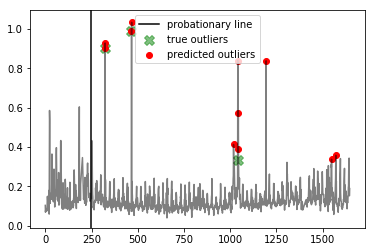




--- nyc_taxi ---
Corresponding window precision:  0.42857142857142855
Corresponding window recall:  0.6
Corresponding window false positives:  4
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  [3582, 5929, 7607, 7608, 7609, 7610, 7612, 7613, 7614, 8520, 8522, 9289, 9290, 10063, 10064, 10065, 10066, 10067, 10068, 10069, 10070, 10100, 10101, 10102, 10103, 10104, 10105, 10106, 10107, 10108, 10109, 10110, 10111, 10112]


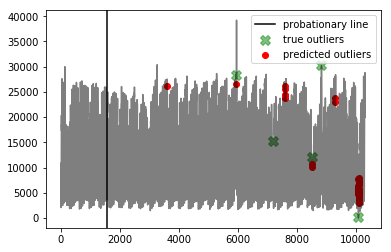




--- elb_request_count_8c0756 ---
Corresponding window precision:  0.2
Corresponding window recall:  1.0
Corresponding window false positives:  8
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [786, 791, 1359, 1374, 1403, 1586, 1978, 2497, 2517, 2551, 2556, 2595, 3069, 3427, 3455, 3658, 3690, 3693, 3957]


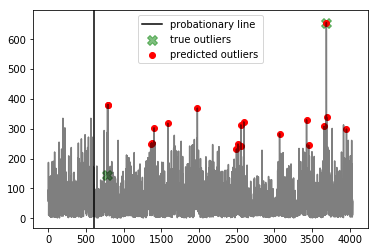




--- ambient_temperature_system_failure ---
Corresponding window precision:  0.3333333333333333
Corresponding window recall:  1.0
Corresponding window false positives:  4
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [2010, 2038, 4101, 4102, 4103, 4105, 4122, 4123, 4124, 4125, 4127, 4628, 4629, 5477, 5480, 5908, 5909, 5910, 5911, 5912, 5913, 6791, 6792, 6795, 6796, 6797, 6798, 6799, 6800, 6801, 6802, 6803, 6804]


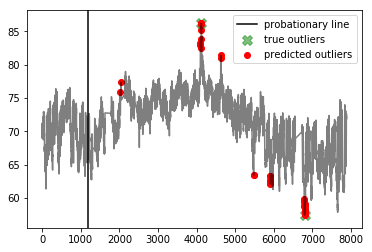




--- exchange-2_cpm_results ---
Corresponding window precision:  0.5
Corresponding window recall:  0.5
Corresponding window false positives:  1
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [977, 1016, 1044, 1045]


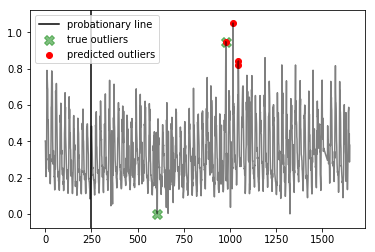




--- exchange-3_cpm_results ---
Corresponding window precision:  0.3333333333333333
Corresponding window recall:  1.0
Corresponding window false positives:  2
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [1021, 1044, 1045, 1193, 1194, 1531, 1546, 1547, 1548, 1549, 1571]


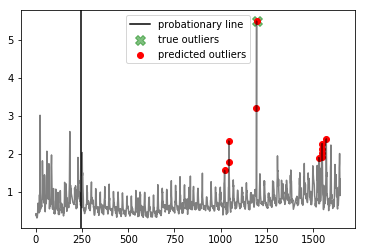




--- exchange-2_cpc_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  3
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [824, 896, 920, 1016]


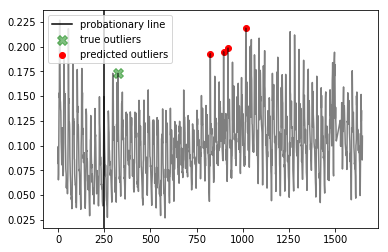




--- FARM_Bowling-Green-5-S_Warren ---
Corresponding window precision:  0.5
Corresponding window recall:  0.3333333333333333
Corresponding window false positives:  1
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  [711, 712, 713, 714, 3251, 3252, 3253, 3254, 3255]


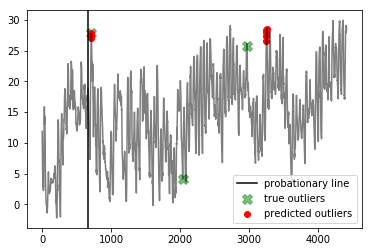

---------weight_fp=0.7, weight_fn=1----------


----Window-Based Results----
Minimum number of mistakes:  34.0
Best window threshold:  1.0
Corresponding window overall precision:  0.2711864406779661
Corresponding window overall recall:  0.7272727272727273
Corresponding window overall F score:  0.39506172839506176



--- all_data_gift_certificates ---
Corresponding window precision:  0.16666666666666666
Corresponding window recall:  1.0
Corresponding window false positives:  15
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [1615, 2233, 2320, 2791, 2871, 2886, 3014, 3053, 3389, 3664, 3676, 3680, 3729, 4206, 4286, 4902, 4961, 4963, 4978, 4986, 4992, 4998, 5000, 5001, 5024, 5046, 5047, 5072, 5095, 5382, 5623, 5662, 6014, 6137, 6505, 6650, 7254, 7720, 7760, 7783, 7786, 7809, 8022, 8029, 8072, 8073, 8094, 8096, 8097, 8098, 8242, 8265, 8288, 8289, 8336, 8337, 8338, 8360, 8407, 8408, 8409, 8410, 8430, 8431, 8432, 8433, 8434, 8435, 8455, 850

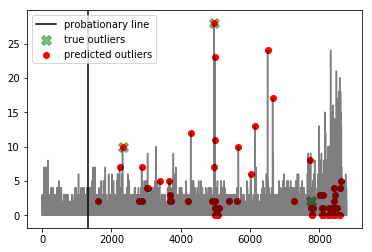




--- exchange-3_cpc_results ---
Corresponding window precision:  0.6
Corresponding window recall:  1.0
Corresponding window false positives:  2
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [322, 323, 466, 467, 1018, 1041, 1043, 1044, 1194, 1548, 1571]


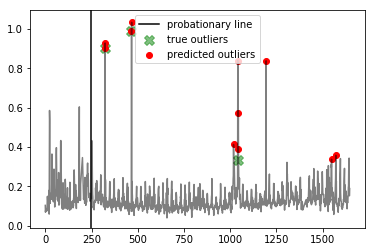




--- nyc_taxi ---
Corresponding window precision:  0.42857142857142855
Corresponding window recall:  0.6
Corresponding window false positives:  4
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  [3582, 5929, 7607, 7608, 7609, 7610, 7612, 7613, 7614, 8520, 8522, 9289, 9290, 10063, 10064, 10065, 10066, 10067, 10068, 10069, 10070, 10100, 10101, 10102, 10103, 10104, 10105, 10106, 10107, 10108, 10109, 10110, 10111, 10112]


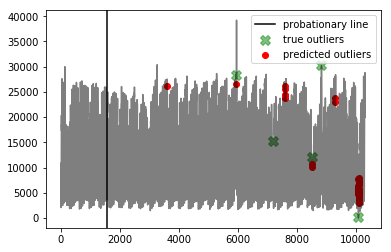




--- elb_request_count_8c0756 ---
Corresponding window precision:  0.2
Corresponding window recall:  1.0
Corresponding window false positives:  8
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [786, 791, 1359, 1374, 1403, 1586, 1978, 2497, 2517, 2551, 2556, 2595, 3069, 3427, 3455, 3658, 3690, 3693, 3957]


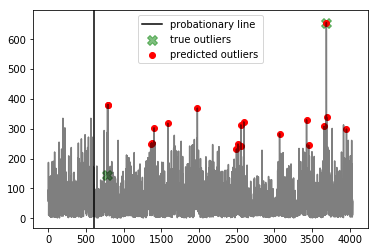




--- ambient_temperature_system_failure ---
Corresponding window precision:  0.3333333333333333
Corresponding window recall:  1.0
Corresponding window false positives:  4
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [2010, 2038, 4101, 4102, 4103, 4105, 4122, 4123, 4124, 4125, 4127, 4628, 4629, 5477, 5480, 5908, 5909, 5910, 5911, 5912, 5913, 6791, 6792, 6795, 6796, 6797, 6798, 6799, 6800, 6801, 6802, 6803, 6804]


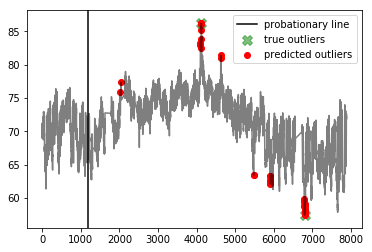




--- exchange-2_cpm_results ---
Corresponding window precision:  0.5
Corresponding window recall:  0.5
Corresponding window false positives:  1
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [977, 1016, 1044, 1045]


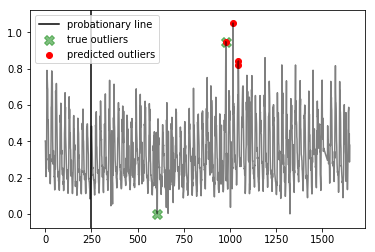




--- exchange-3_cpm_results ---
Corresponding window precision:  0.3333333333333333
Corresponding window recall:  1.0
Corresponding window false positives:  2
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [1021, 1044, 1045, 1193, 1194, 1531, 1546, 1547, 1548, 1549, 1571]


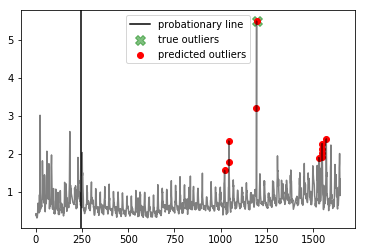




--- exchange-2_cpc_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  3
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [824, 896, 920, 1016]


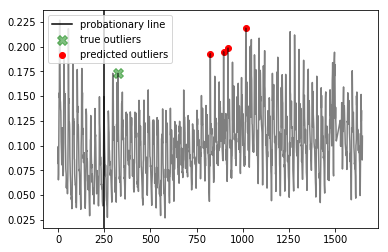




--- FARM_Bowling-Green-5-S_Warren ---
Corresponding window precision:  0.5
Corresponding window recall:  0.3333333333333333
Corresponding window false positives:  1
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  [711, 712, 713, 714, 3251, 3252, 3253, 3254, 3255]


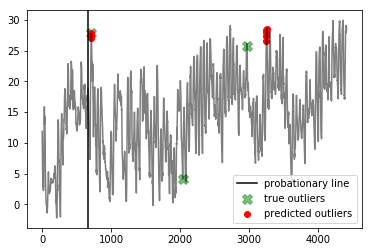

---------weight_fp=0.8, weight_fn=1----------


----Window-Based Results----
Minimum number of mistakes:  38.0
Best window threshold:  1.0
Corresponding window overall precision:  0.2711864406779661
Corresponding window overall recall:  0.7272727272727273
Corresponding window overall F score:  0.39506172839506176



--- all_data_gift_certificates ---
Corresponding window precision:  0.16666666666666666
Corresponding window recall:  1.0
Corresponding window false positives:  15
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [1615, 2233, 2320, 2791, 2871, 2886, 3014, 3053, 3389, 3664, 3676, 3680, 3729, 4206, 4286, 4902, 4961, 4963, 4978, 4986, 4992, 4998, 5000, 5001, 5024, 5046, 5047, 5072, 5095, 5382, 5623, 5662, 6014, 6137, 6505, 6650, 7254, 7720, 7760, 7783, 7786, 7809, 8022, 8029, 8072, 8073, 8094, 8096, 8097, 8098, 8242, 8265, 8288, 8289, 8336, 8337, 8338, 8360, 8407, 8408, 8409, 8410, 8430, 8431, 8432, 8433, 8434, 8435, 8455, 850

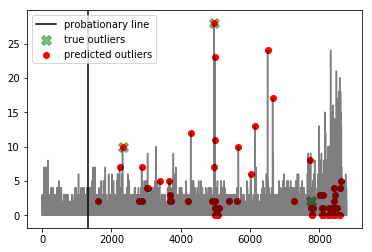




--- exchange-3_cpc_results ---
Corresponding window precision:  0.6
Corresponding window recall:  1.0
Corresponding window false positives:  2
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [322, 323, 466, 467, 1018, 1041, 1043, 1044, 1194, 1548, 1571]


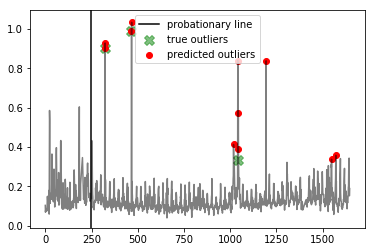




--- nyc_taxi ---
Corresponding window precision:  0.42857142857142855
Corresponding window recall:  0.6
Corresponding window false positives:  4
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  [3582, 5929, 7607, 7608, 7609, 7610, 7612, 7613, 7614, 8520, 8522, 9289, 9290, 10063, 10064, 10065, 10066, 10067, 10068, 10069, 10070, 10100, 10101, 10102, 10103, 10104, 10105, 10106, 10107, 10108, 10109, 10110, 10111, 10112]


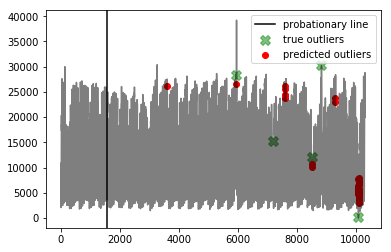




--- elb_request_count_8c0756 ---
Corresponding window precision:  0.2
Corresponding window recall:  1.0
Corresponding window false positives:  8
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [786, 791, 1359, 1374, 1403, 1586, 1978, 2497, 2517, 2551, 2556, 2595, 3069, 3427, 3455, 3658, 3690, 3693, 3957]


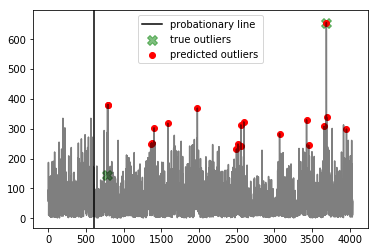




--- ambient_temperature_system_failure ---
Corresponding window precision:  0.3333333333333333
Corresponding window recall:  1.0
Corresponding window false positives:  4
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [2010, 2038, 4101, 4102, 4103, 4105, 4122, 4123, 4124, 4125, 4127, 4628, 4629, 5477, 5480, 5908, 5909, 5910, 5911, 5912, 5913, 6791, 6792, 6795, 6796, 6797, 6798, 6799, 6800, 6801, 6802, 6803, 6804]


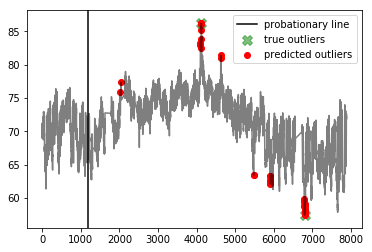




--- exchange-2_cpm_results ---
Corresponding window precision:  0.5
Corresponding window recall:  0.5
Corresponding window false positives:  1
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [977, 1016, 1044, 1045]


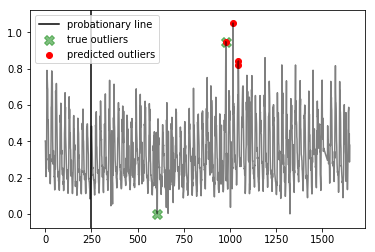




--- exchange-3_cpm_results ---
Corresponding window precision:  0.3333333333333333
Corresponding window recall:  1.0
Corresponding window false positives:  2
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [1021, 1044, 1045, 1193, 1194, 1531, 1546, 1547, 1548, 1549, 1571]


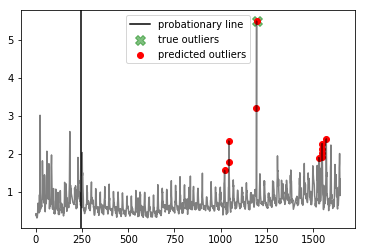




--- exchange-2_cpc_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  3
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [824, 896, 920, 1016]


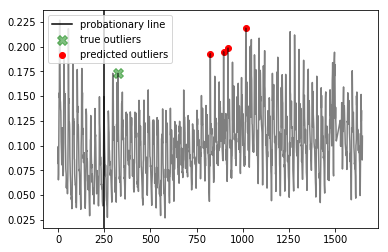




--- FARM_Bowling-Green-5-S_Warren ---
Corresponding window precision:  0.5
Corresponding window recall:  0.3333333333333333
Corresponding window false positives:  1
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  [711, 712, 713, 714, 3251, 3252, 3253, 3254, 3255]


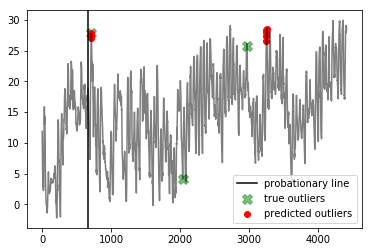

---------weight_fp=0.9, weight_fn=1----------


----Window-Based Results----
Minimum number of mistakes:  42.0
Best window threshold:  1.0
Corresponding window overall precision:  0.2711864406779661
Corresponding window overall recall:  0.7272727272727273
Corresponding window overall F score:  0.39506172839506176



--- all_data_gift_certificates ---
Corresponding window precision:  0.16666666666666666
Corresponding window recall:  1.0
Corresponding window false positives:  15
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [1615, 2233, 2320, 2791, 2871, 2886, 3014, 3053, 3389, 3664, 3676, 3680, 3729, 4206, 4286, 4902, 4961, 4963, 4978, 4986, 4992, 4998, 5000, 5001, 5024, 5046, 5047, 5072, 5095, 5382, 5623, 5662, 6014, 6137, 6505, 6650, 7254, 7720, 7760, 7783, 7786, 7809, 8022, 8029, 8072, 8073, 8094, 8096, 8097, 8098, 8242, 8265, 8288, 8289, 8336, 8337, 8338, 8360, 8407, 8408, 8409, 8410, 8430, 8431, 8432, 8433, 8434, 8435, 8455, 850

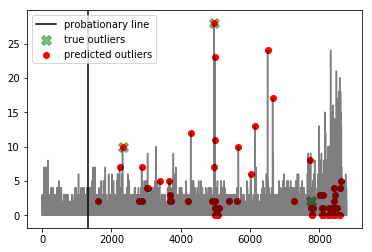




--- exchange-3_cpc_results ---
Corresponding window precision:  0.6
Corresponding window recall:  1.0
Corresponding window false positives:  2
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [322, 323, 466, 467, 1018, 1041, 1043, 1044, 1194, 1548, 1571]


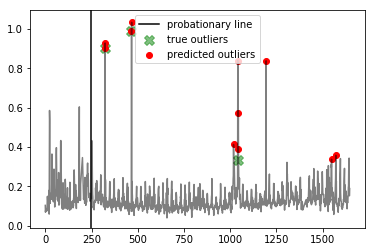




--- nyc_taxi ---
Corresponding window precision:  0.42857142857142855
Corresponding window recall:  0.6
Corresponding window false positives:  4
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  [3582, 5929, 7607, 7608, 7609, 7610, 7612, 7613, 7614, 8520, 8522, 9289, 9290, 10063, 10064, 10065, 10066, 10067, 10068, 10069, 10070, 10100, 10101, 10102, 10103, 10104, 10105, 10106, 10107, 10108, 10109, 10110, 10111, 10112]


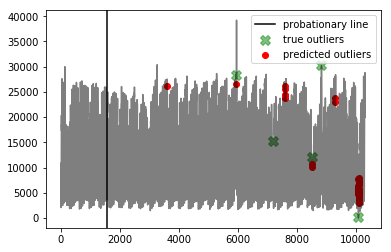




--- elb_request_count_8c0756 ---
Corresponding window precision:  0.2
Corresponding window recall:  1.0
Corresponding window false positives:  8
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [786, 791, 1359, 1374, 1403, 1586, 1978, 2497, 2517, 2551, 2556, 2595, 3069, 3427, 3455, 3658, 3690, 3693, 3957]


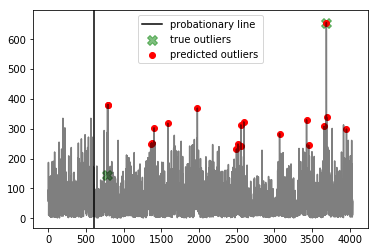




--- ambient_temperature_system_failure ---
Corresponding window precision:  0.3333333333333333
Corresponding window recall:  1.0
Corresponding window false positives:  4
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [2010, 2038, 4101, 4102, 4103, 4105, 4122, 4123, 4124, 4125, 4127, 4628, 4629, 5477, 5480, 5908, 5909, 5910, 5911, 5912, 5913, 6791, 6792, 6795, 6796, 6797, 6798, 6799, 6800, 6801, 6802, 6803, 6804]


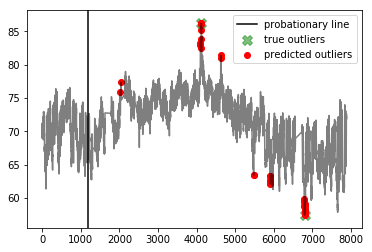




--- exchange-2_cpm_results ---
Corresponding window precision:  0.5
Corresponding window recall:  0.5
Corresponding window false positives:  1
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [977, 1016, 1044, 1045]


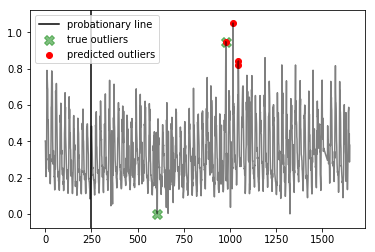




--- exchange-3_cpm_results ---
Corresponding window precision:  0.3333333333333333
Corresponding window recall:  1.0
Corresponding window false positives:  2
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [1021, 1044, 1045, 1193, 1194, 1531, 1546, 1547, 1548, 1549, 1571]


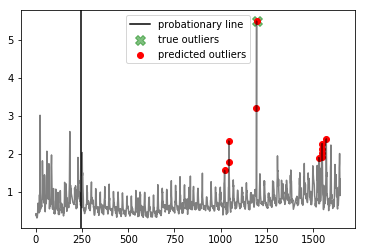




--- exchange-2_cpc_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  3
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [824, 896, 920, 1016]


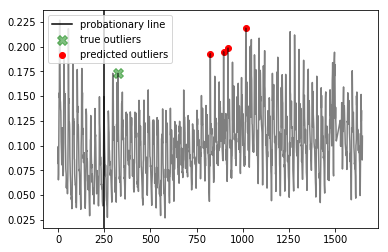




--- FARM_Bowling-Green-5-S_Warren ---
Corresponding window precision:  0.5
Corresponding window recall:  0.3333333333333333
Corresponding window false positives:  1
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  [711, 712, 713, 714, 3251, 3252, 3253, 3254, 3255]


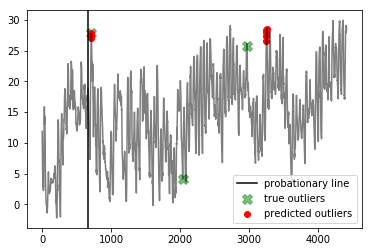

---------weight_fp=1.0, weight_fn=1----------


----Window-Based Results----
Minimum number of mistakes:  46.0
Best window threshold:  1.0
Corresponding window overall precision:  0.2711864406779661
Corresponding window overall recall:  0.7272727272727273
Corresponding window overall F score:  0.39506172839506176



--- all_data_gift_certificates ---
Corresponding window precision:  0.16666666666666666
Corresponding window recall:  1.0
Corresponding window false positives:  15
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [1615, 2233, 2320, 2791, 2871, 2886, 3014, 3053, 3389, 3664, 3676, 3680, 3729, 4206, 4286, 4902, 4961, 4963, 4978, 4986, 4992, 4998, 5000, 5001, 5024, 5046, 5047, 5072, 5095, 5382, 5623, 5662, 6014, 6137, 6505, 6650, 7254, 7720, 7760, 7783, 7786, 7809, 8022, 8029, 8072, 8073, 8094, 8096, 8097, 8098, 8242, 8265, 8288, 8289, 8336, 8337, 8338, 8360, 8407, 8408, 8409, 8410, 8430, 8431, 8432, 8433, 8434, 8435, 8455, 850

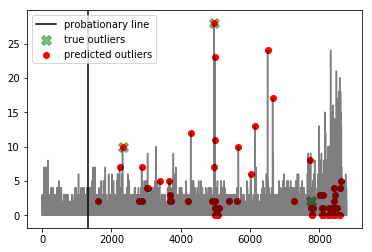




--- exchange-3_cpc_results ---
Corresponding window precision:  0.6
Corresponding window recall:  1.0
Corresponding window false positives:  2
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [322, 323, 466, 467, 1018, 1041, 1043, 1044, 1194, 1548, 1571]


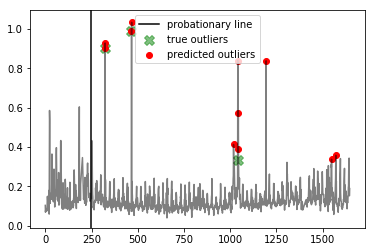




--- nyc_taxi ---
Corresponding window precision:  0.42857142857142855
Corresponding window recall:  0.6
Corresponding window false positives:  4
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  [3582, 5929, 7607, 7608, 7609, 7610, 7612, 7613, 7614, 8520, 8522, 9289, 9290, 10063, 10064, 10065, 10066, 10067, 10068, 10069, 10070, 10100, 10101, 10102, 10103, 10104, 10105, 10106, 10107, 10108, 10109, 10110, 10111, 10112]


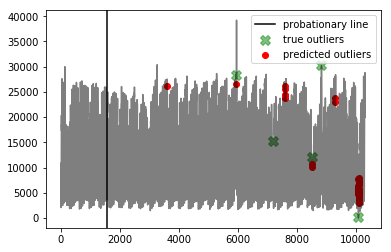




--- elb_request_count_8c0756 ---
Corresponding window precision:  0.2
Corresponding window recall:  1.0
Corresponding window false positives:  8
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [786, 791, 1359, 1374, 1403, 1586, 1978, 2497, 2517, 2551, 2556, 2595, 3069, 3427, 3455, 3658, 3690, 3693, 3957]


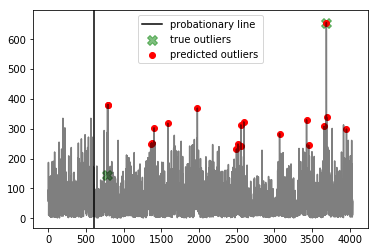




--- ambient_temperature_system_failure ---
Corresponding window precision:  0.3333333333333333
Corresponding window recall:  1.0
Corresponding window false positives:  4
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [2010, 2038, 4101, 4102, 4103, 4105, 4122, 4123, 4124, 4125, 4127, 4628, 4629, 5477, 5480, 5908, 5909, 5910, 5911, 5912, 5913, 6791, 6792, 6795, 6796, 6797, 6798, 6799, 6800, 6801, 6802, 6803, 6804]


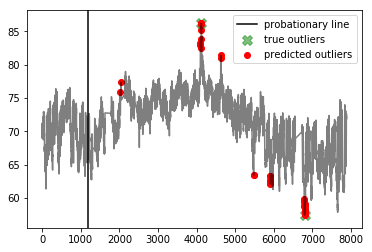




--- exchange-2_cpm_results ---
Corresponding window precision:  0.5
Corresponding window recall:  0.5
Corresponding window false positives:  1
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [977, 1016, 1044, 1045]


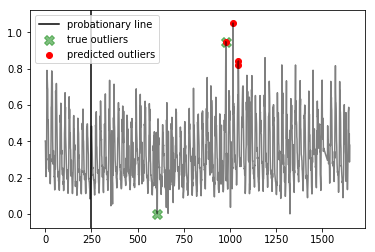




--- exchange-3_cpm_results ---
Corresponding window precision:  0.3333333333333333
Corresponding window recall:  1.0
Corresponding window false positives:  2
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [1021, 1044, 1045, 1193, 1194, 1531, 1546, 1547, 1548, 1549, 1571]


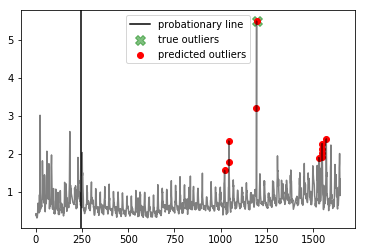




--- exchange-2_cpc_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  3
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [824, 896, 920, 1016]


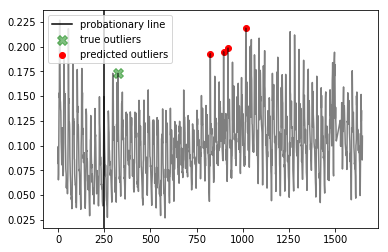




--- FARM_Bowling-Green-5-S_Warren ---
Corresponding window precision:  0.5
Corresponding window recall:  0.3333333333333333
Corresponding window false positives:  1
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  [711, 712, 713, 714, 3251, 3252, 3253, 3254, 3255]


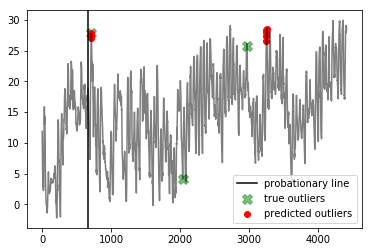

------------
False Positive Weight:  0.1
	 Minimum number of mistakes : 10.0
	 Best window threshold : 1.0
	 Corresponding window overall precision : 0.2711864406779661
	 Corresponding window overall recall : 0.7272727272727273
	 Corresponding window overall F score : 0.39506172839506176
False Positive Weight:  0.2
	 Minimum number of mistakes : 14.0
	 Best window threshold : 1.0
	 Corresponding window overall precision : 0.2711864406779661
	 Corresponding window overall recall : 0.7272727272727273
	 Corresponding window overall F score : 0.39506172839506176
False Positive Weight:  0.3
	 Minimum number of mistakes : 18.0
	 Best window threshold : 1.0
	 Corresponding window overall precision : 0.2711864406779661
	 Corresponding window overall recall : 0.7272727272727273
	 Corresponding window overall F score : 0.39506172839506176
False Positive Weight:  0.6
	 Minimum number of mistakes : 30.0
	 Best window threshold : 1.0
	 Corresponding window overall precision : 0.2711864406779661
	 C

In [33]:
end_results = {}
for weight_fp in weight_fp_list:  
    print("---------weight_fp=" + str(weight_fp) + ", weight_fn=1----------")
    weight_result = adclasses.pretty_print_results(donut_ad_dict, anomaly_scores_dict, donut_true_outlier_indices_dict, weight_fp=weight_fp, weight_fn=1)
    end_results[weight_fp] = weight_result

print("------------")
adclasses.pretty_print_end_results(end_results)

# STL Residual Results

In [37]:
anomaly_scores_dict = {}

for dataset_name in dataset_name_list:
    output_dict_htm = joblib.load("anomaly_scores/stl/" + dataset_name)
    anomaly_scores_dict[dataset_name] = output_dict_htm["Anomaly Scores"]

In [38]:
adclasses.precision_recall_curve_info(anomaly_scores_dict, true_outlier_indices_dict)

{0.1: {'precision': 0.11538461538461539, 'recall': 1.0},
 0.2: {'precision': 0.11538461538461539, 'recall': 1.0},
 0.3: {'precision': 0.11538461538461539, 'recall': 1.0},
 0.4: {'precision': 0.11538461538461539, 'recall': 1.0},
 0.5: {'precision': 0.11538461538461539, 'recall': 1.0},
 0.6: {'precision': 0.11538461538461539, 'recall': 1.0},
 0.7: {'precision': 0.11538461538461539, 'recall': 1.0},
 0.8: {'precision': 0.11538461538461539, 'recall': 1.0},
 0.9: {'precision': 0.12, 'recall': 1.0},
 1.0: {'precision': 0.0, 'recall': 0.0}}

---------weight_fp=0.1, weight_fn=1----------


----Window-Based Results----
Minimum number of mistakes:  11.600000000000001
Best window threshold:  0.9998
Corresponding window overall precision:  0.17272727272727273
Corresponding window overall recall:  0.8260869565217391
Corresponding window overall F score:  0.28571428571428575



--- all_data_gift_certificates ---
Corresponding window precision:  0.125
Corresponding window recall:  1.0
Corresponding window false positives:  21
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [1318, 1462, 1487, 1505, 1531, 1702, 1770, 1822, 1918, 2009, 2059, 2152, 2157, 2176, 2233, 2296, 2304, 2320, 2344, 2471, 2514, 2778, 2871, 2899, 2949, 2974, 3042, 3281, 3311, 3389, 3620, 3688, 3711, 3761, 3785, 3810, 3841, 3855, 4262, 4286, 4367, 4516, 4578, 4720, 4915, 4939, 4946, 4961, 4962, 4963, 4985, 4986, 4987, 4992, 5010, 5011, 5034, 5637, 5662, 5733, 5905, 6014, 6019, 6089, 6137, 6161, 6167, 6375, 6457,

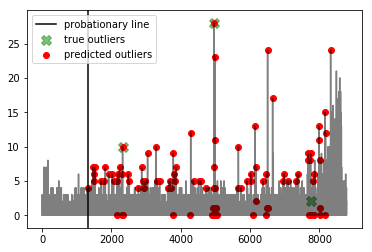




--- international-airline-passengers ---
Corresponding window precision:  0.25
Corresponding window recall:  1.0
Corresponding window false positives:  3
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [51, 76, 88, 100, 112]


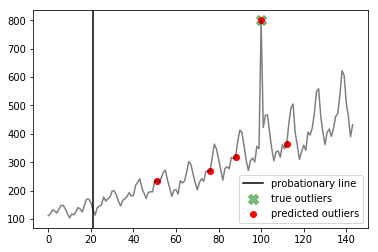




--- exchange-3_cpc_results ---
Corresponding window precision:  0.2727272727272727
Corresponding window recall:  1.0
Corresponding window false positives:  8
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [298, 322, 323, 346, 347, 466, 467, 757, 836, 993, 1017, 1018, 1020, 1022, 1041, 1044, 1065, 1170, 1193, 1194, 1218, 1531, 1536, 1596, 1619]


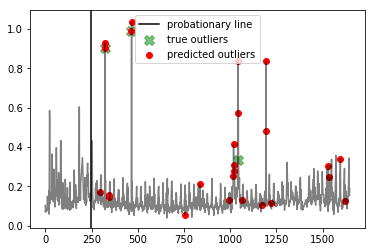




--- nyc_taxi ---
Corresponding window precision:  0.15384615384615385
Corresponding window recall:  0.8
Corresponding window false positives:  22
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [1586, 1587, 1588, 1589, 1601, 1924, 1937, 2257, 2258, 2259, 2260, 2261, 2262, 2271, 2272, 2273, 2594, 2595, 2596, 2597, 2609, 3038, 3039, 3040, 3041, 3042, 3230, 3231, 3232, 3266, 3279, 3280, 3567, 3568, 3601, 3602, 3603, 3615, 3616, 3938, 4272, 4273, 4274, 4275, 4276, 4277, 4286, 4287, 4288, 4289, 4575, 4576, 4608, 4609, 4610, 4611, 4612, 4613, 4623, 4624, 5280, 5281, 5282, 5283, 5284, 5285, 5294, 5295, 5296, 5297, 5617, 5618, 5619, 5620, 5621, 5630, 5631, 5632, 5908, 5954, 5955, 6002, 6003, 6303, 6304, 6639, 6640, 6959, 6960, 6961, 6962, 6963, 6964, 6965, 6974, 6975, 6976, 6977, 7007, 7023, 7024, 7599, 7600, 7632, 7633, 7634, 7635, 7636, 7646, 7647, 7648, 7649, 7969, 7970, 7971, 7972, 7973, 7982, 7983, 7984, 7985, 8017, 8030, 8031, 8032, 

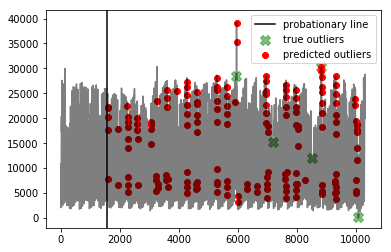




--- elb_request_count_8c0756 ---
Corresponding window precision:  0.25
Corresponding window recall:  1.0
Corresponding window false positives:  6
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [741, 786, 790, 791, 1586, 2551, 2556, 2595, 3069, 3327, 3405, 3427, 3455, 3690, 3978]


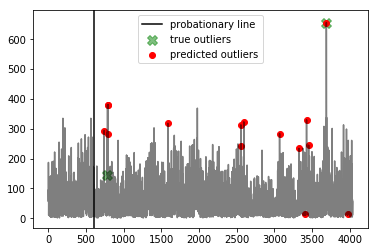




--- ambient_temperature_system_failure ---
Corresponding window precision:  0.2857142857142857
Corresponding window recall:  1.0
Corresponding window false positives:  5
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [1934, 2494, 2518, 4123, 4125, 4149, 4628, 4653, 4981, 6749, 6751, 6752, 6759, 6783, 7649, 7669, 7673, 7674]


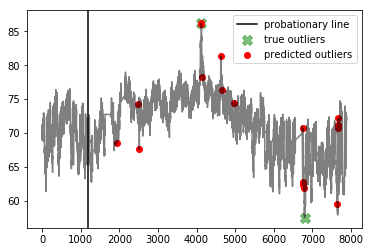




--- exchange-2_cpm_results ---
Corresponding window precision:  0.18181818181818182
Corresponding window recall:  1.0
Corresponding window false positives:  9
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [323, 325, 354, 355, 360, 365, 424, 601, 664, 665, 801, 802, 899, 923, 951, 968, 976, 977, 978, 1002, 1016, 1104, 1515, 1521, 1522]


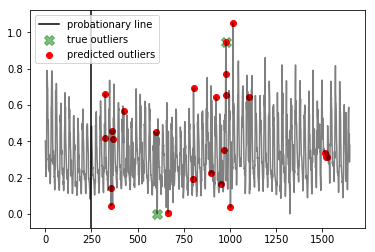




--- exchange-3_cpm_results ---
Corresponding window precision:  0.16666666666666666
Corresponding window recall:  1.0
Corresponding window false positives:  5
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [251, 660, 733, 757, 780, 812, 836, 901, 996, 1044, 1045, 1146, 1169, 1170, 1187, 1189, 1193, 1194, 1212, 1217, 1218, 1242, 1531, 1536, 1571, 1596]


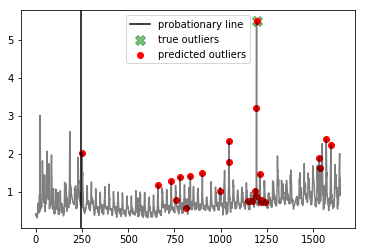




--- exchange-2_cpc_results ---
Corresponding window precision:  0.16666666666666666
Corresponding window recall:  1.0
Corresponding window false positives:  5
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [317, 325, 438, 824, 1016, 1354, 1484, 1485, 1486, 1487, 1490, 1515]


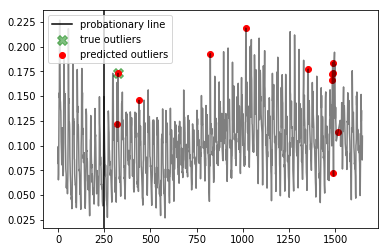




--- FARM_Bowling-Green-5-S_Warren ---
Corresponding window precision:  0.3333333333333333
Corresponding window recall:  0.3333333333333333
Corresponding window false positives:  2
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  [693, 695, 732, 733, 734, 735, 736, 2488, 2489, 2490, 2491, 2492, 2493, 2494, 2495, 2496, 2497, 2784]


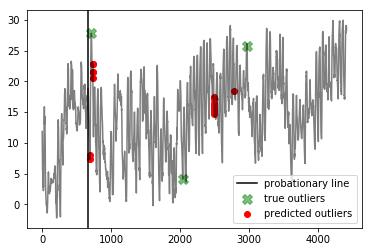

---------weight_fp=0.2, weight_fn=1----------


----Window-Based Results----
Minimum number of mistakes:  17.200000000000003
Best window threshold:  1.0
Corresponding window overall precision:  0.47368421052631576
Corresponding window overall recall:  0.391304347826087
Corresponding window overall F score:  0.42857142857142855



--- all_data_gift_certificates ---
Corresponding window precision:  0.2857142857142857
Corresponding window recall:  0.6666666666666666
Corresponding window false positives:  5
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [2320, 4286, 4939, 4963, 4986, 5662, 6137, 6481, 6505, 6529, 6650]


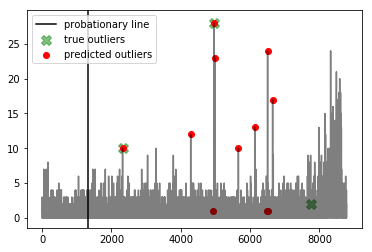




--- international-airline-passengers ---
Corresponding window precision:  0.5
Corresponding window recall:  1.0
Corresponding window false positives:  1
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [76, 88, 100]


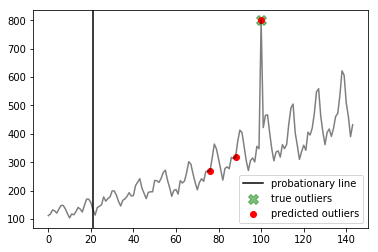




--- exchange-3_cpc_results ---
Corresponding window precision:  0.75
Corresponding window recall:  1.0
Corresponding window false positives:  1
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [322, 323, 466, 467, 1041, 1044, 1194]


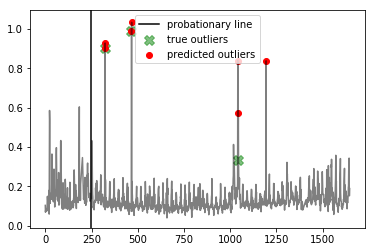




--- nyc_taxi ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  5


Outlier indices as determined by best window threshold:  []


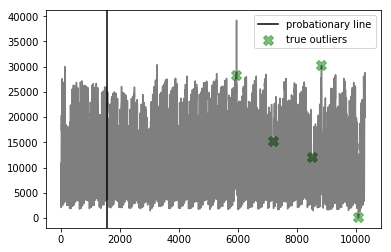




--- elb_request_count_8c0756 ---
Corresponding window precision:  1.0
Corresponding window recall:  0.5
Corresponding window false positives:  0
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [3690]


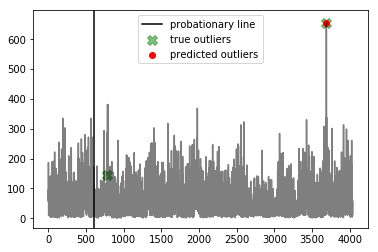




--- ambient_temperature_system_failure ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  1
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  [2518]


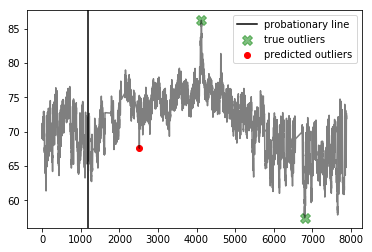




--- exchange-2_cpm_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  1
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  [1016]


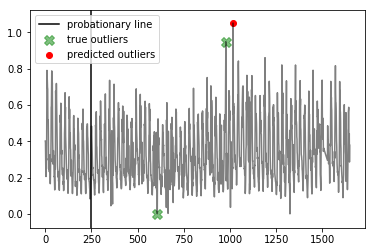




--- exchange-3_cpm_results ---
Corresponding window precision:  0.3333333333333333
Corresponding window recall:  1.0
Corresponding window false positives:  2
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [836, 1044, 1170, 1193, 1194, 1218]


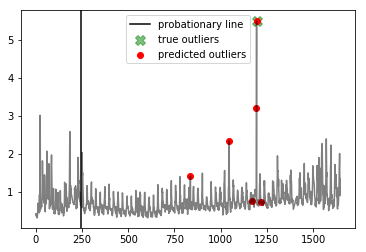




--- exchange-2_cpc_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  []


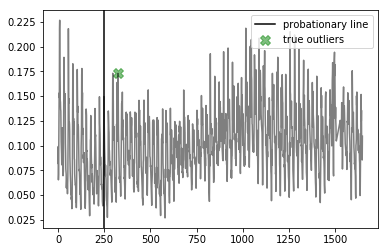




--- FARM_Bowling-Green-5-S_Warren ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  3


Outlier indices as determined by best window threshold:  []


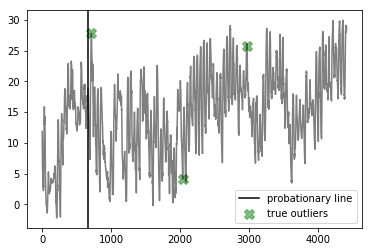

---------weight_fp=0.3, weight_fn=1----------


----Window-Based Results----
Minimum number of mistakes:  18.299999999999997
Best window threshold:  1.0
Corresponding window overall precision:  0.47368421052631576
Corresponding window overall recall:  0.391304347826087
Corresponding window overall F score:  0.42857142857142855



--- all_data_gift_certificates ---
Corresponding window precision:  0.2857142857142857
Corresponding window recall:  0.6666666666666666
Corresponding window false positives:  5
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [2320, 4286, 4939, 4963, 4986, 5662, 6137, 6481, 6505, 6529, 6650]


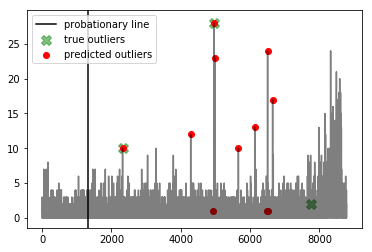




--- international-airline-passengers ---
Corresponding window precision:  0.5
Corresponding window recall:  1.0
Corresponding window false positives:  1
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [76, 88, 100]


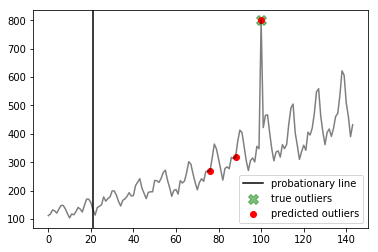




--- exchange-3_cpc_results ---
Corresponding window precision:  0.75
Corresponding window recall:  1.0
Corresponding window false positives:  1
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [322, 323, 466, 467, 1041, 1044, 1194]


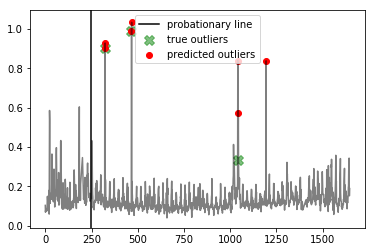




--- nyc_taxi ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  5


Outlier indices as determined by best window threshold:  []


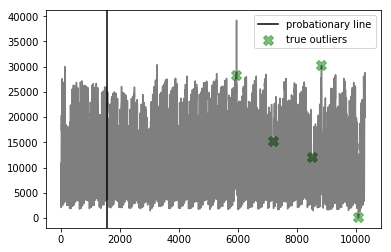




--- elb_request_count_8c0756 ---
Corresponding window precision:  1.0
Corresponding window recall:  0.5
Corresponding window false positives:  0
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [3690]


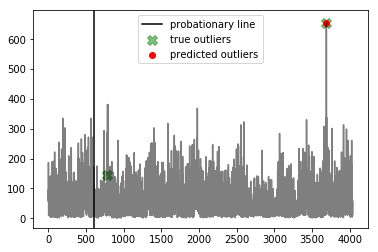




--- ambient_temperature_system_failure ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  1
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  [2518]


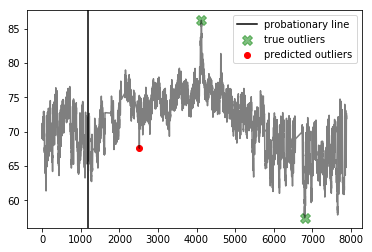




--- exchange-2_cpm_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  1
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  [1016]


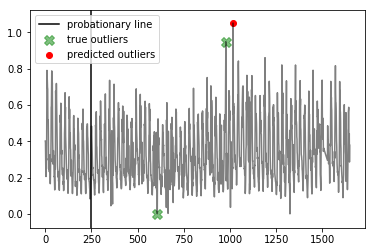




--- exchange-3_cpm_results ---
Corresponding window precision:  0.3333333333333333
Corresponding window recall:  1.0
Corresponding window false positives:  2
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [836, 1044, 1170, 1193, 1194, 1218]


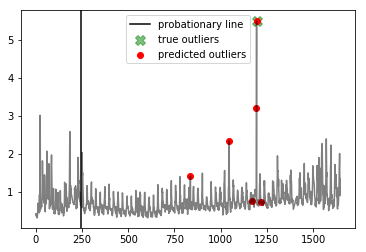




--- exchange-2_cpc_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  []


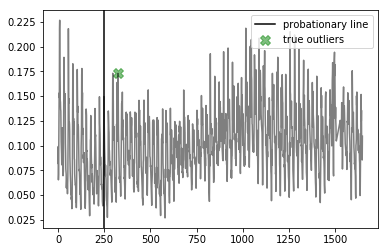




--- FARM_Bowling-Green-5-S_Warren ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  3


Outlier indices as determined by best window threshold:  []


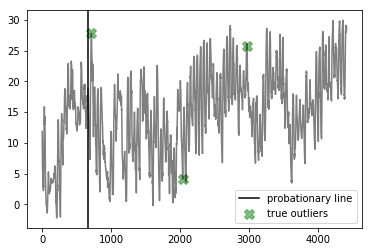

---------weight_fp=0.4, weight_fn=1----------


----Window-Based Results----
Minimum number of mistakes:  19.400000000000002
Best window threshold:  1.0
Corresponding window overall precision:  0.47368421052631576
Corresponding window overall recall:  0.391304347826087
Corresponding window overall F score:  0.42857142857142855



--- all_data_gift_certificates ---
Corresponding window precision:  0.2857142857142857
Corresponding window recall:  0.6666666666666666
Corresponding window false positives:  5
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [2320, 4286, 4939, 4963, 4986, 5662, 6137, 6481, 6505, 6529, 6650]


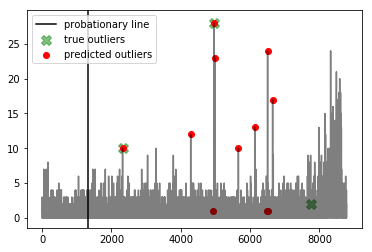




--- international-airline-passengers ---
Corresponding window precision:  0.5
Corresponding window recall:  1.0
Corresponding window false positives:  1
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [76, 88, 100]


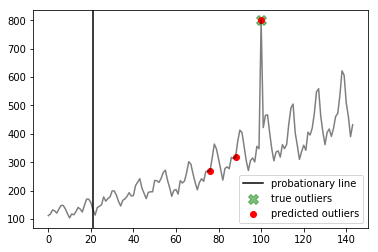




--- exchange-3_cpc_results ---
Corresponding window precision:  0.75
Corresponding window recall:  1.0
Corresponding window false positives:  1
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [322, 323, 466, 467, 1041, 1044, 1194]


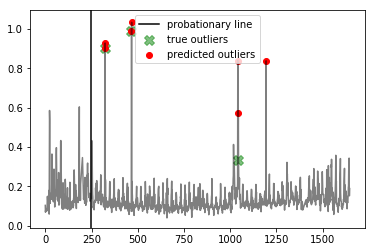




--- nyc_taxi ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  5


Outlier indices as determined by best window threshold:  []


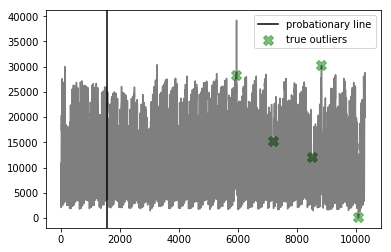




--- elb_request_count_8c0756 ---
Corresponding window precision:  1.0
Corresponding window recall:  0.5
Corresponding window false positives:  0
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [3690]


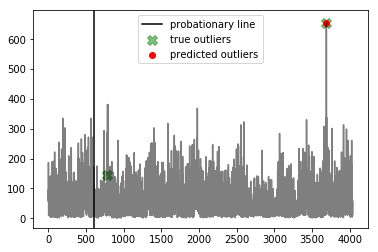




--- ambient_temperature_system_failure ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  1
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  [2518]


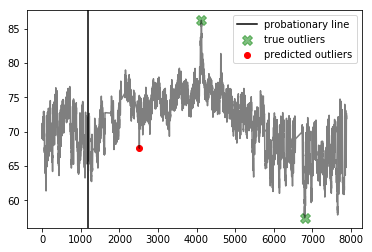




--- exchange-2_cpm_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  1
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  [1016]


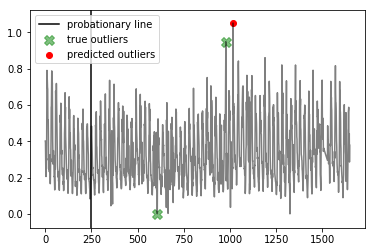




--- exchange-3_cpm_results ---
Corresponding window precision:  0.3333333333333333
Corresponding window recall:  1.0
Corresponding window false positives:  2
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [836, 1044, 1170, 1193, 1194, 1218]


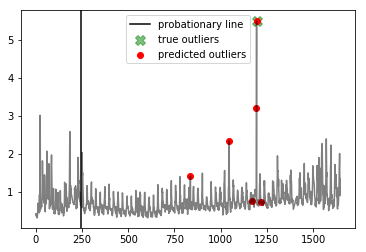




--- exchange-2_cpc_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  []


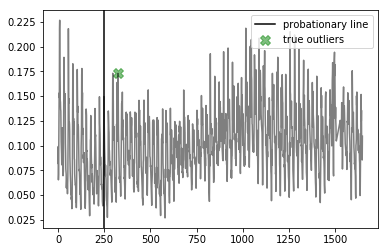




--- FARM_Bowling-Green-5-S_Warren ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  3


Outlier indices as determined by best window threshold:  []


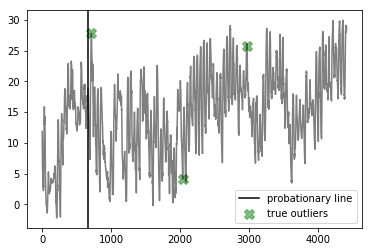

---------weight_fp=0.5, weight_fn=1----------


----Window-Based Results----
Minimum number of mistakes:  20.5
Best window threshold:  1.0
Corresponding window overall precision:  0.47368421052631576
Corresponding window overall recall:  0.391304347826087
Corresponding window overall F score:  0.42857142857142855



--- all_data_gift_certificates ---
Corresponding window precision:  0.2857142857142857
Corresponding window recall:  0.6666666666666666
Corresponding window false positives:  5
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [2320, 4286, 4939, 4963, 4986, 5662, 6137, 6481, 6505, 6529, 6650]


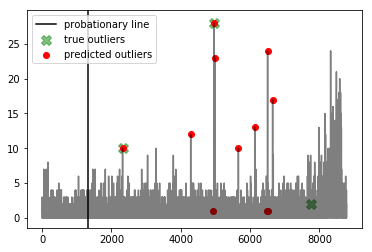




--- international-airline-passengers ---
Corresponding window precision:  0.5
Corresponding window recall:  1.0
Corresponding window false positives:  1
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [76, 88, 100]


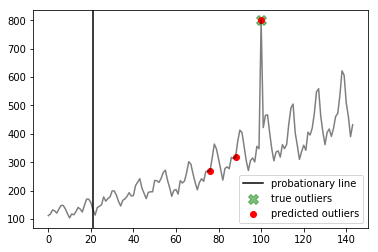




--- exchange-3_cpc_results ---
Corresponding window precision:  0.75
Corresponding window recall:  1.0
Corresponding window false positives:  1
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [322, 323, 466, 467, 1041, 1044, 1194]


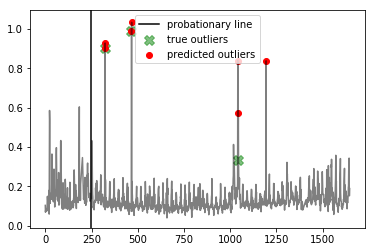




--- nyc_taxi ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  5


Outlier indices as determined by best window threshold:  []


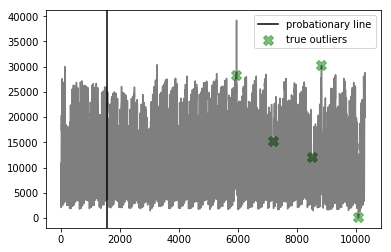




--- elb_request_count_8c0756 ---
Corresponding window precision:  1.0
Corresponding window recall:  0.5
Corresponding window false positives:  0
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [3690]


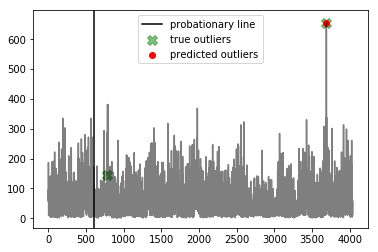




--- ambient_temperature_system_failure ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  1
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  [2518]


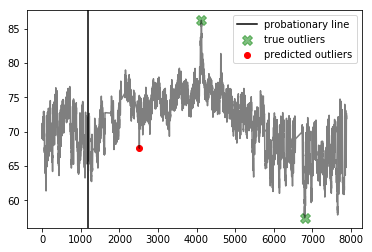




--- exchange-2_cpm_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  1
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  [1016]


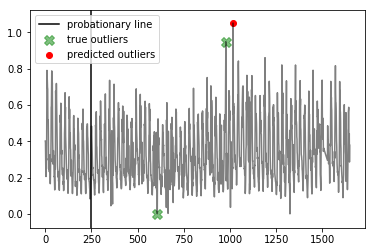




--- exchange-3_cpm_results ---
Corresponding window precision:  0.3333333333333333
Corresponding window recall:  1.0
Corresponding window false positives:  2
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [836, 1044, 1170, 1193, 1194, 1218]


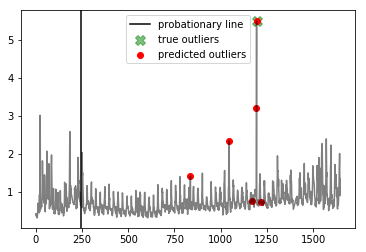




--- exchange-2_cpc_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  []


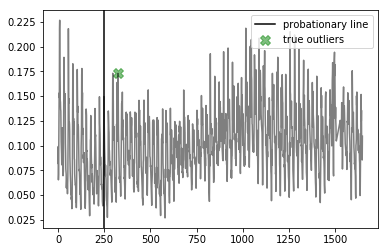




--- FARM_Bowling-Green-5-S_Warren ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  3


Outlier indices as determined by best window threshold:  []


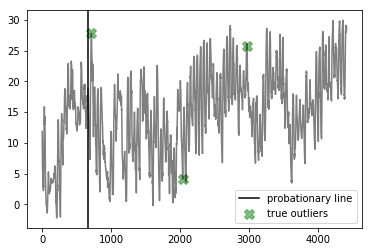

---------weight_fp=0.6, weight_fn=1----------


----Window-Based Results----
Minimum number of mistakes:  21.599999999999998
Best window threshold:  1.0
Corresponding window overall precision:  0.47368421052631576
Corresponding window overall recall:  0.391304347826087
Corresponding window overall F score:  0.42857142857142855



--- all_data_gift_certificates ---
Corresponding window precision:  0.2857142857142857
Corresponding window recall:  0.6666666666666666
Corresponding window false positives:  5
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [2320, 4286, 4939, 4963, 4986, 5662, 6137, 6481, 6505, 6529, 6650]


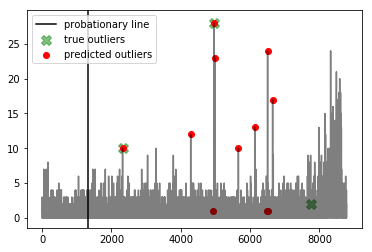




--- international-airline-passengers ---
Corresponding window precision:  0.5
Corresponding window recall:  1.0
Corresponding window false positives:  1
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [76, 88, 100]


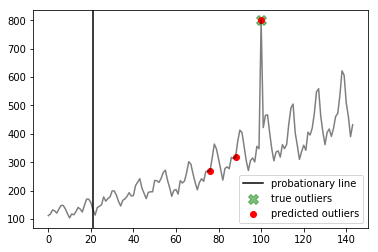




--- exchange-3_cpc_results ---
Corresponding window precision:  0.75
Corresponding window recall:  1.0
Corresponding window false positives:  1
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [322, 323, 466, 467, 1041, 1044, 1194]


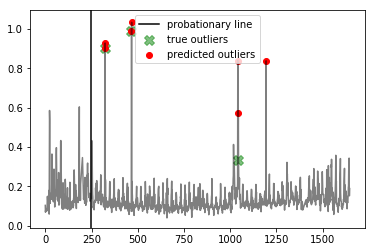




--- nyc_taxi ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  5


Outlier indices as determined by best window threshold:  []


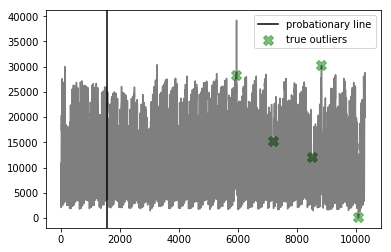




--- elb_request_count_8c0756 ---
Corresponding window precision:  1.0
Corresponding window recall:  0.5
Corresponding window false positives:  0
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [3690]


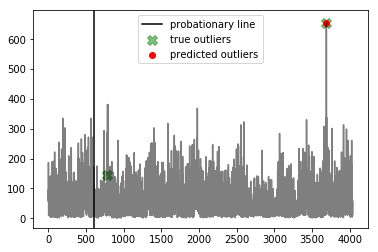




--- ambient_temperature_system_failure ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  1
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  [2518]


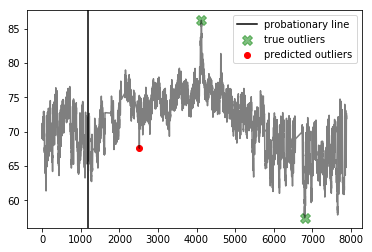




--- exchange-2_cpm_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  1
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  [1016]


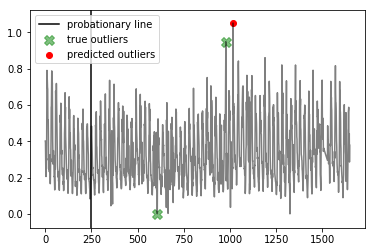




--- exchange-3_cpm_results ---
Corresponding window precision:  0.3333333333333333
Corresponding window recall:  1.0
Corresponding window false positives:  2
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [836, 1044, 1170, 1193, 1194, 1218]


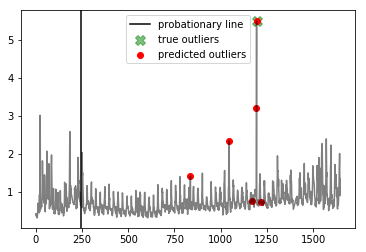




--- exchange-2_cpc_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  []


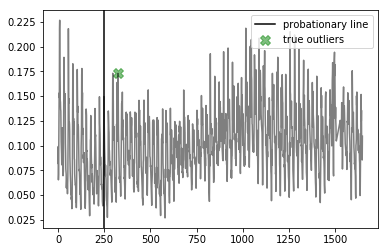




--- FARM_Bowling-Green-5-S_Warren ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  3


Outlier indices as determined by best window threshold:  []


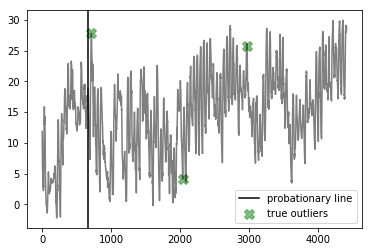

---------weight_fp=0.7, weight_fn=1----------


----Window-Based Results----
Minimum number of mistakes:  22.7
Best window threshold:  1.0
Corresponding window overall precision:  0.47368421052631576
Corresponding window overall recall:  0.391304347826087
Corresponding window overall F score:  0.42857142857142855



--- all_data_gift_certificates ---
Corresponding window precision:  0.2857142857142857
Corresponding window recall:  0.6666666666666666
Corresponding window false positives:  5
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [2320, 4286, 4939, 4963, 4986, 5662, 6137, 6481, 6505, 6529, 6650]


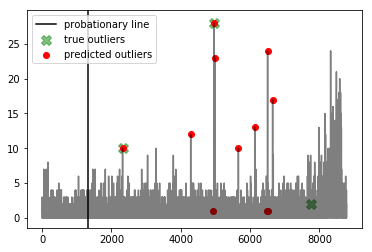




--- international-airline-passengers ---
Corresponding window precision:  0.5
Corresponding window recall:  1.0
Corresponding window false positives:  1
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [76, 88, 100]


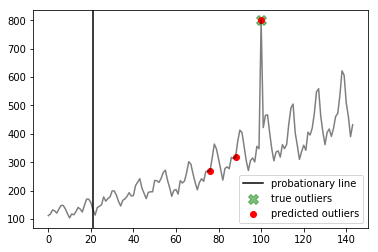




--- exchange-3_cpc_results ---
Corresponding window precision:  0.75
Corresponding window recall:  1.0
Corresponding window false positives:  1
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [322, 323, 466, 467, 1041, 1044, 1194]


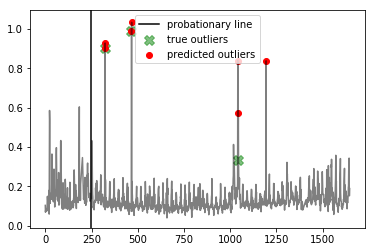




--- nyc_taxi ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  5


Outlier indices as determined by best window threshold:  []


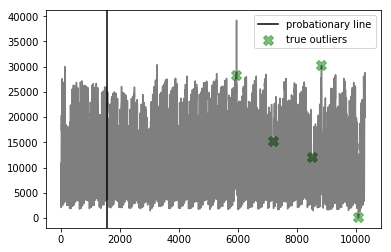




--- elb_request_count_8c0756 ---
Corresponding window precision:  1.0
Corresponding window recall:  0.5
Corresponding window false positives:  0
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [3690]


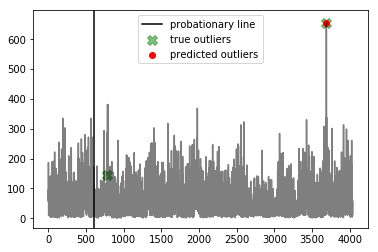




--- ambient_temperature_system_failure ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  1
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  [2518]


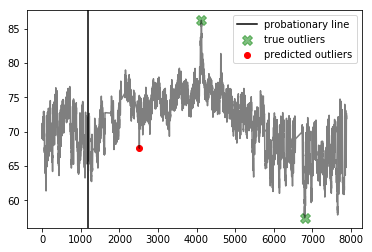




--- exchange-2_cpm_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  1
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  [1016]


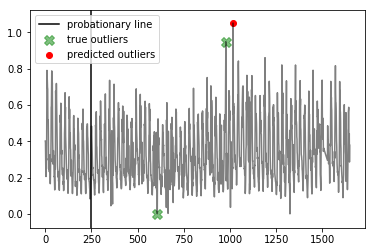




--- exchange-3_cpm_results ---
Corresponding window precision:  0.3333333333333333
Corresponding window recall:  1.0
Corresponding window false positives:  2
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [836, 1044, 1170, 1193, 1194, 1218]


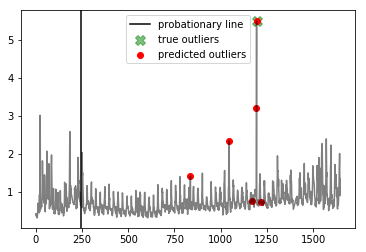




--- exchange-2_cpc_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  []


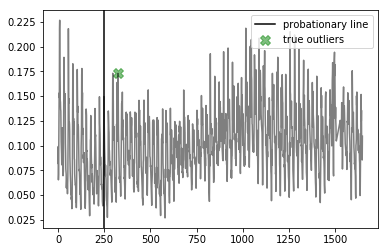




--- FARM_Bowling-Green-5-S_Warren ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  3


Outlier indices as determined by best window threshold:  []


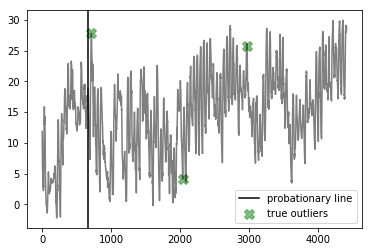

---------weight_fp=0.8, weight_fn=1----------


----Window-Based Results----
Minimum number of mistakes:  23.8
Best window threshold:  1.0
Corresponding window overall precision:  0.47368421052631576
Corresponding window overall recall:  0.391304347826087
Corresponding window overall F score:  0.42857142857142855



--- all_data_gift_certificates ---
Corresponding window precision:  0.2857142857142857
Corresponding window recall:  0.6666666666666666
Corresponding window false positives:  5
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [2320, 4286, 4939, 4963, 4986, 5662, 6137, 6481, 6505, 6529, 6650]


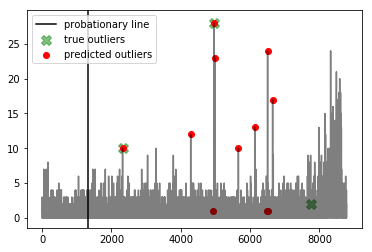




--- international-airline-passengers ---
Corresponding window precision:  0.5
Corresponding window recall:  1.0
Corresponding window false positives:  1
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [76, 88, 100]


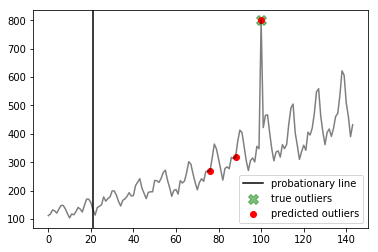




--- exchange-3_cpc_results ---
Corresponding window precision:  0.75
Corresponding window recall:  1.0
Corresponding window false positives:  1
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [322, 323, 466, 467, 1041, 1044, 1194]


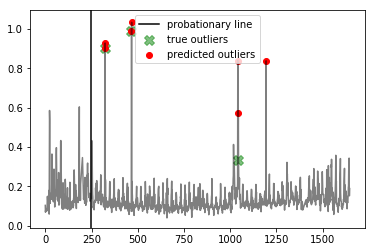




--- nyc_taxi ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  5


Outlier indices as determined by best window threshold:  []


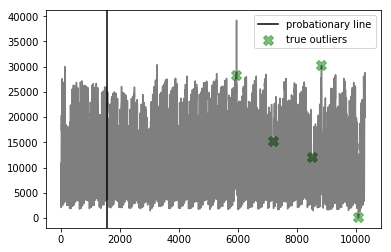




--- elb_request_count_8c0756 ---
Corresponding window precision:  1.0
Corresponding window recall:  0.5
Corresponding window false positives:  0
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [3690]


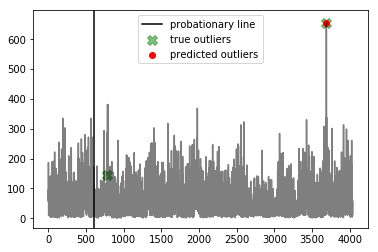




--- ambient_temperature_system_failure ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  1
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  [2518]


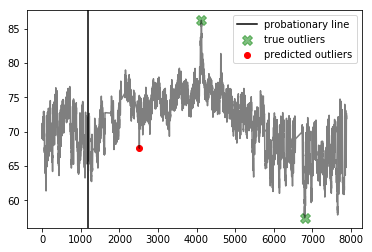




--- exchange-2_cpm_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  1
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  [1016]


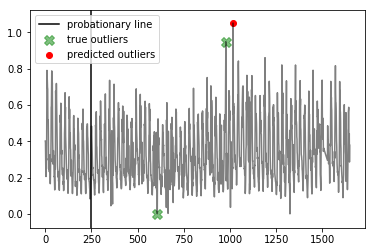




--- exchange-3_cpm_results ---
Corresponding window precision:  0.3333333333333333
Corresponding window recall:  1.0
Corresponding window false positives:  2
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [836, 1044, 1170, 1193, 1194, 1218]


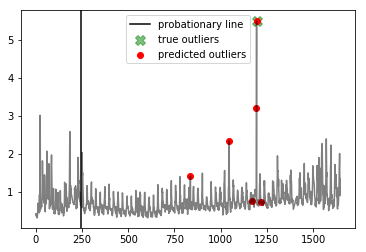




--- exchange-2_cpc_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  []


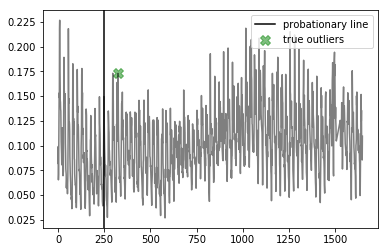




--- FARM_Bowling-Green-5-S_Warren ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  3


Outlier indices as determined by best window threshold:  []


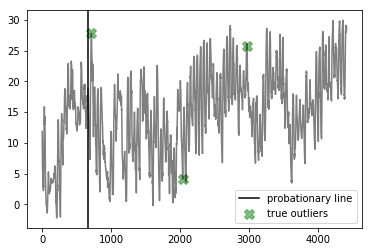

---------weight_fp=0.9, weight_fn=1----------


----Window-Based Results----
Minimum number of mistakes:  24.9
Best window threshold:  1.0
Corresponding window overall precision:  0.47368421052631576
Corresponding window overall recall:  0.391304347826087
Corresponding window overall F score:  0.42857142857142855



--- all_data_gift_certificates ---
Corresponding window precision:  0.2857142857142857
Corresponding window recall:  0.6666666666666666
Corresponding window false positives:  5
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [2320, 4286, 4939, 4963, 4986, 5662, 6137, 6481, 6505, 6529, 6650]


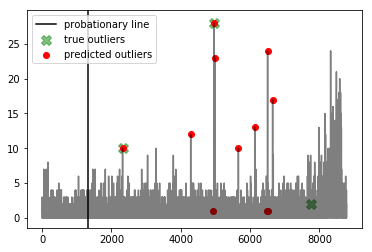




--- international-airline-passengers ---
Corresponding window precision:  0.5
Corresponding window recall:  1.0
Corresponding window false positives:  1
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [76, 88, 100]


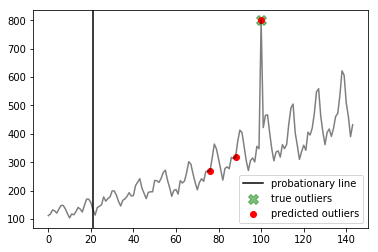




--- exchange-3_cpc_results ---
Corresponding window precision:  0.75
Corresponding window recall:  1.0
Corresponding window false positives:  1
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [322, 323, 466, 467, 1041, 1044, 1194]


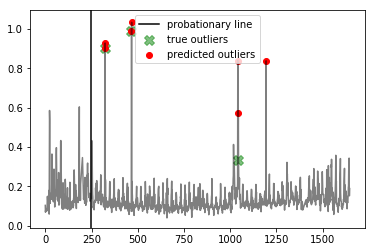




--- nyc_taxi ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  5


Outlier indices as determined by best window threshold:  []


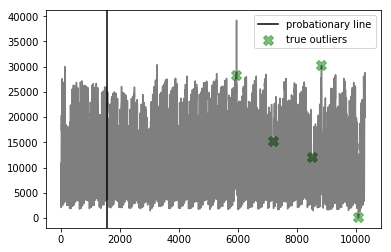




--- elb_request_count_8c0756 ---
Corresponding window precision:  1.0
Corresponding window recall:  0.5
Corresponding window false positives:  0
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [3690]


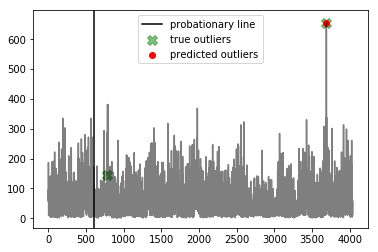




--- ambient_temperature_system_failure ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  1
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  [2518]


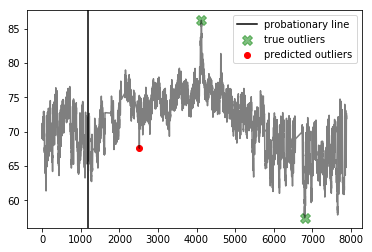




--- exchange-2_cpm_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  1
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  [1016]


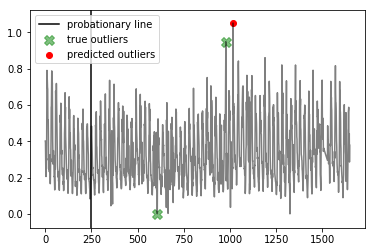




--- exchange-3_cpm_results ---
Corresponding window precision:  0.3333333333333333
Corresponding window recall:  1.0
Corresponding window false positives:  2
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [836, 1044, 1170, 1193, 1194, 1218]


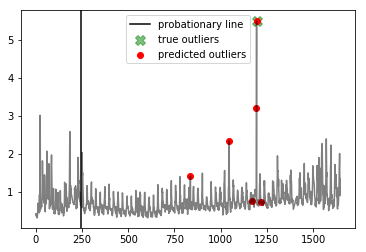




--- exchange-2_cpc_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  []


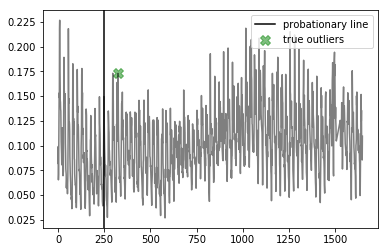




--- FARM_Bowling-Green-5-S_Warren ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  3


Outlier indices as determined by best window threshold:  []


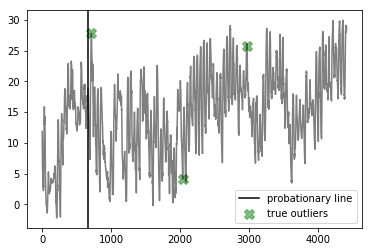

---------weight_fp=1.0, weight_fn=1----------


----Window-Based Results----
Minimum number of mistakes:  26.0
Best window threshold:  1.0
Corresponding window overall precision:  0.47368421052631576
Corresponding window overall recall:  0.391304347826087
Corresponding window overall F score:  0.42857142857142855



--- all_data_gift_certificates ---
Corresponding window precision:  0.2857142857142857
Corresponding window recall:  0.6666666666666666
Corresponding window false positives:  5
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [2320, 4286, 4939, 4963, 4986, 5662, 6137, 6481, 6505, 6529, 6650]


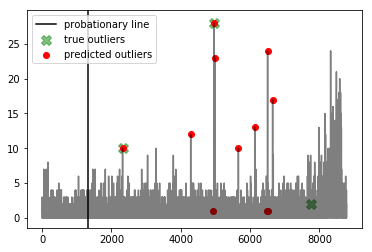




--- international-airline-passengers ---
Corresponding window precision:  0.5
Corresponding window recall:  1.0
Corresponding window false positives:  1
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [76, 88, 100]


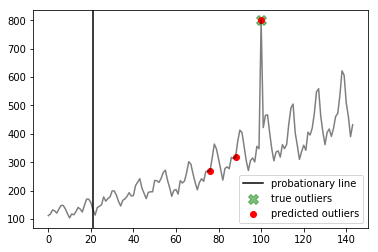




--- exchange-3_cpc_results ---
Corresponding window precision:  0.75
Corresponding window recall:  1.0
Corresponding window false positives:  1
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [322, 323, 466, 467, 1041, 1044, 1194]


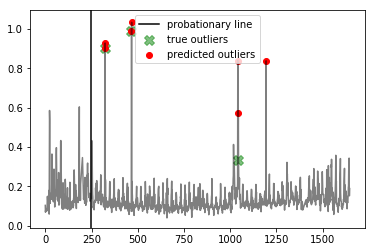




--- nyc_taxi ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  5


Outlier indices as determined by best window threshold:  []


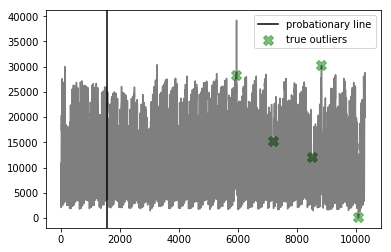




--- elb_request_count_8c0756 ---
Corresponding window precision:  1.0
Corresponding window recall:  0.5
Corresponding window false positives:  0
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [3690]


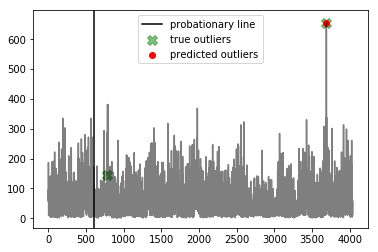




--- ambient_temperature_system_failure ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  1
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  [2518]


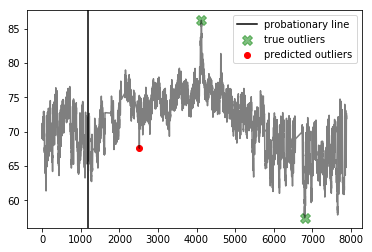




--- exchange-2_cpm_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  1
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  [1016]


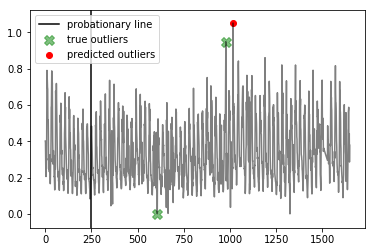




--- exchange-3_cpm_results ---
Corresponding window precision:  0.3333333333333333
Corresponding window recall:  1.0
Corresponding window false positives:  2
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [836, 1044, 1170, 1193, 1194, 1218]


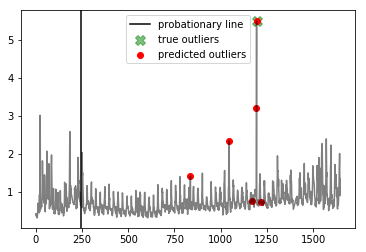




--- exchange-2_cpc_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  []


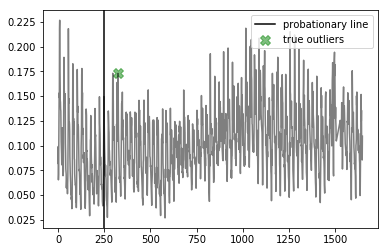




--- FARM_Bowling-Green-5-S_Warren ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  3


Outlier indices as determined by best window threshold:  []


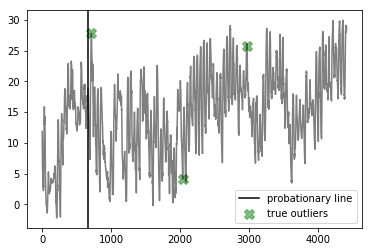

------------
False Positive Weight:  0.1
	 Minimum number of mistakes : 11.600000000000001
	 Best window threshold : 0.9998
	 Corresponding window overall precision : 0.17272727272727273
	 Corresponding window overall recall : 0.8260869565217391
	 Corresponding window overall F score : 0.28571428571428575
False Positive Weight:  0.2
	 Minimum number of mistakes : 17.200000000000003
	 Best window threshold : 1.0
	 Corresponding window overall precision : 0.47368421052631576
	 Corresponding window overall recall : 0.391304347826087
	 Corresponding window overall F score : 0.42857142857142855
False Positive Weight:  0.3
	 Minimum number of mistakes : 18.299999999999997
	 Best window threshold : 1.0
	 Corresponding window overall precision : 0.47368421052631576
	 Corresponding window overall recall : 0.391304347826087
	 Corresponding window overall F score : 0.42857142857142855
False Positive Weight:  0.6
	 Minimum number of mistakes : 21.599999999999998
	 Best window threshold : 1.0
	 Cor

In [39]:
end_results = {}
for weight_fp in weight_fp_list:  
    print("---------weight_fp=" + str(weight_fp) + ", weight_fn=1----------")
    weight_result = adclasses.pretty_print_results(ad_dict, anomaly_scores_dict, true_outlier_indices_dict, weight_fp=weight_fp, weight_fn=1)
    end_results[weight_fp] = weight_result

print("------------")
adclasses.pretty_print_end_results(end_results)

# windowed gaussian Results

In [40]:
anomaly_scores_dict = {}

for dataset_name in dataset_name_list:
    output_dict_htm = joblib.load("anomaly_scores/windowed_gaussian/" + dataset_name)
    anomaly_scores_dict[dataset_name] = output_dict_htm["Anomaly Scores"]

In [41]:
adclasses.precision_recall_curve_info(anomaly_scores_dict, true_outlier_indices_dict)

{0.1: {'precision': 0.11538461538461539, 'recall': 1.0},
 0.2: {'precision': 0.11538461538461539, 'recall': 1.0},
 0.3: {'precision': 0.11538461538461539, 'recall': 1.0},
 0.4: {'precision': 0.11538461538461539, 'recall': 1.0},
 0.5: {'precision': 0.11538461538461539, 'recall': 1.0},
 0.6: {'precision': 0.11538461538461539, 'recall': 1.0},
 0.7: {'precision': 0.11538461538461539, 'recall': 1.0},
 0.8: {'precision': 0.11538461538461539, 'recall': 1.0},
 0.9: {'precision': 0.11538461538461539, 'recall': 1.0},
 1.0: {'precision': 0.0, 'recall': 0.0}}

---------weight_fp=0.1, weight_fn=1----------


----Window-Based Results----
Minimum number of mistakes:  12.9
Best window threshold:  0.9983
Corresponding window overall precision:  0.1588785046728972
Corresponding window overall recall:  0.7391304347826086
Corresponding window overall F score:  0.2615384615384615



--- all_data_gift_certificates ---
Corresponding window precision:  0.11538461538461539
Corresponding window recall:  1.0
Corresponding window false positives:  23
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [1318, 1343, 1385, 1409, 1438, 1439, 1462, 1483, 1487, 1505, 1508, 1531, 1702, 1770, 1820, 1822, 1918, 1919, 2009, 2059, 2157, 2176, 2233, 2276, 2304, 2320, 2469, 2471, 2488, 2491, 2514, 2667, 2681, 2777, 2778, 2851, 2871, 2894, 2899, 2905, 2949, 2974, 3014, 3016, 3024, 3042, 3053, 3260, 3281, 3311, 3389, 3620, 3664, 3676, 3688, 3691, 3711, 3714, 3734, 3785, 3790, 3805, 3810, 3841, 3842, 3855, 4149, 4286, 4317, 4

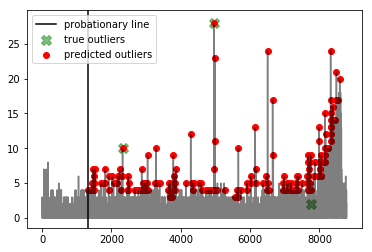




--- international-airline-passengers ---
Corresponding window precision:  0.16666666666666666
Corresponding window recall:  1.0
Corresponding window false positives:  5
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [43, 78, 90, 91, 100, 102, 103, 113, 114, 115, 125, 126, 127, 128, 135, 136, 137, 138, 139, 140, 141]


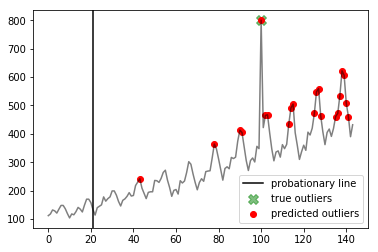




--- exchange-3_cpc_results ---
Corresponding window precision:  0.25
Corresponding window recall:  1.0
Corresponding window false positives:  9
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [251, 322, 323, 466, 467, 779, 901, 1016, 1017, 1018, 1019, 1020, 1021, 1022, 1023, 1024, 1040, 1041, 1042, 1043, 1044, 1045, 1046, 1050, 1193, 1194, 1473, 1498, 1522, 1531, 1546, 1547, 1548, 1549, 1571, 1596, 1643]


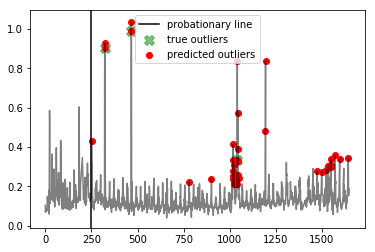




--- nyc_taxi ---
Corresponding window precision:  1.0
Corresponding window recall:  0.4
Corresponding window false positives:  0
Corresponding window false negatives:  3


Outlier indices as determined by best window threshold:  [5954, 8825, 8826, 8827, 8833, 8834, 8835]


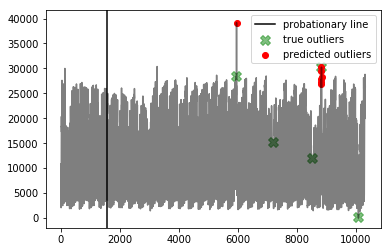




--- elb_request_count_8c0756 ---
Corresponding window precision:  0.13333333333333333
Corresponding window recall:  1.0
Corresponding window false positives:  13
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [741, 783, 786, 790, 791, 926, 1066, 1070, 1087, 1140, 1322, 1342, 1359, 1361, 1374, 1388, 1403, 1406, 1407, 1418, 1586, 1664, 1672, 1679, 1763, 1938, 1973, 1977, 1978, 1979, 2265, 2497, 2517, 2551, 2556, 2563, 2595, 2836, 3044, 3052, 3069, 3087, 3116, 3117, 3191, 3221, 3327, 3349, 3378, 3395, 3419, 3427, 3428, 3455, 3499, 3658, 3664, 3677, 3690, 3691, 3693, 3703, 3707, 3719, 3726, 3767, 3918, 3957, 3981, 4026]


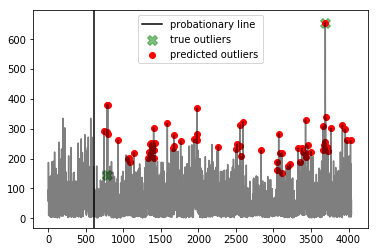




--- ambient_temperature_system_failure ---
Corresponding window precision:  0.14285714285714285
Corresponding window recall:  1.0
Corresponding window false positives:  12
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [1529, 1531, 1532, 1533, 1534, 1537, 1538, 1548, 1549, 1552, 1553, 1554, 1555, 1858, 1859, 1860, 1861, 1863, 1866, 2038, 2040, 2041, 2042, 2043, 2045, 2310, 2518, 2526, 2527, 2605, 2606, 2686, 2879, 2883, 3128, 3247, 3254, 3255, 3297, 3552, 3555, 3805, 3807, 3849, 3854, 3961, 3962, 4098, 4100, 4101, 4102, 4103, 4104, 4105, 4106, 4107, 4108, 4109, 4110, 4111, 4112, 4113, 4114, 4115, 4116, 4117, 4118, 4119, 4120, 4121, 4122, 4123, 4124, 4125, 4126, 4127, 4128, 4129, 4130, 4131, 4132, 4133, 4134, 4135, 4136, 4137, 4138, 4139, 4140, 4141, 4144, 4151, 4152, 4153, 4154, 4155, 4627, 4628, 4629, 4630, 4631, 4636, 4957, 5021, 5024, 5025, 5028, 5029, 5031, 5042, 5044, 5045, 5046, 5227, 5442, 5443, 5444, 5446, 5448, 5449, 5450

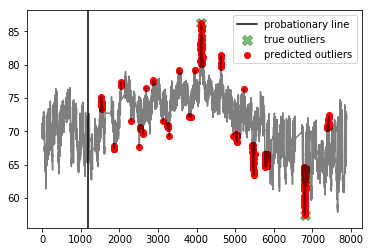




--- exchange-2_cpm_results ---
Corresponding window precision:  0.25
Corresponding window recall:  0.5
Corresponding window false positives:  3
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [802, 876, 896, 976, 977, 1016, 1044, 1045, 1046]


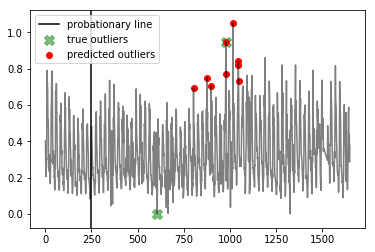




--- exchange-3_cpm_results ---
Corresponding window precision:  0.16666666666666666
Corresponding window recall:  1.0
Corresponding window false positives:  5
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [251, 660, 683, 684, 708, 709, 732, 733, 756, 779, 780, 803, 804, 805, 829, 836, 853, 901, 948, 1020, 1021, 1022, 1044, 1045, 1046, 1193, 1194, 1212, 1498, 1522, 1531, 1536, 1545, 1546, 1547, 1548, 1549, 1550, 1571, 1572, 1596, 1643]


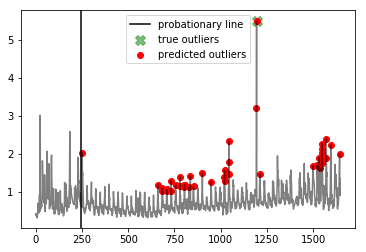




--- exchange-2_cpc_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  3
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [824, 848, 896, 920, 944, 1016, 1039, 1040, 1045, 1046, 1088]


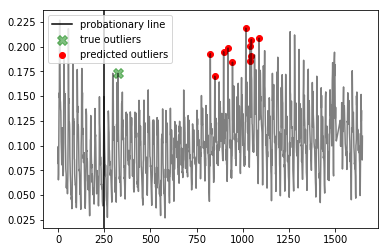




--- FARM_Bowling-Green-5-S_Warren ---
Corresponding window precision:  0.3333333333333333
Corresponding window recall:  1.0
Corresponding window false positives:  6
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [693, 694, 695, 696, 708, 709, 710, 711, 712, 713, 714, 715, 716, 717, 718, 832, 833, 834, 835, 836, 837, 838, 839, 840, 841, 2004, 2005, 2006, 3092, 3093, 3094, 3138, 3139, 3140, 3256, 3257, 3258, 3259, 3260, 3261, 3262, 3300, 3301, 3302, 3303, 3304, 3305, 3306, 3307, 3308, 3309, 3310, 3577, 3578, 3579, 3601, 3602, 3603, 3604, 3605, 3606, 3607, 3608, 3609, 3610, 3611, 3612, 3613, 3614, 3615, 3616, 3617, 3618, 3619, 3620, 3621, 3622, 3623, 3624, 3625, 3626, 3654, 3655, 3972, 3973, 3974, 3975, 3976, 3977, 3978, 3979, 3980, 3981, 3982, 4018, 4019, 4020, 4021, 4022, 4023, 4024, 4025, 4026, 4027, 4028, 4029, 4030, 4031, 4032]


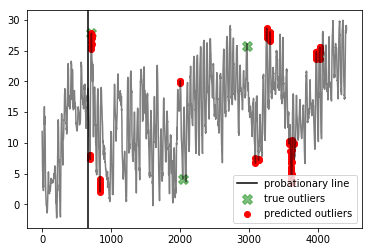

---------weight_fp=0.2, weight_fn=1----------


----Window-Based Results----
Minimum number of mistakes:  16.6
Best window threshold:  1.0
Corresponding window overall precision:  0.4444444444444444
Corresponding window overall recall:  0.34782608695652173
Corresponding window overall F score:  0.3902439024390244



--- all_data_gift_certificates ---
Corresponding window precision:  0.3333333333333333
Corresponding window recall:  1.0
Corresponding window false positives:  6
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [2320, 3785, 4286, 4963, 4986, 4992, 5662, 6137, 6505, 6650, 7677, 7746]


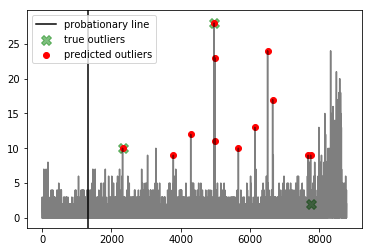




--- international-airline-passengers ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  []


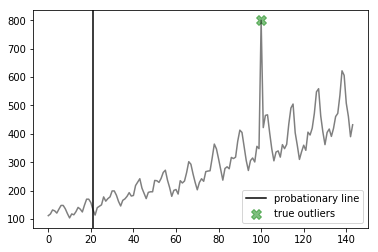




--- exchange-3_cpc_results ---
Corresponding window precision:  0.75
Corresponding window recall:  1.0
Corresponding window false positives:  1
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [322, 323, 466, 467, 1018, 1041, 1043, 1044, 1194]


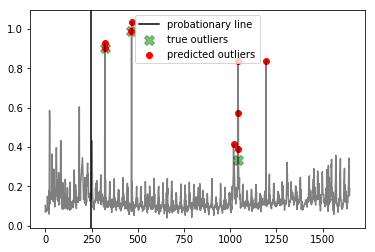




--- nyc_taxi ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  5


Outlier indices as determined by best window threshold:  []


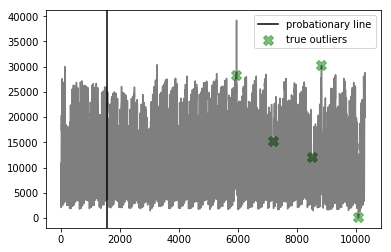




--- elb_request_count_8c0756 ---
Corresponding window precision:  1.0
Corresponding window recall:  0.5
Corresponding window false positives:  0
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [3690]


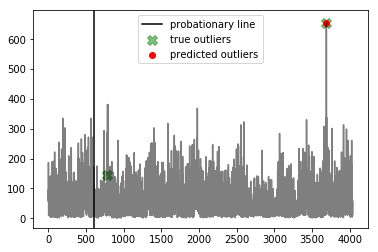




--- ambient_temperature_system_failure ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  []


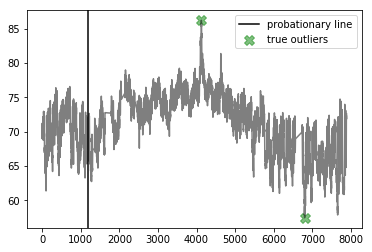




--- exchange-2_cpm_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  []


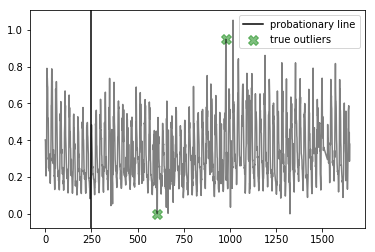




--- exchange-3_cpm_results ---
Corresponding window precision:  0.5
Corresponding window recall:  1.0
Corresponding window false positives:  1
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [1044, 1193, 1194]


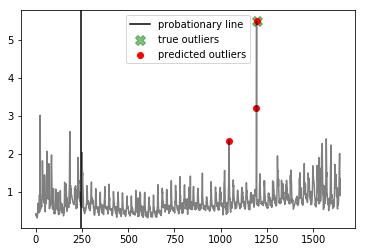




--- exchange-2_cpc_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  []


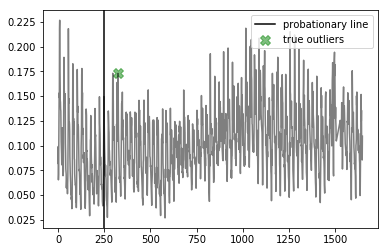




--- FARM_Bowling-Green-5-S_Warren ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  3


Outlier indices as determined by best window threshold:  []


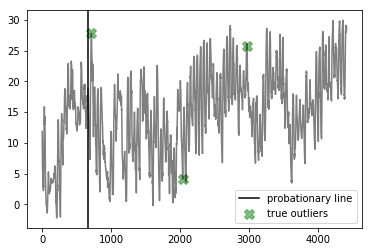

---------weight_fp=0.3, weight_fn=1----------


----Window-Based Results----
Minimum number of mistakes:  17.4
Best window threshold:  1.0
Corresponding window overall precision:  0.4444444444444444
Corresponding window overall recall:  0.34782608695652173
Corresponding window overall F score:  0.3902439024390244



--- all_data_gift_certificates ---
Corresponding window precision:  0.3333333333333333
Corresponding window recall:  1.0
Corresponding window false positives:  6
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [2320, 3785, 4286, 4963, 4986, 4992, 5662, 6137, 6505, 6650, 7677, 7746]


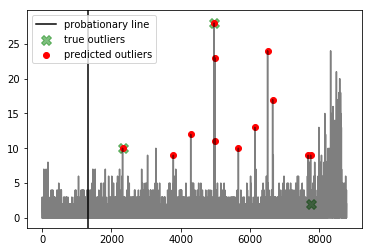




--- international-airline-passengers ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  []


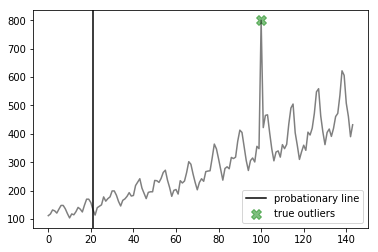




--- exchange-3_cpc_results ---
Corresponding window precision:  0.75
Corresponding window recall:  1.0
Corresponding window false positives:  1
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [322, 323, 466, 467, 1018, 1041, 1043, 1044, 1194]


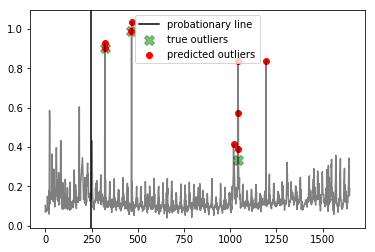




--- nyc_taxi ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  5


Outlier indices as determined by best window threshold:  []


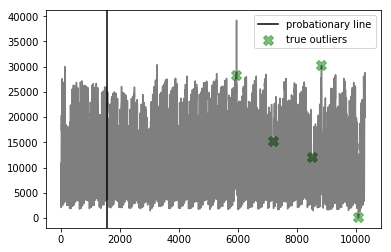




--- elb_request_count_8c0756 ---
Corresponding window precision:  1.0
Corresponding window recall:  0.5
Corresponding window false positives:  0
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [3690]


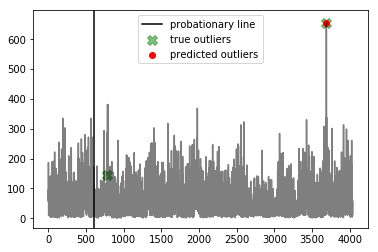




--- ambient_temperature_system_failure ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  []


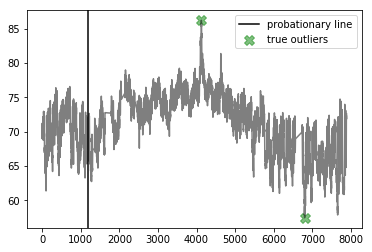




--- exchange-2_cpm_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  []


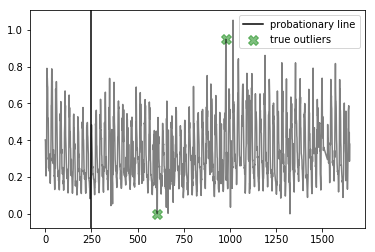




--- exchange-3_cpm_results ---
Corresponding window precision:  0.5
Corresponding window recall:  1.0
Corresponding window false positives:  1
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [1044, 1193, 1194]


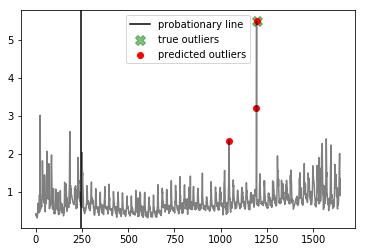




--- exchange-2_cpc_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  []


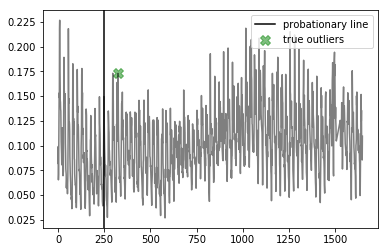




--- FARM_Bowling-Green-5-S_Warren ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  3


Outlier indices as determined by best window threshold:  []


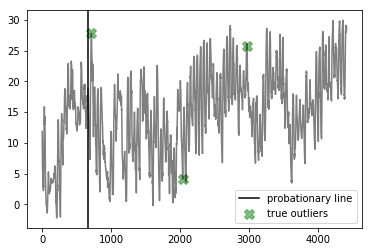

---------weight_fp=0.4, weight_fn=1----------


----Window-Based Results----
Minimum number of mistakes:  18.200000000000003
Best window threshold:  1.0
Corresponding window overall precision:  0.4444444444444444
Corresponding window overall recall:  0.34782608695652173
Corresponding window overall F score:  0.3902439024390244



--- all_data_gift_certificates ---
Corresponding window precision:  0.3333333333333333
Corresponding window recall:  1.0
Corresponding window false positives:  6
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [2320, 3785, 4286, 4963, 4986, 4992, 5662, 6137, 6505, 6650, 7677, 7746]


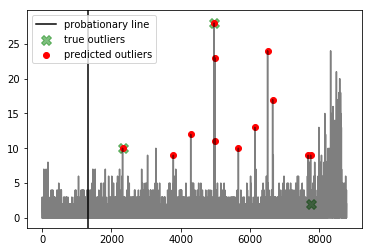




--- international-airline-passengers ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  []


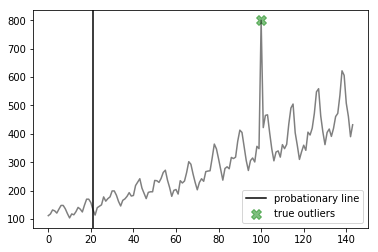




--- exchange-3_cpc_results ---
Corresponding window precision:  0.75
Corresponding window recall:  1.0
Corresponding window false positives:  1
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [322, 323, 466, 467, 1018, 1041, 1043, 1044, 1194]


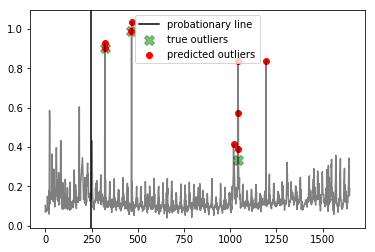




--- nyc_taxi ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  5


Outlier indices as determined by best window threshold:  []


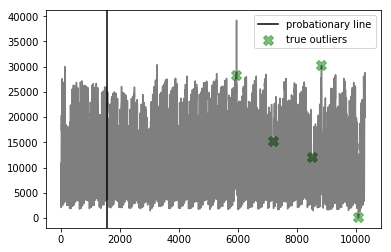




--- elb_request_count_8c0756 ---
Corresponding window precision:  1.0
Corresponding window recall:  0.5
Corresponding window false positives:  0
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [3690]


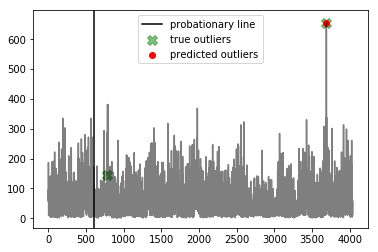




--- ambient_temperature_system_failure ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  []


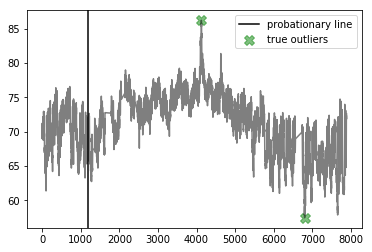




--- exchange-2_cpm_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  []


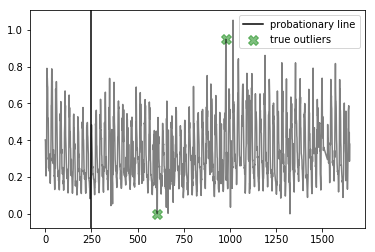




--- exchange-3_cpm_results ---
Corresponding window precision:  0.5
Corresponding window recall:  1.0
Corresponding window false positives:  1
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [1044, 1193, 1194]


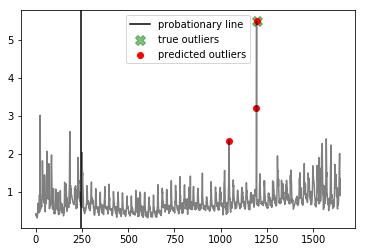




--- exchange-2_cpc_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  []


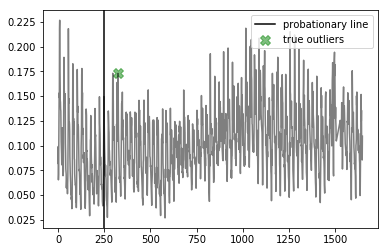




--- FARM_Bowling-Green-5-S_Warren ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  3


Outlier indices as determined by best window threshold:  []


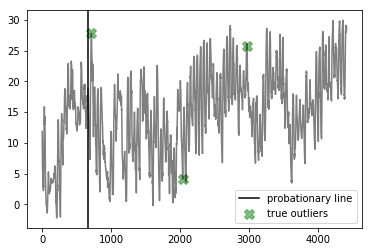

---------weight_fp=0.5, weight_fn=1----------


----Window-Based Results----
Minimum number of mistakes:  19.0
Best window threshold:  1.0
Corresponding window overall precision:  0.4444444444444444
Corresponding window overall recall:  0.34782608695652173
Corresponding window overall F score:  0.3902439024390244



--- all_data_gift_certificates ---
Corresponding window precision:  0.3333333333333333
Corresponding window recall:  1.0
Corresponding window false positives:  6
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [2320, 3785, 4286, 4963, 4986, 4992, 5662, 6137, 6505, 6650, 7677, 7746]


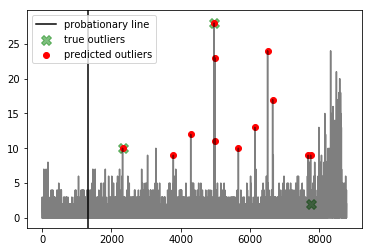




--- international-airline-passengers ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  []


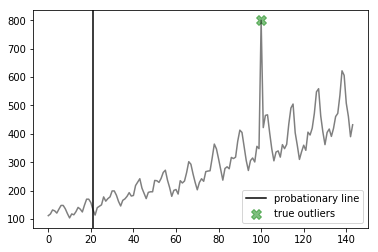




--- exchange-3_cpc_results ---
Corresponding window precision:  0.75
Corresponding window recall:  1.0
Corresponding window false positives:  1
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [322, 323, 466, 467, 1018, 1041, 1043, 1044, 1194]


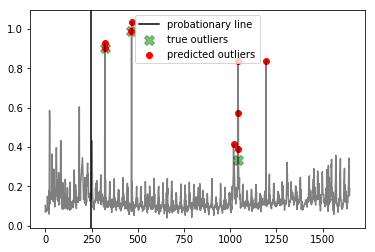




--- nyc_taxi ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  5


Outlier indices as determined by best window threshold:  []


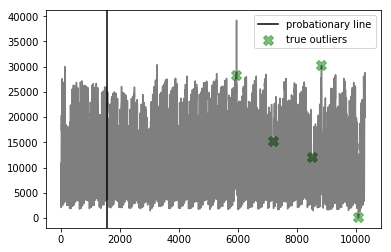




--- elb_request_count_8c0756 ---
Corresponding window precision:  1.0
Corresponding window recall:  0.5
Corresponding window false positives:  0
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [3690]


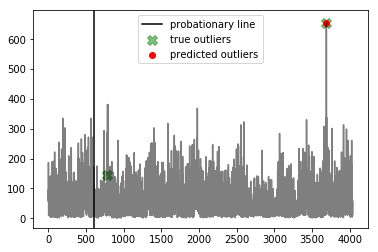




--- ambient_temperature_system_failure ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  []


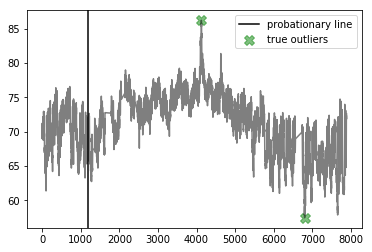




--- exchange-2_cpm_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  []


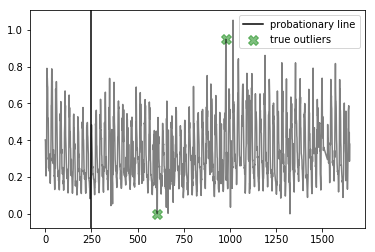




--- exchange-3_cpm_results ---
Corresponding window precision:  0.5
Corresponding window recall:  1.0
Corresponding window false positives:  1
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [1044, 1193, 1194]


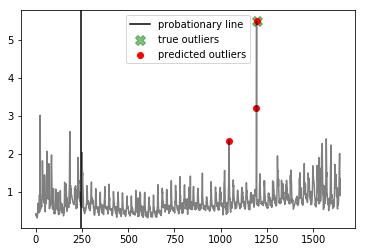




--- exchange-2_cpc_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  []


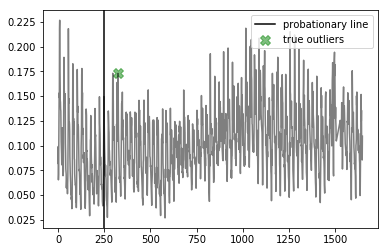




--- FARM_Bowling-Green-5-S_Warren ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  3


Outlier indices as determined by best window threshold:  []


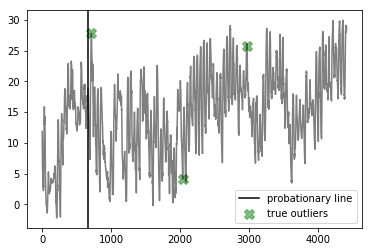

---------weight_fp=0.6, weight_fn=1----------


----Window-Based Results----
Minimum number of mistakes:  19.799999999999997
Best window threshold:  1.0
Corresponding window overall precision:  0.4444444444444444
Corresponding window overall recall:  0.34782608695652173
Corresponding window overall F score:  0.3902439024390244



--- all_data_gift_certificates ---
Corresponding window precision:  0.3333333333333333
Corresponding window recall:  1.0
Corresponding window false positives:  6
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [2320, 3785, 4286, 4963, 4986, 4992, 5662, 6137, 6505, 6650, 7677, 7746]


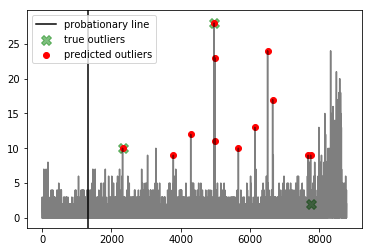




--- international-airline-passengers ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  []


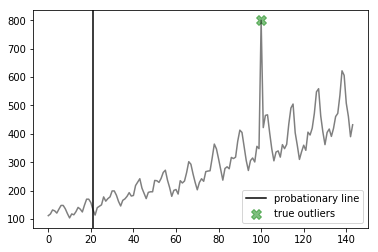




--- exchange-3_cpc_results ---
Corresponding window precision:  0.75
Corresponding window recall:  1.0
Corresponding window false positives:  1
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [322, 323, 466, 467, 1018, 1041, 1043, 1044, 1194]


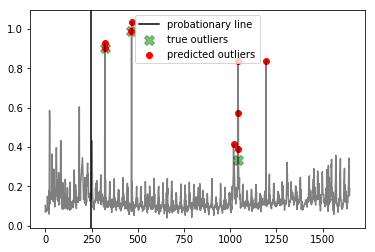




--- nyc_taxi ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  5


Outlier indices as determined by best window threshold:  []


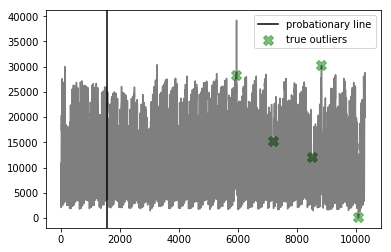




--- elb_request_count_8c0756 ---
Corresponding window precision:  1.0
Corresponding window recall:  0.5
Corresponding window false positives:  0
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [3690]


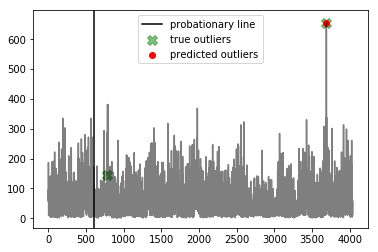




--- ambient_temperature_system_failure ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  []


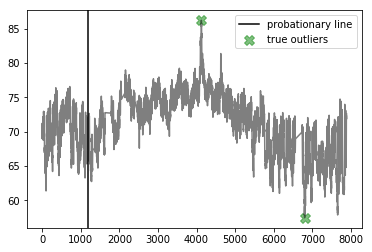




--- exchange-2_cpm_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  []


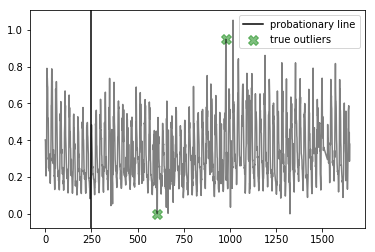




--- exchange-3_cpm_results ---
Corresponding window precision:  0.5
Corresponding window recall:  1.0
Corresponding window false positives:  1
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [1044, 1193, 1194]


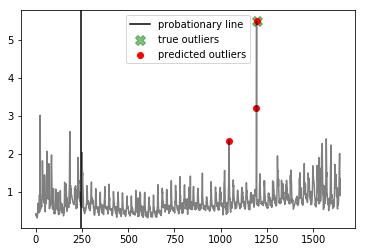




--- exchange-2_cpc_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  []


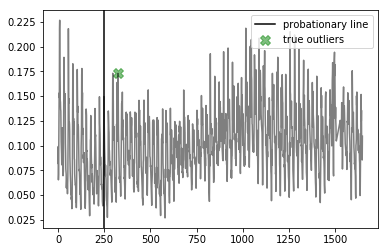




--- FARM_Bowling-Green-5-S_Warren ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  3


Outlier indices as determined by best window threshold:  []


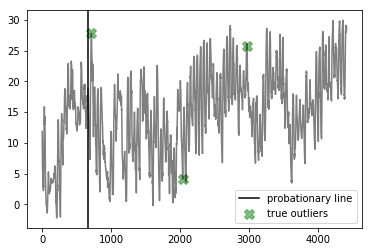

---------weight_fp=0.7, weight_fn=1----------


----Window-Based Results----
Minimum number of mistakes:  20.599999999999998
Best window threshold:  1.0
Corresponding window overall precision:  0.4444444444444444
Corresponding window overall recall:  0.34782608695652173
Corresponding window overall F score:  0.3902439024390244



--- all_data_gift_certificates ---
Corresponding window precision:  0.3333333333333333
Corresponding window recall:  1.0
Corresponding window false positives:  6
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [2320, 3785, 4286, 4963, 4986, 4992, 5662, 6137, 6505, 6650, 7677, 7746]


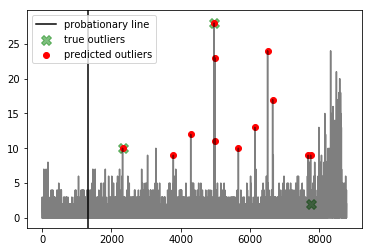




--- international-airline-passengers ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  []


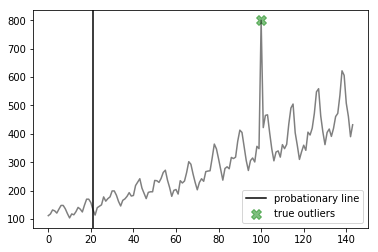




--- exchange-3_cpc_results ---
Corresponding window precision:  0.75
Corresponding window recall:  1.0
Corresponding window false positives:  1
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [322, 323, 466, 467, 1018, 1041, 1043, 1044, 1194]


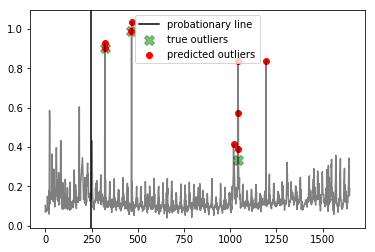




--- nyc_taxi ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  5


Outlier indices as determined by best window threshold:  []


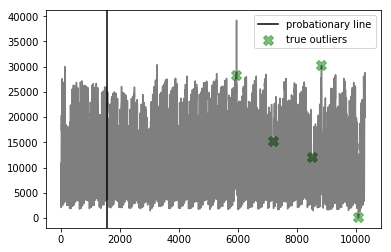




--- elb_request_count_8c0756 ---
Corresponding window precision:  1.0
Corresponding window recall:  0.5
Corresponding window false positives:  0
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [3690]


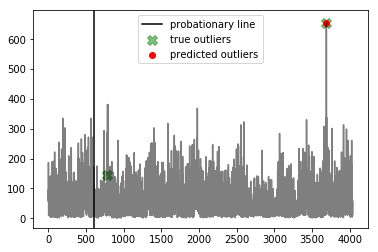




--- ambient_temperature_system_failure ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  []


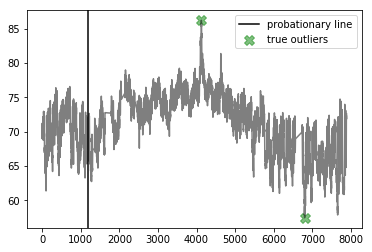




--- exchange-2_cpm_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  []


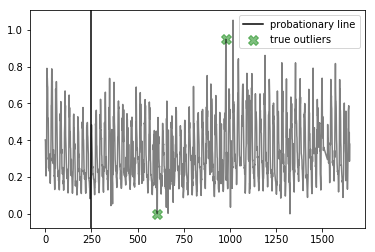




--- exchange-3_cpm_results ---
Corresponding window precision:  0.5
Corresponding window recall:  1.0
Corresponding window false positives:  1
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [1044, 1193, 1194]


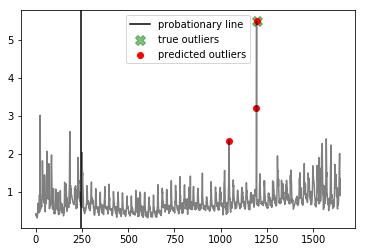




--- exchange-2_cpc_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  []


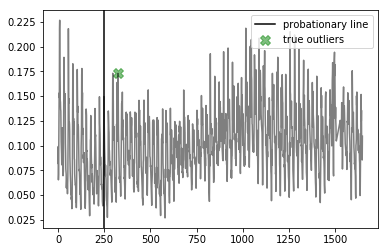




--- FARM_Bowling-Green-5-S_Warren ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  3


Outlier indices as determined by best window threshold:  []


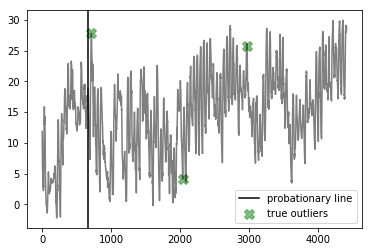

---------weight_fp=0.8, weight_fn=1----------


----Window-Based Results----
Minimum number of mistakes:  21.400000000000002
Best window threshold:  1.0
Corresponding window overall precision:  0.4444444444444444
Corresponding window overall recall:  0.34782608695652173
Corresponding window overall F score:  0.3902439024390244



--- all_data_gift_certificates ---
Corresponding window precision:  0.3333333333333333
Corresponding window recall:  1.0
Corresponding window false positives:  6
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [2320, 3785, 4286, 4963, 4986, 4992, 5662, 6137, 6505, 6650, 7677, 7746]


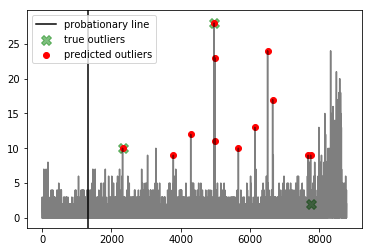




--- international-airline-passengers ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  []


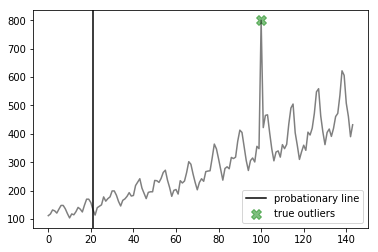




--- exchange-3_cpc_results ---
Corresponding window precision:  0.75
Corresponding window recall:  1.0
Corresponding window false positives:  1
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [322, 323, 466, 467, 1018, 1041, 1043, 1044, 1194]


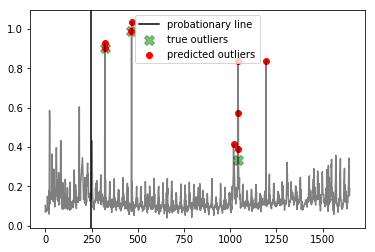




--- nyc_taxi ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  5


Outlier indices as determined by best window threshold:  []


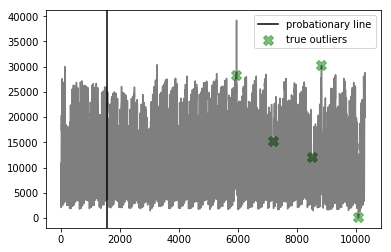




--- elb_request_count_8c0756 ---
Corresponding window precision:  1.0
Corresponding window recall:  0.5
Corresponding window false positives:  0
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [3690]


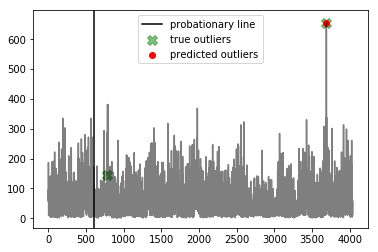




--- ambient_temperature_system_failure ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  []


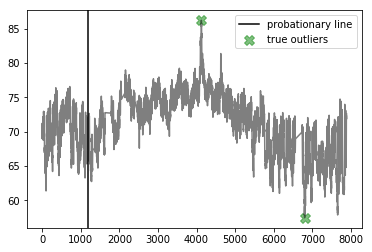




--- exchange-2_cpm_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  []


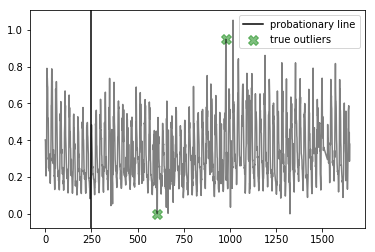




--- exchange-3_cpm_results ---
Corresponding window precision:  0.5
Corresponding window recall:  1.0
Corresponding window false positives:  1
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [1044, 1193, 1194]


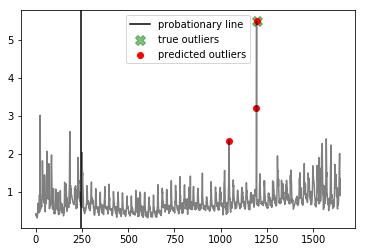




--- exchange-2_cpc_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  []


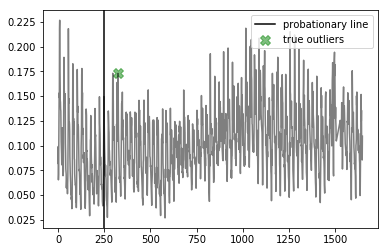




--- FARM_Bowling-Green-5-S_Warren ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  3


Outlier indices as determined by best window threshold:  []


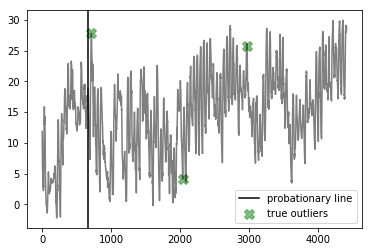

---------weight_fp=0.9, weight_fn=1----------


----Window-Based Results----
Minimum number of mistakes:  22.2
Best window threshold:  1.0
Corresponding window overall precision:  0.4444444444444444
Corresponding window overall recall:  0.34782608695652173
Corresponding window overall F score:  0.3902439024390244



--- all_data_gift_certificates ---
Corresponding window precision:  0.3333333333333333
Corresponding window recall:  1.0
Corresponding window false positives:  6
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [2320, 3785, 4286, 4963, 4986, 4992, 5662, 6137, 6505, 6650, 7677, 7746]


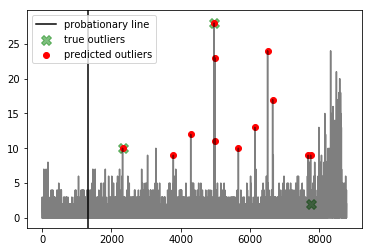




--- international-airline-passengers ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  []


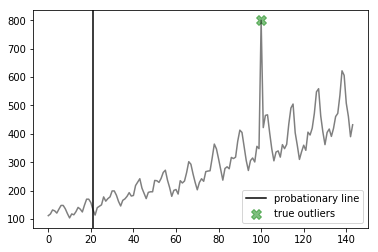




--- exchange-3_cpc_results ---
Corresponding window precision:  0.75
Corresponding window recall:  1.0
Corresponding window false positives:  1
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [322, 323, 466, 467, 1018, 1041, 1043, 1044, 1194]


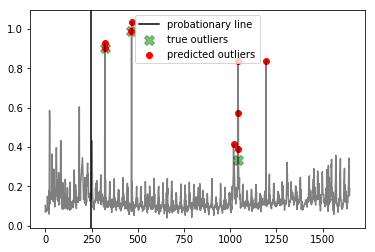




--- nyc_taxi ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  5


Outlier indices as determined by best window threshold:  []


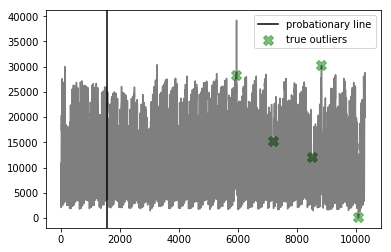




--- elb_request_count_8c0756 ---
Corresponding window precision:  1.0
Corresponding window recall:  0.5
Corresponding window false positives:  0
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [3690]


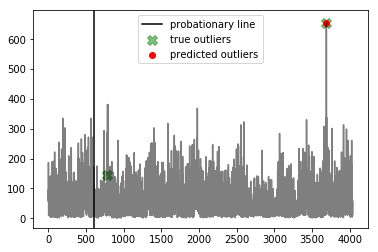




--- ambient_temperature_system_failure ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  []


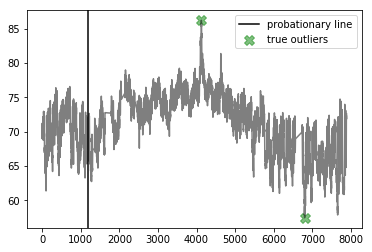




--- exchange-2_cpm_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  []


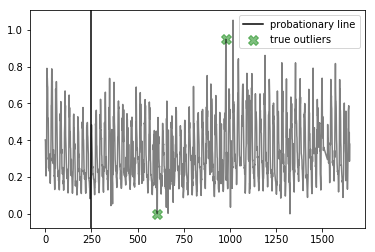




--- exchange-3_cpm_results ---
Corresponding window precision:  0.5
Corresponding window recall:  1.0
Corresponding window false positives:  1
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [1044, 1193, 1194]


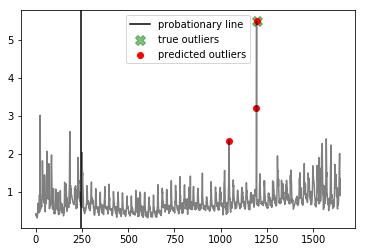




--- exchange-2_cpc_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  []


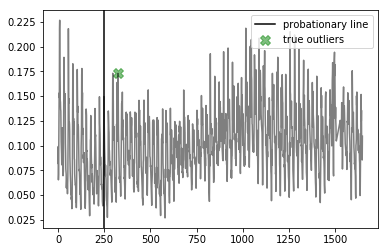




--- FARM_Bowling-Green-5-S_Warren ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  3


Outlier indices as determined by best window threshold:  []


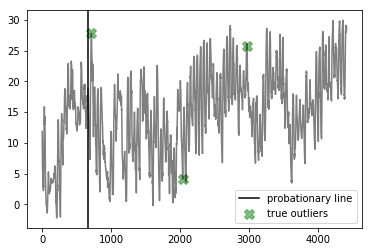

---------weight_fp=1.0, weight_fn=1----------


----Window-Based Results----
Minimum number of mistakes:  23.0
Best window threshold:  1.0
Corresponding window overall precision:  0.4444444444444444
Corresponding window overall recall:  0.34782608695652173
Corresponding window overall F score:  0.3902439024390244



--- all_data_gift_certificates ---
Corresponding window precision:  0.3333333333333333
Corresponding window recall:  1.0
Corresponding window false positives:  6
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [2320, 3785, 4286, 4963, 4986, 4992, 5662, 6137, 6505, 6650, 7677, 7746]


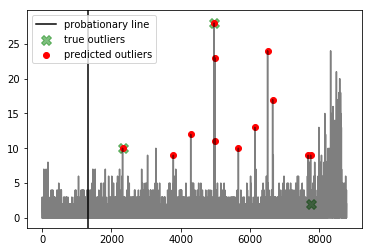




--- international-airline-passengers ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  []


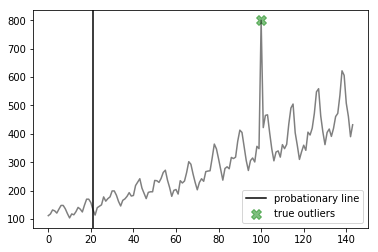




--- exchange-3_cpc_results ---
Corresponding window precision:  0.75
Corresponding window recall:  1.0
Corresponding window false positives:  1
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [322, 323, 466, 467, 1018, 1041, 1043, 1044, 1194]


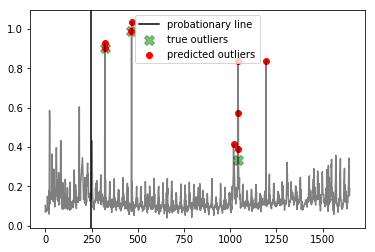




--- nyc_taxi ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  5


Outlier indices as determined by best window threshold:  []


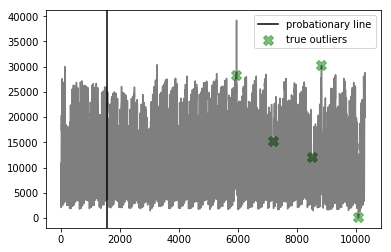




--- elb_request_count_8c0756 ---
Corresponding window precision:  1.0
Corresponding window recall:  0.5
Corresponding window false positives:  0
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [3690]


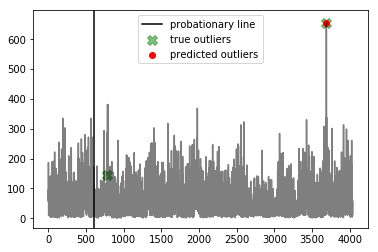




--- ambient_temperature_system_failure ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  []


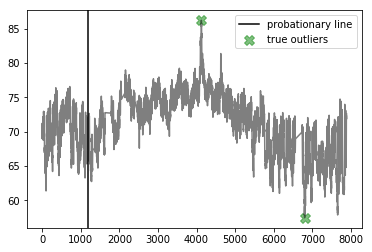




--- exchange-2_cpm_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  []


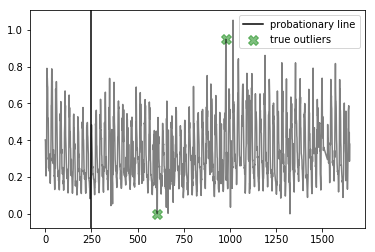




--- exchange-3_cpm_results ---
Corresponding window precision:  0.5
Corresponding window recall:  1.0
Corresponding window false positives:  1
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [1044, 1193, 1194]


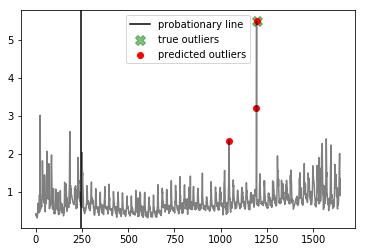




--- exchange-2_cpc_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  []


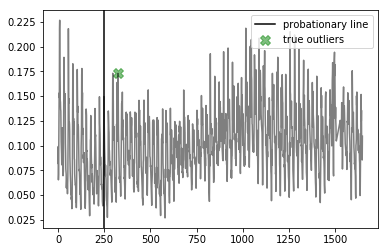




--- FARM_Bowling-Green-5-S_Warren ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  0
Corresponding window false negatives:  3


Outlier indices as determined by best window threshold:  []


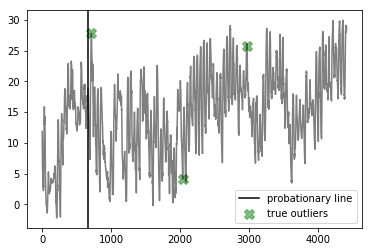

------------
False Positive Weight:  0.1
	 Minimum number of mistakes : 12.9
	 Best window threshold : 0.9983
	 Corresponding window overall precision : 0.1588785046728972
	 Corresponding window overall recall : 0.7391304347826086
	 Corresponding window overall F score : 0.2615384615384615
False Positive Weight:  0.2
	 Minimum number of mistakes : 16.6
	 Best window threshold : 1.0
	 Corresponding window overall precision : 0.4444444444444444
	 Corresponding window overall recall : 0.34782608695652173
	 Corresponding window overall F score : 0.3902439024390244
False Positive Weight:  0.3
	 Minimum number of mistakes : 17.4
	 Best window threshold : 1.0
	 Corresponding window overall precision : 0.4444444444444444
	 Corresponding window overall recall : 0.34782608695652173
	 Corresponding window overall F score : 0.3902439024390244
False Positive Weight:  0.6
	 Minimum number of mistakes : 19.799999999999997
	 Best window threshold : 1.0
	 Corresponding window overall precision : 0.4444

In [42]:
end_results = {}
for weight_fp in weight_fp_list:  
    print("---------weight_fp=" + str(weight_fp) + ", weight_fn=1----------")
    weight_result = adclasses.pretty_print_results(ad_dict, anomaly_scores_dict, true_outlier_indices_dict, weight_fp=weight_fp, weight_fn=1)
    end_results[weight_fp] = weight_result

print("------------")
adclasses.pretty_print_end_results(end_results)

# HOTSAX Results

In [43]:
anomaly_scores_dict = {}

for dataset_name in dataset_name_list:
    output_dict_htm = joblib.load("anomaly_scores/hotsax/" + dataset_name)
    anomaly_scores_dict[dataset_name] = output_dict_htm["Anomaly Scores"]

In [44]:
adclasses.precision_recall_curve_info(anomaly_scores_dict, true_outlier_indices_dict)

{0.1: {'precision': 0.0, 'recall': 0.0},
 0.2: {'precision': 0.0, 'recall': 0.0},
 0.3: {'precision': 0.0, 'recall': 0.0},
 0.4: {'precision': 0.0, 'recall': 0.0},
 0.5: {'precision': 0.0, 'recall': 0.0},
 0.6: {'precision': 0.0, 'recall': 0.0},
 0.7: {'precision': 0.0, 'recall': 0.0},
 0.8: {'precision': 0.0, 'recall': 0.0},
 0.9: {'precision': 0.0, 'recall': 0.0},
 1.0: {'precision': 0.0, 'recall': 0.0}}

---------weight_fp=0.1, weight_fn=1----------


----Window-Based Results----
Minimum number of mistakes:  17.8
Best window threshold:  0.0
Corresponding window overall precision:  0.11386138613861387
Corresponding window overall recall:  1.0
Corresponding window overall F score:  0.20444444444444443



--- all_data_gift_certificates ---
Corresponding window precision:  0.11538461538461539
Corresponding window recall:  1.0
Corresponding window false positives:  23
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [1317, 1318, 1319, 1320, 1321, 1322, 1323, 1324, 1325, 1326, 1327, 1328, 1329, 1330, 1331, 1332, 1333, 1334, 1335, 1336, 1337, 1338, 1339, 1340, 1341, 1342, 1343, 1344, 1345, 1346, 1347, 1348, 1349, 1350, 1351, 1352, 1353, 1354, 1355, 1356, 1357, 1358, 1359, 1360, 1361, 1362, 1363, 1364, 1365, 1366, 1367, 1368, 1369, 1370, 1371, 1372, 1373, 1374, 1375, 1376, 1377, 1378, 1379, 1380, 1381, 1382, 1383, 1384, 1385, 1386, 1387, 1388,

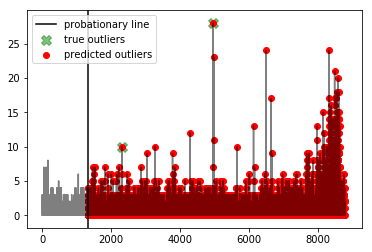




--- international-airline-passengers ---
Corresponding window precision:  0.1111111111111111
Corresponding window recall:  1.0
Corresponding window false positives:  8
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 66, 67, 68, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142, 143]


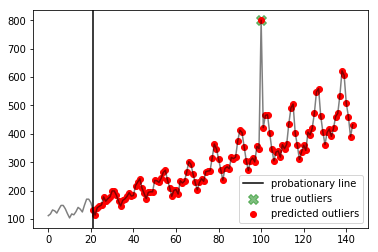




--- exchange-3_cpc_results ---
Corresponding window precision:  0.11538461538461539
Corresponding window recall:  1.0
Corresponding window false positives:  23
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [247, 248, 249, 250, 251, 252, 253, 254, 255, 256, 257, 258, 259, 260, 261, 262, 263, 264, 265, 266, 267, 268, 269, 270, 271, 272, 273, 274, 275, 276, 277, 278, 279, 280, 281, 282, 283, 284, 285, 286, 287, 288, 289, 290, 291, 292, 293, 294, 295, 296, 297, 298, 299, 300, 301, 302, 303, 304, 305, 306, 307, 308, 309, 310, 311, 312, 313, 314, 315, 316, 317, 318, 319, 320, 321, 322, 323, 324, 325, 326, 327, 328, 329, 330, 331, 332, 333, 334, 335, 336, 337, 338, 339, 340, 341, 342, 343, 344, 345, 346, 347, 348, 349, 350, 351, 352, 353, 354, 355, 356, 357, 358, 359, 360, 361, 362, 363, 364, 365, 366, 367, 368, 369, 370, 371, 372, 373, 374, 375, 376, 377, 378, 379, 380, 381, 382, 383, 384, 385, 386, 387, 388, 389, 390, 391, 392, 393, 3

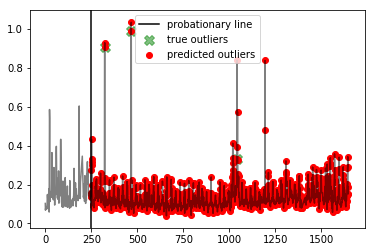




--- nyc_taxi ---
Corresponding window precision:  0.11627906976744186
Corresponding window recall:  1.0
Corresponding window false positives:  38
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [1548, 1549, 1550, 1551, 1552, 1553, 1554, 1555, 1556, 1557, 1558, 1559, 1560, 1561, 1562, 1563, 1564, 1565, 1566, 1567, 1568, 1569, 1570, 1571, 1572, 1573, 1574, 1575, 1576, 1577, 1578, 1579, 1580, 1581, 1582, 1583, 1584, 1585, 1586, 1587, 1588, 1589, 1590, 1591, 1592, 1593, 1594, 1595, 1596, 1597, 1598, 1599, 1600, 1601, 1602, 1603, 1604, 1605, 1606, 1607, 1608, 1609, 1610, 1611, 1612, 1613, 1614, 1615, 1616, 1617, 1618, 1619, 1620, 1621, 1622, 1623, 1624, 1625, 1626, 1627, 1628, 1629, 1630, 1631, 1632, 1633, 1634, 1635, 1636, 1637, 1638, 1639, 1640, 1641, 1642, 1643, 1644, 1645, 1646, 1647, 1648, 1649, 1650, 1651, 1652, 1653, 1654, 1655, 1656, 1657, 1658, 1659, 1660, 1661, 1662, 1663, 1664, 1665, 1666, 1667, 1668, 1669, 1670, 1671, 1672, 

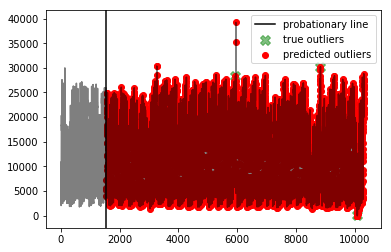




--- elb_request_count_8c0756 ---
Corresponding window precision:  0.11764705882352941
Corresponding window recall:  1.0
Corresponding window false positives:  15
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [606, 607, 608, 609, 610, 611, 612, 613, 614, 615, 616, 617, 618, 619, 620, 621, 622, 623, 624, 625, 626, 627, 628, 629, 630, 631, 632, 633, 634, 635, 636, 637, 638, 639, 640, 641, 642, 643, 644, 645, 646, 647, 648, 649, 650, 651, 652, 653, 654, 655, 656, 657, 658, 659, 660, 661, 662, 663, 664, 665, 666, 667, 668, 669, 670, 671, 672, 673, 674, 675, 676, 677, 678, 679, 680, 681, 682, 683, 684, 685, 686, 687, 688, 689, 690, 691, 692, 693, 694, 695, 696, 697, 698, 699, 700, 701, 702, 703, 704, 705, 706, 707, 708, 709, 710, 711, 712, 713, 714, 715, 716, 717, 718, 719, 720, 721, 722, 723, 724, 725, 726, 727, 728, 729, 730, 731, 732, 733, 734, 735, 736, 737, 738, 739, 740, 741, 742, 743, 744, 745, 746, 747, 748, 749, 750, 751, 752,

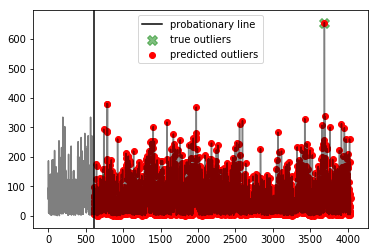




--- ambient_temperature_system_failure ---
Corresponding window precision:  0.1111111111111111
Corresponding window recall:  1.0
Corresponding window false positives:  16
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [1183, 1184, 1185, 1186, 1187, 1188, 1189, 1190, 1191, 1192, 1193, 1194, 1195, 1196, 1197, 1198, 1199, 1200, 1201, 1202, 1203, 1204, 1205, 1206, 1207, 1208, 1209, 1210, 1211, 1212, 1213, 1214, 1215, 1216, 1217, 1218, 1219, 1220, 1221, 1222, 1223, 1224, 1225, 1226, 1227, 1228, 1229, 1230, 1231, 1232, 1233, 1234, 1235, 1236, 1237, 1238, 1239, 1240, 1241, 1242, 1243, 1244, 1245, 1246, 1247, 1248, 1249, 1250, 1251, 1252, 1253, 1254, 1255, 1256, 1257, 1258, 1259, 1260, 1261, 1262, 1263, 1264, 1265, 1266, 1267, 1268, 1269, 1270, 1271, 1272, 1273, 1274, 1275, 1276, 1277, 1278, 1279, 1280, 1281, 1282, 1283, 1284, 1285, 1286, 1287, 1288, 1289, 1290, 1291, 1292, 1293, 1294, 1295, 1296, 1297, 1298, 1299, 1300, 1301, 1302, 1303,

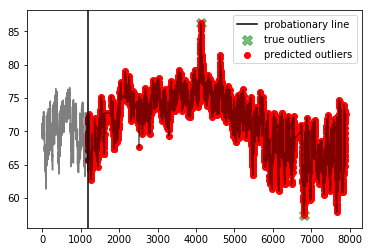




--- exchange-2_cpm_results ---
Corresponding window precision:  0.1111111111111111
Corresponding window recall:  1.0
Corresponding window false positives:  16
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [247, 248, 249, 250, 251, 252, 253, 254, 255, 256, 257, 258, 259, 260, 261, 262, 263, 264, 265, 266, 267, 268, 269, 270, 271, 272, 273, 274, 275, 276, 277, 278, 279, 280, 281, 282, 283, 284, 285, 286, 287, 288, 289, 290, 291, 292, 293, 294, 295, 296, 297, 298, 299, 300, 301, 302, 303, 304, 305, 306, 307, 308, 309, 310, 311, 312, 313, 314, 315, 316, 317, 318, 319, 320, 321, 322, 323, 324, 325, 326, 327, 328, 329, 330, 331, 332, 333, 334, 335, 336, 337, 338, 339, 340, 341, 342, 343, 344, 345, 346, 347, 348, 349, 350, 351, 352, 353, 354, 355, 356, 357, 358, 359, 360, 361, 362, 363, 364, 365, 366, 367, 368, 369, 370, 371, 372, 373, 374, 375, 376, 377, 378, 379, 380, 381, 382, 383, 384, 385, 386, 387, 388, 389, 390, 391, 392, 393, 39

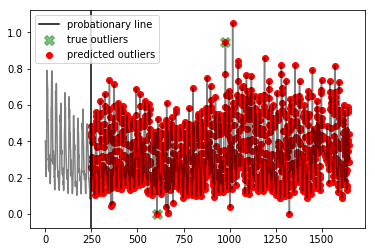




--- exchange-3_cpm_results ---
Corresponding window precision:  0.1111111111111111
Corresponding window recall:  1.0
Corresponding window false positives:  8
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [247, 248, 249, 250, 251, 252, 253, 254, 255, 256, 257, 258, 259, 260, 261, 262, 263, 264, 265, 266, 267, 268, 269, 270, 271, 272, 273, 274, 275, 276, 277, 278, 279, 280, 281, 282, 283, 284, 285, 286, 287, 288, 289, 290, 291, 292, 293, 294, 295, 296, 297, 298, 299, 300, 301, 302, 303, 304, 305, 306, 307, 308, 309, 310, 311, 312, 313, 314, 315, 316, 317, 318, 319, 320, 321, 322, 323, 324, 325, 326, 327, 328, 329, 330, 331, 332, 333, 334, 335, 336, 337, 338, 339, 340, 341, 342, 343, 344, 345, 346, 347, 348, 349, 350, 351, 352, 353, 354, 355, 356, 357, 358, 359, 360, 361, 362, 363, 364, 365, 366, 367, 368, 369, 370, 371, 372, 373, 374, 375, 376, 377, 378, 379, 380, 381, 382, 383, 384, 385, 386, 387, 388, 389, 390, 391, 392, 393, 394

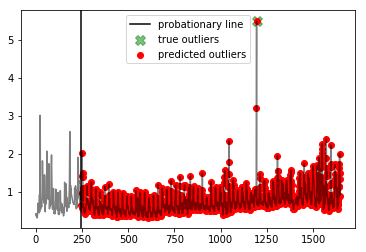




--- exchange-2_cpc_results ---
Corresponding window precision:  0.1111111111111111
Corresponding window recall:  1.0
Corresponding window false positives:  8
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [247, 248, 249, 250, 251, 252, 253, 254, 255, 256, 257, 258, 259, 260, 261, 262, 263, 264, 265, 266, 267, 268, 269, 270, 271, 272, 273, 274, 275, 276, 277, 278, 279, 280, 281, 282, 283, 284, 285, 286, 287, 288, 289, 290, 291, 292, 293, 294, 295, 296, 297, 298, 299, 300, 301, 302, 303, 304, 305, 306, 307, 308, 309, 310, 311, 312, 313, 314, 315, 316, 317, 318, 319, 320, 321, 322, 323, 324, 325, 326, 327, 328, 329, 330, 331, 332, 333, 334, 335, 336, 337, 338, 339, 340, 341, 342, 343, 344, 345, 346, 347, 348, 349, 350, 351, 352, 353, 354, 355, 356, 357, 358, 359, 360, 361, 362, 363, 364, 365, 366, 367, 368, 369, 370, 371, 372, 373, 374, 375, 376, 377, 378, 379, 380, 381, 382, 383, 384, 385, 386, 387, 388, 389, 390, 391, 392, 393, 394

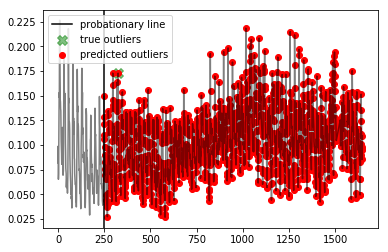




--- FARM_Bowling-Green-5-S_Warren ---
Corresponding window precision:  0.11538461538461539
Corresponding window recall:  1.0
Corresponding window false positives:  23
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [662, 663, 664, 665, 666, 667, 668, 669, 670, 671, 672, 673, 674, 675, 676, 677, 678, 679, 680, 681, 682, 683, 684, 685, 686, 687, 688, 689, 690, 691, 692, 693, 694, 695, 696, 697, 698, 699, 700, 701, 702, 703, 704, 705, 706, 707, 708, 709, 710, 711, 712, 713, 714, 715, 716, 717, 718, 719, 720, 721, 722, 723, 724, 725, 726, 727, 728, 729, 730, 731, 732, 733, 734, 735, 736, 737, 738, 739, 740, 741, 742, 743, 744, 745, 746, 747, 748, 749, 750, 751, 752, 753, 754, 755, 756, 757, 758, 759, 760, 761, 762, 763, 764, 765, 766, 767, 768, 769, 770, 771, 772, 773, 774, 775, 776, 777, 778, 779, 780, 781, 782, 783, 784, 785, 786, 787, 788, 789, 790, 791, 792, 793, 794, 795, 796, 797, 798, 799, 800, 801, 802, 803, 804, 805, 806, 807,

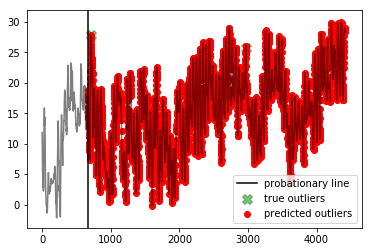

---------weight_fp=0.2, weight_fn=1----------


----Window-Based Results----
Minimum number of mistakes:  21.2
Best window threshold:  0.0001
Corresponding window overall precision:  0.4
Corresponding window overall recall:  0.2608695652173913
Corresponding window overall F score:  0.31578947368421056



--- all_data_gift_certificates ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  1
Corresponding window false negatives:  3


Outlier indices as determined by best window threshold:  [6255]


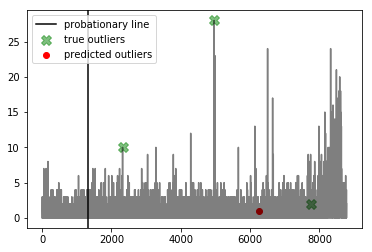




--- international-airline-passengers ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  2
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [36, 87]


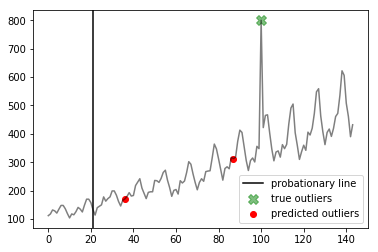




--- exchange-3_cpc_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  1
Corresponding window false negatives:  3


Outlier indices as determined by best window threshold:  [966]


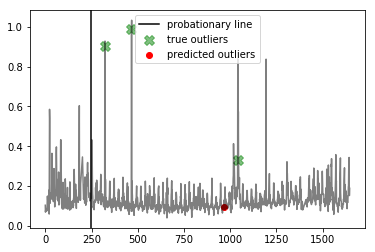




--- nyc_taxi ---
Corresponding window precision:  1.0
Corresponding window recall:  0.4
Corresponding window false positives:  0
Corresponding window false negatives:  3


Outlier indices as determined by best window threshold:  [5910, 10099]


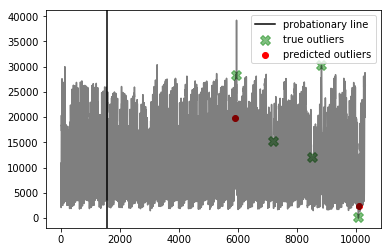




--- elb_request_count_8c0756 ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  1
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  [1890]


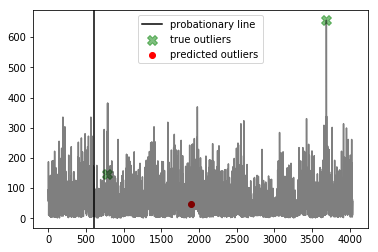




--- ambient_temperature_system_failure ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  2
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  [2196, 6693]


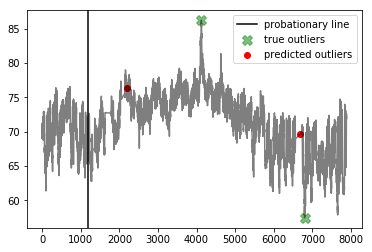




--- exchange-2_cpm_results ---
Corresponding window precision:  0.5
Corresponding window recall:  0.5
Corresponding window false positives:  1
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [942, 1493]


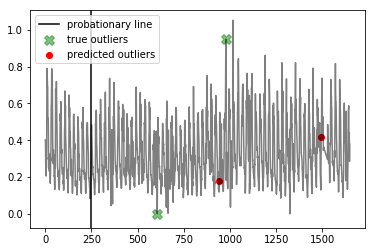




--- exchange-3_cpm_results ---
Corresponding window precision:  1.0
Corresponding window recall:  1.0
Corresponding window false positives:  0
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [1193]


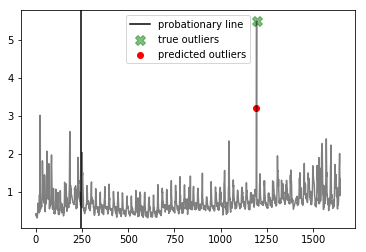




--- exchange-2_cpc_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  2
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [863, 1475]


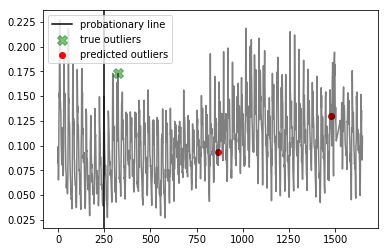




--- FARM_Bowling-Green-5-S_Warren ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  1
Corresponding window false negatives:  3


Outlier indices as determined by best window threshold:  [1102]


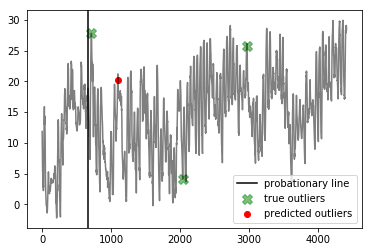

---------weight_fp=0.3, weight_fn=1----------


----Window-Based Results----
Minimum number of mistakes:  22.300000000000004
Best window threshold:  0.0001
Corresponding window overall precision:  0.4
Corresponding window overall recall:  0.2608695652173913
Corresponding window overall F score:  0.31578947368421056



--- all_data_gift_certificates ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  1
Corresponding window false negatives:  3


Outlier indices as determined by best window threshold:  [6255]


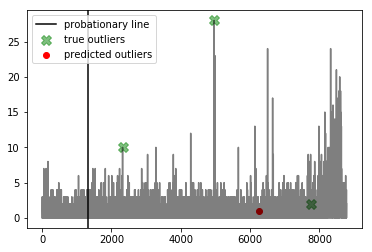




--- international-airline-passengers ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  2
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [36, 87]


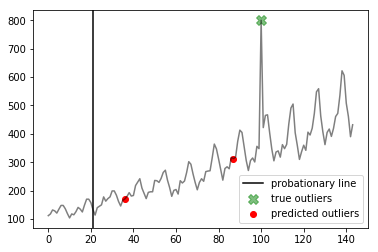




--- exchange-3_cpc_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  1
Corresponding window false negatives:  3


Outlier indices as determined by best window threshold:  [966]


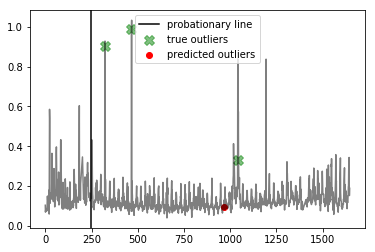




--- nyc_taxi ---
Corresponding window precision:  1.0
Corresponding window recall:  0.4
Corresponding window false positives:  0
Corresponding window false negatives:  3


Outlier indices as determined by best window threshold:  [5910, 10099]


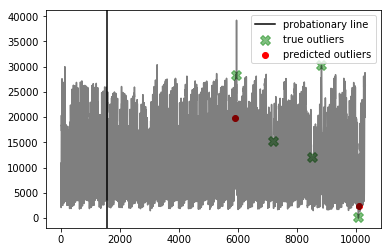




--- elb_request_count_8c0756 ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  1
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  [1890]


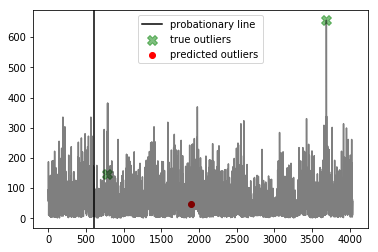




--- ambient_temperature_system_failure ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  2
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  [2196, 6693]


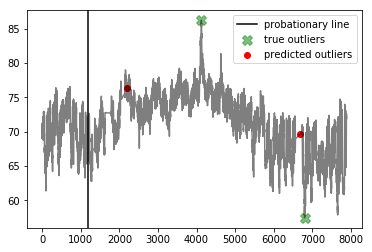




--- exchange-2_cpm_results ---
Corresponding window precision:  0.5
Corresponding window recall:  0.5
Corresponding window false positives:  1
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [942, 1493]


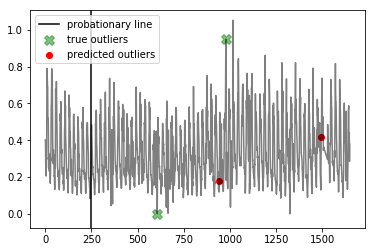




--- exchange-3_cpm_results ---
Corresponding window precision:  1.0
Corresponding window recall:  1.0
Corresponding window false positives:  0
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [1193]


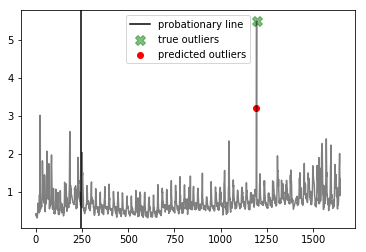




--- exchange-2_cpc_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  2
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [863, 1475]


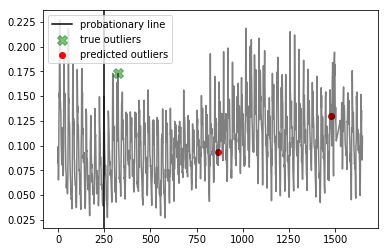




--- FARM_Bowling-Green-5-S_Warren ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  1
Corresponding window false negatives:  3


Outlier indices as determined by best window threshold:  [1102]


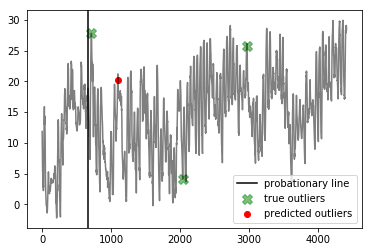

---------weight_fp=0.4, weight_fn=1----------


----Window-Based Results----
Minimum number of mistakes:  23.4
Best window threshold:  0.0001
Corresponding window overall precision:  0.4
Corresponding window overall recall:  0.2608695652173913
Corresponding window overall F score:  0.31578947368421056



--- all_data_gift_certificates ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  1
Corresponding window false negatives:  3


Outlier indices as determined by best window threshold:  [6255]


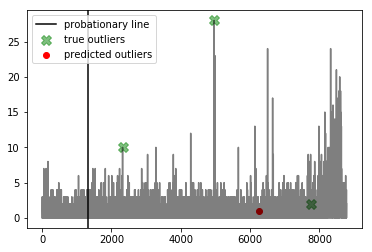




--- international-airline-passengers ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  2
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [36, 87]


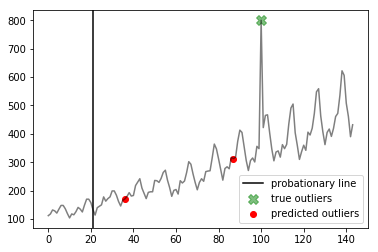




--- exchange-3_cpc_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  1
Corresponding window false negatives:  3


Outlier indices as determined by best window threshold:  [966]


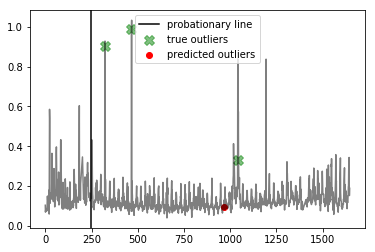




--- nyc_taxi ---
Corresponding window precision:  1.0
Corresponding window recall:  0.4
Corresponding window false positives:  0
Corresponding window false negatives:  3


Outlier indices as determined by best window threshold:  [5910, 10099]


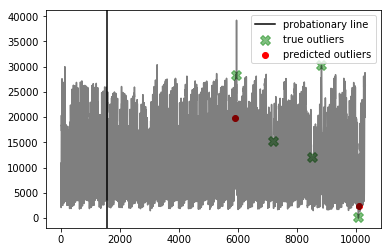




--- elb_request_count_8c0756 ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  1
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  [1890]


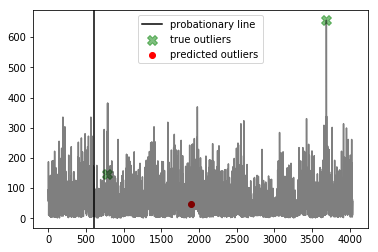




--- ambient_temperature_system_failure ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  2
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  [2196, 6693]


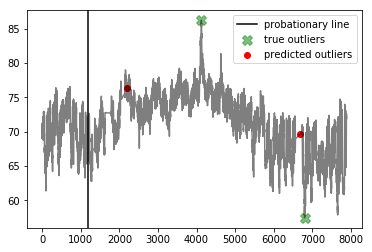




--- exchange-2_cpm_results ---
Corresponding window precision:  0.5
Corresponding window recall:  0.5
Corresponding window false positives:  1
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [942, 1493]


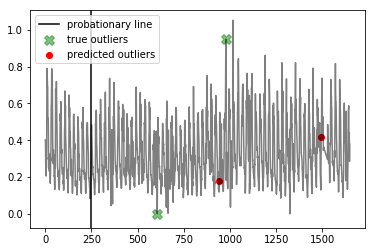




--- exchange-3_cpm_results ---
Corresponding window precision:  1.0
Corresponding window recall:  1.0
Corresponding window false positives:  0
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [1193]


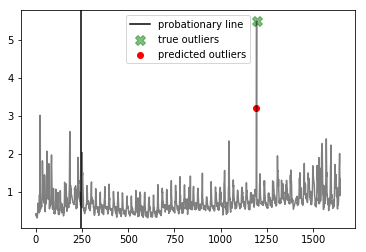




--- exchange-2_cpc_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  2
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [863, 1475]


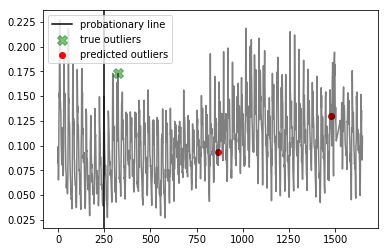




--- FARM_Bowling-Green-5-S_Warren ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  1
Corresponding window false negatives:  3


Outlier indices as determined by best window threshold:  [1102]


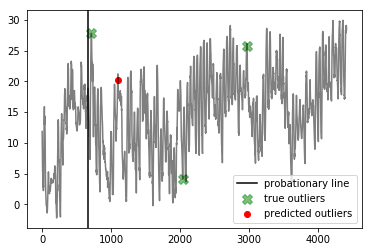

---------weight_fp=0.5, weight_fn=1----------


----Window-Based Results----
Minimum number of mistakes:  24.5
Best window threshold:  0.0001
Corresponding window overall precision:  0.4
Corresponding window overall recall:  0.2608695652173913
Corresponding window overall F score:  0.31578947368421056



--- all_data_gift_certificates ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  1
Corresponding window false negatives:  3


Outlier indices as determined by best window threshold:  [6255]


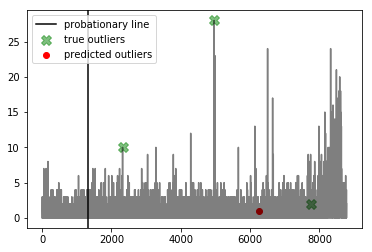




--- international-airline-passengers ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  2
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [36, 87]


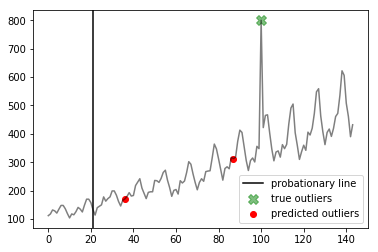




--- exchange-3_cpc_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  1
Corresponding window false negatives:  3


Outlier indices as determined by best window threshold:  [966]


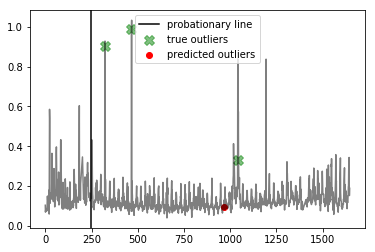




--- nyc_taxi ---
Corresponding window precision:  1.0
Corresponding window recall:  0.4
Corresponding window false positives:  0
Corresponding window false negatives:  3


Outlier indices as determined by best window threshold:  [5910, 10099]


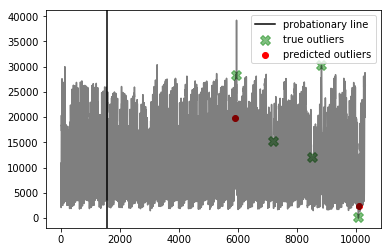




--- elb_request_count_8c0756 ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  1
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  [1890]


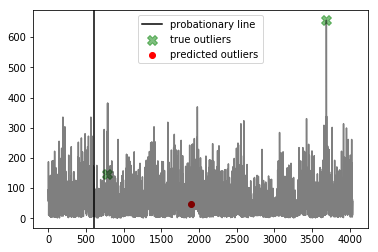




--- ambient_temperature_system_failure ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  2
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  [2196, 6693]


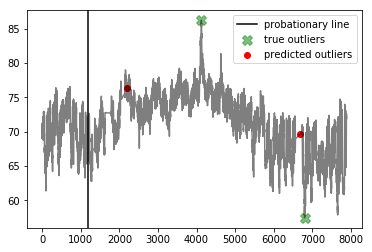




--- exchange-2_cpm_results ---
Corresponding window precision:  0.5
Corresponding window recall:  0.5
Corresponding window false positives:  1
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [942, 1493]


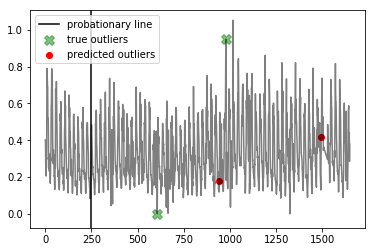




--- exchange-3_cpm_results ---
Corresponding window precision:  1.0
Corresponding window recall:  1.0
Corresponding window false positives:  0
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [1193]


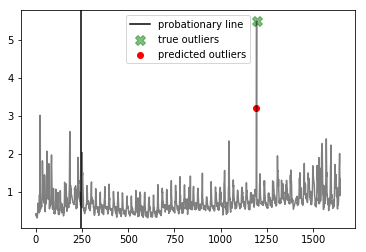




--- exchange-2_cpc_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  2
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [863, 1475]


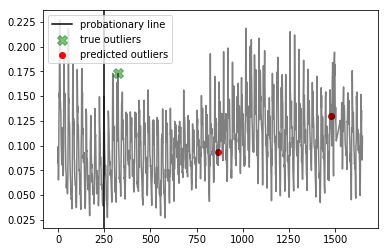




--- FARM_Bowling-Green-5-S_Warren ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  1
Corresponding window false negatives:  3


Outlier indices as determined by best window threshold:  [1102]


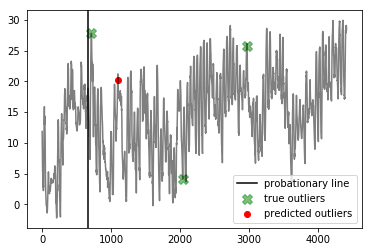

---------weight_fp=0.6, weight_fn=1----------


----Window-Based Results----
Minimum number of mistakes:  25.6
Best window threshold:  0.0001
Corresponding window overall precision:  0.4
Corresponding window overall recall:  0.2608695652173913
Corresponding window overall F score:  0.31578947368421056



--- all_data_gift_certificates ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  1
Corresponding window false negatives:  3


Outlier indices as determined by best window threshold:  [6255]


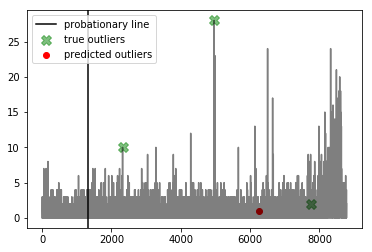




--- international-airline-passengers ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  2
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [36, 87]


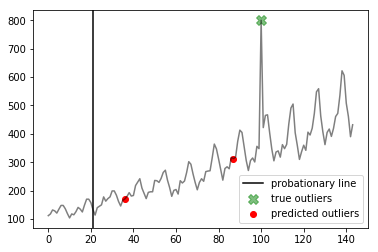




--- exchange-3_cpc_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  1
Corresponding window false negatives:  3


Outlier indices as determined by best window threshold:  [966]


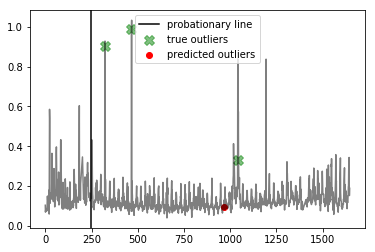




--- nyc_taxi ---
Corresponding window precision:  1.0
Corresponding window recall:  0.4
Corresponding window false positives:  0
Corresponding window false negatives:  3


Outlier indices as determined by best window threshold:  [5910, 10099]


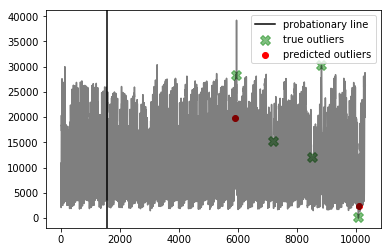




--- elb_request_count_8c0756 ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  1
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  [1890]


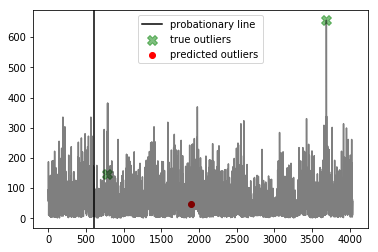




--- ambient_temperature_system_failure ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  2
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  [2196, 6693]


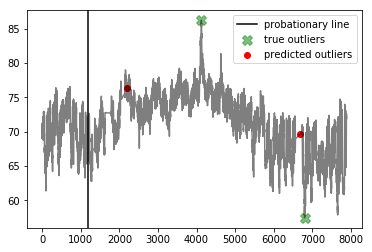




--- exchange-2_cpm_results ---
Corresponding window precision:  0.5
Corresponding window recall:  0.5
Corresponding window false positives:  1
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [942, 1493]


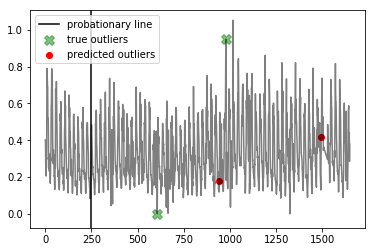




--- exchange-3_cpm_results ---
Corresponding window precision:  1.0
Corresponding window recall:  1.0
Corresponding window false positives:  0
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [1193]


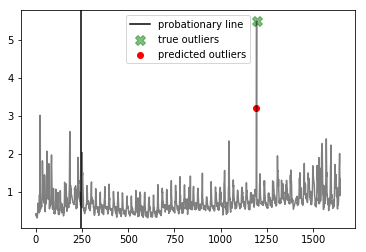




--- exchange-2_cpc_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  2
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [863, 1475]


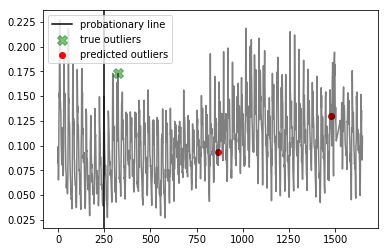




--- FARM_Bowling-Green-5-S_Warren ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  1
Corresponding window false negatives:  3


Outlier indices as determined by best window threshold:  [1102]


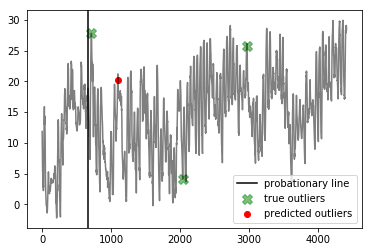

---------weight_fp=0.7, weight_fn=1----------


----Window-Based Results----
Minimum number of mistakes:  26.699999999999996
Best window threshold:  0.0001
Corresponding window overall precision:  0.4
Corresponding window overall recall:  0.2608695652173913
Corresponding window overall F score:  0.31578947368421056



--- all_data_gift_certificates ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  1
Corresponding window false negatives:  3


Outlier indices as determined by best window threshold:  [6255]


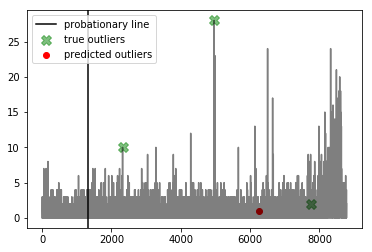




--- international-airline-passengers ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  2
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [36, 87]


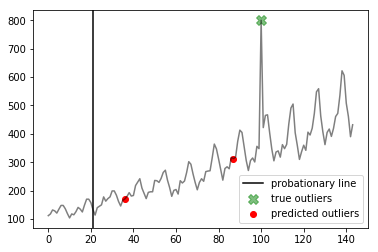




--- exchange-3_cpc_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  1
Corresponding window false negatives:  3


Outlier indices as determined by best window threshold:  [966]


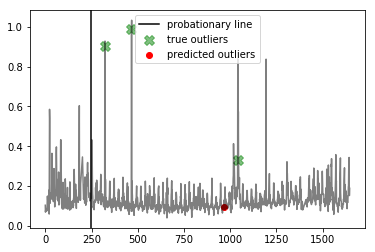




--- nyc_taxi ---
Corresponding window precision:  1.0
Corresponding window recall:  0.4
Corresponding window false positives:  0
Corresponding window false negatives:  3


Outlier indices as determined by best window threshold:  [5910, 10099]


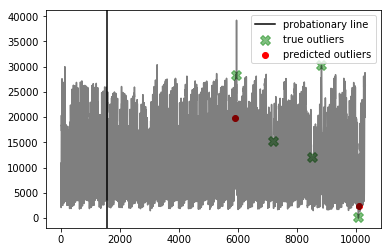




--- elb_request_count_8c0756 ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  1
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  [1890]


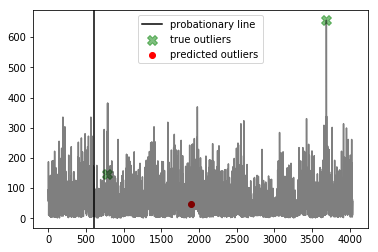




--- ambient_temperature_system_failure ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  2
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  [2196, 6693]


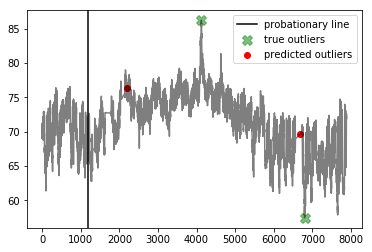




--- exchange-2_cpm_results ---
Corresponding window precision:  0.5
Corresponding window recall:  0.5
Corresponding window false positives:  1
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [942, 1493]


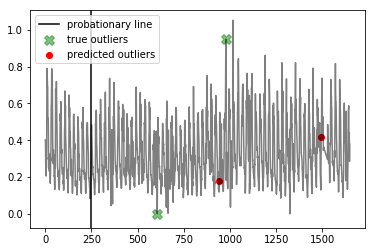




--- exchange-3_cpm_results ---
Corresponding window precision:  1.0
Corresponding window recall:  1.0
Corresponding window false positives:  0
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [1193]


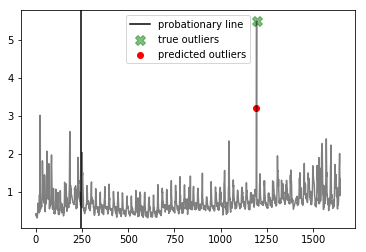




--- exchange-2_cpc_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  2
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [863, 1475]


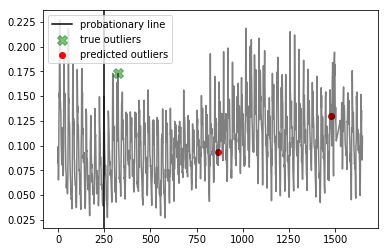




--- FARM_Bowling-Green-5-S_Warren ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  1
Corresponding window false negatives:  3


Outlier indices as determined by best window threshold:  [1102]


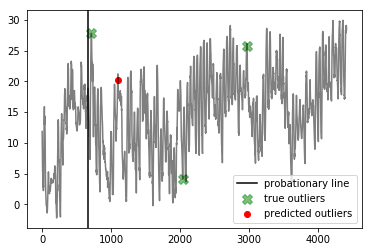

---------weight_fp=0.8, weight_fn=1----------


----Window-Based Results----
Minimum number of mistakes:  27.800000000000004
Best window threshold:  0.0001
Corresponding window overall precision:  0.4
Corresponding window overall recall:  0.2608695652173913
Corresponding window overall F score:  0.31578947368421056



--- all_data_gift_certificates ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  1
Corresponding window false negatives:  3


Outlier indices as determined by best window threshold:  [6255]


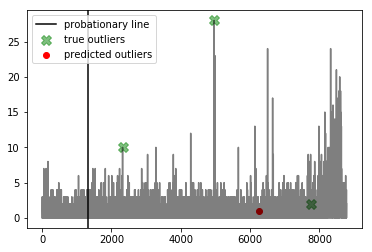




--- international-airline-passengers ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  2
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [36, 87]


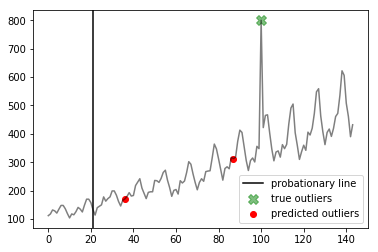




--- exchange-3_cpc_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  1
Corresponding window false negatives:  3


Outlier indices as determined by best window threshold:  [966]


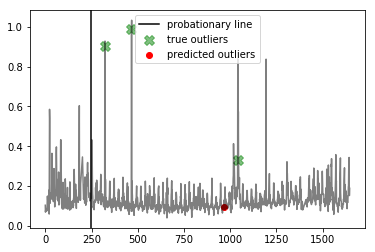




--- nyc_taxi ---
Corresponding window precision:  1.0
Corresponding window recall:  0.4
Corresponding window false positives:  0
Corresponding window false negatives:  3


Outlier indices as determined by best window threshold:  [5910, 10099]


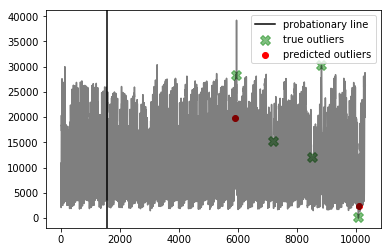




--- elb_request_count_8c0756 ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  1
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  [1890]


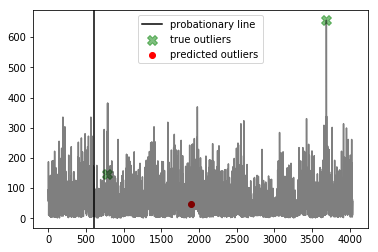




--- ambient_temperature_system_failure ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  2
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  [2196, 6693]


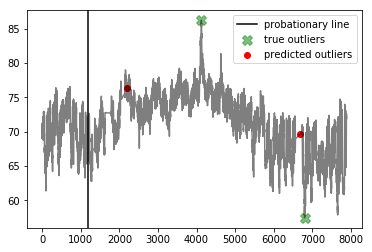




--- exchange-2_cpm_results ---
Corresponding window precision:  0.5
Corresponding window recall:  0.5
Corresponding window false positives:  1
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [942, 1493]


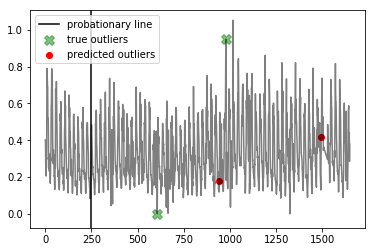




--- exchange-3_cpm_results ---
Corresponding window precision:  1.0
Corresponding window recall:  1.0
Corresponding window false positives:  0
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [1193]


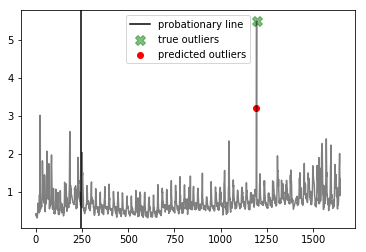




--- exchange-2_cpc_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  2
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [863, 1475]


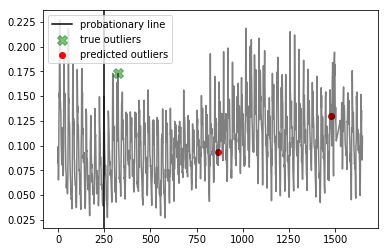




--- FARM_Bowling-Green-5-S_Warren ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  1
Corresponding window false negatives:  3


Outlier indices as determined by best window threshold:  [1102]


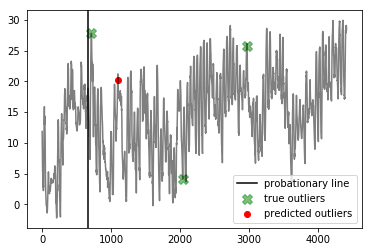

---------weight_fp=0.9, weight_fn=1----------


----Window-Based Results----
Minimum number of mistakes:  28.9
Best window threshold:  0.0001
Corresponding window overall precision:  0.4
Corresponding window overall recall:  0.2608695652173913
Corresponding window overall F score:  0.31578947368421056



--- all_data_gift_certificates ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  1
Corresponding window false negatives:  3


Outlier indices as determined by best window threshold:  [6255]


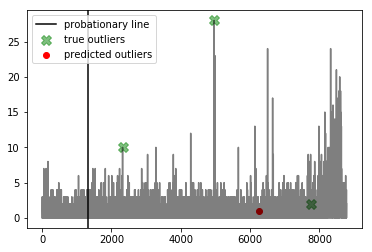




--- international-airline-passengers ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  2
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [36, 87]


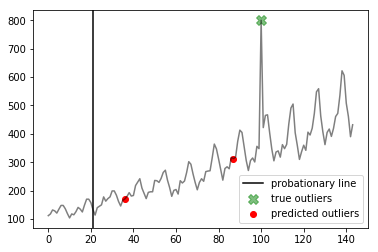




--- exchange-3_cpc_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  1
Corresponding window false negatives:  3


Outlier indices as determined by best window threshold:  [966]


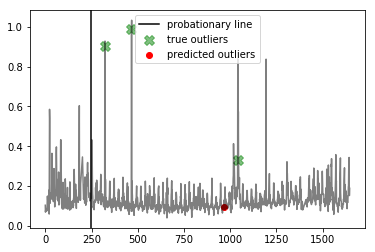




--- nyc_taxi ---
Corresponding window precision:  1.0
Corresponding window recall:  0.4
Corresponding window false positives:  0
Corresponding window false negatives:  3


Outlier indices as determined by best window threshold:  [5910, 10099]


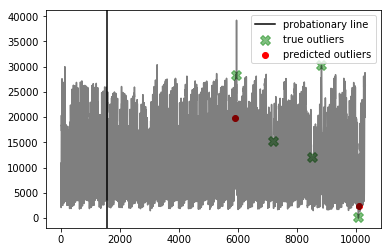




--- elb_request_count_8c0756 ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  1
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  [1890]


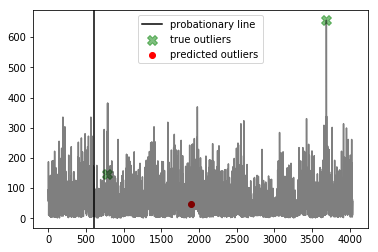




--- ambient_temperature_system_failure ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  2
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  [2196, 6693]


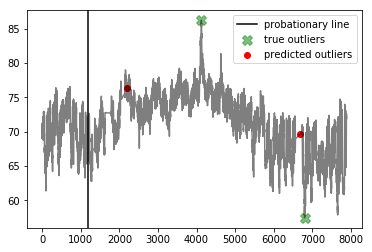




--- exchange-2_cpm_results ---
Corresponding window precision:  0.5
Corresponding window recall:  0.5
Corresponding window false positives:  1
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [942, 1493]


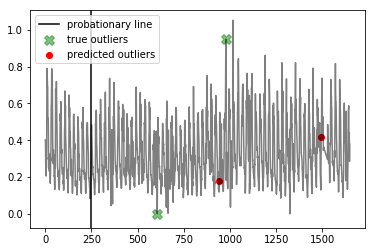




--- exchange-3_cpm_results ---
Corresponding window precision:  1.0
Corresponding window recall:  1.0
Corresponding window false positives:  0
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [1193]


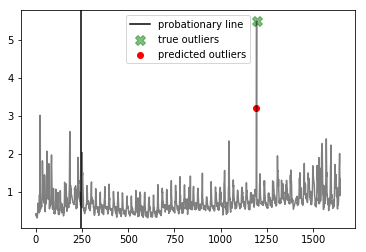




--- exchange-2_cpc_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  2
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [863, 1475]


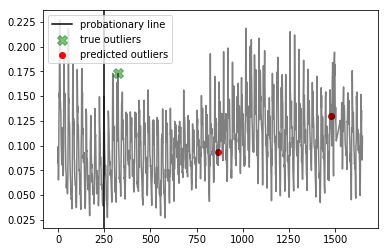




--- FARM_Bowling-Green-5-S_Warren ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  1
Corresponding window false negatives:  3


Outlier indices as determined by best window threshold:  [1102]


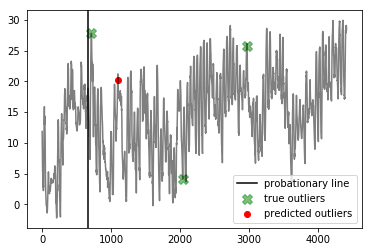

---------weight_fp=1.0, weight_fn=1----------


----Window-Based Results----
Minimum number of mistakes:  30.0
Best window threshold:  0.0001
Corresponding window overall precision:  0.4
Corresponding window overall recall:  0.2608695652173913
Corresponding window overall F score:  0.31578947368421056



--- all_data_gift_certificates ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  1
Corresponding window false negatives:  3


Outlier indices as determined by best window threshold:  [6255]


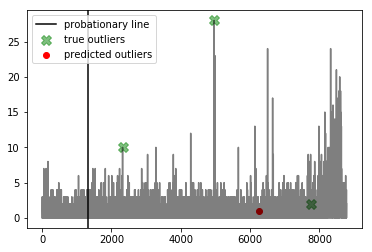




--- international-airline-passengers ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  2
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [36, 87]


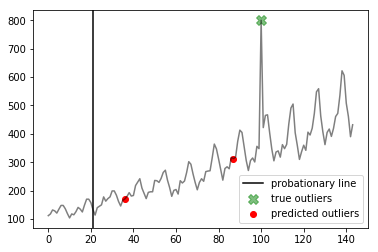




--- exchange-3_cpc_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  1
Corresponding window false negatives:  3


Outlier indices as determined by best window threshold:  [966]


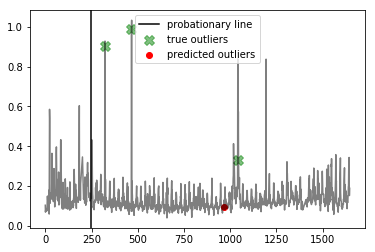




--- nyc_taxi ---
Corresponding window precision:  1.0
Corresponding window recall:  0.4
Corresponding window false positives:  0
Corresponding window false negatives:  3


Outlier indices as determined by best window threshold:  [5910, 10099]


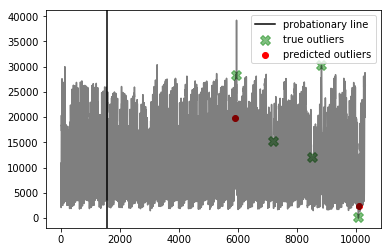




--- elb_request_count_8c0756 ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  1
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  [1890]


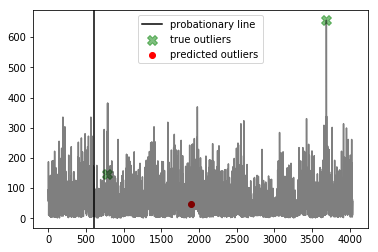




--- ambient_temperature_system_failure ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  2
Corresponding window false negatives:  2


Outlier indices as determined by best window threshold:  [2196, 6693]


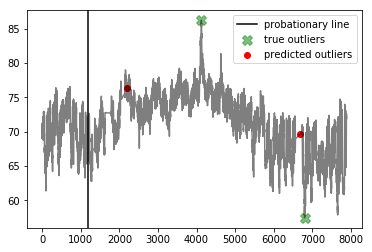




--- exchange-2_cpm_results ---
Corresponding window precision:  0.5
Corresponding window recall:  0.5
Corresponding window false positives:  1
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [942, 1493]


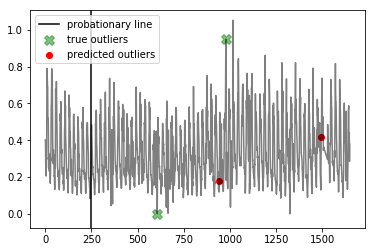




--- exchange-3_cpm_results ---
Corresponding window precision:  1.0
Corresponding window recall:  1.0
Corresponding window false positives:  0
Corresponding window false negatives:  0


Outlier indices as determined by best window threshold:  [1193]


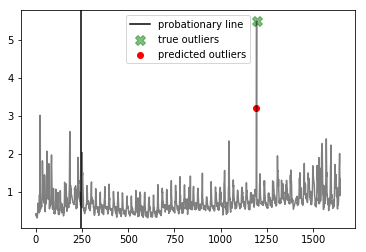




--- exchange-2_cpc_results ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  2
Corresponding window false negatives:  1


Outlier indices as determined by best window threshold:  [863, 1475]


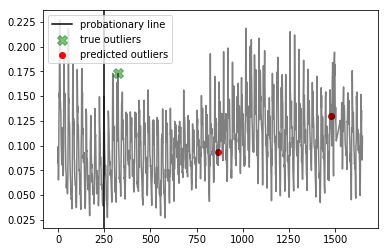




--- FARM_Bowling-Green-5-S_Warren ---
Corresponding window precision:  0.0
Corresponding window recall:  0.0
Corresponding window false positives:  1
Corresponding window false negatives:  3


Outlier indices as determined by best window threshold:  [1102]


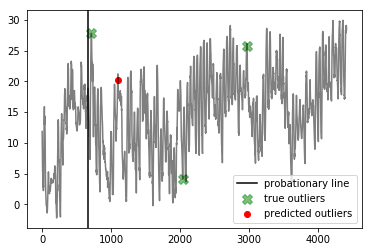

------------
False Positive Weight:  0.1
	 Minimum number of mistakes : 17.8
	 Best window threshold : 0.0
	 Corresponding window overall precision : 0.11386138613861387
	 Corresponding window overall recall : 1.0
	 Corresponding window overall F score : 0.20444444444444443
False Positive Weight:  0.2
	 Minimum number of mistakes : 21.2
	 Best window threshold : 0.0001
	 Corresponding window overall precision : 0.4
	 Corresponding window overall recall : 0.2608695652173913
	 Corresponding window overall F score : 0.31578947368421056
False Positive Weight:  0.3
	 Minimum number of mistakes : 22.300000000000004
	 Best window threshold : 0.0001
	 Corresponding window overall precision : 0.4
	 Corresponding window overall recall : 0.2608695652173913
	 Corresponding window overall F score : 0.31578947368421056
False Positive Weight:  0.6
	 Minimum number of mistakes : 25.6
	 Best window threshold : 0.0001
	 Corresponding window overall precision : 0.4
	 Corresponding window overall recall :

In [45]:
end_results = {}
for weight_fp in weight_fp_list:  
    print("---------weight_fp=" + str(weight_fp) + ", weight_fn=1----------")
    weight_result = adclasses.pretty_print_results(ad_dict, anomaly_scores_dict, true_outlier_indices_dict, weight_fp=weight_fp, weight_fn=1)
    end_results[weight_fp] = weight_result

print("------------")
adclasses.pretty_print_end_results(end_results)

# NAB Score

    1. make a python 2.7 virtual environment
    2. pip install pandas
    3. git clone NAB
    4. pip install . in NAB

To obtain NAB scores for every method on the seasonal datasets, we must do the following:

# Have a new dataset?

1. add the new dataset csv with timestamp, value in respective folder in data folder. no missing time steps allowed

2. add the point anomaly dates to combined_labels.json in labels folder

3. add the anomaly windows to combined_windows.json  (start and end dates)

4. in results/null, include null_datasetname.csv with timestamp, value, label, and anomaly_score (all .5). You can just use the adclasses.create_result_csv function and delete irrelevant columns and fill anomaly_score with all .5s

WARNING: Some datasets we use are already in NAB, but they have missing time steps. Replace the dataset csv in the data folder with a prefilled version as the anomaly scores we use assume no missing time steps. You can just use the adclasses.create_result_csv function and delete irrelevant columns

In [48]:
dataset_name = "FARM_Bowling-Green-5-S_Warren"
path = "data/" + dataset_name + ".csv"

data = pd.read_csv(path,header=0)
start_date = data["UTME"].values[0]
end_date = data["UTME"].values[-1]
print("Start date: ", start_date)
print("\nEnd date: ", end_date)
narrowed = []
for item in data["TAIR"].values:
    if not math.isnan(item):
        narrowed.append(item)
print("\nMedian:  ",np.median(narrowed), "\n")
print(data["TAIR"].describe())
display(data.head())

data["UTME"] = pd.to_datetime(data["UTME"],format="%Y-%m-%d %H:%M:%S UTC")
del data["NET"]
del data["STID"]
tair_data = pd.DataFrame({"UTME":data["UTME"],"TAIR":data["TAIR"]})
tair_data.set_index("UTME",inplace=True)
missing = tair_data[tair_data['TAIR'].isnull()].index
print("\n # of missing time steps using old granularity: ",len(missing))
tair_data = tair_data.interpolate()

resampled_tair_data = tair_data.resample('30Min', how={'TAIR': np.mean})

def round_2(num):
    return round(num,2)

resampled_tair_data["TAIR"]=resampled_tair_data["TAIR"].apply(round_2)

renamed_resampled_tair_data = pd.DataFrame({"timestamp": resampled_tair_data.index, "value":resampled_tair_data["TAIR"]})

data = renamed_resampled_tair_data

start_date = data["timestamp"].values[0]
end_date = data["timestamp"].values[-1]
print("Start date: ", start_date)
print("End date: ", end_date)


data["timestamp"] = pd.to_datetime(data["timestamp"], 
                                   format="%Y-%m-%d %H:%M:%S")

print("Missing time stamps: \n", adclasses.find_missing_time_steps(start_date, end_date, 
                                                                   '30min', data))

# if you want to use a method that cannot take missing time steps
# into account, you need to fill in the missing time steps yourself
# this function also removes duplicates
print("Fill Missing Time Steps with Interpolation")
data = adclasses.fill_missing_time_steps(start_date, end_date, '30min', data, method="linear")

ad = adclasses.UnivariateAnomalyDetection(dataframe=data, 
                                          timestep="30min", 
                                          dateformat="%Y-%m-%d %H:%M:%S", 
                                          name=dataset_name)
print("Length: ", ad.get_length())
print("Time step size: ", ad.get_timestep())
print("Start Date: ", start_date)
print("End Date: ", end_date)
print("Date Format: ", ad.get_dateformat())
true_outlier_dates = ["2016-03-15 21:00:00",
                      "2016-04-12 11:30:00",
                      "2016-05-01 21:30:00"]

d = timedelta(minutes=30)
for outlier_date in true_outlier_dates:
    print(adclasses.get_window_ends(outlier_date, 
                                    ad.get_length(), 
                                    len(true_outlier_dates), 
                                    ad.get_dateformat(), d))

Start date:  2016-03-01 00:00:00 UTC

End date:  2016-05-31 23:55:00 UTC

Median:   15.455 

count    26465.000000
mean        14.830008
std          6.676933
min         -2.490000
25%         10.198000
50%         15.455000
75%         19.325000
max         30.304000
Name: TAIR, dtype: float64


,NET,STID,UTME,TAIR,RELH,TDPT,WSPD,WDIR,WSMX,WDMX,SRAD,PRCP
0,KYMN,FARM,2016-03-01 00:00:00 UTC,12.886,40.8,-0.14,1.15,183.9,1.31,180.0,0.33,0.0
1,KYMN,FARM,2016-03-01 00:05:00 UTC,13.217,40.8,0.18,1.02,196.8,1.11,192.3,0.17,0.0
2,KYMN,FARM,2016-03-01 00:10:00 UTC,12.901,41.5,0.10,0.82,211.2,0.92,202.8,0.17,0.0
3,KYMN,FARM,2016-03-01 00:15:00 UTC,11.200,48.2,0.63,0.73,220.5,0.92,220.4,0.00,0.0
4,KYMN,FARM,2016-03-01 00:20:00 UTC,10.414,49.8,0.37,0.44,220.5,0.69,220.5,0.00,0.0



 # of missing time steps using old granularity:  19
Start date:  2016-03-01T00:00:00.000000000
End date:  2016-05-31T23:30:00.000000000
Missing time stamps: 
 DatetimeIndex([], dtype='datetime64[ns]', freq='30T')
Fill Missing Time Steps with Interpolation
Length:  4416
Time step size:  30min
Start Date:  2016-03-01T00:00:00.000000000
End Date:  2016-05-31T23:30:00.000000000
Date Format:  %Y-%m-%d %H:%M:%S
(Timestamp('2016-03-14 08:30:00'), Timestamp('2016-03-17 09:30:00'))
(Timestamp('2016-04-10 23:00:00'), Timestamp('2016-04-14 00:00:00'))
(Timestamp('2016-04-30 09:00:00'), Timestamp('2016-05-03 10:00:00'))


# For every anomaly detection method "method_name" and dataset "dataset_name", do the following:

0. clear up previous NAB/results/

1. $ python scripts/create_new_detector.py --detector method_name

this creates the method_name folder in results folder with a bunch of datasets folders that are empty. delete the irrelevant ones

2. for every characteristic relevant dataset, create csvs with columns like so: timestamp, value, anomaly_score, label. place in appropriate locations in results/method_name/

3. replace datasets with prefill

4. $ python run.py -d method_name --optimize --score --normalize

WARNING: HAVE TO MAKE CHANGE TO NAB function convertAnomalyScoresToDetections in util.py bc it will think values are strings

In [17]:
prepath="/pathtonab/NAB/results/"

# STL Resid

In [50]:
folder="selfCreate"
method_name = "stl"
dataset_name = "FARM_Bowling-Green-5-S_Warren"
date_format = "%Y-%m-%d %H:%M:%S"
timestep = "30min"
true_outlier_dates = ["2016-03-15 21:00:00",
                      "2016-04-12 11:30:00",
                      "2016-05-01 21:30:00"]

adclasses.create_result_csv(prepath, folder, method_name, dataset_name, date_format, timestep, true_outlier_dates)
###
folder="realKnownCause"
method_name = "stl"
dataset_name = "nyc_taxi"
date_format = "%Y-%m-%d %H:%M:%S"
timestep = "30min"
true_outlier_dates = ["2014-11-01 19:00:00",
                      "2014-11-27 15:30:00",
                      "2014-12-25 15:00:00",
                      "2015-01-01 01:00:00",
                      "2015-01-27 00:00:00"]

adclasses.create_result_csv(prepath, folder, method_name, dataset_name, date_format, timestep, true_outlier_dates)
###
folder="realAdExchange"
method_name = "stl"
dataset_name = "exchange-2_cpm_results"
date_format = "%Y-%m-%d %H:%M:%S"
timestep = "1H"
true_outlier_dates = ["2011-07-26 06:00:01",
                      "2011-08-10 17:00:01"]

adclasses.create_result_csv(prepath, folder, method_name, dataset_name, date_format, timestep, true_outlier_dates)
###
folder="realAdExchange"
method_name = "stl"
dataset_name = "exchange-3_cpm_results"
date_format = "%Y-%m-%d %H:%M:%S"
timestep = "1H"
true_outlier_dates = ["2011-08-19 18:15:01"]

adclasses.create_result_csv(prepath, folder, method_name, dataset_name, date_format, timestep, true_outlier_dates)
###
folder="selfCreate"
method_name = "stl"
dataset_name = "all_data_gift_certificates"
date_format = "%Y-%m-%d %H:%M:%S"
timestep = "1H"
true_outlier_dates = ["2016-04-06 16:00:00",
                      "2016-07-25 19:00:00",
                      "2016-11-19 20:00:00"]

adclasses.create_result_csv(prepath, folder, method_name, dataset_name, date_format, timestep, true_outlier_dates)
###
folder="realAWSCloudwatch"
method_name = "stl"
dataset_name = "elb_request_count_8c0756"
date_format = "%Y-%m-%d %H:%M:%S"
timestep = "5min"
true_outlier_dates = ["2014-04-12 17:24:00",
                      "2014-04-22 19:34:00"]

adclasses.create_result_csv(prepath, folder, method_name, dataset_name, date_format, timestep, true_outlier_dates)
###
folder="realAdExchange"
method_name = "stl"
dataset_name = "exchange-2_cpc_results"
date_format = "%Y-%m-%d %H:%M:%S"
timestep = "1H"
true_outlier_dates = ["2011-07-14 13:00:01"]

adclasses.create_result_csv(prepath, folder, method_name, dataset_name, date_format, timestep, true_outlier_dates)
###
folder="realAdExchange"
method_name = "stl"
dataset_name = "exchange-3_cpc_results"
date_format = "%Y-%m-%d %H:%M:%S"
timestep = "1H"
true_outlier_dates = ["2011-07-14 10:15:01",
                      "2011-07-20 10:15:01",
                      "2011-08-13 10:15:01"]

adclasses.create_result_csv(prepath, folder, method_name, dataset_name, date_format, timestep, true_outlier_dates)
###
folder="selfCreate"
method_name = "stl"
dataset_name = "international-airline-passengers"
date_format = "%Y-%m-%d %H:%M:%S"
timestep = "1MS"
true_outlier_dates = ["1957-05"]

adclasses.create_result_csv(prepath, folder, method_name, dataset_name, date_format, timestep, true_outlier_dates)
###
folder="realKnownCause"
method_name = "stl"
dataset_name = "ambient_temperature_system_failure"
date_format = "%Y-%m-%d %H:%M:%S"
timestep = "1H"
true_outlier_dates = ["2013-12-22 20:00:00",
                      "2014-04-13 09:00:00"]

adclasses.create_result_csv(prepath, folder, method_name, dataset_name, date_format, timestep, true_outlier_dates)
###

Duplicate records found: 
                        value
timestamp                    
2011-08-24 12:00:01  0.408490
2011-08-24 12:00:01  0.461745
Removing duplicates and keeping:  
                       value
timestamp                   
2011-08-24 12:00:01  0.40849
Duplicate records found: 
                        value
timestamp                    
2011-08-24 12:00:01  0.131250
2011-08-24 12:00:01  0.119453
Removing duplicates and keeping:  
                       value
timestamp                   
2011-08-24 12:00:01  0.13125


# SARIMA




In [51]:
folder="realAdExchange"
method_name = "SARIMA_all"
dataset_name = "exchange-2_cpm_results"
date_format = "%Y-%m-%d %H:%M:%S"
timestep = "1H"
true_outlier_dates = ["2011-07-26 06:00:01",
                      "2011-08-10 17:00:01"]

adclasses.create_result_csv(prepath, folder, method_name, dataset_name, date_format, timestep, true_outlier_dates)
###
folder="realAdExchange"
method_name = "SARIMA_all"
dataset_name = "exchange-3_cpm_results"
date_format = "%Y-%m-%d %H:%M:%S"
timestep = "1H"
true_outlier_dates = ["2011-08-19 18:15:01"]

adclasses.create_result_csv(prepath, folder, method_name, dataset_name, date_format, timestep, true_outlier_dates)
###
folder="selfCreate"
method_name = "SARIMA_all"
dataset_name = "all_data_gift_certificates"
date_format = "%Y-%m-%d %H:%M:%S"
timestep = "1H"
true_outlier_dates = ["2016-04-06 16:00:00",
                      "2016-07-25 19:00:00",
                      "2016-11-19 20:00:00"]

adclasses.create_result_csv(prepath, folder, method_name, dataset_name, date_format, timestep, true_outlier_dates)
###
folder="realAdExchange"
method_name = "SARIMA_all"
dataset_name = "exchange-2_cpc_results"
date_format = "%Y-%m-%d %H:%M:%S"
timestep = "1H"
true_outlier_dates = ["2011-07-14 13:00:01"]

adclasses.create_result_csv(prepath, folder, method_name, dataset_name, date_format, timestep, true_outlier_dates)
###
folder="realAdExchange"
method_name = "SARIMA_all"
dataset_name = "exchange-3_cpc_results"
date_format = "%Y-%m-%d %H:%M:%S"
timestep = "1H"
true_outlier_dates = ["2011-07-14 10:15:01",
                      "2011-07-20 10:15:01",
                      "2011-08-13 10:15:01"]

adclasses.create_result_csv(prepath, folder, method_name, dataset_name, date_format, timestep, true_outlier_dates)
###
folder="selfCreate"
method_name = "SARIMA_all"
dataset_name = "international-airline-passengers"
date_format = "%Y-%m-%d %H:%M:%S"
timestep = "1MS"
true_outlier_dates = ["1957-05"]

adclasses.create_result_csv(prepath, folder, method_name, dataset_name, date_format, timestep, true_outlier_dates)
###
folder="realKnownCause"
method_name = "SARIMA_all"
dataset_name = "ambient_temperature_system_failure"
date_format = "%Y-%m-%d %H:%M:%S"
timestep = "1H"
true_outlier_dates = ["2013-12-22 20:00:00",
                      "2014-04-13 09:00:00"]

adclasses.create_result_csv(prepath, folder, method_name, dataset_name, date_format, timestep, true_outlier_dates)
###

Duplicate records found: 
                        value
timestamp                    
2011-08-24 12:00:01  0.408490
2011-08-24 12:00:01  0.461745
Removing duplicates and keeping:  
                       value
timestamp                   
2011-08-24 12:00:01  0.40849
Duplicate records found: 
                        value
timestamp                    
2011-08-24 12:00:01  0.131250
2011-08-24 12:00:01  0.119453
Removing duplicates and keeping:  
                       value
timestamp                   
2011-08-24 12:00:01  0.13125


# Prophet


In [52]:
folder="selfCreate"
method_name = "Prophet"
dataset_name = "FARM_Bowling-Green-5-S_Warren"
date_format = "%Y-%m-%d %H:%M:%S"
timestep = "30min"
true_outlier_dates = ["2016-03-15 21:00:00",
                      "2016-04-12 11:30:00",
                      "2016-05-01 21:30:00"]

adclasses.create_result_csv(prepath, folder, method_name, dataset_name, date_format, timestep, true_outlier_dates)
###
folder="realKnownCause"
method_name = "Prophet"
dataset_name = "nyc_taxi"
date_format = "%Y-%m-%d %H:%M:%S"
timestep = "30min"
true_outlier_dates = ["2014-11-01 19:00:00",
                      "2014-11-27 15:30:00",
                      "2014-12-25 15:00:00",
                      "2015-01-01 01:00:00",
                      "2015-01-27 00:00:00"]

adclasses.create_result_csv(prepath, folder, method_name, dataset_name, date_format, timestep, true_outlier_dates)
###
folder="realAdExchange"
method_name = "Prophet"
dataset_name = "exchange-2_cpm_results"
date_format = "%Y-%m-%d %H:%M:%S"
timestep = "1H"
true_outlier_dates = ["2011-07-26 06:00:01",
                      "2011-08-10 17:00:01"]

adclasses.create_result_csv(prepath, folder, method_name, dataset_name, date_format, timestep, true_outlier_dates)
###
folder="realAdExchange"
method_name = "Prophet"
dataset_name = "exchange-3_cpm_results"
date_format = "%Y-%m-%d %H:%M:%S"
timestep = "1H"
true_outlier_dates = ["2011-08-19 18:15:01"]

adclasses.create_result_csv(prepath, folder, method_name, dataset_name, date_format, timestep, true_outlier_dates)
###
folder="selfCreate"
method_name = "Prophet"
dataset_name = "all_data_gift_certificates"
date_format = "%Y-%m-%d %H:%M:%S"
timestep = "1H"
true_outlier_dates = ["2016-04-06 16:00:00",
                      "2016-07-25 19:00:00",
                      "2016-11-19 20:00:00"]

adclasses.create_result_csv(prepath, folder, method_name, dataset_name, date_format, timestep, true_outlier_dates)
###
folder="realAWSCloudwatch"
method_name = "Prophet"
dataset_name = "elb_request_count_8c0756"
date_format = "%Y-%m-%d %H:%M:%S"
timestep = "5min"
true_outlier_dates = ["2014-04-12 17:24:00",
                      "2014-04-22 19:34:00"]

adclasses.create_result_csv(prepath, folder, method_name, dataset_name, date_format, timestep, true_outlier_dates)
###
folder="realAdExchange"
method_name = "Prophet"
dataset_name = "exchange-2_cpc_results"
date_format = "%Y-%m-%d %H:%M:%S"
timestep = "1H"
true_outlier_dates = ["2011-07-14 13:00:01"]

adclasses.create_result_csv(prepath, folder, method_name, dataset_name, date_format, timestep, true_outlier_dates)
###
folder="realAdExchange"
method_name = "Prophet"
dataset_name = "exchange-3_cpc_results"
date_format = "%Y-%m-%d %H:%M:%S"
timestep = "1H"
true_outlier_dates = ["2011-07-14 10:15:01",
                      "2011-07-20 10:15:01",
                      "2011-08-13 10:15:01"]

adclasses.create_result_csv(prepath, folder, method_name, dataset_name, date_format, timestep, true_outlier_dates)
###
folder="selfCreate"
method_name = "Prophet"
dataset_name = "international-airline-passengers"
date_format = "%Y-%m-%d %H:%M:%S"
timestep = "1MS"
true_outlier_dates = ["1957-05"]

adclasses.create_result_csv(prepath, folder, method_name, dataset_name, date_format, timestep, true_outlier_dates)
###
folder="realKnownCause"
method_name = "Prophet"
dataset_name = "ambient_temperature_system_failure"
date_format = "%Y-%m-%d %H:%M:%S"
timestep = "1H"
true_outlier_dates = ["2013-12-22 20:00:00",
                      "2014-04-13 09:00:00"]

adclasses.create_result_csv(prepath, folder, method_name, dataset_name, date_format, timestep, true_outlier_dates)
###

Duplicate records found: 
                        value
timestamp                    
2011-08-24 12:00:01  0.408490
2011-08-24 12:00:01  0.461745
Removing duplicates and keeping:  
                       value
timestamp                   
2011-08-24 12:00:01  0.40849
Duplicate records found: 
                        value
timestamp                    
2011-08-24 12:00:01  0.131250
2011-08-24 12:00:01  0.119453
Removing duplicates and keeping:  
                       value
timestamp                   
2011-08-24 12:00:01  0.13125


# RNN


In [18]:
folder="selfCreate"
method_name = "RNN"
dataset_name = "FARM_Bowling-Green-5-S_Warren"
date_format = "%Y-%m-%d %H:%M:%S"
timestep = "30min"
true_outlier_dates = ["2016-03-15 21:00:00",
                      "2016-04-12 11:30:00",
                      "2016-05-01 21:30:00"]

adclasses.create_result_csv(prepath, folder, method_name, dataset_name, date_format, timestep, true_outlier_dates)
###
folder="realKnownCause"
method_name = "RNN"
dataset_name = "nyc_taxi"
date_format = "%Y-%m-%d %H:%M:%S"
timestep = "30min"
true_outlier_dates = ["2014-11-01 19:00:00",
                      "2014-11-27 15:30:00",
                      "2014-12-25 15:00:00",
                      "2015-01-01 01:00:00",
                      "2015-01-27 00:00:00"]

adclasses.create_result_csv(prepath, folder, method_name, dataset_name, date_format, timestep, true_outlier_dates)
###
folder="realAdExchange"
method_name = "RNN"
dataset_name = "exchange-2_cpm_results"
date_format = "%Y-%m-%d %H:%M:%S"
timestep = "1H"
true_outlier_dates = ["2011-07-26 06:00:01",
                      "2011-08-10 17:00:01"]

adclasses.create_result_csv(prepath, folder, method_name, dataset_name, date_format, timestep, true_outlier_dates)
###
folder="realAdExchange"
method_name = "RNN"
dataset_name = "exchange-3_cpm_results"
date_format = "%Y-%m-%d %H:%M:%S"
timestep = "1H"
true_outlier_dates = ["2011-08-19 18:15:01"]

adclasses.create_result_csv(prepath, folder, method_name, dataset_name, date_format, timestep, true_outlier_dates)
###
folder="selfCreate"
method_name = "RNN"
dataset_name = "all_data_gift_certificates"
date_format = "%Y-%m-%d %H:%M:%S"
timestep = "1H"
true_outlier_dates = ["2016-04-06 16:00:00",
                      "2016-07-25 19:00:00",
                      "2016-11-19 20:00:00"]

adclasses.create_result_csv(prepath, folder, method_name, dataset_name, date_format, timestep, true_outlier_dates)
###
folder="realAWSCloudwatch"
method_name = "RNN"
dataset_name = "elb_request_count_8c0756"
date_format = "%Y-%m-%d %H:%M:%S"
timestep = "5min"
true_outlier_dates = ["2014-04-12 17:24:00",
                      "2014-04-22 19:34:00"]

adclasses.create_result_csv(prepath, folder, method_name, dataset_name, date_format, timestep, true_outlier_dates)
###
folder="realAdExchange"
method_name = "RNN"
dataset_name = "exchange-2_cpc_results"
date_format = "%Y-%m-%d %H:%M:%S"
timestep = "1H"
true_outlier_dates = ["2011-07-14 13:00:01"]

adclasses.create_result_csv(prepath, folder, method_name, dataset_name, date_format, timestep, true_outlier_dates)
###
folder="realAdExchange"
method_name = "RNN"
dataset_name = "exchange-3_cpc_results"
date_format = "%Y-%m-%d %H:%M:%S"
timestep = "1H"
true_outlier_dates = ["2011-07-14 10:15:01",
                      "2011-07-20 10:15:01",
                      "2011-08-13 10:15:01"]

adclasses.create_result_csv(prepath, folder, method_name, dataset_name, date_format, timestep, true_outlier_dates)
###
folder="selfCreate"
method_name = "RNN"
dataset_name = "international-airline-passengers"
date_format = "%Y-%m-%d %H:%M:%S"
timestep = "1MS"
true_outlier_dates = ["1957-05"]

adclasses.create_result_csv(prepath, folder, method_name, dataset_name, date_format, timestep, true_outlier_dates)
###
folder="realKnownCause"
method_name = "RNN"
dataset_name = "ambient_temperature_system_failure"
date_format = "%Y-%m-%d %H:%M:%S"
timestep = "1H"
true_outlier_dates = ["2013-12-22 20:00:00",
                      "2014-04-13 09:00:00"]

adclasses.create_result_csv(prepath, folder, method_name, dataset_name, date_format, timestep, true_outlier_dates)
###

Duplicate records found: 
                        value
timestamp                    
2011-08-24 12:00:01  0.408490
2011-08-24 12:00:01  0.461745
Removing duplicates and keeping:  
                       value
timestamp                   
2011-08-24 12:00:01  0.40849
Duplicate records found: 
                        value
timestamp                    
2011-08-24 12:00:01  0.131250
2011-08-24 12:00:01  0.119453
Removing duplicates and keeping:  
                       value
timestamp                   
2011-08-24 12:00:01  0.13125


# HTM


In [54]:
folder="selfCreate"
method_name = "HTM"
dataset_name = "FARM_Bowling-Green-5-S_Warren"
date_format = "%Y-%m-%d %H:%M:%S"
timestep = "30min"
true_outlier_dates = ["2016-03-15 21:00:00",
                      "2016-04-12 11:30:00",
                      "2016-05-01 21:30:00"]

adclasses.create_result_csv(prepath, folder, method_name, dataset_name, date_format, timestep, true_outlier_dates)
###
folder="realKnownCause"
method_name = "HTM"
dataset_name = "nyc_taxi"
date_format = "%Y-%m-%d %H:%M:%S"
timestep = "30min"
true_outlier_dates = ["2014-11-01 19:00:00",
                      "2014-11-27 15:30:00",
                      "2014-12-25 15:00:00",
                      "2015-01-01 01:00:00",
                      "2015-01-27 00:00:00"]

adclasses.create_result_csv(prepath, folder, method_name, dataset_name, date_format, timestep, true_outlier_dates)
###
folder="realAdExchange"
method_name = "HTM"
dataset_name = "exchange-2_cpm_results"
date_format = "%Y-%m-%d %H:%M:%S"
timestep = "1H"
true_outlier_dates = ["2011-07-26 06:00:01",
                      "2011-08-10 17:00:01"]

adclasses.create_result_csv(prepath, folder, method_name, dataset_name, date_format, timestep, true_outlier_dates)
###
folder="realAdExchange"
method_name = "HTM"
dataset_name = "exchange-3_cpm_results"
date_format = "%Y-%m-%d %H:%M:%S"
timestep = "1H"
true_outlier_dates = ["2011-08-19 18:15:01"]

adclasses.create_result_csv(prepath, folder, method_name, dataset_name, date_format, timestep, true_outlier_dates)
###
folder="selfCreate"
method_name = "HTM"
dataset_name = "all_data_gift_certificates"
date_format = "%Y-%m-%d %H:%M:%S"
timestep = "1H"
true_outlier_dates = ["2016-04-06 16:00:00",
                      "2016-07-25 19:00:00",
                      "2016-11-19 20:00:00"]

adclasses.create_result_csv(prepath, folder, method_name, dataset_name, date_format, timestep, true_outlier_dates)
###
folder="realAWSCloudwatch"
method_name = "HTM"
dataset_name = "elb_request_count_8c0756"
date_format = "%Y-%m-%d %H:%M:%S"
timestep = "5min"
true_outlier_dates = ["2014-04-12 17:24:00",
                      "2014-04-22 19:34:00"]

adclasses.create_result_csv(prepath, folder, method_name, dataset_name, date_format, timestep, true_outlier_dates)
###
folder="realAdExchange"
method_name = "HTM"
dataset_name = "exchange-2_cpc_results"
date_format = "%Y-%m-%d %H:%M:%S"
timestep = "1H"
true_outlier_dates = ["2011-07-14 13:00:01"]

adclasses.create_result_csv(prepath, folder, method_name, dataset_name, date_format, timestep, true_outlier_dates)
###
folder="realAdExchange"
method_name = "HTM"
dataset_name = "exchange-3_cpc_results"
date_format = "%Y-%m-%d %H:%M:%S"
timestep = "1H"
true_outlier_dates = ["2011-07-14 10:15:01",
                      "2011-07-20 10:15:01",
                      "2011-08-13 10:15:01"]

adclasses.create_result_csv(prepath, folder, method_name, dataset_name, date_format, timestep, true_outlier_dates)
###
folder="realKnownCause"
method_name = "HTM"
dataset_name = "ambient_temperature_system_failure"
date_format = "%Y-%m-%d %H:%M:%S"
timestep = "1H"
true_outlier_dates = ["2013-12-22 20:00:00",
                      "2014-04-13 09:00:00"]

adclasses.create_result_csv(prepath, folder, method_name, dataset_name, date_format, timestep, true_outlier_dates)
###

Duplicate records found: 
                        value
timestamp                    
2011-08-24 12:00:01  0.408490
2011-08-24 12:00:01  0.461745
Removing duplicates and keeping:  
                       value
timestamp                   
2011-08-24 12:00:01  0.40849
Duplicate records found: 
                        value
timestamp                    
2011-08-24 12:00:01  0.131250
2011-08-24 12:00:01  0.119453
Removing duplicates and keeping:  
                       value
timestamp                   
2011-08-24 12:00:01  0.13125


# Donut


In [55]:
folder="selfCreate"
method_name = "Donut"
dataset_name = "FARM_Bowling-Green-5-S_Warren"
date_format = "%Y-%m-%d %H:%M:%S"
timestep = "30min"
true_outlier_dates = ["2016-03-15 21:00:00",
                      "2016-04-12 11:30:00",
                      "2016-05-01 21:30:00"]

adclasses.create_result_csv(prepath, folder, method_name, dataset_name, date_format, timestep, true_outlier_dates)
###
folder="realKnownCause"
method_name = "Donut"
dataset_name = "nyc_taxi"
date_format = "%Y-%m-%d %H:%M:%S"
timestep = "30min"
true_outlier_dates = ["2014-11-01 19:00:00",
                      "2014-11-27 15:30:00",
                      "2014-12-25 15:00:00",
                      "2015-01-01 01:00:00",
                      "2015-01-27 00:00:00"]

adclasses.create_result_csv(prepath, folder, method_name, dataset_name, date_format, timestep, true_outlier_dates)
###
folder="realAdExchange"
method_name = "Donut"
dataset_name = "exchange-2_cpm_results"
date_format = "%Y-%m-%d %H:%M:%S"
timestep = "1H"
true_outlier_dates = ["2011-07-26 06:00:01",
                      "2011-08-10 17:00:01"]

adclasses.create_result_csv(prepath, folder, method_name, dataset_name, date_format, timestep, true_outlier_dates)
###
folder="realAdExchange"
method_name = "Donut"
dataset_name = "exchange-3_cpm_results"
date_format = "%Y-%m-%d %H:%M:%S"
timestep = "1H"
true_outlier_dates = ["2011-08-19 18:15:01"]

adclasses.create_result_csv(prepath, folder, method_name, dataset_name, date_format, timestep, true_outlier_dates)
###
folder="selfCreate"
method_name = "Donut"
dataset_name = "all_data_gift_certificates"
date_format = "%Y-%m-%d %H:%M:%S"
timestep = "1H"
true_outlier_dates = ["2016-04-06 16:00:00",
                      "2016-07-25 19:00:00",
                      "2016-11-19 20:00:00"]

adclasses.create_result_csv(prepath, folder, method_name, dataset_name, date_format, timestep, true_outlier_dates)
###
folder="realAWSCloudwatch"
method_name = "Donut"
dataset_name = "elb_request_count_8c0756"
date_format = "%Y-%m-%d %H:%M:%S"
timestep = "5min"
true_outlier_dates = ["2014-04-12 17:24:00",
                      "2014-04-22 19:34:00"]

adclasses.create_result_csv(prepath, folder, method_name, dataset_name, date_format, timestep, true_outlier_dates)
###
folder="realAdExchange"
method_name = "Donut"
dataset_name = "exchange-2_cpc_results"
date_format = "%Y-%m-%d %H:%M:%S"
timestep = "1H"
true_outlier_dates = ["2011-07-14 13:00:01"]

adclasses.create_result_csv(prepath, folder, method_name, dataset_name, date_format, timestep, true_outlier_dates)
###
folder="realAdExchange"
method_name = "Donut"
dataset_name = "exchange-3_cpc_results"
date_format = "%Y-%m-%d %H:%M:%S"
timestep = "1H"
true_outlier_dates = ["2011-07-14 10:15:01",
                      "2011-07-20 10:15:01",
                      "2011-08-13 10:15:01"]

adclasses.create_result_csv(prepath, folder, method_name, dataset_name, date_format, timestep, true_outlier_dates)
###
folder="realKnownCause"
method_name = "Donut"
dataset_name = "ambient_temperature_system_failure"
date_format = "%Y-%m-%d %H:%M:%S"
timestep = "1H"
true_outlier_dates = ["2013-12-22 20:00:00",
                      "2014-04-13 09:00:00"]

adclasses.create_result_csv(prepath, folder, method_name, dataset_name, date_format, timestep, true_outlier_dates)
###

Duplicate records found: 
                        value
timestamp                    
2011-08-24 12:00:01  0.408490
2011-08-24 12:00:01  0.461745
Removing duplicates and keeping:  
                       value
timestamp                   
2011-08-24 12:00:01  0.40849
Duplicate records found: 
                        value
timestamp                    
2011-08-24 12:00:01  0.131250
2011-08-24 12:00:01  0.119453
Removing duplicates and keeping:  
                       value
timestamp                   
2011-08-24 12:00:01  0.13125


# Windowed Gaussian

In [57]:
folder="selfCreate"
method_name = "windowed_gaussian"
dataset_name = "FARM_Bowling-Green-5-S_Warren"
date_format = "%Y-%m-%d %H:%M:%S"
timestep = "30min"
true_outlier_dates = ["2016-03-15 21:00:00",
                      "2016-04-12 11:30:00",
                      "2016-05-01 21:30:00"]

adclasses.create_result_csv(prepath, folder, method_name, dataset_name, date_format, timestep, true_outlier_dates)
###
folder="realKnownCause"
method_name = "windowed_gaussian"
dataset_name = "nyc_taxi"
date_format = "%Y-%m-%d %H:%M:%S"
timestep = "30min"
true_outlier_dates = ["2014-11-01 19:00:00",
                      "2014-11-27 15:30:00",
                      "2014-12-25 15:00:00",
                      "2015-01-01 01:00:00",
                      "2015-01-27 00:00:00"]

adclasses.create_result_csv(prepath, folder, method_name, dataset_name, date_format, timestep, true_outlier_dates)
###
folder="realAdExchange"
method_name = "windowed_gaussian"
dataset_name = "exchange-2_cpm_results"
date_format = "%Y-%m-%d %H:%M:%S"
timestep = "1H"
true_outlier_dates = ["2011-07-26 06:00:01",
                      "2011-08-10 17:00:01"]

adclasses.create_result_csv(prepath, folder, method_name, dataset_name, date_format, timestep, true_outlier_dates)
###
folder="realAdExchange"
method_name = "windowed_gaussian"
dataset_name = "exchange-3_cpm_results"
date_format = "%Y-%m-%d %H:%M:%S"
timestep = "1H"
true_outlier_dates = ["2011-08-19 18:15:01"]

adclasses.create_result_csv(prepath, folder, method_name, dataset_name, date_format, timestep, true_outlier_dates)
###
folder="selfCreate"
method_name = "windowed_gaussian"
dataset_name = "all_data_gift_certificates"
date_format = "%Y-%m-%d %H:%M:%S"
timestep = "1H"
true_outlier_dates = ["2016-04-06 16:00:00",
                      "2016-07-25 19:00:00",
                      "2016-11-19 20:00:00"]

adclasses.create_result_csv(prepath, folder, method_name, dataset_name, date_format, timestep, true_outlier_dates)
###
folder="realAWSCloudwatch"
method_name = "windowed_gaussian"
dataset_name = "elb_request_count_8c0756"
date_format = "%Y-%m-%d %H:%M:%S"
timestep = "5min"
true_outlier_dates = ["2014-04-12 17:24:00",
                      "2014-04-22 19:34:00"]

adclasses.create_result_csv(prepath, folder, method_name, dataset_name, date_format, timestep, true_outlier_dates)
###
folder="realAdExchange"
method_name = "windowed_gaussian"
dataset_name = "exchange-2_cpc_results"
date_format = "%Y-%m-%d %H:%M:%S"
timestep = "1H"
true_outlier_dates = ["2011-07-14 13:00:01"]

adclasses.create_result_csv(prepath, folder, method_name, dataset_name, date_format, timestep, true_outlier_dates)
###
folder="realAdExchange"
method_name = "windowed_gaussian"
dataset_name = "exchange-3_cpc_results"
date_format = "%Y-%m-%d %H:%M:%S"
timestep = "1H"
true_outlier_dates = ["2011-07-14 10:15:01",
                      "2011-07-20 10:15:01",
                      "2011-08-13 10:15:01"]

adclasses.create_result_csv(prepath, folder, method_name, dataset_name, date_format, timestep, true_outlier_dates)
###
folder="selfCreate"
method_name = "windowed_gaussian"
dataset_name = "international-airline-passengers"
date_format = "%Y-%m-%d %H:%M:%S"
timestep = "1MS"
true_outlier_dates = ["1957-05"]

adclasses.create_result_csv(prepath, folder, method_name, dataset_name, date_format, timestep, true_outlier_dates)
###
folder="realKnownCause"
method_name = "windowed_gaussian"
dataset_name = "ambient_temperature_system_failure"
date_format = "%Y-%m-%d %H:%M:%S"
timestep = "1H"
true_outlier_dates = ["2013-12-22 20:00:00",
                      "2014-04-13 09:00:00"]

adclasses.create_result_csv(prepath, folder, method_name, dataset_name, date_format, timestep, true_outlier_dates)
###

Duplicate records found: 
                        value
timestamp                    
2011-08-24 12:00:01  0.408490
2011-08-24 12:00:01  0.461745
Removing duplicates and keeping:  
                       value
timestamp                   
2011-08-24 12:00:01  0.40849
Duplicate records found: 
                        value
timestamp                    
2011-08-24 12:00:01  0.131250
2011-08-24 12:00:01  0.119453
Removing duplicates and keeping:  
                       value
timestamp                   
2011-08-24 12:00:01  0.13125


# HOTSAX

In [58]:
folder="selfCreate"
method_name = "hotsax"
dataset_name = "FARM_Bowling-Green-5-S_Warren"
date_format = "%Y-%m-%d %H:%M:%S"
timestep = "30min"
true_outlier_dates = ["2016-03-15 21:00:00",
                      "2016-04-12 11:30:00",
                      "2016-05-01 21:30:00"]

adclasses.create_result_csv(prepath, folder, method_name, dataset_name, date_format, timestep, true_outlier_dates)
###
folder="realKnownCause"
method_name = "hotsax"
dataset_name = "nyc_taxi"
date_format = "%Y-%m-%d %H:%M:%S"
timestep = "30min"
true_outlier_dates = ["2014-11-01 19:00:00",
                      "2014-11-27 15:30:00",
                      "2014-12-25 15:00:00",
                      "2015-01-01 01:00:00",
                      "2015-01-27 00:00:00"]

adclasses.create_result_csv(prepath, folder, method_name, dataset_name, date_format, timestep, true_outlier_dates)
###
folder="realAdExchange"
method_name = "hotsax"
dataset_name = "exchange-2_cpm_results"
date_format = "%Y-%m-%d %H:%M:%S"
timestep = "1H"
true_outlier_dates = ["2011-07-26 06:00:01",
                      "2011-08-10 17:00:01"]

adclasses.create_result_csv(prepath, folder, method_name, dataset_name, date_format, timestep, true_outlier_dates)
###
folder="realAdExchange"
method_name = "hotsax"
dataset_name = "exchange-3_cpm_results"
date_format = "%Y-%m-%d %H:%M:%S"
timestep = "1H"
true_outlier_dates = ["2011-08-19 18:15:01"]

adclasses.create_result_csv(prepath, folder, method_name, dataset_name, date_format, timestep, true_outlier_dates)
###
folder="selfCreate"
method_name = "hotsax"
dataset_name = "all_data_gift_certificates"
date_format = "%Y-%m-%d %H:%M:%S"
timestep = "1H"
true_outlier_dates = ["2016-04-06 16:00:00",
                      "2016-07-25 19:00:00",
                      "2016-11-19 20:00:00"]

adclasses.create_result_csv(prepath, folder, method_name, dataset_name, date_format, timestep, true_outlier_dates)
###
folder="realAWSCloudwatch"
method_name = "hotsax"
dataset_name = "elb_request_count_8c0756"
date_format = "%Y-%m-%d %H:%M:%S"
timestep = "5min"
true_outlier_dates = ["2014-04-12 17:24:00",
                      "2014-04-22 19:34:00"]

adclasses.create_result_csv(prepath, folder, method_name, dataset_name, date_format, timestep, true_outlier_dates)
###
folder="realAdExchange"
method_name = "hotsax"
dataset_name = "exchange-2_cpc_results"
date_format = "%Y-%m-%d %H:%M:%S"
timestep = "1H"
true_outlier_dates = ["2011-07-14 13:00:01"]

adclasses.create_result_csv(prepath, folder, method_name, dataset_name, date_format, timestep, true_outlier_dates)
###
folder="realAdExchange"
method_name = "hotsax"
dataset_name = "exchange-3_cpc_results"
date_format = "%Y-%m-%d %H:%M:%S"
timestep = "1H"
true_outlier_dates = ["2011-07-14 10:15:01",
                      "2011-07-20 10:15:01",
                      "2011-08-13 10:15:01"]

adclasses.create_result_csv(prepath, folder, method_name, dataset_name, date_format, timestep, true_outlier_dates)
###
folder="selfCreate"
method_name = "hotsax"
dataset_name = "international-airline-passengers"
date_format = "%Y-%m-%d %H:%M:%S"
timestep = "1MS"
true_outlier_dates = ["1957-05"]

adclasses.create_result_csv(prepath, folder, method_name, dataset_name, date_format, timestep, true_outlier_dates)
###
folder="realKnownCause"
method_name = "hotsax"
dataset_name = "ambient_temperature_system_failure"
date_format = "%Y-%m-%d %H:%M:%S"
timestep = "1H"
true_outlier_dates = ["2013-12-22 20:00:00",
                      "2014-04-13 09:00:00"]

adclasses.create_result_csv(prepath, folder, method_name, dataset_name, date_format, timestep, true_outlier_dates)
###

Duplicate records found: 
                        value
timestamp                    
2011-08-24 12:00:01  0.408490
2011-08-24 12:00:01  0.461745
Removing duplicates and keeping:  
                       value
timestamp                   
2011-08-24 12:00:01  0.40849
Duplicate records found: 
                        value
timestamp                    
2011-08-24 12:00:01  0.131250
2011-08-24 12:00:01  0.119453
Removing duplicates and keeping:  
                       value
timestamp                   
2011-08-24 12:00:01  0.13125


# Twitter

In [59]:
folder="selfCreate"
method_name = "Twitter"
dataset_name = "FARM_Bowling-Green-5-S_Warren"
date_format = "%Y-%m-%d %H:%M:%S"
timestep = "30min"
true_outlier_dates = ["2016-03-15 21:00:00",
                      "2016-04-12 11:30:00",
                      "2016-05-01 21:30:00"]

adclasses.create_result_csv(prepath, folder, method_name, dataset_name, date_format, timestep, true_outlier_dates)
###
folder="realKnownCause"
method_name = "Twitter"
dataset_name = "nyc_taxi"
date_format = "%Y-%m-%d %H:%M:%S"
timestep = "30min"
true_outlier_dates = ["2014-11-01 19:00:00",
                      "2014-11-27 15:30:00",
                      "2014-12-25 15:00:00",
                      "2015-01-01 01:00:00",
                      "2015-01-27 00:00:00"]

adclasses.create_result_csv(prepath, folder, method_name, dataset_name, date_format, timestep, true_outlier_dates)
###
folder="realAdExchange"
method_name = "Twitter"
dataset_name = "exchange-2_cpm_results"
date_format = "%Y-%m-%d %H:%M:%S"
timestep = "1H"
true_outlier_dates = ["2011-07-26 06:00:01",
                      "2011-08-10 17:00:01"]

adclasses.create_result_csv(prepath, folder, method_name, dataset_name, date_format, timestep, true_outlier_dates)
###
folder="realAdExchange"
method_name = "Twitter"
dataset_name = "exchange-3_cpm_results"
date_format = "%Y-%m-%d %H:%M:%S"
timestep = "1H"
true_outlier_dates = ["2011-08-19 18:15:01"]

adclasses.create_result_csv(prepath, folder, method_name, dataset_name, date_format, timestep, true_outlier_dates)
###
folder="selfCreate"
method_name = "Twitter"
dataset_name = "all_data_gift_certificates"
date_format = "%Y-%m-%d %H:%M:%S"
timestep = "1H"
true_outlier_dates = ["2016-04-06 16:00:00",
                      "2016-07-25 19:00:00",
                      "2016-11-19 20:00:00"]

adclasses.create_result_csv(prepath, folder, method_name, dataset_name, date_format, timestep, true_outlier_dates)
###
folder="realAWSCloudwatch"
method_name = "Twitter"
dataset_name = "elb_request_count_8c0756"
date_format = "%Y-%m-%d %H:%M:%S"
timestep = "5min"
true_outlier_dates = ["2014-04-12 17:24:00",
                      "2014-04-22 19:34:00"]

adclasses.create_result_csv(prepath, folder, method_name, dataset_name, date_format, timestep, true_outlier_dates)
###
folder="realAdExchange"
method_name = "Twitter"
dataset_name = "exchange-2_cpc_results"
date_format = "%Y-%m-%d %H:%M:%S"
timestep = "1H"
true_outlier_dates = ["2011-07-14 13:00:01"]

adclasses.create_result_csv(prepath, folder, method_name, dataset_name, date_format, timestep, true_outlier_dates)
###
folder="realAdExchange"
method_name = "Twitter"
dataset_name = "exchange-3_cpc_results"
date_format = "%Y-%m-%d %H:%M:%S"
timestep = "1H"
true_outlier_dates = ["2011-07-14 10:15:01",
                      "2011-07-20 10:15:01",
                      "2011-08-13 10:15:01"]

adclasses.create_result_csv(prepath, folder, method_name, dataset_name, date_format, timestep, true_outlier_dates)
###
folder="selfCreate"
method_name = "Twitter"
dataset_name = "international-airline-passengers"
date_format = "%Y-%m-%d %H:%M:%S"
timestep = "1MS"
true_outlier_dates = ["1957-05"]

adclasses.create_result_csv(prepath, folder, method_name, dataset_name, date_format, timestep, true_outlier_dates)
###
folder="realKnownCause"
method_name = "Twitter"
dataset_name = "ambient_temperature_system_failure"
date_format = "%Y-%m-%d %H:%M:%S"
timestep = "1H"
true_outlier_dates = ["2013-12-22 20:00:00",
                      "2014-04-13 09:00:00"]

adclasses.create_result_csv(prepath, folder, method_name, dataset_name, date_format, timestep, true_outlier_dates)
###

Duplicate records found: 
                        value
timestamp                    
2011-08-24 12:00:01  0.408490
2011-08-24 12:00:01  0.461745
Removing duplicates and keeping:  
                       value
timestamp                   
2011-08-24 12:00:01  0.40849
Duplicate records found: 
                        value
timestamp                    
2011-08-24 12:00:01  0.131250
2011-08-24 12:00:01  0.119453
Removing duplicates and keeping:  
                       value
timestamp                   
2011-08-24 12:00:01  0.13125
